In [1]:
import matplotlib.pyplot as plt
%matplotlib inline

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils as utils
import torchvision.transforms as transforms

from torch.autograd import Variable

import os
import time

from PIL.Image import BICUBIC
from torchvision.datasets import MNIST
from ram import RecurrentAttentionModel
from trainer import *

### MNIST dataset
Testing out this model and training algorithm implementation on the basic MNIST dataset, which is pretty simple so hopefully everything goes well.

In [2]:
num_train_data_copies = 1  # Number of times to load the training dataset (with augmentation)
num_eval_data_copies = 1   # Number of times to load the evaluation dataset (with augmentation)
test_val_split = 0.5       # Percentage of the test set to use as validation data
batch_size = 20            # Batch size for training
eval_batch_size = 20       # Batch size for validation and testing

# Image parameters
num_classes = 10       # Digits 0-9
image_size = 28        # MNIST images are 28x28 b/w images
in_channels = 1        # Number of color channels in the inputs (MNIST dataset is grayscale)

glimpse_sizes = [8]  #[5, 10, 18]
padding = int(np.ceil(glimpse_sizes[-1] / 2))
padded_img_size = image_size + 2*padding

In [3]:
# Down/load MNIST data
mnist_data_loc = os.path.join('data', 'mnist')
data_transforms = transforms.Compose([ # Keep things pretty basic for now
    # Pad images with 0s so the GlimpseSensor won't have to
    transforms.Pad(padding = padding),
    # Converts a PIL Image or numpy.ndarray (H x W x C) in the range [0, 255]
    # to a torch.FloatTensor of shape (C x H x W) in the range [0.0, 1.0]
    transforms.ToTensor(),
])

'''
Can increase the number of images in each dataset by loading up the data again,
applying the (random) transformations, then concatenating it all together
'''
### Training Dataset and DataLoader
all_train_datasets = [
    MNIST(
        root = mnist_data_loc, train = True,
        download = True, transform = data_transforms
    ) for _ in range(num_train_data_copies)
]
train_datasets = utils.data.ConcatDataset(all_train_datasets)
train_data = utils.data.DataLoader(train_datasets, batch_size = batch_size, shuffle = True)
num_train_data = len(train_datasets)
num_train_batches = len(train_data)

### Validation and Test Dataset and DataLoader
all_eval_datasets = [
    MNIST(
        root = mnist_data_loc, train = False,
        download = True, transform = data_transforms
    ) for _ in range(num_eval_data_copies)
]
eval_datasets = utils.data.ConcatDataset(all_eval_datasets)
num_eval_data = len(eval_datasets)

eval_split_pt = int(test_val_split * num_eval_data)
eval_idx = list(range(num_eval_data))
np.random.shuffle(eval_idx)

val_idx, test_idx = eval_idx[:eval_split_pt], eval_idx[eval_split_pt:]

val_sampler = utils.data.sampler.SubsetRandomSampler(val_idx)
val_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = val_sampler
)
num_val_data = len(val_sampler)
num_val_batches = len(val_data)

test_sampler = utils.data.sampler.SubsetRandomSampler(test_idx)
test_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = test_sampler
)
num_test_data = len(test_sampler)
num_test_batches = len(test_data)

print('Num:\n- train data: %d (%d batches)\n- val data: %d (%d batches)\n- test data: %d (%d batches)' % (
    num_train_data, num_train_batches, num_val_data, num_val_batches, num_test_data, num_test_batches
))

Num:
- train data: 60000 (3000 batches)
- val data: 5000 (250 batches)
- test data: 5000 (250 batches)


In [4]:
# Basic training hyperparameters
lr = 1e-3
grad_clip = 2
lr_step_size = 1
steps_per_epoch = int(num_train_data_copies * 15)  # Number of times to step the lr scheduler in an epoch
decay_rate = 0.999

# RL training hyperparameters
end_train_ep_early = False     # End each training episode early after a correct classification
assert (end_train_ep_early and batch_size == 1) or not end_train_ep_early
max_ep_len = 6                 # Maximum number of glimpses per episode
num_epochs = 400               # Number of times to go through all of the training examples
early_stopping = int(num_epochs * 0.02)

random_start_loc = True
error_penalty = -0.5  # Amount of penalty to apply each time the agent makes an incorrect classification (<= 0.)
gamma = 0.1           # Reward discount factor

# Etc
log_freq = num_train_batches // 10    # How often to print a training log in an epoch
viz_freq = num_train_batches // 5     # How often to visualize the glimpses in an epoch
eval_viz_freq = num_val_batches // 2  # How often to visualize the glimpses in an epoch

### Model
Need to modify class implementation so that any recurrent `nn.Module` instance can be passed in when initializing a new `RecurrentAttentionModel` to make it easier to try this visual attention mechanism out with different core recurrent networks.

In [5]:
# Model hyperparameters
glimpse_g_size = 128    # Size of the transformed Glimpse representation in the GlimpseNetwork
loc_g_size = 128        # Size of the transformed location representation in the GlimpseNetwork
glimpse_net_size = 256  # Size of the GlimpseNetwork output
rnn_state_size = 256
sensor_size = 8         # Size of the glimpses after resizing
g_rep_op = 'mul'

dropout = 0.0
# Standard deviation to use when sampling the glimpse location coordinates from a normal distribution
loc_std = 0.22

In [6]:
# Initialize the network
model = RecurrentAttentionModel(
    image_size = image_size, in_channels = in_channels,
    glimpse_g_size = glimpse_g_size, loc_g_size = loc_g_size,
    glimpse_net_size = glimpse_net_size, g_rep_op = g_rep_op,
    rnn_state_size = rnn_state_size, num_actions = num_classes,
    sensor_size = sensor_size, glimpse_sizes = glimpse_sizes,
    pad_imgs = False, padding = padding, dropout = dropout
)
num_parameters = sum([p.numel() for p in model.parameters()])
print('Model has %d parameters' % num_parameters)

# Criterion, optimizer, learning rate scheduler
class_criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr = lr)
lr_scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma = decay_rate)

Model has 547085 parameters


Epoch   1/400) lr = 0.001
 b    300/  3000 >> 128.0 ms/b | lr: 9.99e-04 | grad 2norm:  6.18 | grad inf norm:  3.802
         Weights || abs max:  0.36 ( 6448.33) | mean:  3.28e-04 ( 0.03) | var: 1.99e-03 ( 6800.82)
          Biases || abs max:  0.09 ( 1366.65) | mean:  9.96e-03 ( 1.71) | var: 4.29e-04 (19359.12)
                    class loss: 2.042 | steps: 4.705 | reward: -1.018 | acc.: 27.52%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 126.3 ms/b | lr: 9.98e-04 | grad 2norm:  8.58 | grad inf norm:  3.074
         Weights || abs max:  0.47 (25794.78) | mean:  8.99e-04 ( 0.07) | var: 4.25e-03 (115461.52)
          Biases || abs max:  0.15 (  789.33) | mean:  1.55e-02 ( 0.98) | var: 9.69e-04 (13654.00)
                    class loss: 1.584 | steps: 4.053 | reward:  0.090 | acc.: 45.07%

	Target class: 0 | Discounted rewards: [-0.539, -0.389, 1.111, 1.110, 1.100, 1.000]
	                | Baseline rewards:   [-0.2

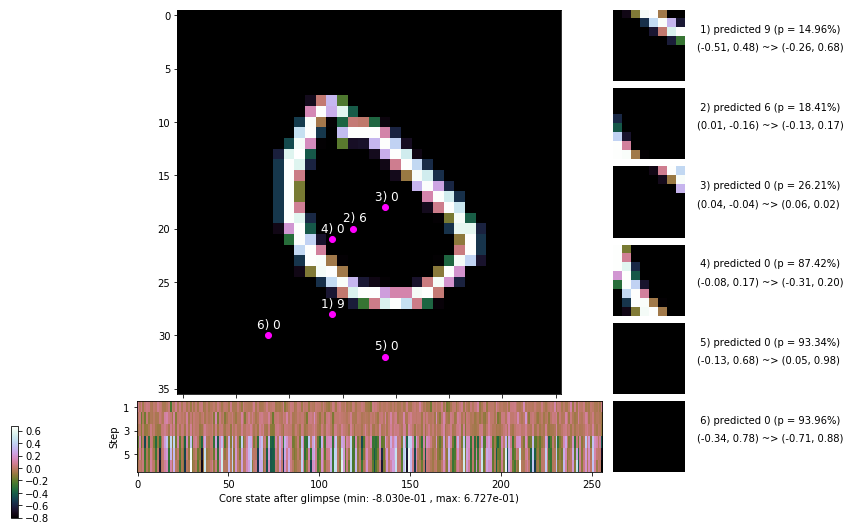

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 120.8 ms/b | lr: 9.96e-04 | grad 2norm: 10.95 | grad inf norm:  3.338
         Weights || abs max:  0.52 ( 3469.71) | mean:  7.64e-04 ( 0.03) | var: 5.82e-03 (  163.74)
          Biases || abs max:  0.17 (  453.13) | mean:  1.74e-02 ( 0.66) | var: 1.35e-03 ( 1632.63)
                    class loss: 1.320 | steps: 3.729 | reward:  0.721 | acc.: 54.53%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 117.2 ms/b | lr: 9.95e-04 | grad 2norm: 11.90 | grad inf norm:  3.583
         Weights || abs max:  0.63 ( 3845.75) | mean:  5.74e-04 ( 0.03) | var: 6.78e-03 (  336.47)
          Biases || abs max:  0.21 (  488.92) | mean:  1.67e-02 ( 0.59) | var: 1.65e-03 ( 1435.97)
                    class loss: 1.190 | steps: 3.550 | reward:  1.094 | acc.: 59.40%

	Target class: 8 | Discounted rewards: [-0.554, -0.541, -

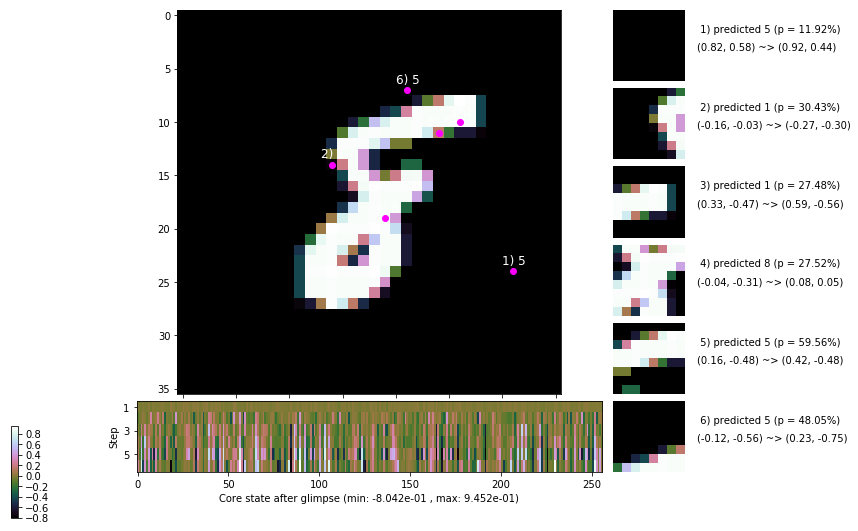

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 120.3 ms/b | lr: 9.93e-04 | grad 2norm: 11.97 | grad inf norm:  3.197
         Weights || abs max:  0.72 ( 7270.61) | mean:  4.09e-04 ( 0.03) | var: 7.60e-03 ( 5424.27)
          Biases || abs max:  0.24 (  459.04) | mean:  1.50e-02 ( 0.50) | var: 1.95e-03 (  774.44)
                    class loss: 1.054 | steps: 3.377 | reward:  1.410 | acc.: 64.03%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 116.6 ms/b | lr: 9.92e-04 | grad 2norm: 13.08 | grad inf norm:  3.549
         Weights || abs max:  0.82 ( 8689.78) | mean:  3.24e-04 ( 0.03) | var: 8.28e-03 ( 3212.12)
          Biases || abs max:  0.27 (  549.29) | mean:  1.39e-02 ( 0.53) | var: 2.25e-03 ( 6508.52)
                    class loss: 0.965 | steps: 3.268 | reward:  1.626 | acc.: 67.20%

	Target class: 8 | Discounted rewards: [-0.556, -0.556, -

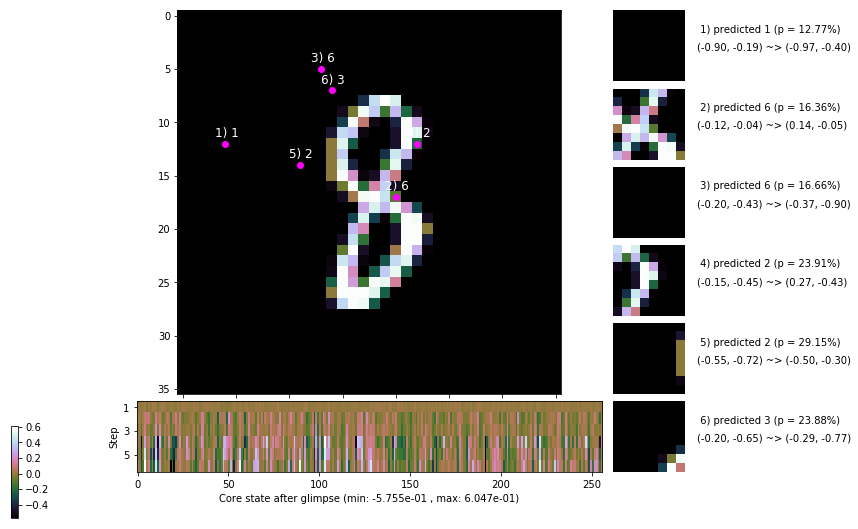

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 116.6 ms/b | lr: 9.90e-04 | grad 2norm: 13.06 | grad inf norm:  3.516
         Weights || abs max:  0.88 ( 5914.36) | mean:  2.65e-04 ( 0.03) | var: 8.96e-03 (  729.44)
          Biases || abs max:  0.30 (  559.94) | mean:  1.24e-02 ( 0.65) | var: 2.61e-03 (12682.47)
                    class loss: 0.940 | steps: 3.199 | reward:  1.749 | acc.: 67.72%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 117.1 ms/b | lr: 9.89e-04 | grad 2norm: 13.12 | grad inf norm:  3.335
         Weights || abs max:  0.95 (12310.86) | mean:  2.44e-04 ( 0.04) | var: 9.57e-03 (16380.56)
          Biases || abs max:  0.33 (  360.76) | mean:  1.07e-02 ( 0.47) | var: 2.97e-03 ( 1102.71)
                    class loss: 0.926 | steps: 3.146 | reward:  1.845 | acc.: 68.30%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

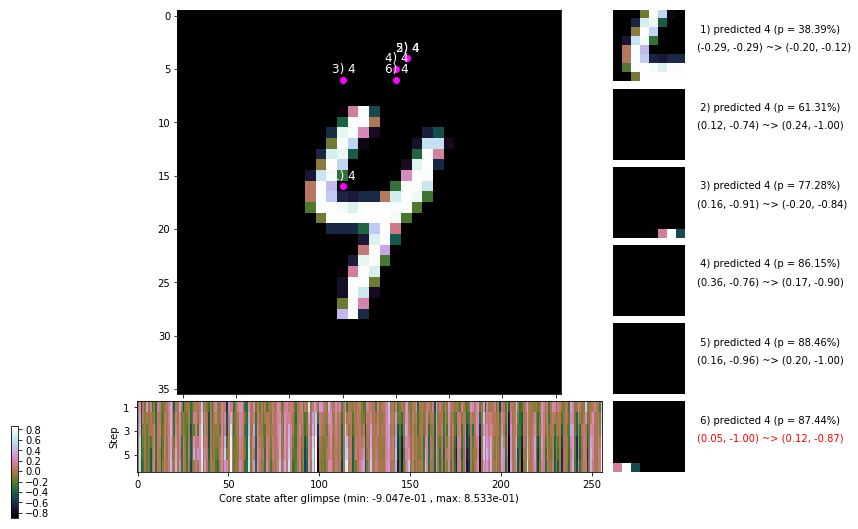

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 124.4 ms/b | lr: 9.87e-04 | grad 2norm: 12.88 | grad inf norm:  3.423
         Weights || abs max:  0.97 ( 5495.18) | mean:  2.41e-04 ( 0.03) | var: 1.01e-02 (  933.87)
          Biases || abs max:  0.36 (  334.74) | mean:  8.36e-03 ( 0.39) | var: 3.33e-03 (  555.34)
                    class loss: 0.910 | steps: 3.096 | reward:  1.937 | acc.: 68.68%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 125.0 ms/b | lr: 9.86e-04 | grad 2norm: 13.27 | grad inf norm:  3.347
         Weights || abs max:  0.99 ( 6040.51) | mean:  1.56e-04 ( 0.03) | var: 1.06e-02 ( 5644.15)
          Biases || abs max:  0.40 (  260.59) | mean:  7.48e-03 ( 0.37) | var: 3.72e-03 (  585.92)
                    class loss: 0.849 | steps: 3.021 | reward:  2.122 | acc.: 71.50%

	Target class: 9 | Discounted rewards: [-0.539, -0.389, 1

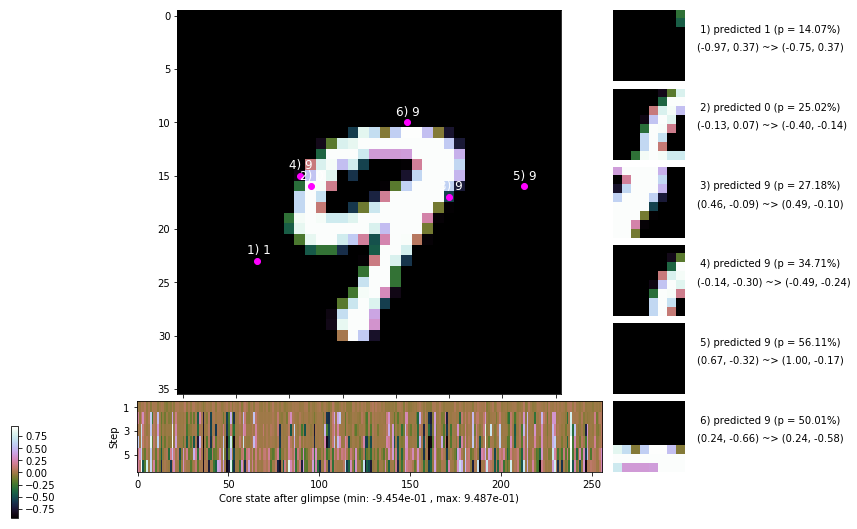

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [-0.555, -0.554, -0.539, -0.390, 1.100, 1.000]


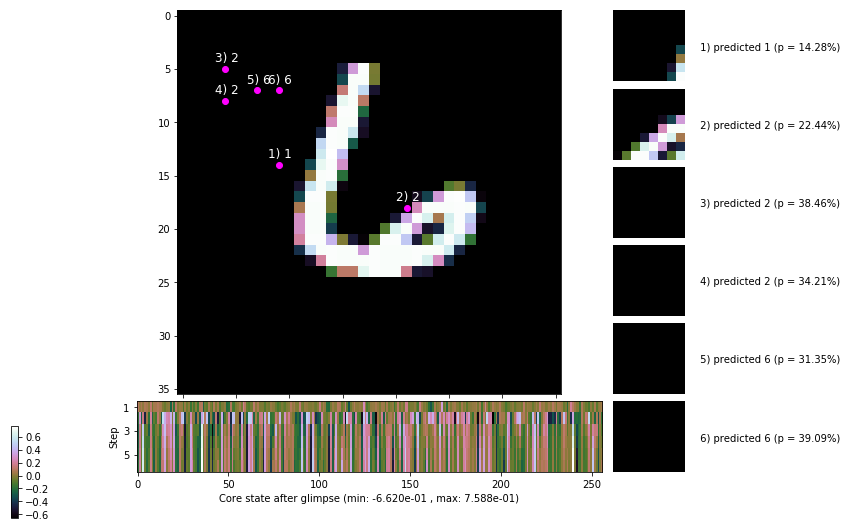


	Target class: 5 | Discounted rewards: [-0.554, -0.539, -0.389, 1.110, 1.100, 1.000]


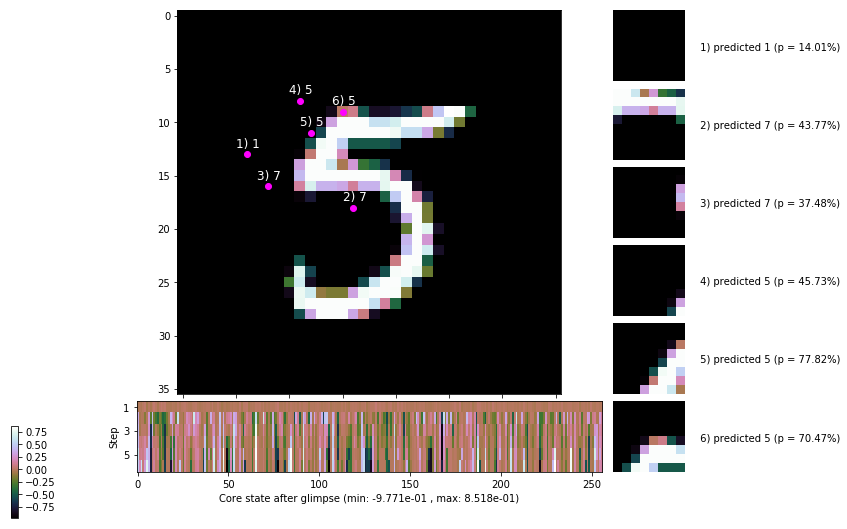

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


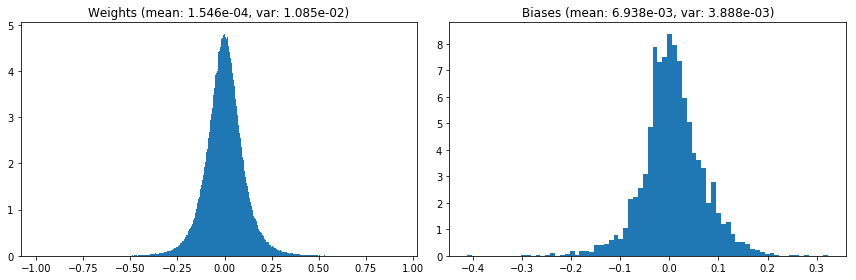

                                      Location network weights and biases


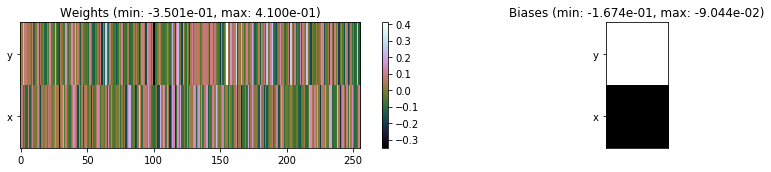

---------------------------------------------------------------------------------------------------------------
Elapsed time:  364.19 sec | TRAIN >> class loss: 1.1776 | steps:  3.515    | reward:  1.1575    | acc.: 59.395% 
                          | VAL   >> class loss: 0.7765 | steps:  2.799    | reward:  2.5131    | acc.: 73.140% 


Epoch   2/400) lr = 0.0009851


H:\Users\Andrew\Anaconda3\envs\conda_jupyter\lib\site-packages\numpy\lib\nanfunctions.py:1315: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe')


 b    300/  3000 >> 129.3 ms/b | lr: 9.84e-04 | grad 2norm: 13.12 | grad inf norm:  3.515
         Weights || abs max:  0.98 (     inf) | mean:  1.41e-04 (  inf) | var: 1.11e-02 (     nan)
          Biases || abs max:  0.43 (  243.01) | mean:  5.51e-03 ( 0.35) | var: 4.09e-03 (  617.51)
                    class loss: 0.806 | steps: 2.954 | reward:  2.285 | acc.: 73.62%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 127.9 ms/b | lr: 9.83e-04 | grad 2norm: 13.55 | grad inf norm:  3.320
         Weights || abs max:  0.98 (     inf) | mean:  6.38e-05 (  inf) | var: 1.16e-02 (     nan)
          Biases || abs max:  0.45 (  349.28) | mean:  4.02e-03 ( 0.34) | var: 4.53e-03 ( 3736.32)
                    class loss: 0.803 | steps: 2.933 | reward:  2.301 | acc.: 73.05%

	Target class: 8 | Discounted rewards: [-0.556, -0.555, -0.554, -0.540, -0.400, 1.000]
	                | Baseline rewards:   [-0.128, 0.145, 0.636, 0.663,

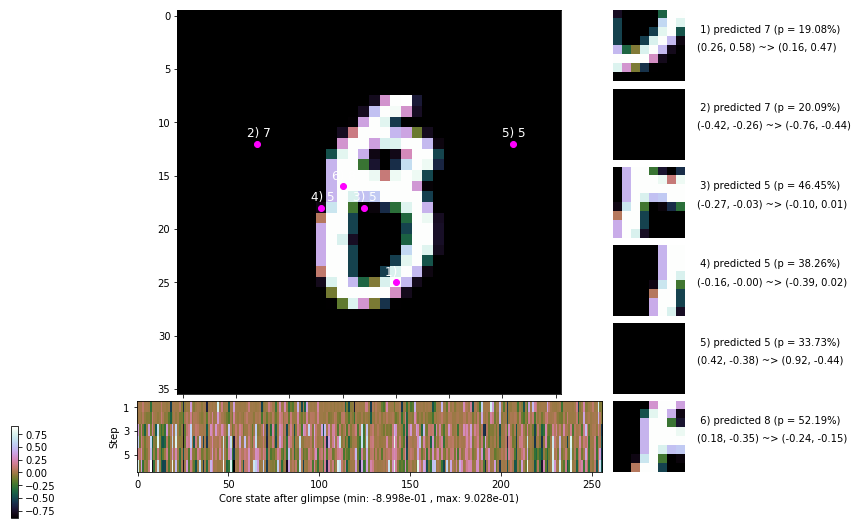

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 116.8 ms/b | lr: 9.81e-04 | grad 2norm: 13.48 | grad inf norm:  3.414
         Weights || abs max:  0.98 ( 4089.58) | mean: -1.04e-05 ( 0.02) | var: 1.20e-02 (  184.13)
          Biases || abs max:  0.48 (  343.26) | mean:  1.75e-03 ( 0.40) | var: 4.96e-03 ( 3064.82)
                    class loss: 0.794 | steps: 2.961 | reward:  2.275 | acc.: 73.40%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 114.2 ms/b | lr: 9.80e-04 | grad 2norm: 13.69 | grad inf norm:  3.416
         Weights || abs max:  0.97 ( 5064.70) | mean: -5.67e-05 ( 0.02) | var: 1.24e-02 ( 2436.14)
          Biases || abs max:  0.49 (  196.06) | mean: -8.16e-04 ( 0.25) | var: 5.34e-03 (  180.56)
                    class loss: 0.759 | steps: 2.906 | reward:  2.352 | acc.: 74.17%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.1

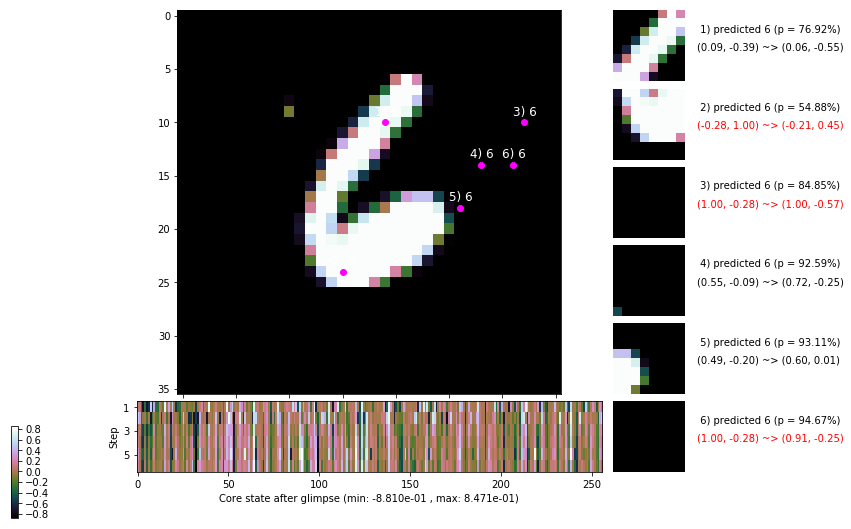

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 116.5 ms/b | lr: 9.78e-04 | grad 2norm: 13.53 | grad inf norm:  3.322
         Weights || abs max:  0.97 ( 4104.11) | mean: -7.65e-05 ( 0.02) | var: 1.28e-02 (  230.31)
          Biases || abs max:  0.51 (  471.33) | mean: -2.71e-03 ( 0.39) | var: 5.74e-03 ( 5810.12)
                    class loss: 0.760 | steps: 2.934 | reward:  2.320 | acc.: 73.60%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 116.3 ms/b | lr: 9.77e-04 | grad 2norm: 13.44 | grad inf norm:  3.186
         Weights || abs max:  0.97 ( 6086.37) | mean: -9.09e-05 ( 0.03) | var: 1.32e-02 ( 3595.10)
          Biases || abs max:  0.53 (  343.94) | mean: -5.18e-03 ( 0.31) | var: 6.17e-03 ( 1811.27)
                    class loss: 0.752 | steps: 2.880 | reward:  2.410 | acc.: 74.20%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

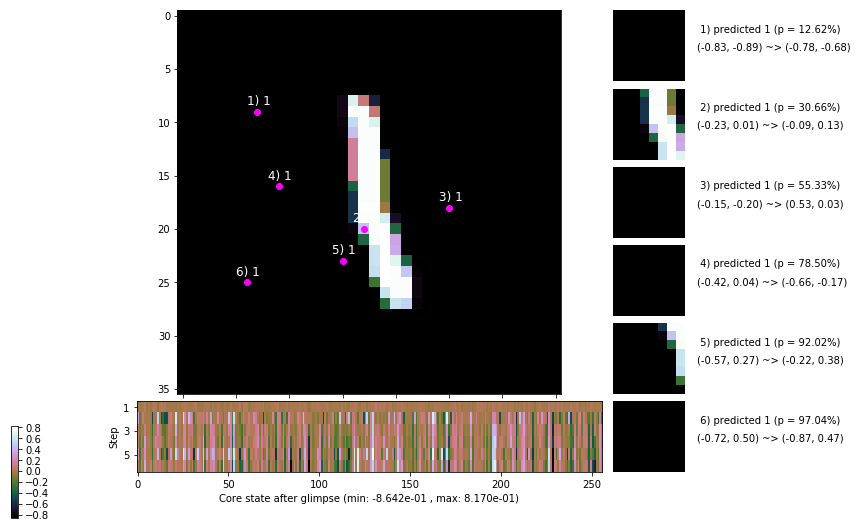

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 126.7 ms/b | lr: 9.75e-04 | grad 2norm: 13.41 | grad inf norm:  3.387
         Weights || abs max:  0.97 ( 3590.74) | mean: -1.25e-04 ( 0.02) | var: 1.35e-02 (  188.49)
          Biases || abs max:  0.54 (  163.05) | mean: -7.72e-03 ( 0.23) | var: 6.58e-03 (  312.56)
                    class loss: 0.746 | steps: 2.934 | reward:  2.353 | acc.: 74.42%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 118.8 ms/b | lr: 9.74e-04 | grad 2norm: 13.45 | grad inf norm:  3.415
         Weights || abs max:  0.99 ( 3026.89) | mean: -9.50e-05 ( 0.02) | var: 1.39e-02 (  109.25)
          Biases || abs max:  0.56 (  164.20) | mean: -9.20e-03 ( 0.22) | var: 6.98e-03 (   86.25)
                    class loss: 0.730 | steps: 2.881 | reward:  2.422 | acc.: 75.35%

	Target class: 4 | Discounted rewards: [-0.391, 1.094, 0.

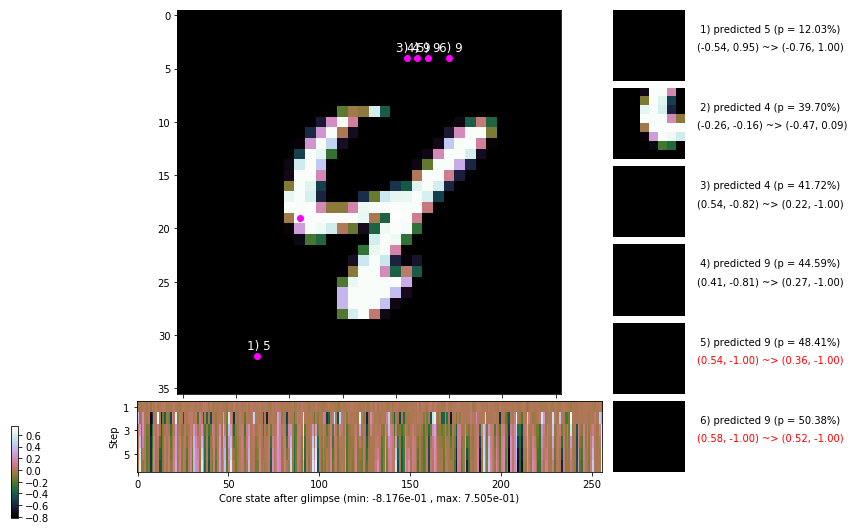

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 115.7 ms/b | lr: 9.72e-04 | grad 2norm: 13.50 | grad inf norm:  3.392
         Weights || abs max:  0.99 ( 5670.71) | mean: -9.51e-05 ( 0.03) | var: 1.43e-02 ( 1268.44)
          Biases || abs max:  0.58 (  401.93) | mean: -1.13e-02 ( 0.41) | var: 7.42e-03 ( 9947.76)
                    class loss: 0.708 | steps: 2.844 | reward:  2.511 | acc.: 76.55%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 137.0 ms/b | lr: 9.71e-04 | grad 2norm: 13.40 | grad inf norm:  3.352
         Weights || abs max:  0.99 ( 3969.88) | mean: -1.26e-04 ( 0.02) | var: 1.46e-02 (  161.67)
          Biases || abs max:  0.59 (  402.04) | mean: -1.32e-02 ( 0.33) | var: 7.86e-03 ( 4644.02)
                    class loss: 0.685 | steps: 2.841 | reward:  2.504 | acc.: 76.57%

	Target class: 7 | Discounted rewards: [-0.554, -0.539, -

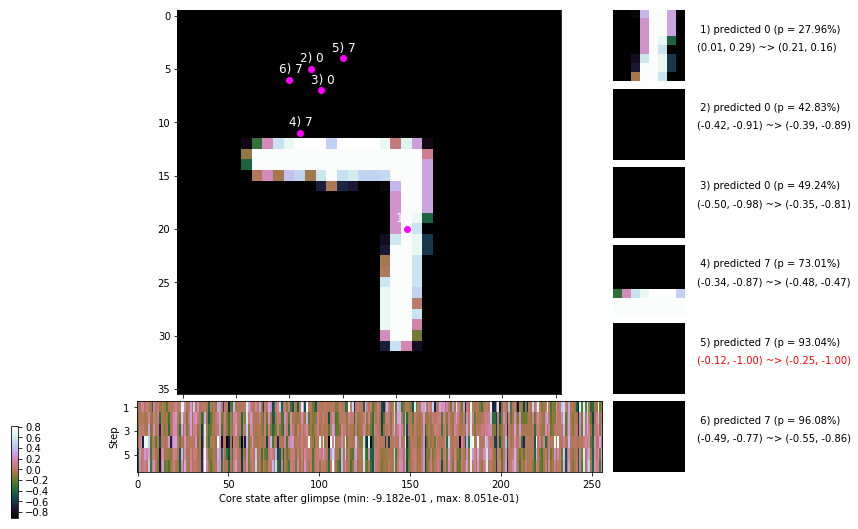

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


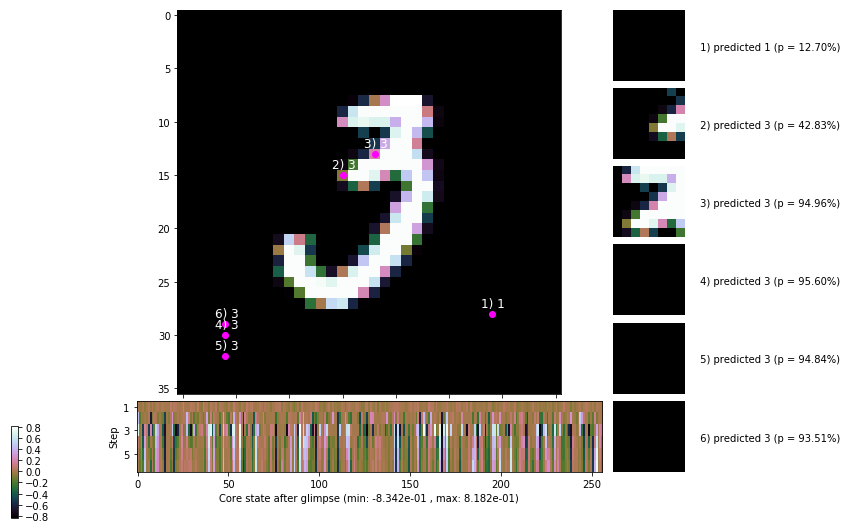


	Target class: 7 | Discounted rewards: [0.944, -0.556, -0.556, -0.555, -0.550, -0.500]


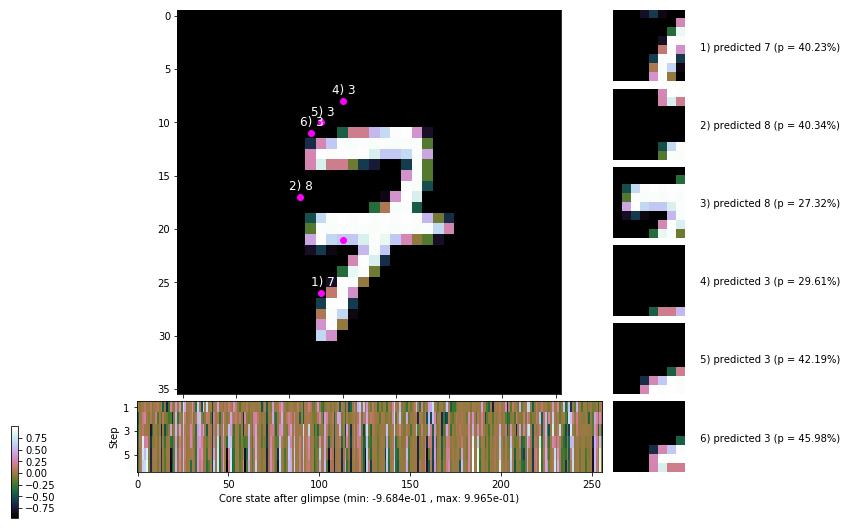

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


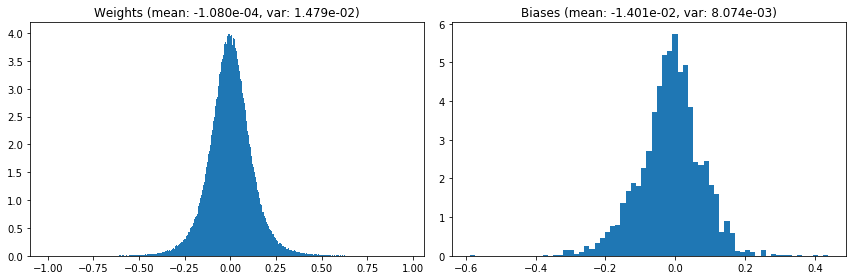

                                      Location network weights and biases


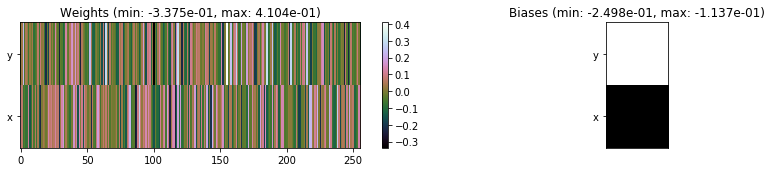

---------------------------------------------------------------------------------------------------------------
Elapsed time:  366.48 sec | TRAIN >> class loss: 0.7542 | steps:  2.907    | reward:  2.3734    | acc.: 74.492% 
                          | VAL   >> class loss: 0.6439 | steps:  2.711    | reward:  2.7936    | acc.: 78.420% 


Epoch   3/400) lr = 0.0009704
 b    300/  3000 >> 121.6 ms/b | lr: 9.69e-04 | grad 2norm: 13.77 | grad inf norm:  3.271
         Weights || abs max:  1.01 ( 6801.00) | mean: -9.05e-05 ( 0.03) | var: 1.49e-02 ( 4787.52)
          Biases || abs max:  0.60 (  111.65) | mean: -1.51e-02 ( 0.17) | var: 8.28e-03 (   56.22)
                    class loss: 0.660 | steps: 2.848 | reward:  2.523 | acc.: 77.67%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 124.9 ms/b | lr: 9.68e-04 | grad 2norm: 13.54 | grad inf norm:  3.261
         Weights || abs max:  1.01 ( 6011.92) | mean: -6.12e-05 ( 0.0

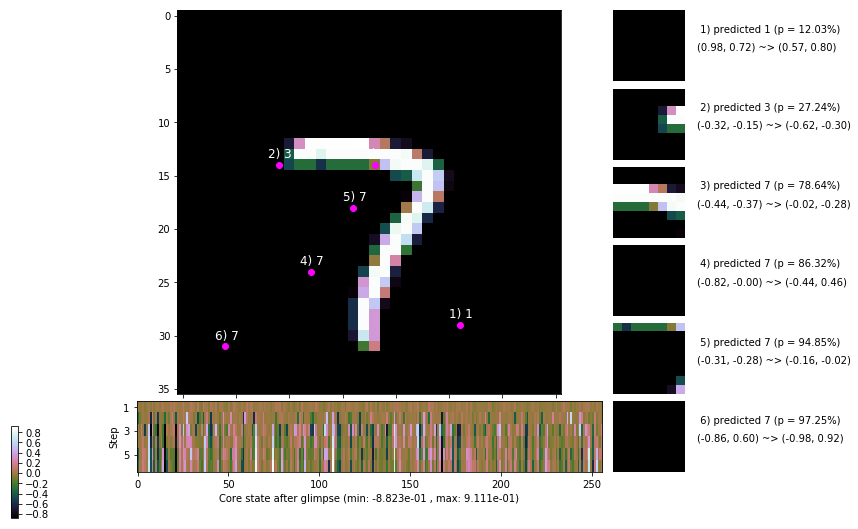

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 116.4 ms/b | lr: 9.67e-04 | grad 2norm: 13.93 | grad inf norm:  3.348
         Weights || abs max:  1.01 ( 6142.00) | mean: -9.27e-05 ( 0.03) | var: 1.56e-02 ( 1340.27)
          Biases || abs max:  0.61 ( 3454.25) | mean: -1.82e-02 ( 2.74) | var: 9.08e-03 (2520178.50)
                    class loss: 0.585 | steps: 2.745 | reward:  2.757 | acc.: 80.55%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 115.6 ms/b | lr: 9.66e-04 | grad 2norm: 13.85 | grad inf norm:  3.198
         Weights || abs max:  1.03 ( 4206.81) | mean: -7.73e-05 ( 0.02) | var: 1.59e-02 (  380.81)
          Biases || abs max:  0.62 (  546.02) | mean: -1.89e-02 ( 0.33) | var: 9.32e-03 (19983.44)
                    class loss: 0.535 | steps: 2.687 | reward:  2.845 | acc.: 81.72%

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 

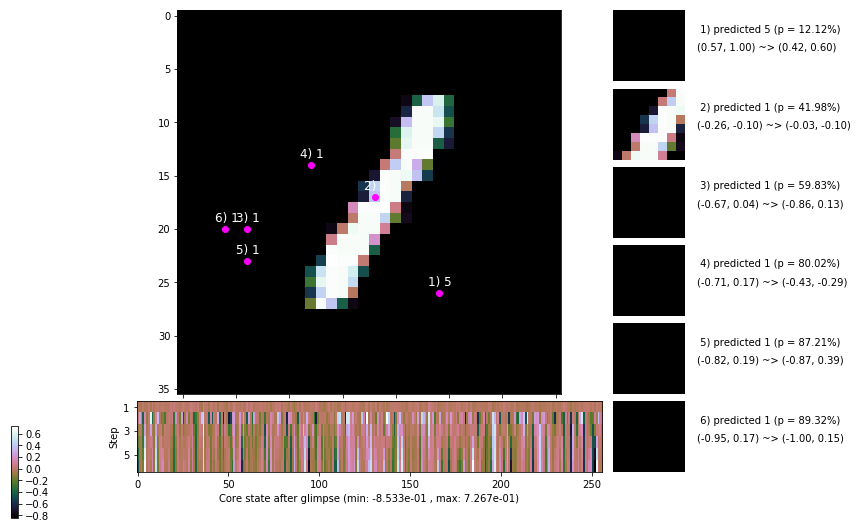

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 114.6 ms/b | lr: 9.64e-04 | grad 2norm: 13.84 | grad inf norm:  3.308
         Weights || abs max:  1.05 ( 9696.92) | mean: -6.83e-05 ( 0.03) | var: 1.62e-02 (15758.79)
          Biases || abs max:  0.62 (  135.76) | mean: -2.05e-02 ( 0.15) | var: 9.58e-03 (  246.19)
                    class loss: 0.507 | steps: 2.655 | reward:  2.906 | acc.: 82.90%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 113.1 ms/b | lr: 9.63e-04 | grad 2norm: 13.81 | grad inf norm:  3.228
         Weights || abs max:  1.06 ( 5535.46) | mean: -5.02e-05 ( 0.02) | var: 1.65e-02 (  857.09)
          Biases || abs max:  0.62 (  200.88) | mean: -2.23e-02 ( 0.22) | var: 9.89e-03 ( 2710.05)
                    class loss: 0.514 | steps: 2.655 | reward:  2.934 | acc.: 83.33%

	Target class: 7 | Discounted rewards: [-0.389, 1.111, 1.

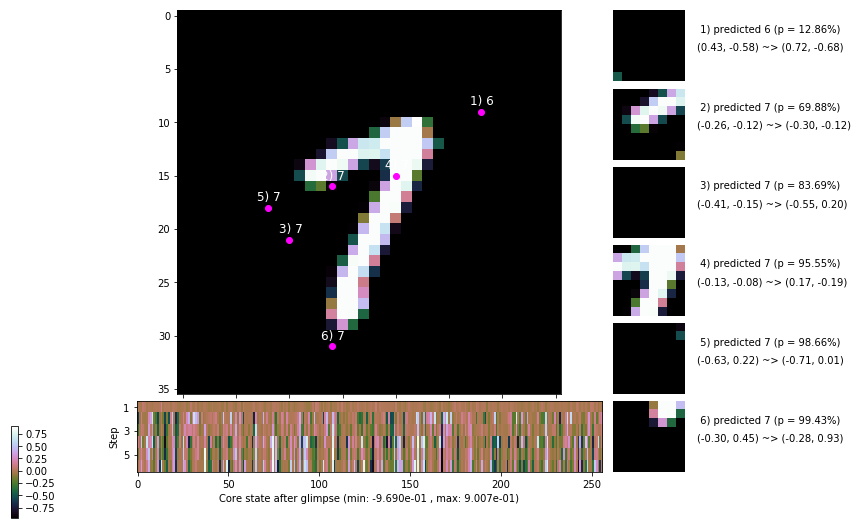

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 114.1 ms/b | lr: 9.61e-04 | grad 2norm: 13.77 | grad inf norm:  3.104
         Weights || abs max:  1.07 ( 8500.41) | mean: -3.57e-05 ( 0.03) | var: 1.68e-02 ( 6925.57)
          Biases || abs max:  0.64 (  185.87) | mean: -2.44e-02 ( 0.18) | var: 1.02e-02 (  575.98)
                    class loss: 0.552 | steps: 2.679 | reward:  2.839 | acc.: 81.75%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 112.8 ms/b | lr: 9.60e-04 | grad 2norm: 13.82 | grad inf norm:  3.287
         Weights || abs max:  1.07 ( 4578.91) | mean: -5.35e-05 ( 0.02) | var: 1.72e-02 (  637.37)
          Biases || abs max:  0.63 (  211.00) | mean: -2.54e-02 ( 0.23) | var: 1.06e-02 ( 1924.36)
                    class loss: 0.532 | steps: 2.630 | reward:  2.913 | acc.: 81.95%

	Target class: 3 | Discounted rewards: [0.944, -0.556, -0

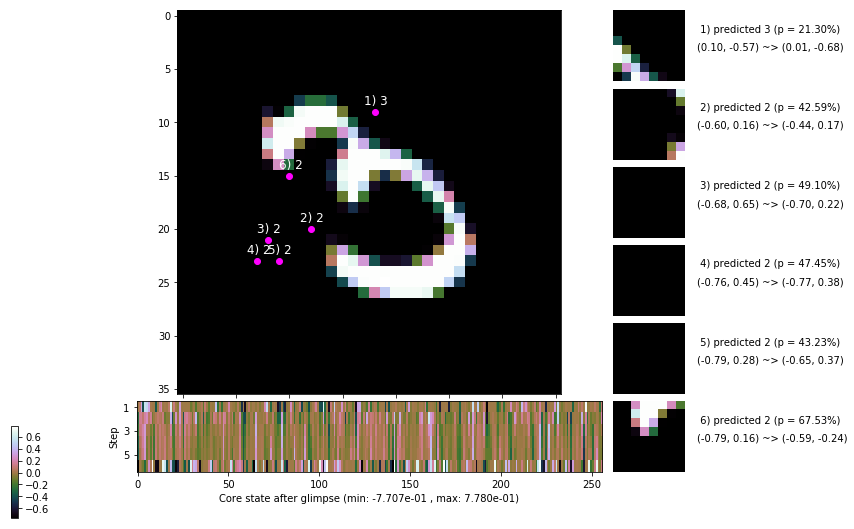

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 120.7 ms/b | lr: 9.58e-04 | grad 2norm: 13.73 | grad inf norm:  3.180
         Weights || abs max:  1.09 ( 4003.05) | mean: -1.45e-05 ( 0.02) | var: 1.75e-02 (  511.47)
          Biases || abs max:  0.64 (  397.64) | mean: -2.77e-02 ( 0.29) | var: 1.10e-02 ( 4972.05)
                    class loss: 0.523 | steps: 2.626 | reward:  2.934 | acc.: 83.17%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 122.0 ms/b | lr: 9.57e-04 | grad 2norm: 13.53 | grad inf norm:  3.113
         Weights || abs max:  1.10 ( 6043.50) | mean: -8.11e-06 ( 0.02) | var: 1.78e-02 ( 1624.66)
          Biases || abs max:  0.64 (  182.21) | mean: -2.92e-02 ( 0.18) | var: 1.14e-02 (  600.87)
                    class loss: 0.493 | steps: 2.579 | reward:  3.052 | acc.: 84.28%

	Target class: 8 | Discounted rewards: [1.111, 1.111, 1.1

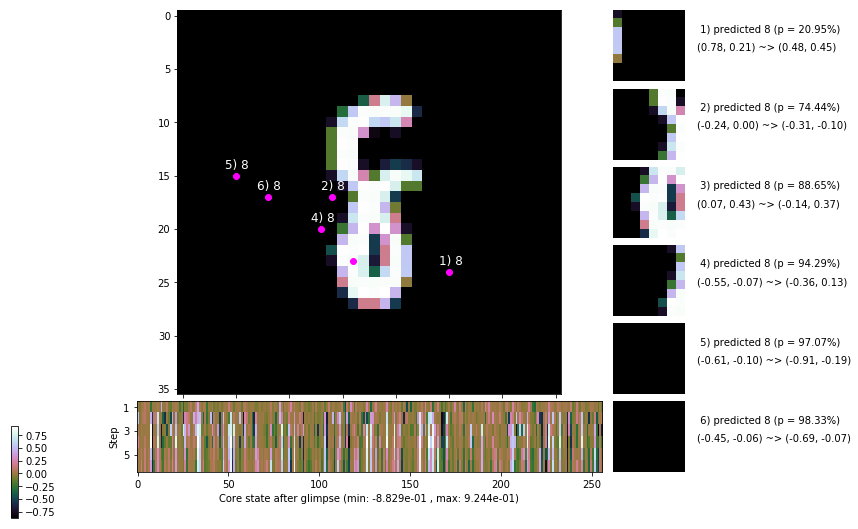

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


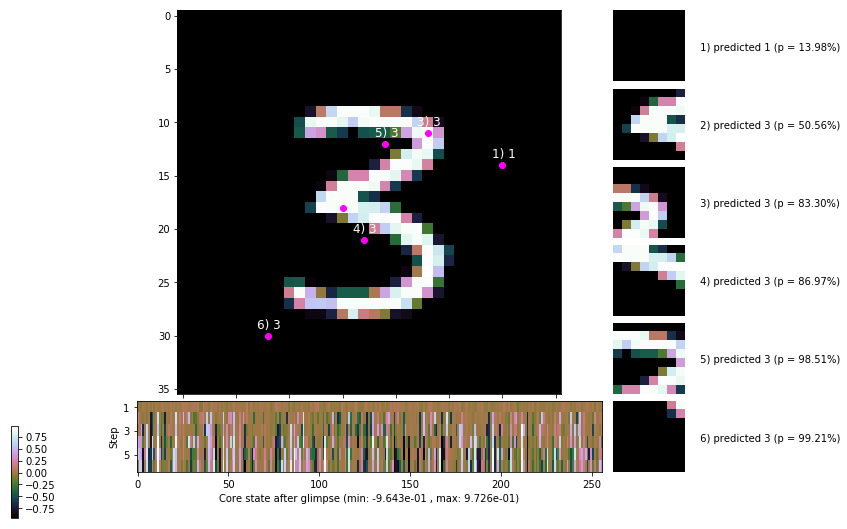


	Target class: 4 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


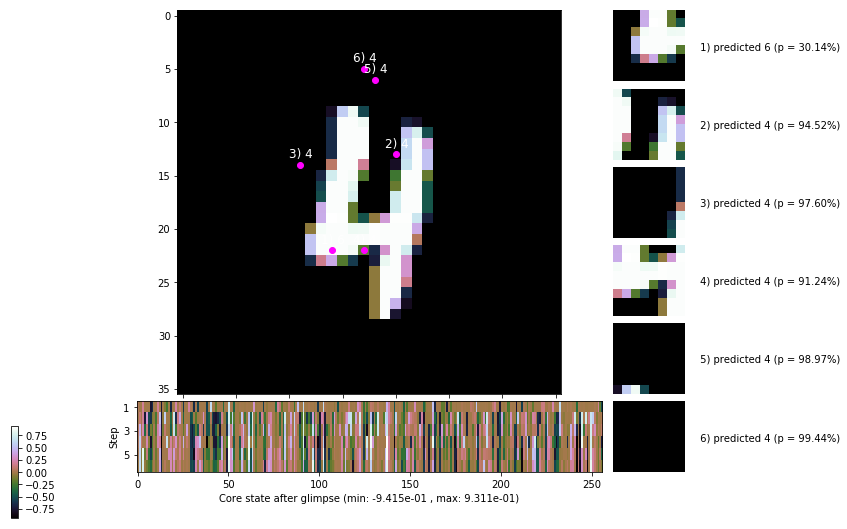

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


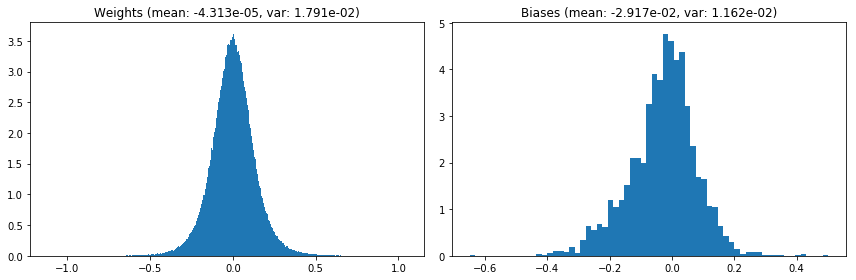

                                      Location network weights and biases


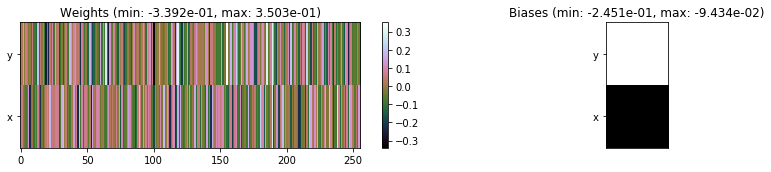

---------------------------------------------------------------------------------------------------------------
Elapsed time:  353.24 sec | TRAIN >> class loss: 0.5547 | steps:  2.690    | reward:  2.8316    | acc.: 81.585% 
                          | VAL   >> class loss: 0.4741 | steps:  2.484    | reward:  3.2154    | acc.: 84.020% 


Epoch   4/400) lr = 0.000956
 b    300/  3000 >> 114.5 ms/b | lr: 9.55e-04 | grad 2norm: 13.69 | grad inf norm:  3.198
         Weights || abs max:  1.11 (11667.08) | mean: -5.51e-05 ( 0.04) | var: 1.81e-02 (20484.60)
          Biases || abs max:  0.64 (  202.76) | mean: -2.99e-02 ( 0.19) | var: 1.18e-02 (  678.92)
                    class loss: 0.495 | steps: 2.615 | reward:  2.975 | acc.: 83.58%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 113.6 ms/b | lr: 9.54e-04 | grad 2norm: 13.67 | grad inf norm:  3.187
         Weights || abs max:  1.10 ( 4782.86) | mean: -9.69e-05 ( 0.02

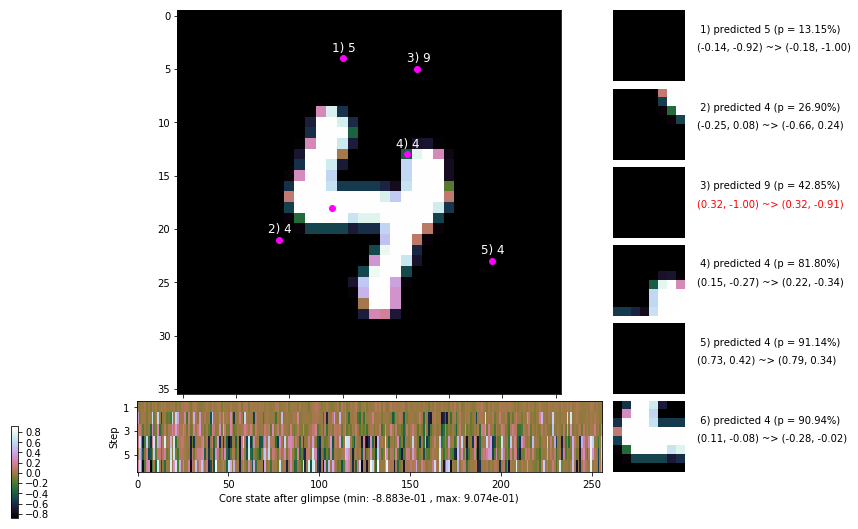

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 123.1 ms/b | lr: 9.52e-04 | grad 2norm: 13.49 | grad inf norm:  3.181
         Weights || abs max:  1.10 ( 3724.48) | mean: -6.55e-05 ( 0.02) | var: 1.87e-02 (  256.39)
          Biases || abs max:  0.66 (  111.94) | mean: -3.24e-02 ( 0.14) | var: 1.27e-02 (   95.84)
                    class loss: 0.506 | steps: 2.628 | reward:  2.985 | acc.: 83.92%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 126.5 ms/b | lr: 9.51e-04 | grad 2norm: 13.87 | grad inf norm:  3.102
         Weights || abs max:  1.09 (     inf) | mean: -2.68e-05 (  inf) | var: 1.90e-02 (     nan)
          Biases || abs max:  0.67 (  129.26) | mean: -3.36e-02 ( 0.13) | var: 1.31e-02 (  109.56)
                    class loss: 0.484 | steps: 2.602 | reward:  3.006 | acc.: 83.35%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.1

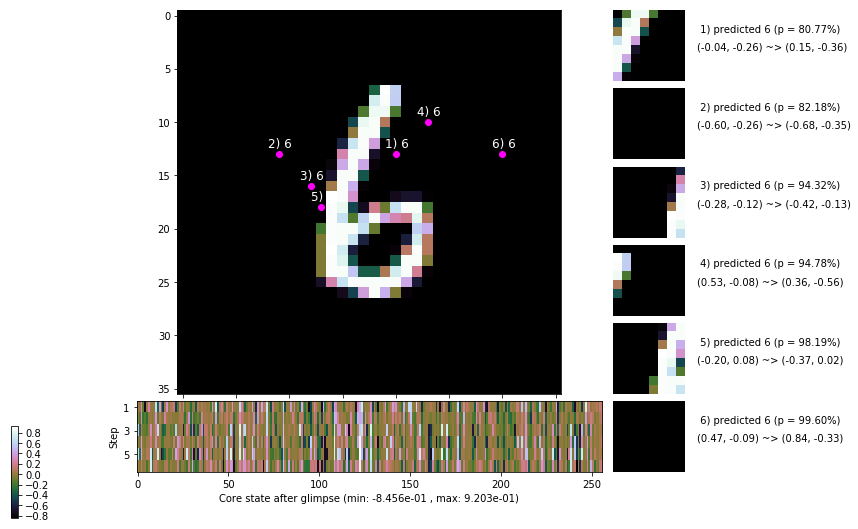

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 124.4 ms/b | lr: 9.49e-04 | grad 2norm: 13.93 | grad inf norm:  3.204
         Weights || abs max:  1.10 ( 5679.41) | mean: -1.55e-05 ( 0.02) | var: 1.92e-02 ( 3894.59)
          Biases || abs max:  0.68 (  112.12) | mean: -3.54e-02 ( 0.14) | var: 1.34e-02 (  144.49)
                    class loss: 0.485 | steps: 2.597 | reward:  3.020 | acc.: 83.98%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 120.1 ms/b | lr: 9.48e-04 | grad 2norm: 13.76 | grad inf norm:  3.133
         Weights || abs max:  1.11 ( 5230.96) | mean: -1.93e-05 ( 0.02) | var: 1.96e-02 (  698.23)
          Biases || abs max:  0.68 (  150.27) | mean: -3.60e-02 ( 0.17) | var: 1.37e-02 (  405.49)
                    class loss: 0.472 | steps: 2.563 | reward:  3.077 | acc.: 84.37%

	Target class: 3 | Discounted rewards: [-0.389, 1.111, 1.

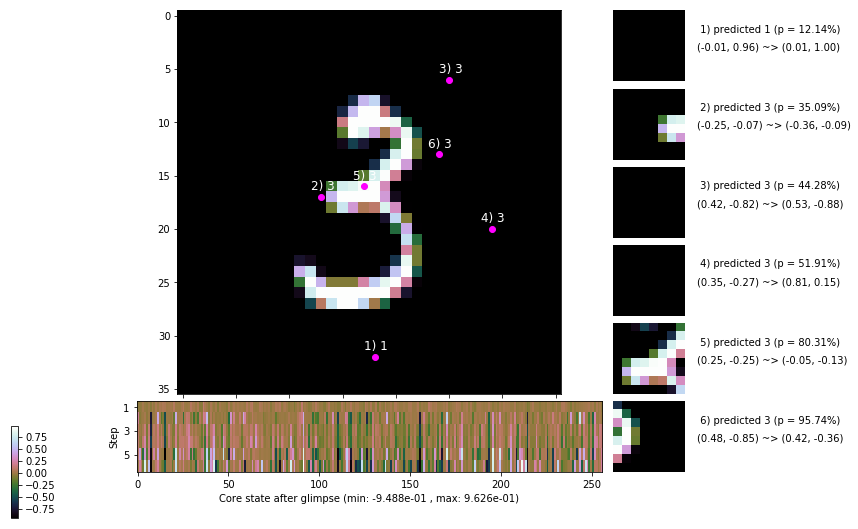

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 134.0 ms/b | lr: 9.46e-04 | grad 2norm: 13.52 | grad inf norm:  3.037
         Weights || abs max:  1.12 ( 4125.11) | mean: -4.63e-05 ( 0.02) | var: 1.99e-02 (  406.56)
          Biases || abs max:  0.69 (  442.17) | mean: -3.75e-02 ( 0.26) | var: 1.42e-02 (12541.74)
                    class loss: 0.470 | steps: 2.591 | reward:  3.043 | acc.: 84.45%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 127.9 ms/b | lr: 9.46e-04 | grad 2norm: 13.51 | grad inf norm:  3.127
         Weights || abs max:  1.13 (36792.45) | mean: -3.66e-05 ( 0.08) | var: 2.02e-02 (560700.62)
          Biases || abs max:  0.69 (   98.32) | mean: -3.91e-02 ( 0.13) | var: 1.47e-02 (   75.98)
                    class loss: 0.481 | steps: 2.599 | reward:  3.039 | acc.: 84.43%

	Target class: 6 | Discounted rewards: [-0.554, -0.539, 

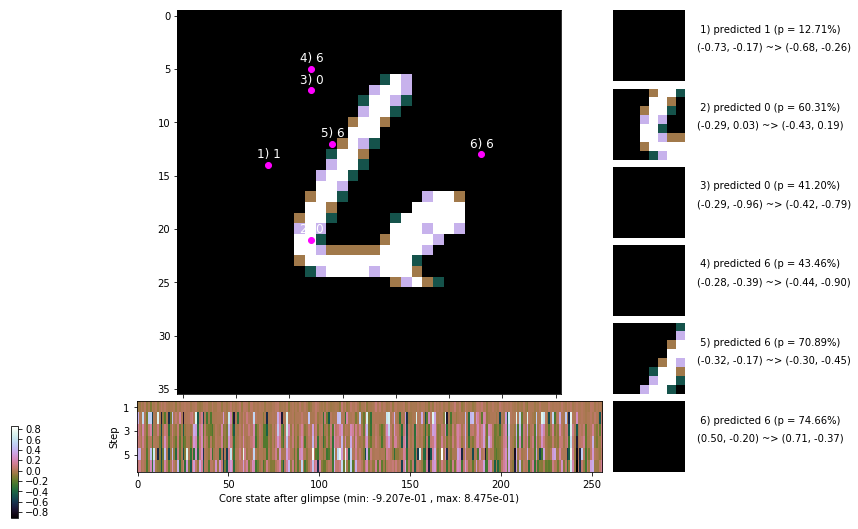

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 129.6 ms/b | lr: 9.44e-04 | grad 2norm: 13.39 | grad inf norm:  3.062
         Weights || abs max:  1.14 (3252400.75) | mean: -8.22e-05 ( 5.99) | var: 2.05e-02 (5834345472.00)
          Biases || abs max:  0.68 (  179.16) | mean: -4.04e-02 ( 0.17) | var: 1.52e-02 (  414.47)
                    class loss: 0.453 | steps: 2.593 | reward:  3.064 | acc.: 85.60%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.3 ms/b | lr: 9.43e-04 | grad 2norm: 13.52 | grad inf norm:  3.113
         Weights || abs max:  1.15 ( 4170.17) | mean: -6.41e-05 ( 0.02) | var: 2.07e-02 (  325.74)
          Biases || abs max:  0.68 (   84.01) | mean: -4.15e-02 ( 0.11) | var: 1.55e-02 (   59.06)
                    class loss: 0.452 | steps: 2.574 | reward:  3.082 | acc.: 85.18%

	Target class: 1 | Discounted rewards: [1.111, 1.1

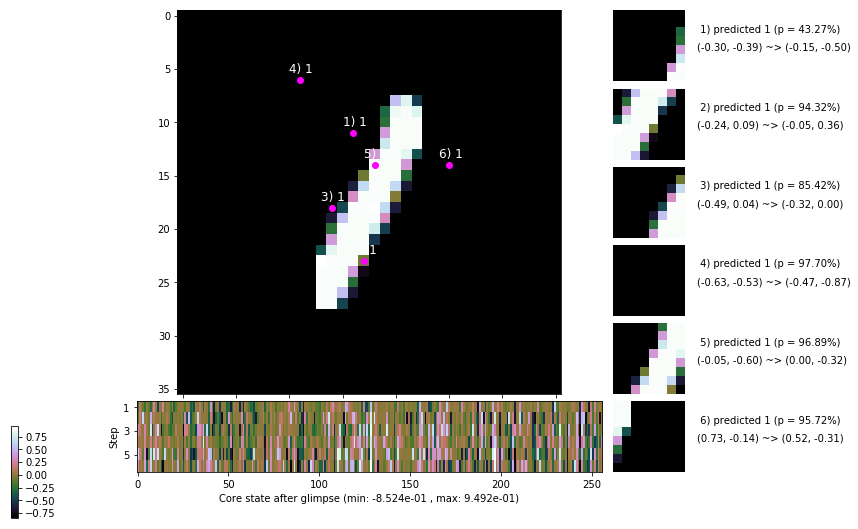

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


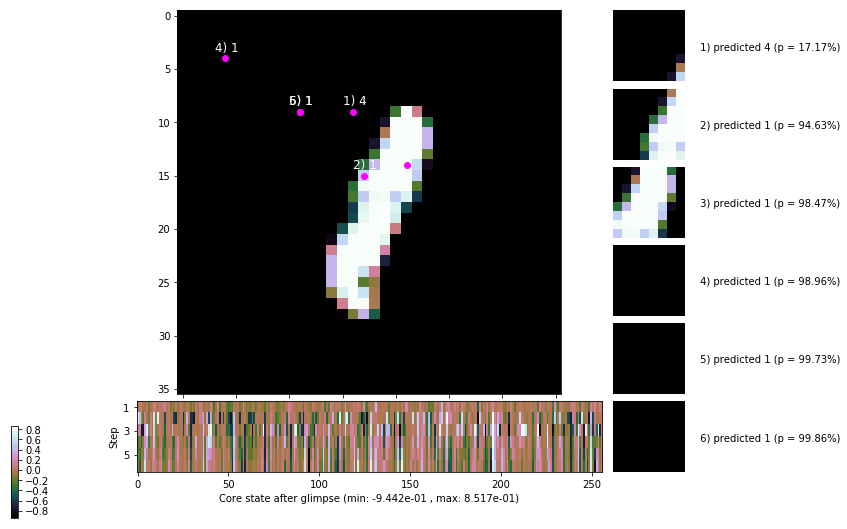


	Target class: 8 | Discounted rewards: [-0.539, -0.391, 1.094, 0.945, -0.550, -0.500]


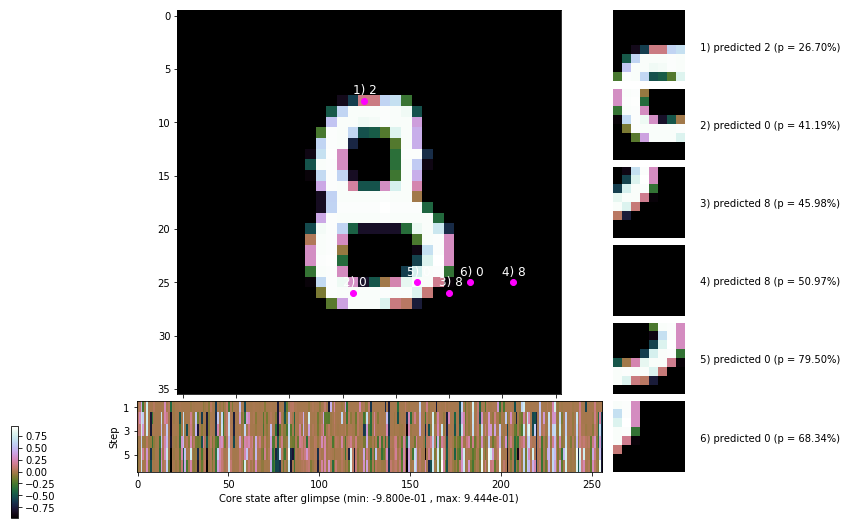

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


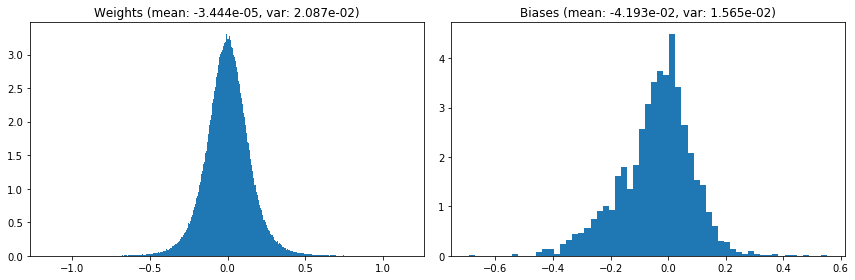

                                      Location network weights and biases


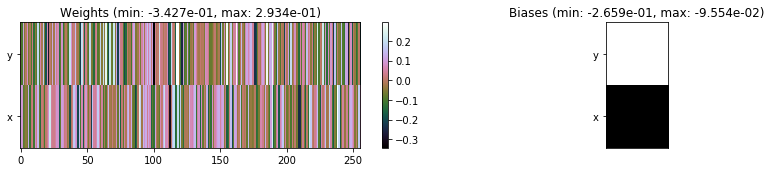

---------------------------------------------------------------------------------------------------------------
Elapsed time:  372.82 sec | TRAIN >> class loss: 0.4812 | steps:  2.599    | reward:  3.0217    | acc.: 84.208% 
                          | VAL   >> class loss: 0.4179 | steps:  2.423    | reward:  3.3558    | acc.: 85.880% 


Epoch   5/400) lr = 0.0009417
 b    300/  3000 >> 127.9 ms/b | lr: 9.41e-04 | grad 2norm: 13.21 | grad inf norm:  2.934
         Weights || abs max:  1.16 ( 5291.38) | mean:  4.83e-05 ( 0.02) | var: 2.10e-02 ( 1733.38)
          Biases || abs max:  0.69 ( 2135.03) | mean: -4.31e-02 ( 0.92) | var: 1.59e-02 (477449.97)
                    class loss: 0.448 | steps: 2.526 | reward:  3.146 | acc.: 85.70%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 127.3 ms/b | lr: 9.40e-04 | grad 2norm: 13.68 | grad inf norm:  3.224
         Weights || abs max:  1.16 (13492.62) | mean:  6.13e-05 ( 0.

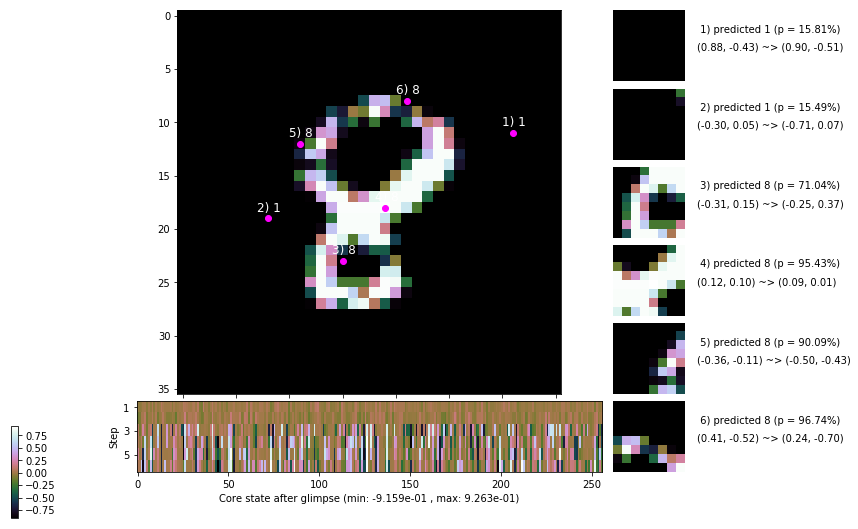

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 130.3 ms/b | lr: 9.38e-04 | grad 2norm: 12.81 | grad inf norm:  2.941
         Weights || abs max:  1.17 ( 5387.29) | mean:  2.49e-05 ( 0.02) | var: 2.15e-02 ( 1033.97)
          Biases || abs max:  0.68 (  186.92) | mean: -4.56e-02 ( 0.15) | var: 1.67e-02 (  793.66)
                    class loss: 0.470 | steps: 2.555 | reward:  3.119 | acc.: 84.62%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 127.6 ms/b | lr: 9.37e-04 | grad 2norm: 13.35 | grad inf norm:  3.078
         Weights || abs max:  1.18 ( 9765.94) | mean:  1.68e-05 ( 0.03) | var: 2.18e-02 (23877.16)
          Biases || abs max:  0.68 (  175.05) | mean: -4.65e-02 ( 0.17) | var: 1.71e-02 (  663.69)
                    class loss: 0.497 | steps: 2.581 | reward:  3.042 | acc.: 83.70%

	Target class: 2 | Discounted rewards: [-0.555, -0.554, -

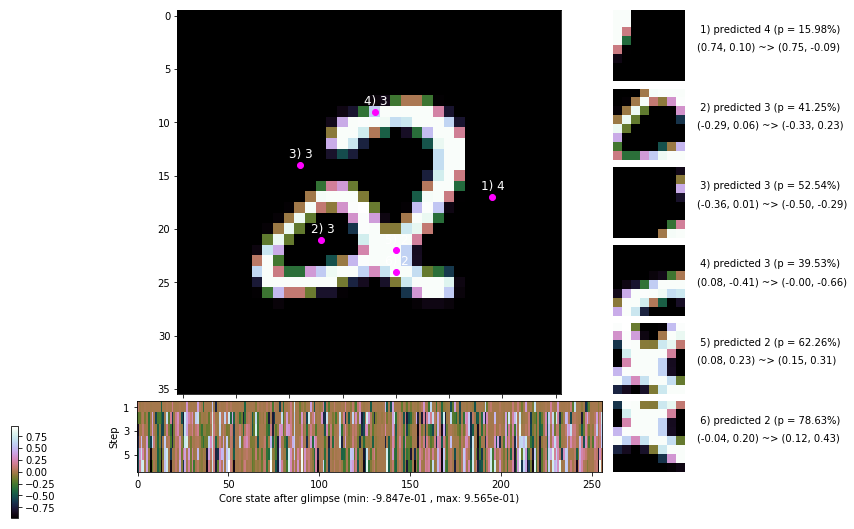

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 128.7 ms/b | lr: 9.35e-04 | grad 2norm: 13.35 | grad inf norm:  3.069
         Weights || abs max:  1.18 ( 4101.81) | mean:  4.37e-05 ( 0.02) | var: 2.21e-02 (  307.33)
          Biases || abs max:  0.68 (  220.22) | mean: -4.74e-02 ( 0.20) | var: 1.75e-02 (  604.02)
                    class loss: 0.480 | steps: 2.583 | reward:  2.994 | acc.: 83.38%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 126.9 ms/b | lr: 9.34e-04 | grad 2norm: 13.46 | grad inf norm:  3.090
         Weights || abs max:  1.18 ( 3477.95) | mean:  2.44e-05 ( 0.02) | var: 2.24e-02 (  159.50)
          Biases || abs max:  0.69 (  319.40) | mean: -4.81e-02 ( 0.24) | var: 1.78e-02 ( 1914.59)
                    class loss: 0.493 | steps: 2.556 | reward:  3.064 | acc.: 83.58%

	Target class: 4 | Discounted rewards: [-0.556, -0.555, -

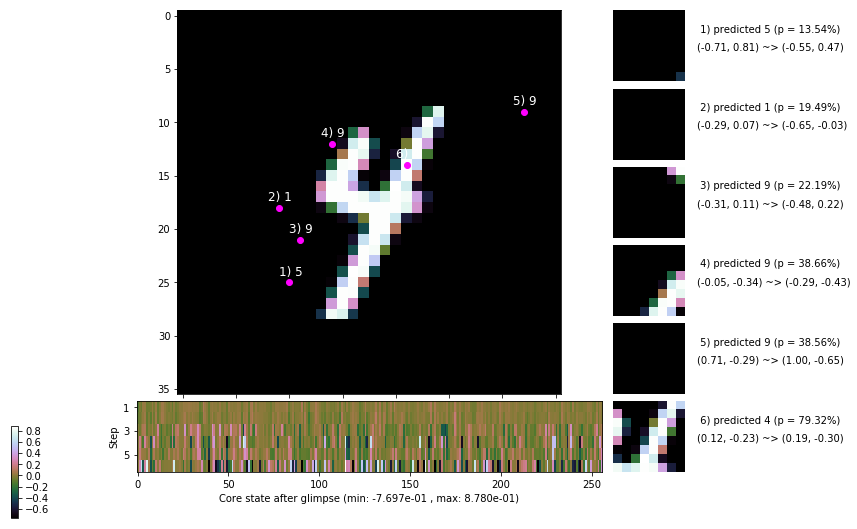

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 132.4 ms/b | lr: 9.32e-04 | grad 2norm: 13.31 | grad inf norm:  3.171
         Weights || abs max:  1.19 ( 3255.29) | mean:  1.98e-05 ( 0.02) | var: 2.26e-02 (  147.09)
          Biases || abs max:  0.69 (   92.73) | mean: -4.87e-02 ( 0.12) | var: 1.83e-02 (   73.85)
                    class loss: 0.492 | steps: 2.595 | reward:  3.054 | acc.: 84.03%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 127.8 ms/b | lr: 9.31e-04 | grad 2norm: 13.42 | grad inf norm:  3.180
         Weights || abs max:  1.19 ( 2750.49) | mean:  3.02e-05 ( 0.02) | var: 2.29e-02 (   89.55)
          Biases || abs max:  0.69 (   80.58) | mean: -4.98e-02 ( 0.11) | var: 1.87e-02 (   34.21)
                    class loss: 0.515 | steps: 2.584 | reward:  3.014 | acc.: 82.67%

	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1.

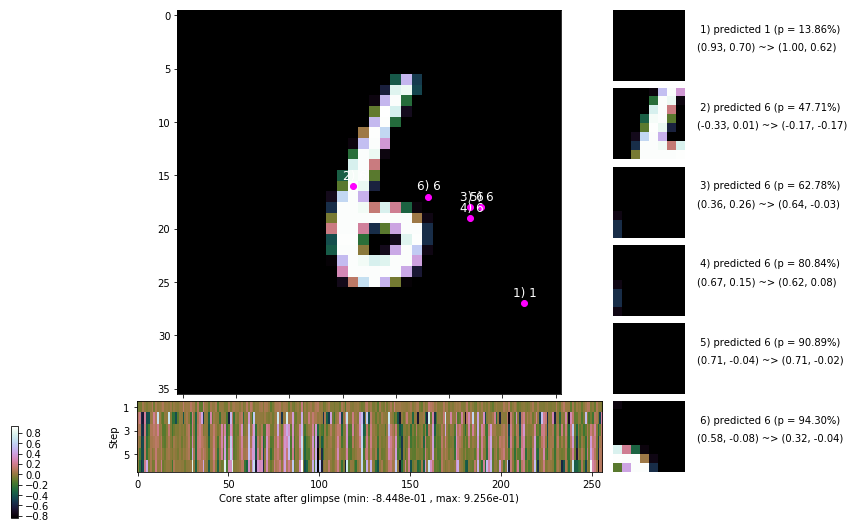

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 153.9 ms/b | lr: 9.30e-04 | grad 2norm: 13.49 | grad inf norm:  3.109
         Weights || abs max:  1.20 ( 5934.25) | mean:  5.52e-05 ( 0.02) | var: 2.32e-02 ( 2073.32)
          Biases || abs max:  0.70 (   98.28) | mean: -5.02e-02 ( 0.10) | var: 1.91e-02 (   45.91)
                    class loss: 0.474 | steps: 2.549 | reward:  3.111 | acc.: 84.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 131.4 ms/b | lr: 9.29e-04 | grad 2norm: 13.15 | grad inf norm:  2.966
         Weights || abs max:  1.23 ( 6318.75) | mean:  8.12e-05 ( 0.02) | var: 2.34e-02 ( 1982.53)
          Biases || abs max:  0.69 (   66.33) | mean: -5.13e-02 ( 0.10) | var: 1.94e-02 (    9.09)
                    class loss: 0.478 | steps: 2.561 | reward:  3.089 | acc.: 83.60%

	Target class: 1 | Discounted rewards: [-0.539, -0.389, 1

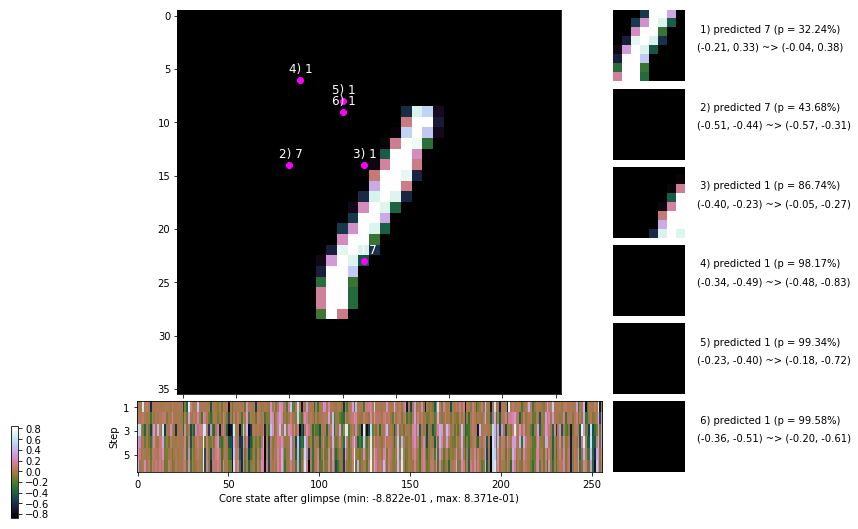

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


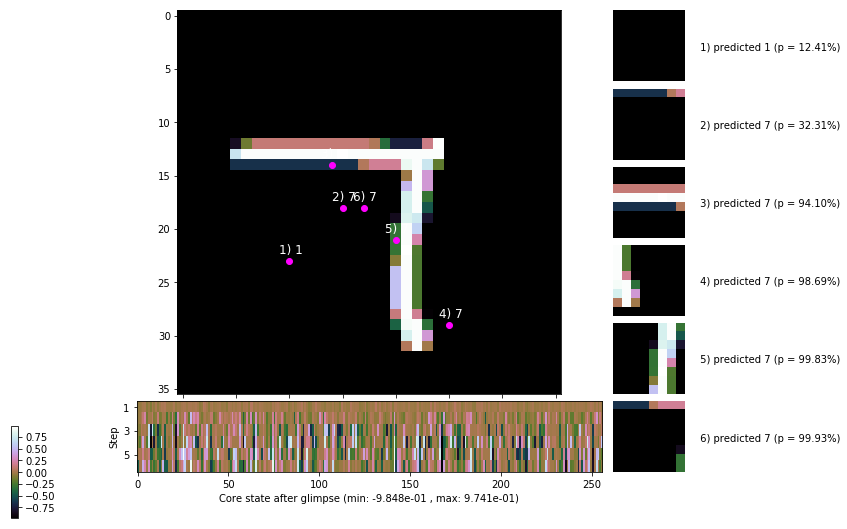


	Target class: 8 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


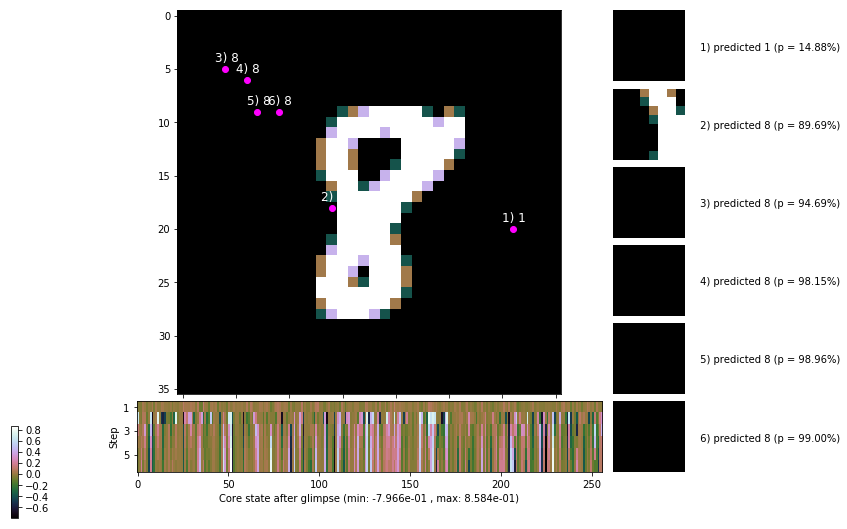

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


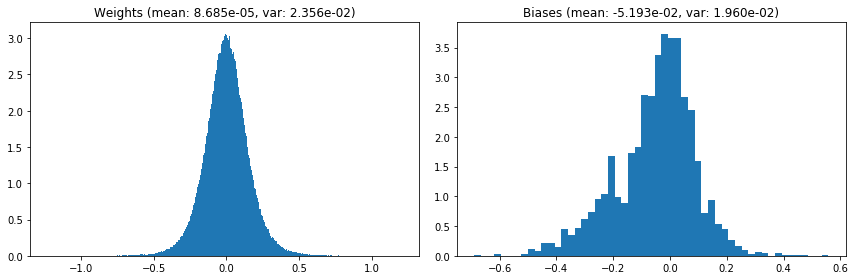

                                      Location network weights and biases


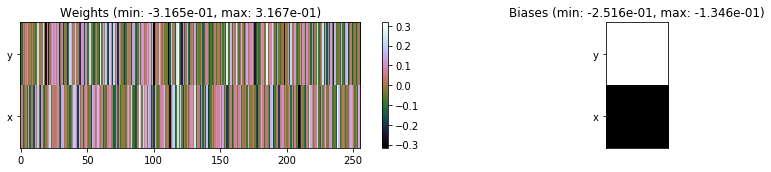

---------------------------------------------------------------------------------------------------------------
Elapsed time:  394.82 sec | TRAIN >> class loss: 0.4819 | steps:  2.566    | reward:  3.0697    | acc.: 83.973% :(
                          | VAL   >> class loss: 0.4545 | steps:  2.436 :( | reward:  3.3030 :( | acc.: 84.640% :(


Epoch   6/400) lr = 0.0009277
 b    300/  3000 >> 124.4 ms/b | lr: 9.27e-04 | grad 2norm: 12.94 | grad inf norm:  3.047
         Weights || abs max:  1.23 ( 1978.40) | mean:  7.21e-05 ( 0.02) | var: 2.37e-02 (   45.83)
          Biases || abs max:  0.69 (  135.32) | mean: -5.24e-02 ( 0.13) | var: 1.98e-02 (  177.76)
                    class loss: 0.465 | steps: 2.544 | reward:  3.110 | acc.: 84.30%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 123.4 ms/b | lr: 9.26e-04 | grad 2norm: 12.94 | grad inf norm:  2.992
         Weights || abs max:  1.24 ( 4695.85) | mean:  1.01e-04 (

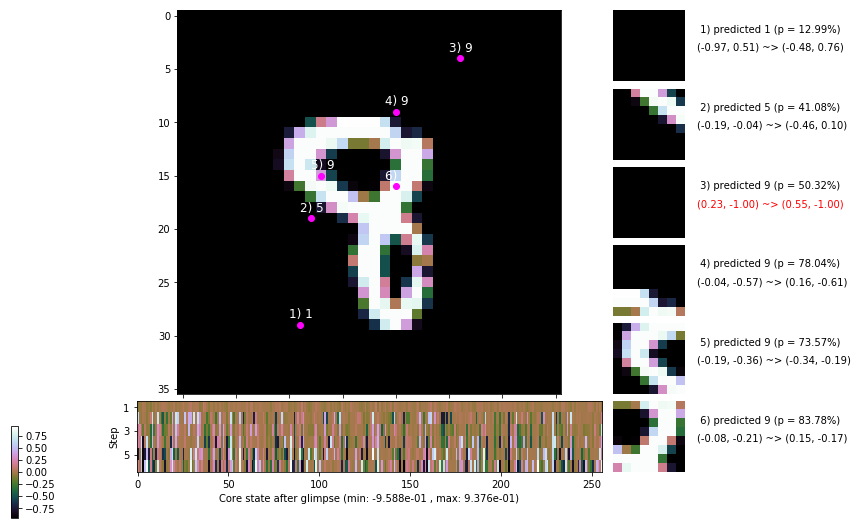

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 126.4 ms/b | lr: 9.24e-04 | grad 2norm: 13.48 | grad inf norm:  3.055
         Weights || abs max:  1.27 ( 3832.66) | mean:  1.14e-04 ( 0.02) | var: 2.42e-02 ( 1058.79)
          Biases || abs max:  0.71 (  113.74) | mean: -5.53e-02 ( 0.14) | var: 2.05e-02 (  303.14)
                    class loss: 0.492 | steps: 2.555 | reward:  3.073 | acc.: 83.45%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 128.6 ms/b | lr: 9.23e-04 | grad 2norm: 13.42 | grad inf norm:  3.131
         Weights || abs max:  1.27 ( 2162.06) | mean:  1.10e-04 ( 0.02) | var: 2.44e-02 (   36.37)
          Biases || abs max:  0.70 (   95.35) | mean: -5.66e-02 ( 0.11) | var: 2.08e-02 (   44.82)
                    class loss: 0.500 | steps: 2.558 | reward:  3.067 | acc.: 83.70%

	Target class: 8 | Discounted rewards: [-0.389, 1.111, 1.

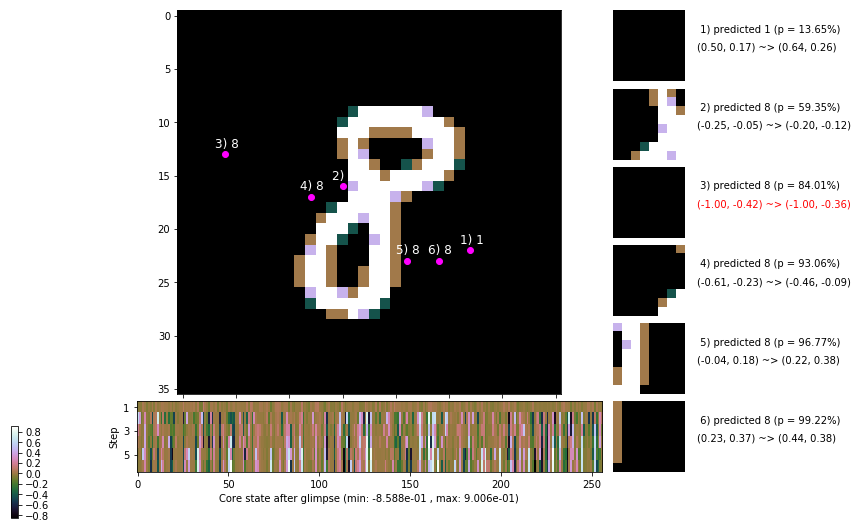

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 129.8 ms/b | lr: 9.21e-04 | grad 2norm: 13.18 | grad inf norm:  3.044
         Weights || abs max:  1.25 ( 4018.48) | mean:  1.23e-04 ( 0.02) | var: 2.47e-02 (  210.17)
          Biases || abs max:  0.69 (  212.03) | mean: -5.66e-02 ( 0.20) | var: 2.13e-02 ( 3479.15)
                    class loss: 0.460 | steps: 2.534 | reward:  3.135 | acc.: 84.63%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 124.1 ms/b | lr: 9.20e-04 | grad 2norm: 12.92 | grad inf norm:  3.113
         Weights || abs max:  1.25 ( 3386.27) | mean:  9.48e-05 ( 0.02) | var: 2.49e-02 (  194.75)
          Biases || abs max:  0.69 (   93.53) | mean: -5.82e-02 ( 0.12) | var: 2.17e-02 (   59.29)
                    class loss: 0.482 | steps: 2.578 | reward:  3.074 | acc.: 83.87%

	Target class: 9 | Discounted rewards: [-0.539, -0.389, 1

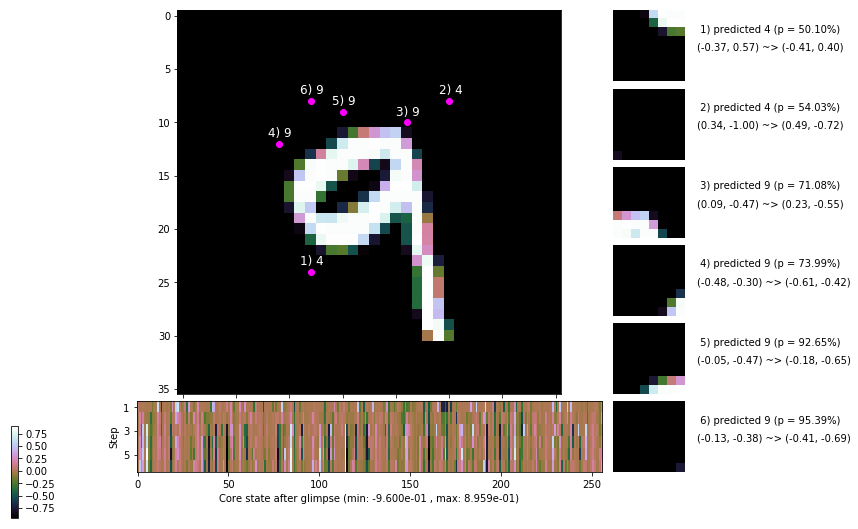

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 131.6 ms/b | lr: 9.18e-04 | grad 2norm: 12.98 | grad inf norm:  3.062
         Weights || abs max:  1.27 ( 3705.16) | mean:  1.44e-05 ( 0.02) | var: 2.52e-02 (  269.39)
          Biases || abs max:  0.69 (   78.50) | mean: -5.80e-02 ( 0.11) | var: 2.20e-02 (   41.68)
                    class loss: 0.450 | steps: 2.496 | reward:  3.188 | acc.: 84.85%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 126.2 ms/b | lr: 9.18e-04 | grad 2norm: 13.19 | grad inf norm:  3.134
         Weights || abs max:  1.28 ( 3985.76) | mean: -7.24e-06 ( 0.02) | var: 2.54e-02 (  513.85)
          Biases || abs max:  0.72 (   98.94) | mean: -5.82e-02 ( 0.12) | var: 2.24e-02 (   49.74)
                    class loss: 0.467 | steps: 2.507 | reward:  3.169 | acc.: 84.65%

	Target class: 8 | Discounted rewards: [-0.539, -0.389, 1

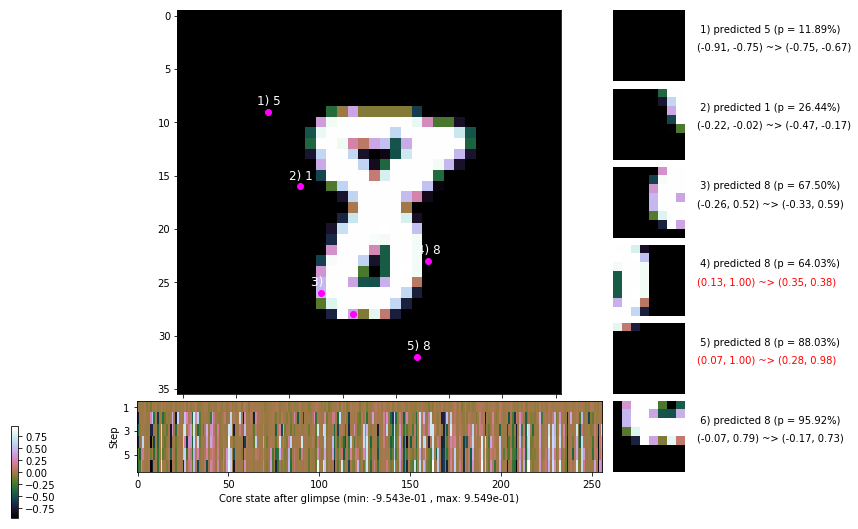

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 127.1 ms/b | lr: 9.16e-04 | grad 2norm: 12.91 | grad inf norm:  3.118
         Weights || abs max:  1.29 ( 2652.91) | mean:  1.21e-06 ( 0.02) | var: 2.57e-02 (   76.57)
          Biases || abs max:  0.71 (  118.62) | mean: -5.89e-02 ( 0.12) | var: 2.27e-02 (  243.05)
                    class loss: 0.427 | steps: 2.505 | reward:  3.215 | acc.: 85.82%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 126.0 ms/b | lr: 9.15e-04 | grad 2norm: 13.01 | grad inf norm:  3.062
         Weights || abs max:  1.30 ( 5056.77) | mean: -3.45e-05 ( 0.02) | var: 2.59e-02 (  779.72)
          Biases || abs max:  0.73 (   65.85) | mean: -6.02e-02 ( 0.10) | var: 2.32e-02 (   22.66)
                    class loss: 0.441 | steps: 2.502 | reward:  3.167 | acc.: 84.75%

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.

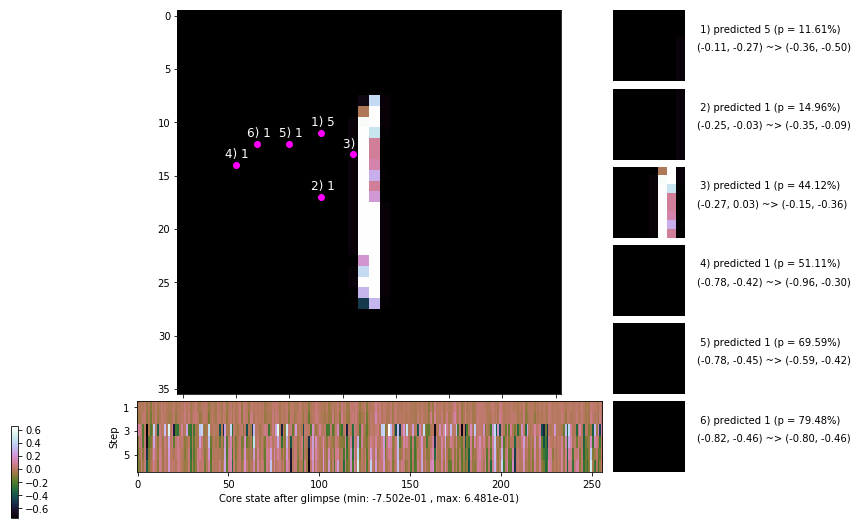

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


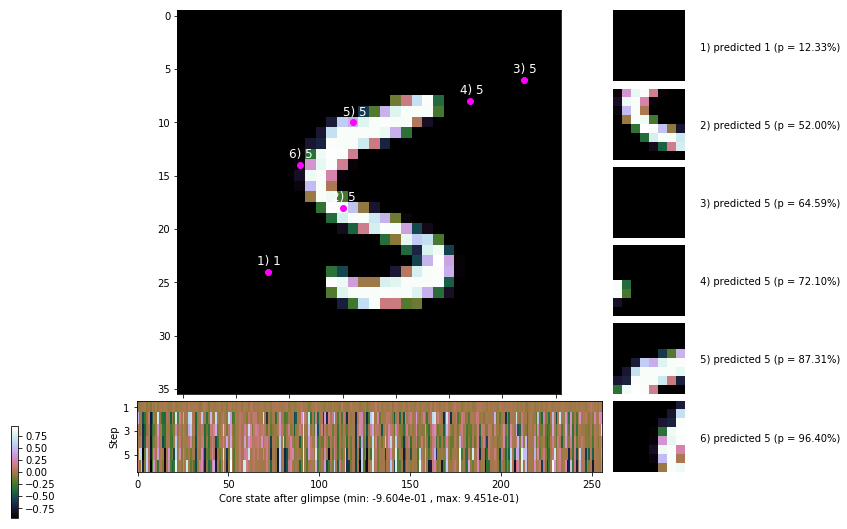


	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


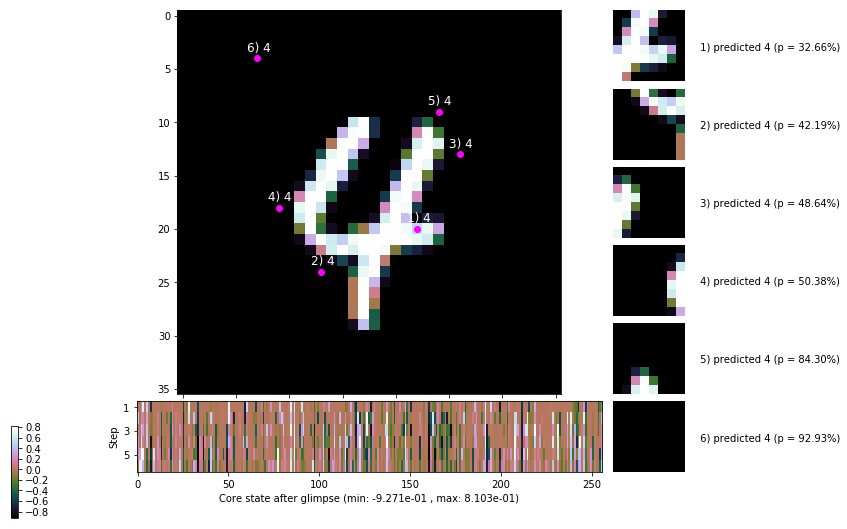

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


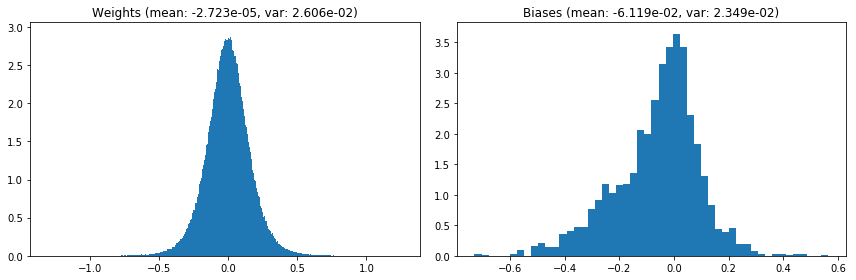

                                      Location network weights and biases


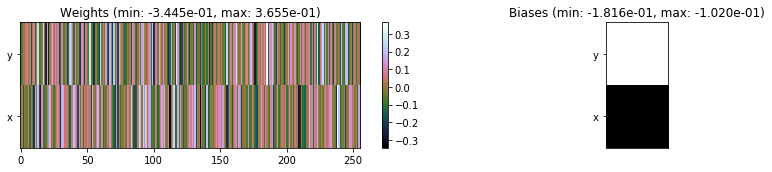

---------------------------------------------------------------------------------------------------------------
Elapsed time:  380.77 sec | TRAIN >> class loss: 0.4637 | steps:  2.531    | reward:  3.1357    | acc.: 84.500% 
                          | VAL   >> class loss: 0.4360 | steps:  2.385    | reward:  3.3600    | acc.: 85.020% :(


Epoch   7/400) lr = 0.0009139
 b    300/  3000 >> 127.0 ms/b | lr: 9.13e-04 | grad 2norm: 12.94 | grad inf norm:  2.949
         Weights || abs max:  1.31 (29641.73) | mean: -5.48e-05 ( 0.07) | var: 2.62e-02 (279974.62)
          Biases || abs max:  0.72 (   72.84) | mean: -6.14e-02 ( 0.10) | var: 2.37e-02 (   17.12)
                    class loss: 0.427 | steps: 2.497 | reward:  3.236 | acc.: 86.47%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 126.5 ms/b | lr: 9.12e-04 | grad 2norm: 13.29 | grad inf norm:  3.066
         Weights || abs max:  1.32 ( 6983.94) | mean: -7.12e-05 ( 

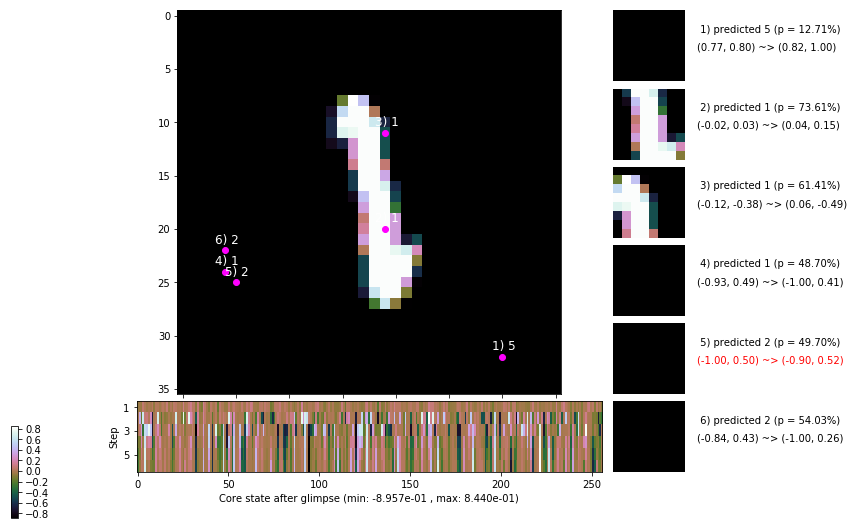

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 132.4 ms/b | lr: 9.10e-04 | grad 2norm: 13.24 | grad inf norm:  3.007
         Weights || abs max:  1.33 ( 3632.10) | mean: -8.65e-05 ( 0.02) | var: 2.67e-02 (  508.38)
          Biases || abs max:  0.72 (   62.55) | mean: -6.28e-02 ( 0.08) | var: 2.42e-02 (   13.35)
                    class loss: 0.411 | steps: 2.429 | reward:  3.308 | acc.: 86.43%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 144.7 ms/b | lr: 9.09e-04 | grad 2norm: 13.04 | grad inf norm:  3.012
         Weights || abs max:  1.34 ( 3179.24) | mean: -9.50e-05 ( 0.02) | var: 2.69e-02 (  252.73)
          Biases || abs max:  0.73 (   57.20) | mean: -6.37e-02 ( 0.09) | var: 2.45e-02 (    8.43)
                    class loss: 0.419 | steps: 2.480 | reward:  3.233 | acc.: 85.97%

	Target class: 4 | Discounted rewards: [-0.389, 1.111, 1.

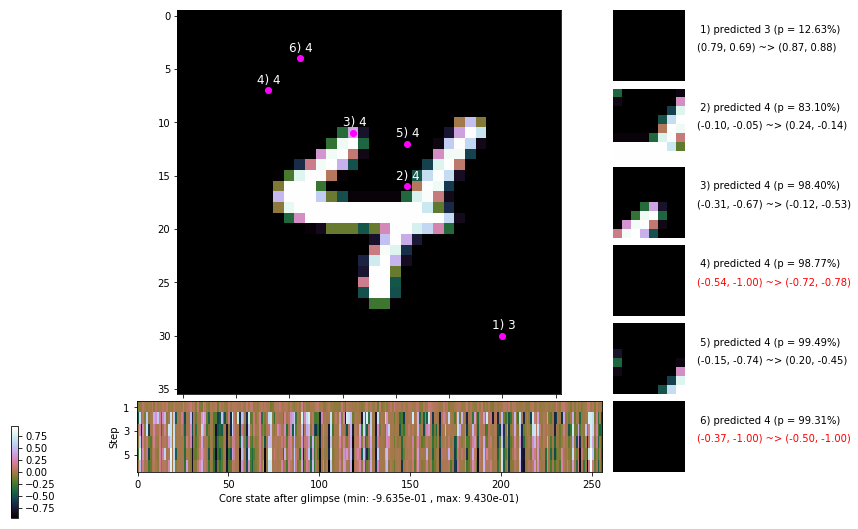

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 131.7 ms/b | lr: 9.08e-04 | grad 2norm: 12.76 | grad inf norm:  2.901
         Weights || abs max:  1.35 ( 7673.90) | mean: -7.16e-05 ( 0.02) | var: 2.71e-02 (10822.70)
          Biases || abs max:  0.73 (   80.89) | mean: -6.51e-02 ( 0.09) | var: 2.49e-02 (   34.36)
                    class loss: 0.399 | steps: 2.426 | reward:  3.325 | acc.: 87.22%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 127.9 ms/b | lr: 9.07e-04 | grad 2norm: 13.24 | grad inf norm:  3.087
         Weights || abs max:  1.36 ( 2617.08) | mean: -7.02e-05 ( 0.02) | var: 2.74e-02 (   75.99)
          Biases || abs max:  0.73 (  113.06) | mean: -6.56e-02 ( 0.11) | var: 2.51e-02 (   74.07)
                    class loss: 0.450 | steps: 2.470 | reward:  3.215 | acc.: 85.52%

	Target class: 7 | Discounted rewards: [-0.556, -0.556, -

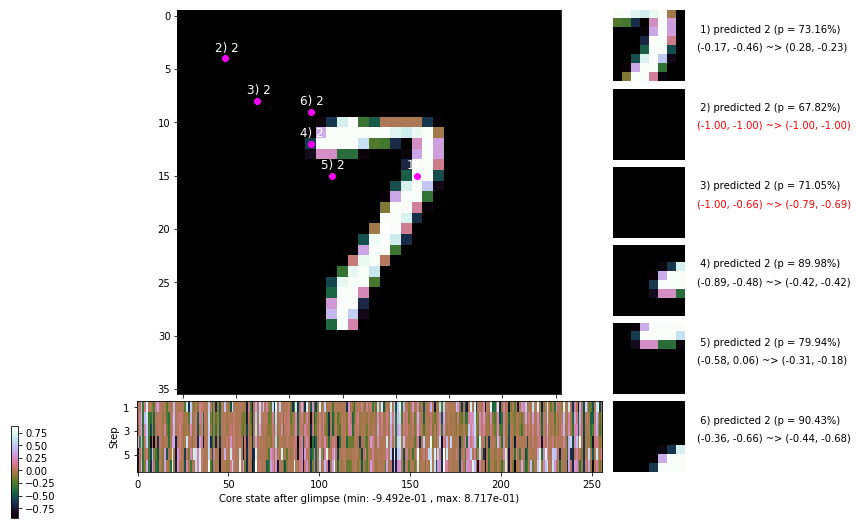

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 130.8 ms/b | lr: 9.05e-04 | grad 2norm: 12.95 | grad inf norm:  2.957
         Weights || abs max:  1.38 ( 3893.85) | mean: -4.89e-05 ( 0.02) | var: 2.76e-02 (  925.47)
          Biases || abs max:  0.73 (  137.06) | mean: -6.66e-02 ( 0.11) | var: 2.55e-02 (  473.32)
                    class loss: 0.393 | steps: 2.447 | reward:  3.282 | acc.: 86.77%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 127.4 ms/b | lr: 9.04e-04 | grad 2norm: 13.16 | grad inf norm:  2.977
         Weights || abs max:  1.38 ( 5202.69) | mean: -5.11e-05 ( 0.02) | var: 2.78e-02 ( 1423.31)
          Biases || abs max:  0.74 (   85.75) | mean: -6.64e-02 ( 0.10) | var: 2.58e-02 (   34.58)
                    class loss: 0.385 | steps: 2.439 | reward:  3.323 | acc.: 87.00%

	Target class: 5 | Discounted rewards: [-0.554, -0.541, -

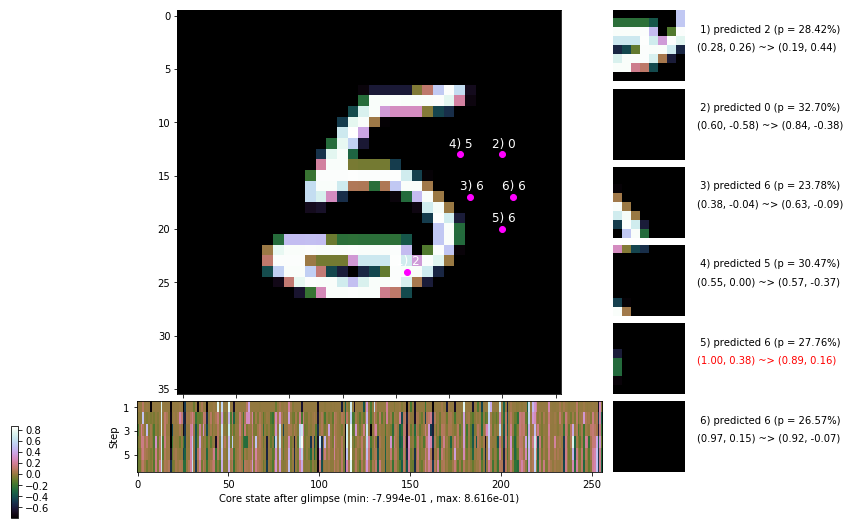

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 126.6 ms/b | lr: 9.02e-04 | grad 2norm: 12.99 | grad inf norm:  3.025
         Weights || abs max:  1.39 ( 2488.24) | mean: -4.89e-05 ( 0.02) | var: 2.80e-02 (   75.84)
          Biases || abs max:  0.74 (   60.36) | mean: -6.85e-02 ( 0.08) | var: 2.63e-02 (   16.73)
                    class loss: 0.416 | steps: 2.485 | reward:  3.274 | acc.: 86.67%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 129.7 ms/b | lr: 9.01e-04 | grad 2norm: 12.66 | grad inf norm:  2.966
         Weights || abs max:  1.39 ( 2723.12) | mean: -8.60e-05 ( 0.02) | var: 2.83e-02 (  100.52)
          Biases || abs max:  0.73 (   83.49) | mean: -6.93e-02 ( 0.10) | var: 2.68e-02 (   28.07)
                    class loss: 0.407 | steps: 2.426 | reward:  3.353 | acc.: 86.90%

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.1

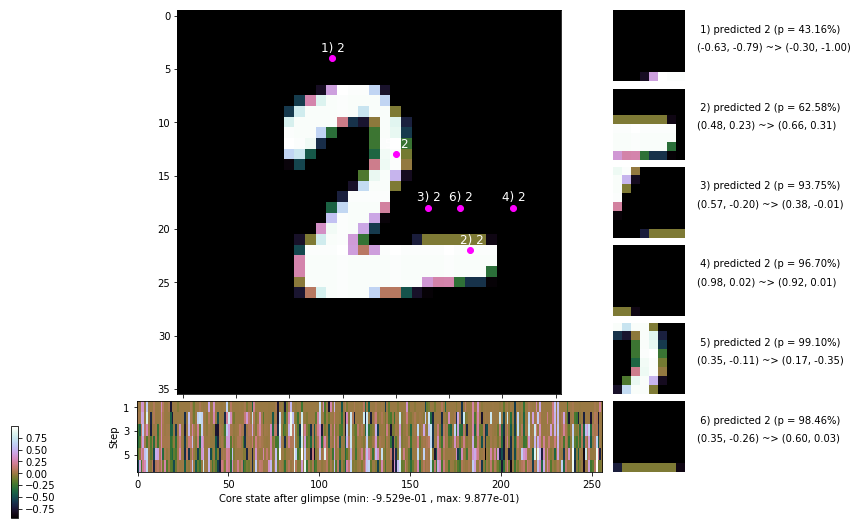

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


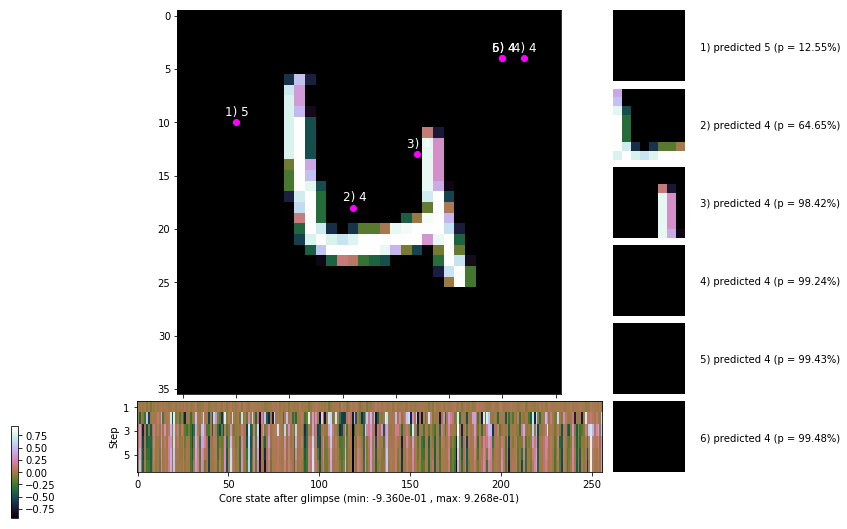


	Target class: 8 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


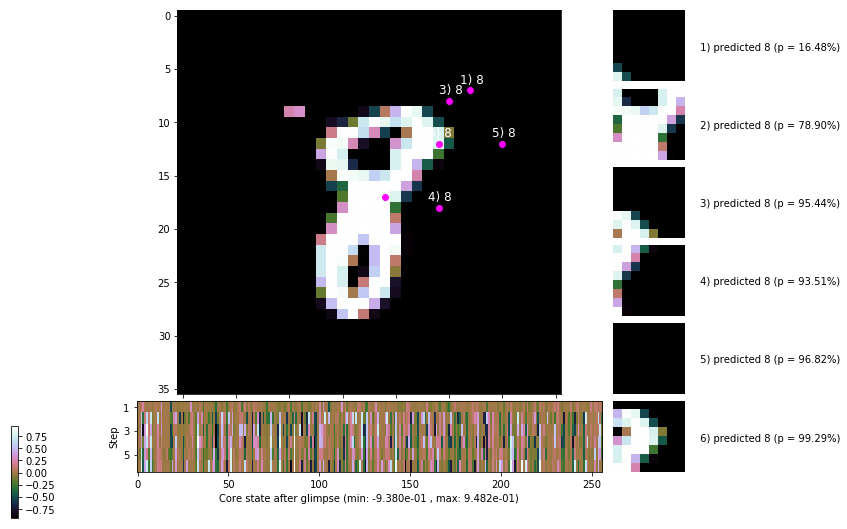

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


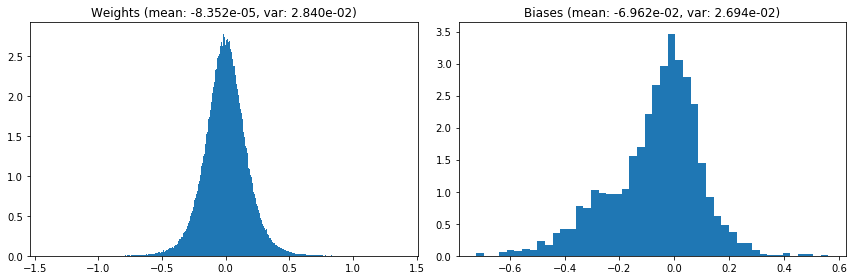

                                      Location network weights and biases


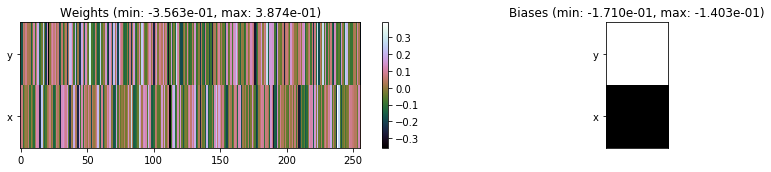

---------------------------------------------------------------------------------------------------------------
Elapsed time:  391.96 sec | TRAIN >> class loss: 0.4139 | steps:  2.460    | reward:  3.2754    | acc.: 86.412% 
                          | VAL   >> class loss: 0.4271 | steps:  2.365    | reward:  3.4530    | acc.: 85.760% :(


Epoch   8/400) lr = 0.0009003
 b    300/  3000 >> 128.0 ms/b | lr: 8.99e-04 | grad 2norm: 13.02 | grad inf norm:  2.921
         Weights || abs max:  1.40 ( 3002.94) | mean: -7.68e-05 ( 0.02) | var: 2.85e-02 (  150.14)
          Biases || abs max:  0.71 (  239.53) | mean: -7.00e-02 ( 0.17) | var: 2.72e-02 (  725.25)
                    class loss: 0.434 | steps: 2.470 | reward:  3.252 | acc.: 86.33%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 125.5 ms/b | lr: 8.98e-04 | grad 2norm: 13.25 | grad inf norm:  3.100
         Weights || abs max:  1.41 ( 2938.47) | mean: -2.82e-05 ( 0

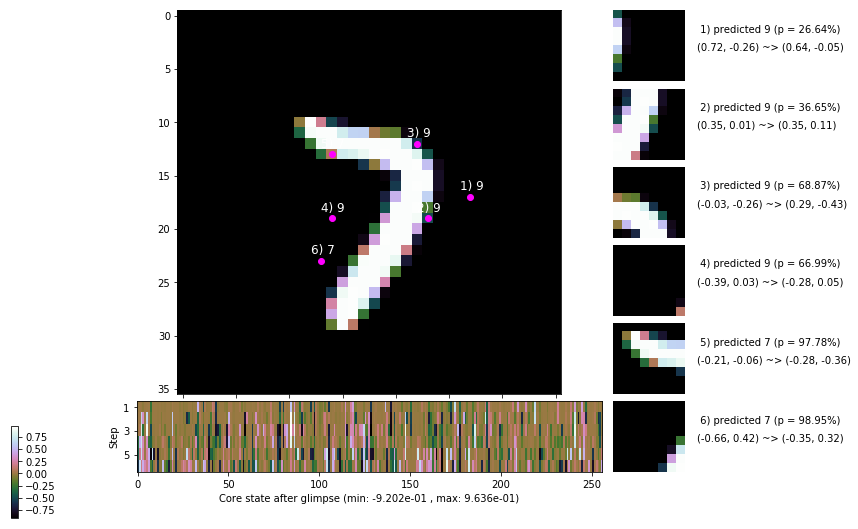

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 130.5 ms/b | lr: 8.97e-04 | grad 2norm: 13.07 | grad inf norm:  3.078
         Weights || abs max:  1.43 ( 6274.75) | mean: -2.69e-05 ( 0.02) | var: 2.90e-02 ( 1665.10)
          Biases || abs max:  0.72 (  382.00) | mean: -7.13e-02 ( 0.21) | var: 2.77e-02 (11255.75)
                    class loss: 0.421 | steps: 2.479 | reward:  3.230 | acc.: 86.08%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 128.2 ms/b | lr: 8.96e-04 | grad 2norm: 12.96 | grad inf norm:  2.904
         Weights || abs max:  1.42 ( 4582.84) | mean: -6.93e-05 ( 0.02) | var: 2.92e-02 (  543.00)
          Biases || abs max:  0.72 (  129.34) | mean: -7.24e-02 ( 0.11) | var: 2.82e-02 (  135.44)
                    class loss: 0.416 | steps: 2.434 | reward:  3.260 | acc.: 85.97%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

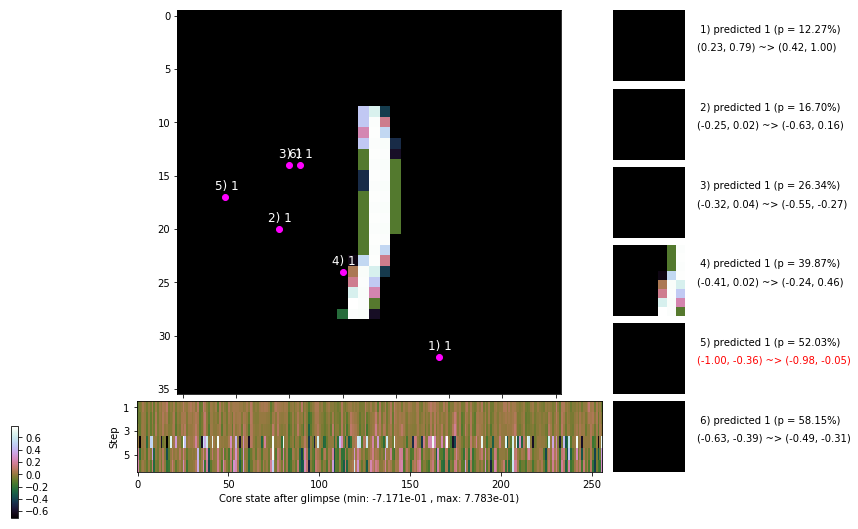

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 130.4 ms/b | lr: 8.94e-04 | grad 2norm: 13.20 | grad inf norm:  3.019
         Weights || abs max:  1.42 ( 6546.77) | mean: -8.23e-05 ( 0.02) | var: 2.94e-02 ( 5588.19)
          Biases || abs max:  0.72 (  421.54) | mean: -7.29e-02 ( 0.22) | var: 2.84e-02 (15195.26)
                    class loss: 0.403 | steps: 2.446 | reward:  3.304 | acc.: 86.45%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 124.7 ms/b | lr: 8.93e-04 | grad 2norm: 12.81 | grad inf norm:  2.886
         Weights || abs max:  1.44 ( 7853.53) | mean: -8.43e-05 ( 0.03) | var: 2.97e-02 (13180.44)
          Biases || abs max:  0.71 (  121.65) | mean: -7.36e-02 ( 0.10) | var: 2.88e-02 (  286.80)
                    class loss: 0.388 | steps: 2.435 | reward:  3.318 | acc.: 87.32%

	Target class: 2 | Discounted rewards: [-0.389, 1.111, 1.

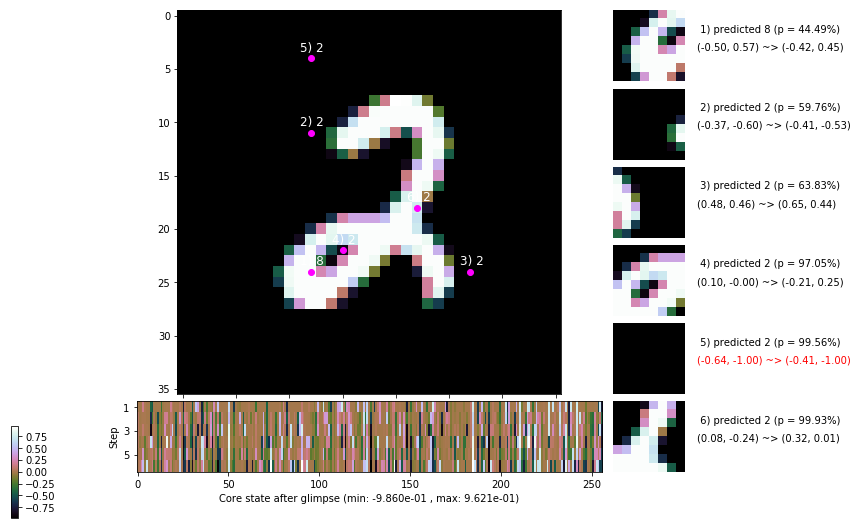

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 125.9 ms/b | lr: 8.91e-04 | grad 2norm: 12.78 | grad inf norm:  2.926
         Weights || abs max:  1.44 ( 7574.05) | mean: -1.00e-04 ( 0.03) | var: 2.99e-02 ( 5448.16)
          Biases || abs max:  0.72 (   46.93) | mean: -7.37e-02 ( 0.07) | var: 2.91e-02 (   11.95)
                    class loss: 0.387 | steps: 2.436 | reward:  3.331 | acc.: 87.13%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 122.9 ms/b | lr: 8.90e-04 | grad 2norm: 12.81 | grad inf norm:  2.860
         Weights || abs max:  1.44 ( 3663.73) | mean: -1.66e-04 ( 0.02) | var: 3.01e-02 (  431.87)
          Biases || abs max:  0.73 (   78.63) | mean: -7.51e-02 ( 0.09) | var: 2.94e-02 (   19.14)
                    class loss: 0.391 | steps: 2.408 | reward:  3.321 | acc.: 87.05%

	Target class: 9 | Discounted rewards: [0.945, -0.554, -0

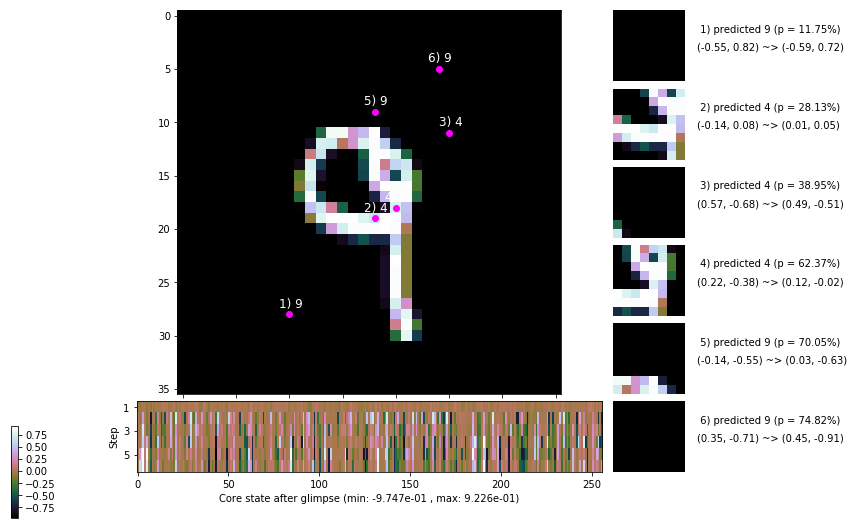

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 135.4 ms/b | lr: 8.89e-04 | grad 2norm: 12.58 | grad inf norm:  2.935
         Weights || abs max:  1.44 ( 4172.50) | mean: -1.79e-04 ( 0.02) | var: 3.03e-02 (  412.73)
          Biases || abs max:  0.73 (  124.46) | mean: -7.61e-02 ( 0.11) | var: 2.97e-02 (  163.64)
                    class loss: 0.365 | steps: 2.416 | reward:  3.358 | acc.: 87.82%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 132.6 ms/b | lr: 8.88e-04 | grad 2norm: 12.94 | grad inf norm:  3.153
         Weights || abs max:  1.45 ( 2589.80) | mean: -1.87e-04 ( 0.02) | var: 3.05e-02 (  137.06)
          Biases || abs max:  0.73 (   71.03) | mean: -7.59e-02 ( 0.09) | var: 3.00e-02 (   14.47)
                    class loss: 0.386 | steps: 2.404 | reward:  3.369 | acc.: 86.90%

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.

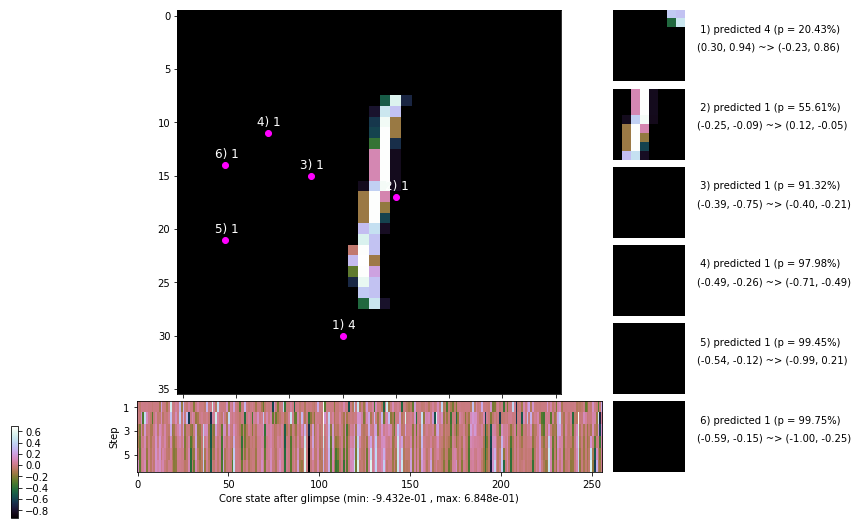

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


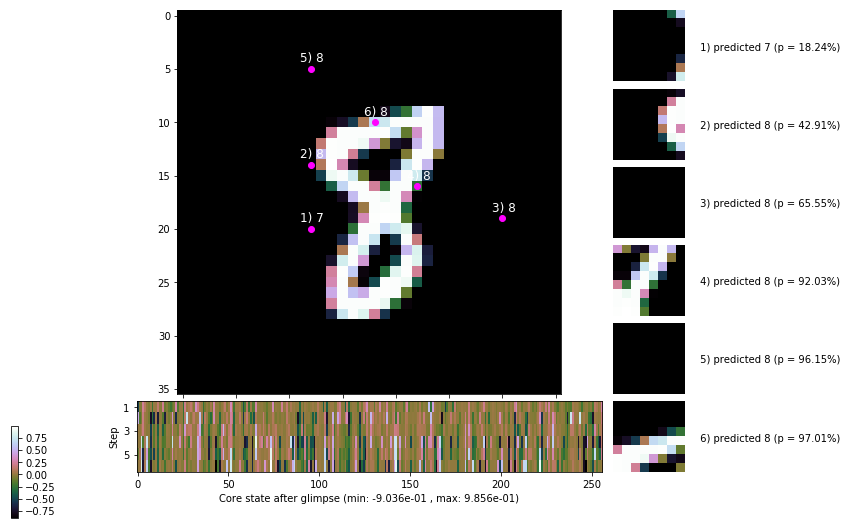


	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


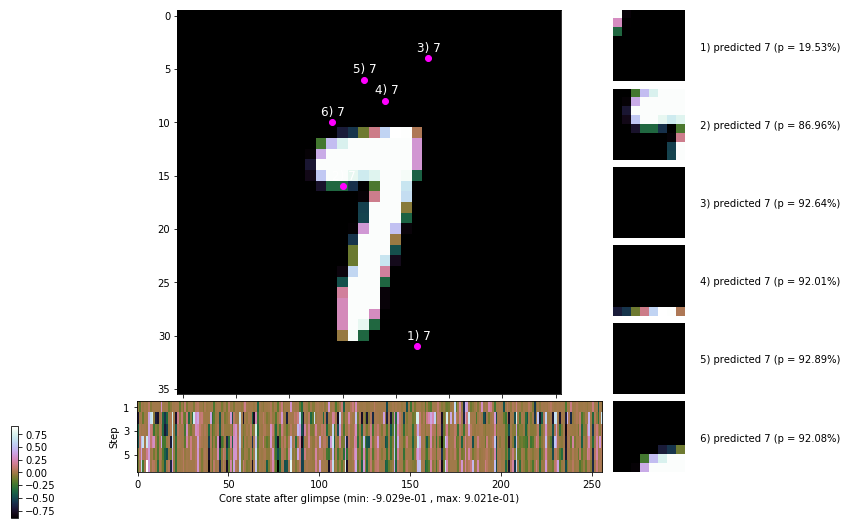

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


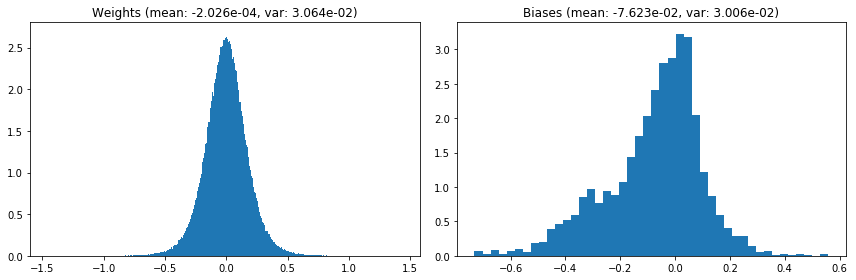

                                      Location network weights and biases


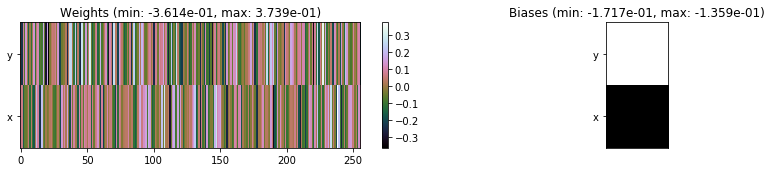

---------------------------------------------------------------------------------------------------------------
Elapsed time:  385.71 sec | TRAIN >> class loss: 0.4014 | steps:  2.441    | reward:  3.2979    | acc.: 86.715% 
                          | VAL   >> class loss: 0.3696 | steps:  2.326    | reward:  3.5043    | acc.: 87.700% 


Epoch   9/400) lr = 0.0008869
 b    300/  3000 >> 127.5 ms/b | lr: 8.86e-04 | grad 2norm: 12.94 | grad inf norm:  2.979
         Weights || abs max:  1.47 ( 8471.77) | mean: -2.17e-04 ( 0.03) | var: 3.07e-02 (18858.45)
          Biases || abs max:  0.72 (   62.10) | mean: -7.68e-02 ( 0.08) | var: 3.03e-02 (   13.77)
                    class loss: 0.387 | steps: 2.418 | reward:  3.365 | acc.: 87.25%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 134.0 ms/b | lr: 8.85e-04 | grad 2norm: 12.75 | grad inf norm:  2.840
         Weights || abs max:  1.48 ( 4971.28) | mean: -2.08e-04 ( 0.0

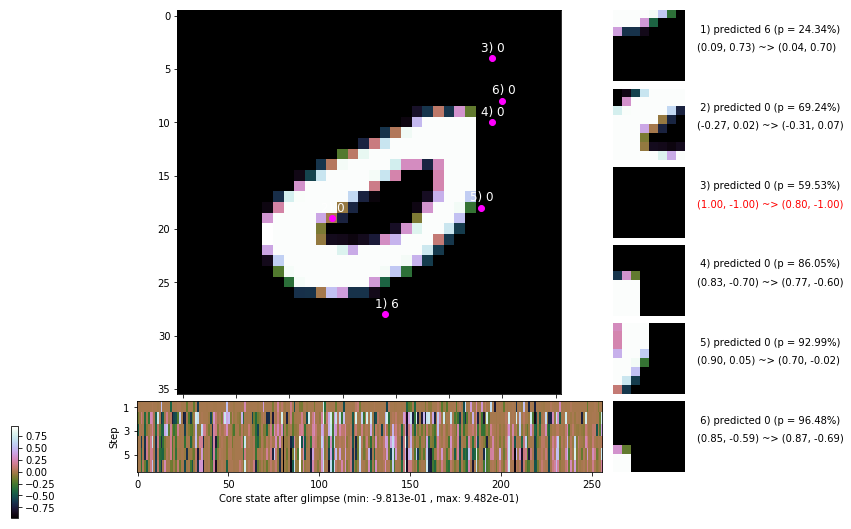

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 133.7 ms/b | lr: 8.83e-04 | grad 2norm: 13.00 | grad inf norm:  3.094
         Weights || abs max:  1.49 (22455.44) | mean: -2.02e-04 ( 0.05) | var: 3.12e-02 (109773.27)
          Biases || abs max:  0.75 (  115.85) | mean: -7.82e-02 ( 0.11) | var: 3.11e-02 (  223.10)
                    class loss: 0.414 | steps: 2.465 | reward:  3.263 | acc.: 86.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 136.4 ms/b | lr: 8.82e-04 | grad 2norm: 12.75 | grad inf norm:  3.005
         Weights || abs max:  1.50 ( 2513.78) | mean: -2.06e-04 ( 0.02) | var: 3.14e-02 (  137.58)
          Biases || abs max:  0.76 (   74.59) | mean: -7.87e-02 ( 0.09) | var: 3.14e-02 (   38.82)
                    class loss: 0.389 | steps: 2.408 | reward:  3.373 | acc.: 87.10%

	Target class: 7 | Discounted rewards: [-0.555, -0.554, 

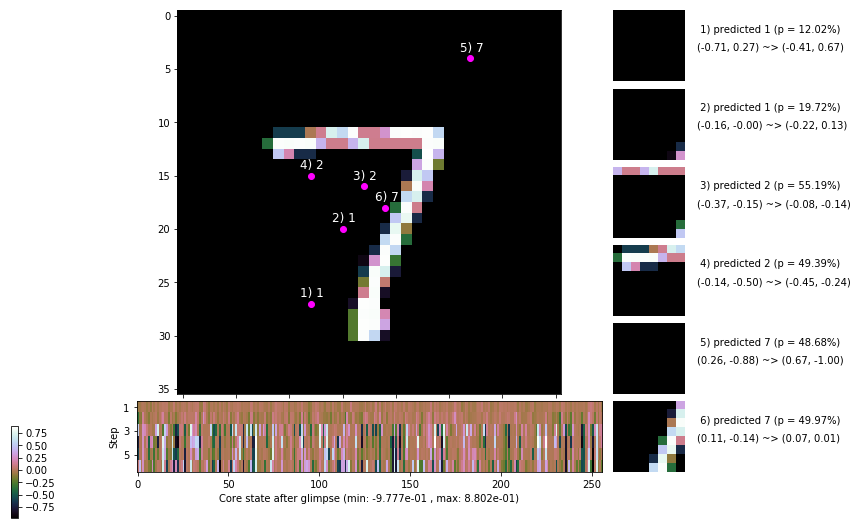

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 141.3 ms/b | lr: 8.81e-04 | grad 2norm: 12.60 | grad inf norm:  3.025
         Weights || abs max:  1.51 ( 3595.41) | mean: -2.46e-04 ( 0.02) | var: 3.16e-02 (  338.50)
          Biases || abs max:  0.76 (  280.08) | mean: -7.98e-02 ( 0.24) | var: 3.17e-02 ( 7439.25)
                    class loss: 0.407 | steps: 2.447 | reward:  3.301 | acc.: 86.65%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 138.3 ms/b | lr: 8.80e-04 | grad 2norm: 12.77 | grad inf norm:  3.030
         Weights || abs max:  1.51 ( 4406.83) | mean: -2.59e-04 ( 0.02) | var: 3.18e-02 ( 2990.21)
          Biases || abs max:  0.76 (   59.31) | mean: -7.98e-02 ( 0.07) | var: 3.20e-02 (   38.85)
                    class loss: 0.384 | steps: 2.391 | reward:  3.427 | acc.: 87.22%

	Target class: 3 | Discounted rewards: [1.109, 1.094, 0.9

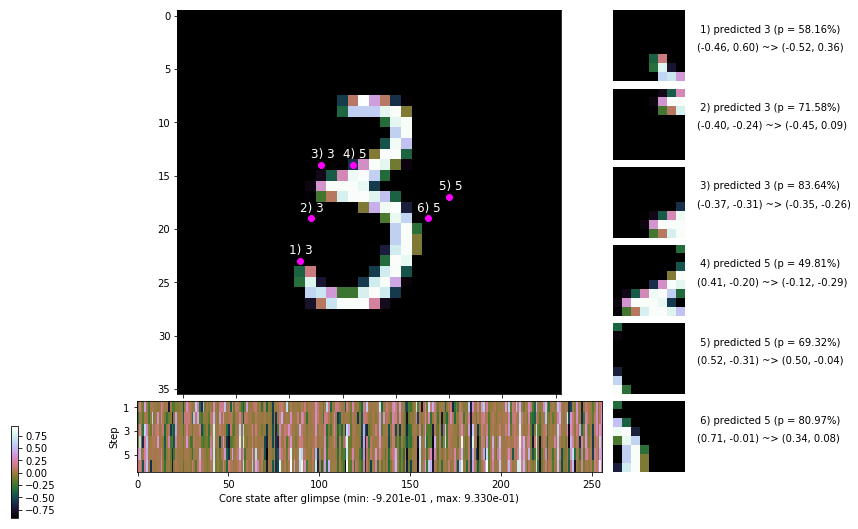

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 138.5 ms/b | lr: 8.78e-04 | grad 2norm: 12.62 | grad inf norm:  3.104
         Weights || abs max:  1.51 ( 2612.97) | mean: -2.36e-04 ( 0.02) | var: 3.20e-02 (   95.26)
          Biases || abs max:  0.74 (  155.59) | mean: -8.05e-02 ( 0.12) | var: 3.23e-02 (  237.70)
                    class loss: 0.394 | steps: 2.427 | reward:  3.345 | acc.: 87.37%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 138.3 ms/b | lr: 8.77e-04 | grad 2norm: 12.77 | grad inf norm:  2.994
         Weights || abs max:  1.52 ( 3307.20) | mean: -1.95e-04 ( 0.02) | var: 3.22e-02 (  177.70)
          Biases || abs max:  0.74 (  168.81) | mean: -8.06e-02 ( 0.12) | var: 3.26e-02 (  926.29)
                    class loss: 0.403 | steps: 2.438 | reward:  3.357 | acc.: 86.58%

	Target class: 7 | Discounted rewards: [-0.556, -0.556, -

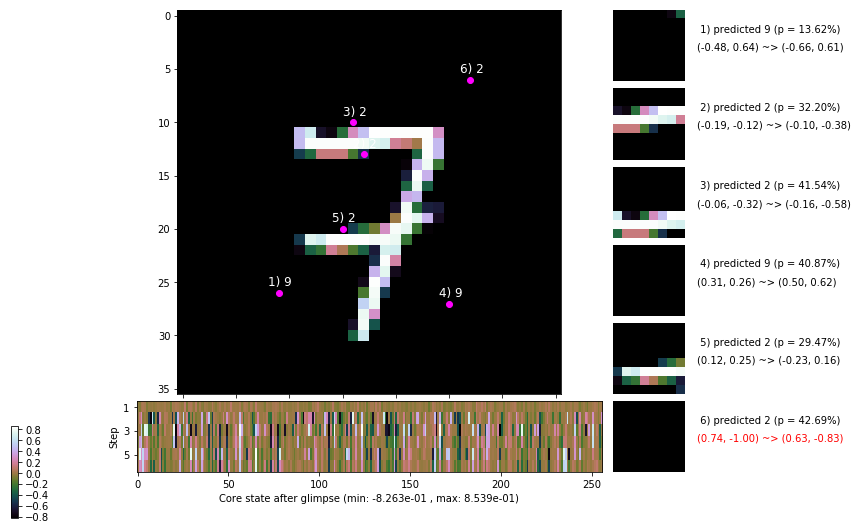

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 141.3 ms/b | lr: 8.75e-04 | grad 2norm: 12.64 | grad inf norm:  2.982
         Weights || abs max:  1.52 ( 4403.46) | mean: -2.01e-04 ( 0.02) | var: 3.25e-02 (  772.07)
          Biases || abs max:  0.75 (  164.36) | mean: -8.13e-02 ( 0.14) | var: 3.29e-02 (  433.75)
                    class loss: 0.395 | steps: 2.451 | reward:  3.325 | acc.: 87.08%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.4 ms/b | lr: 8.75e-04 | grad 2norm: 12.54 | grad inf norm:  2.919
         Weights || abs max:  1.52 ( 3729.44) | mean: -2.66e-04 ( 0.02) | var: 3.27e-02 (  159.39)
          Biases || abs max:  0.74 (  153.73) | mean: -8.20e-02 ( 0.14) | var: 3.32e-02 (  291.18)
                    class loss: 0.391 | steps: 2.439 | reward:  3.336 | acc.: 87.25%

	Target class: 2 | Discounted rewards: [-0.389, 1.111, 1.

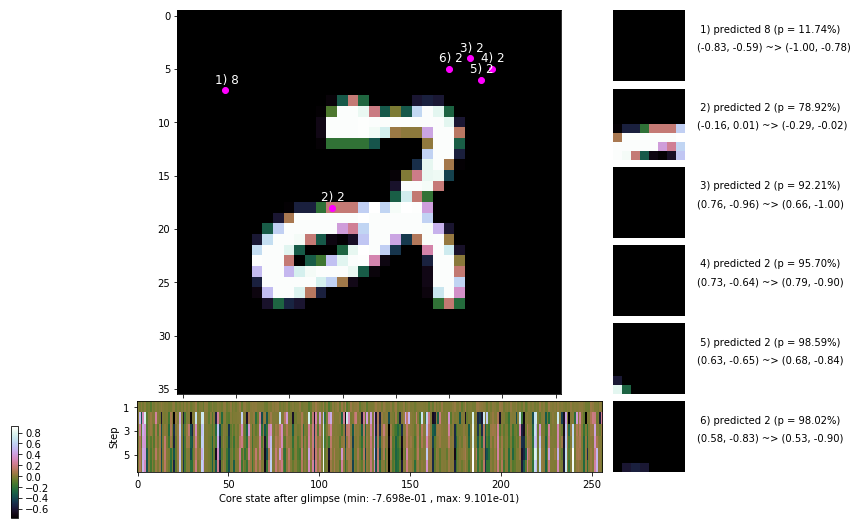

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


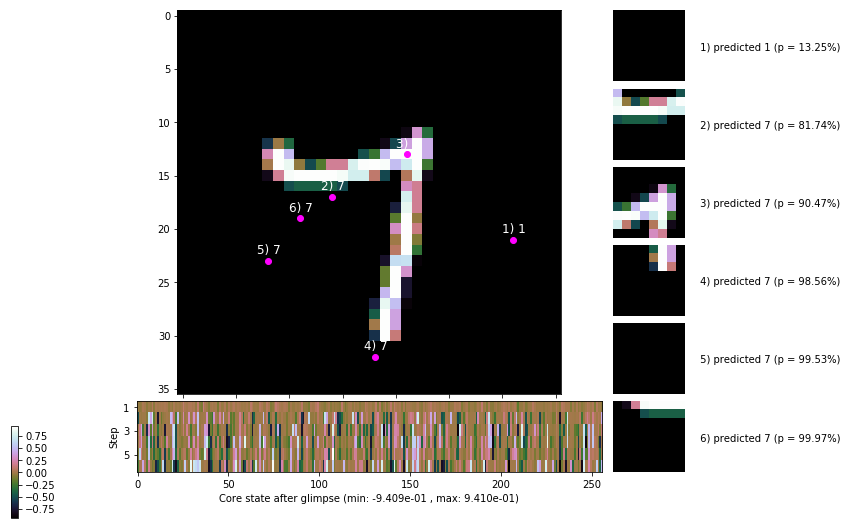


	Target class: 5 | Discounted rewards: [-0.539, -0.389, 1.111, 1.110, 1.100, 1.000]


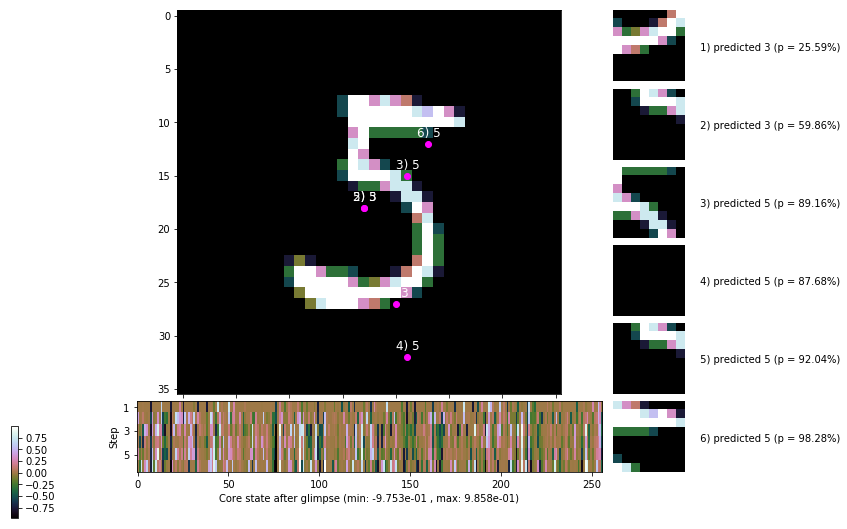

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


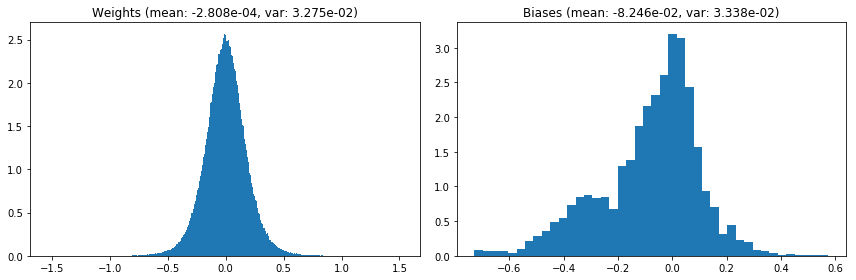

                                      Location network weights and biases


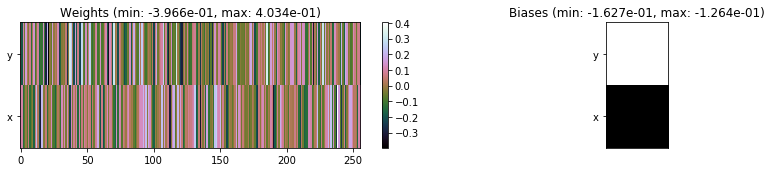

---------------------------------------------------------------------------------------------------------------
Elapsed time:  411.85 sec | TRAIN >> class loss: 0.3927 | steps:  2.430    | reward:  3.3481    | acc.: 87.128% 
                          | VAL   >> class loss: 0.4065 | steps:  2.379 :( | reward:  3.4518 :( | acc.: 86.180% :(


Epoch  10/400) lr = 0.0008737
 b    300/  3000 >> 141.2 ms/b | lr: 8.73e-04 | grad 2norm: 12.65 | grad inf norm:  2.979
         Weights || abs max:  1.53 ( 4508.95) | mean: -2.70e-04 ( 0.02) | var: 3.28e-02 (  738.12)
          Biases || abs max:  0.74 (  176.57) | mean: -8.28e-02 ( 0.14) | var: 3.36e-02 (  673.50)
                    class loss: 0.386 | steps: 2.407 | reward:  3.385 | acc.: 87.08%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 133.8 ms/b | lr: 8.72e-04 | grad 2norm: 12.59 | grad inf norm:  3.017
         Weights || abs max:  1.54 ( 2628.47) | mean: -2.71e-04 ( 0

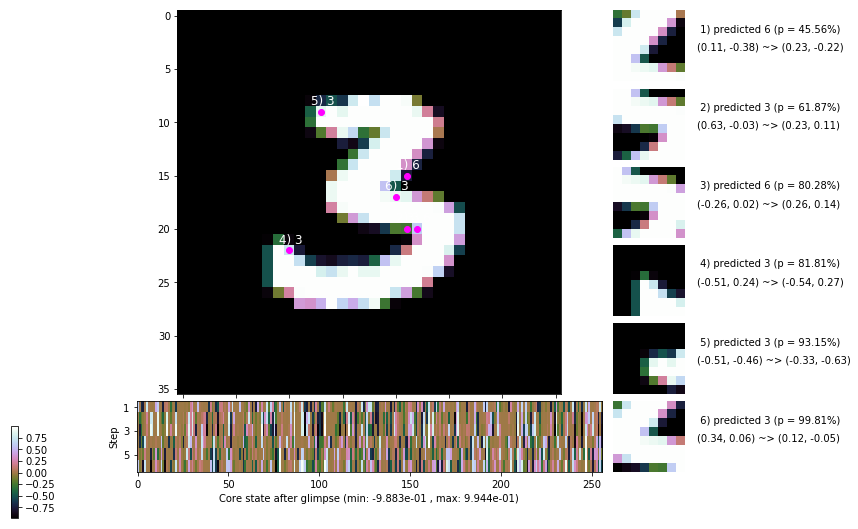

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.2 ms/b | lr: 8.70e-04 | grad 2norm: 12.65 | grad inf norm:  2.958
         Weights || abs max:  1.55 ( 3045.33) | mean: -2.16e-04 ( 0.02) | var: 3.33e-02 (  208.42)
          Biases || abs max:  0.75 (  175.10) | mean: -8.40e-02 ( 0.15) | var: 3.42e-02 (  586.30)
                    class loss: 0.385 | steps: 2.389 | reward:  3.406 | acc.: 87.53%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 147.7 ms/b | lr: 8.69e-04 | grad 2norm: 13.10 | grad inf norm:  3.275
         Weights || abs max:  1.55 ( 3407.59) | mean: -1.50e-04 ( 0.02) | var: 3.35e-02 (  341.55)
          Biases || abs max:  0.76 (  164.33) | mean: -8.44e-02 ( 0.14) | var: 3.45e-02 (  161.68)
                    class loss: 0.397 | steps: 2.440 | reward:  3.333 | acc.: 86.25%

	Target class: 9 | Discounted rewards: [-0.556, -0.556, -

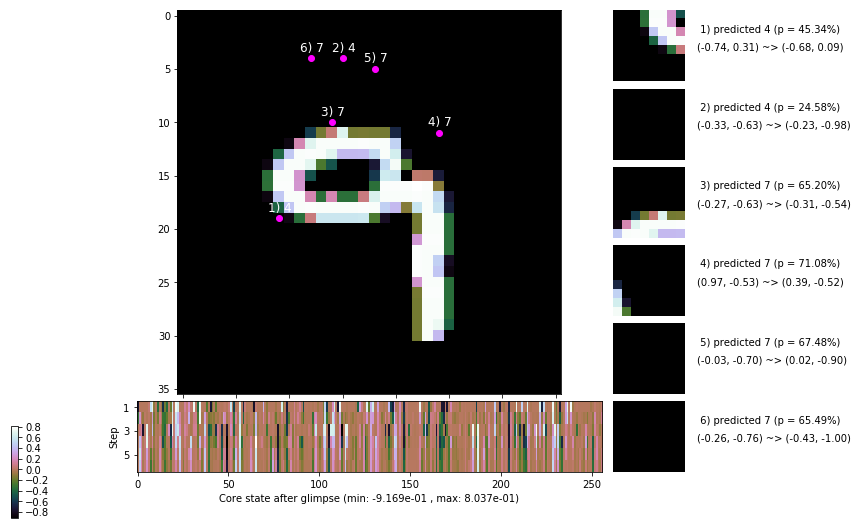

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.0 ms/b | lr: 8.68e-04 | grad 2norm: 12.91 | grad inf norm:  3.041
         Weights || abs max:  1.58 ( 3962.86) | mean: -1.14e-04 ( 0.02) | var: 3.37e-02 (  820.31)
          Biases || abs max:  0.75 (  140.50) | mean: -8.46e-02 ( 0.12) | var: 3.48e-02 (  264.20)
                    class loss: 0.390 | steps: 2.423 | reward:  3.358 | acc.: 87.75%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 146.5 ms/b | lr: 8.67e-04 | grad 2norm: 12.76 | grad inf norm:  3.038
         Weights || abs max:  1.59 ( 3133.96) | mean: -1.15e-04 ( 0.02) | var: 3.39e-02 (  203.93)
          Biases || abs max:  0.75 (  109.40) | mean: -8.44e-02 ( 0.11) | var: 3.50e-02 (   70.71)
                    class loss: 0.379 | steps: 2.383 | reward:  3.419 | acc.: 87.30%

	Target class: 4 | Discounted rewards: [-0.540, -0.404, 0

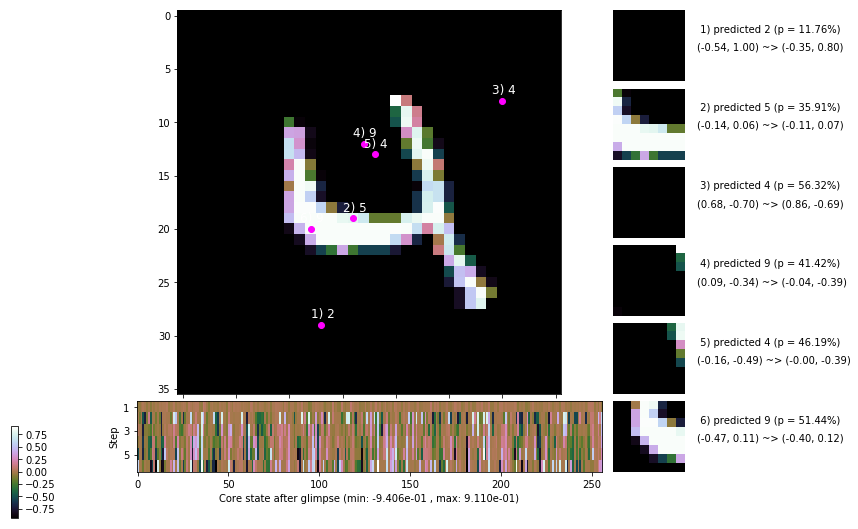

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 137.4 ms/b | lr: 8.65e-04 | grad 2norm: 12.95 | grad inf norm:  2.987
         Weights || abs max:  1.60 ( 4273.36) | mean: -1.80e-04 ( 0.02) | var: 3.41e-02 (  972.04)
          Biases || abs max:  0.77 (   89.09) | mean: -8.55e-02 ( 0.10) | var: 3.53e-02 (   33.55)
                    class loss: 0.385 | steps: 2.404 | reward:  3.363 | acc.: 87.15%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 135.8 ms/b | lr: 8.64e-04 | grad 2norm: 13.11 | grad inf norm:  3.194
         Weights || abs max:  1.62 ( 5484.20) | mean: -2.18e-04 ( 0.02) | var: 3.43e-02 ( 2075.25)
          Biases || abs max:  0.76 (   80.96) | mean: -8.65e-02 ( 0.10) | var: 3.57e-02 (   41.92)
                    class loss: 0.411 | steps: 2.417 | reward:  3.360 | acc.: 86.47%

	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1.

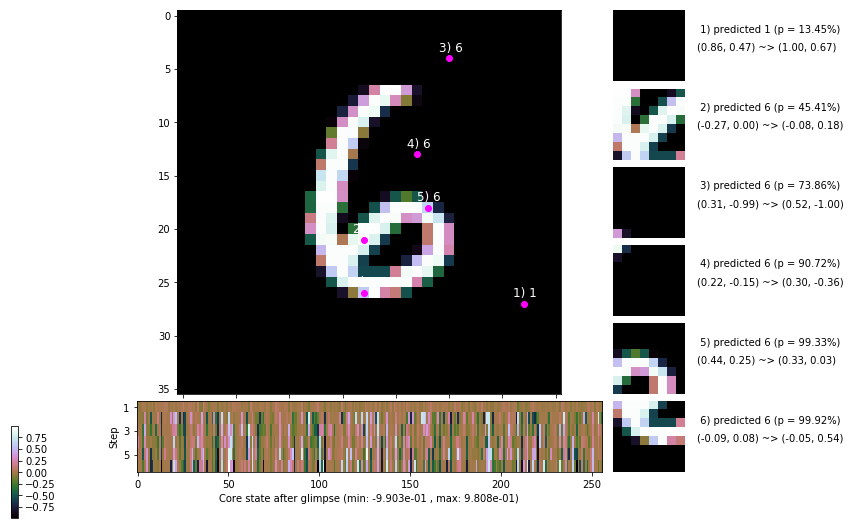

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 137.0 ms/b | lr: 8.62e-04 | grad 2norm: 12.60 | grad inf norm:  3.049
         Weights || abs max:  1.61 ( 9076.35) | mean: -2.14e-04 ( 0.03) | var: 3.45e-02 (16629.94)
          Biases || abs max:  0.76 (  130.90) | mean: -8.68e-02 ( 0.13) | var: 3.61e-02 (  358.93)
                    class loss: 0.394 | steps: 2.414 | reward:  3.364 | acc.: 86.88%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 135.4 ms/b | lr: 8.62e-04 | grad 2norm: 12.71 | grad inf norm:  3.067
         Weights || abs max:  1.61 (10389.27) | mean: -1.81e-04 ( 0.03) | var: 3.47e-02 ( 6909.59)
          Biases || abs max:  0.77 (  321.11) | mean: -8.72e-02 ( 0.24) | var: 3.64e-02 ( 1477.83)
                    class loss: 0.400 | steps: 2.410 | reward:  3.338 | acc.: 86.53%

	Target class: 9 | Discounted rewards: [0.961, -0.389, 1.

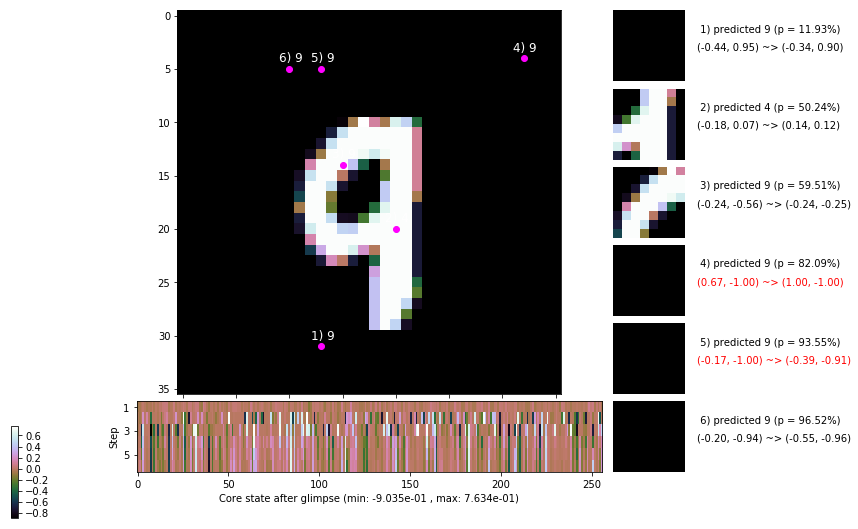

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [-0.556, -0.556, -0.556, -0.555, -0.550, -0.500]


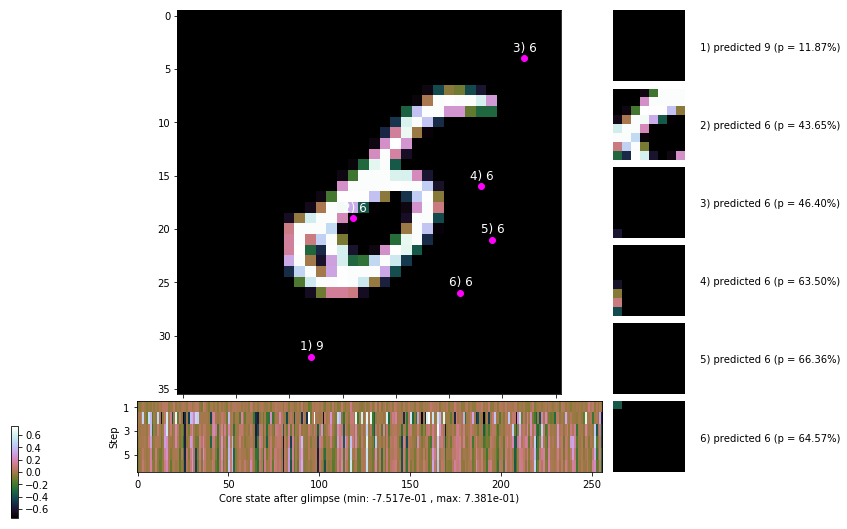


	Target class: 0 | Discounted rewards: [0.961, -0.389, 1.111, 1.110, 1.100, 1.000]


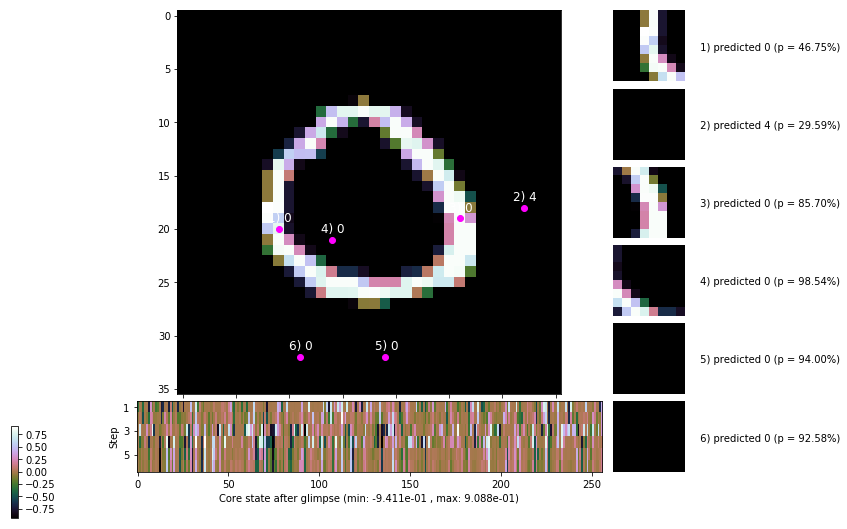

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


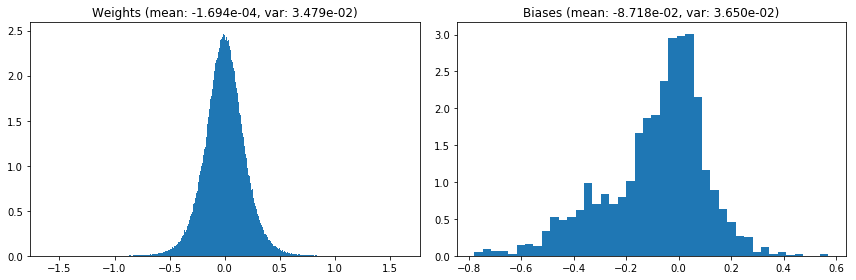

                                      Location network weights and biases


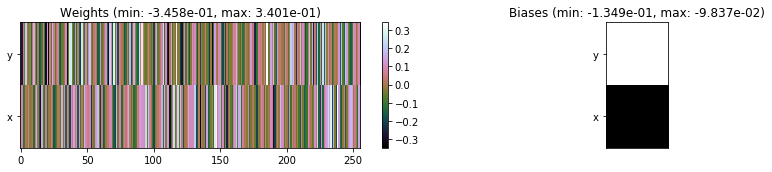

---------------------------------------------------------------------------------------------------------------
Elapsed time:  420.95 sec | TRAIN >> class loss: 0.3909 | steps:  2.408    | reward:  3.3747    | acc.: 87.052% :(
                          | VAL   >> class loss: 0.3655 | steps:  2.297    | reward:  3.5421    | acc.: 87.880% 


Epoch  11/400) lr = 0.0008606
 b    300/  3000 >> 137.7 ms/b | lr: 8.60e-04 | grad 2norm: 12.60 | grad inf norm:  3.105
         Weights || abs max:  1.62 ( 4998.70) | mean: -1.57e-04 ( 0.02) | var: 3.49e-02 (  920.33)
          Biases || abs max:  0.77 (  190.33) | mean: -8.75e-02 ( 0.13) | var: 3.67e-02 (  554.96)
                    class loss: 0.401 | steps: 2.423 | reward:  3.330 | acc.: 86.43%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 138.4 ms/b | lr: 8.59e-04 | grad 2norm: 12.83 | grad inf norm:  2.961
         Weights || abs max:  1.62 ( 9941.78) | mean: -1.79e-04 ( 0

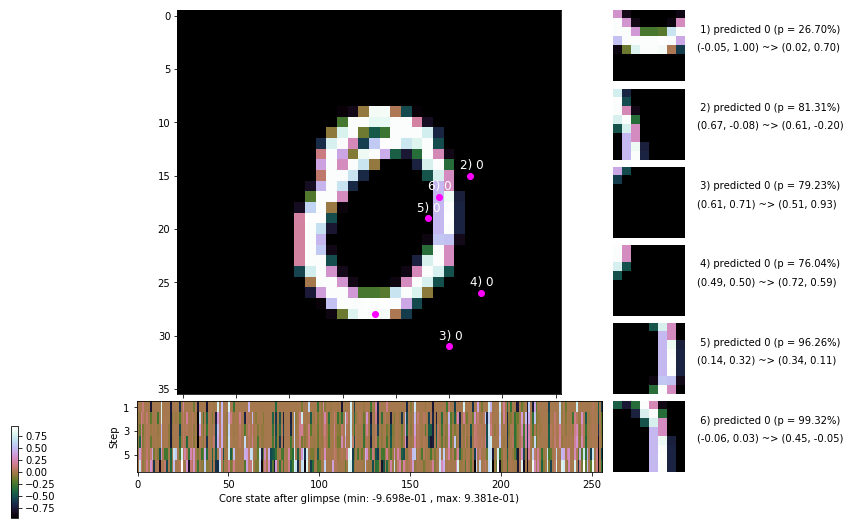

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 138.1 ms/b | lr: 8.57e-04 | grad 2norm: 12.83 | grad inf norm:  2.921
         Weights || abs max:  1.62 ( 4048.92) | mean: -1.96e-04 ( 0.02) | var: 3.53e-02 (  258.32)
          Biases || abs max:  0.78 (  256.26) | mean: -8.94e-02 ( 0.18) | var: 3.76e-02 ( 1494.48)
                    class loss: 0.399 | steps: 2.367 | reward:  3.422 | acc.: 87.05%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 137.0 ms/b | lr: 8.56e-04 | grad 2norm: 12.71 | grad inf norm:  3.042
         Weights || abs max:  1.61 (12552.95) | mean: -2.23e-04 ( 0.03) | var: 3.55e-02 (46108.79)
          Biases || abs max:  0.79 (  111.55) | mean: -8.94e-02 ( 0.12) | var: 3.78e-02 (  156.00)
                    class loss: 0.376 | steps: 2.396 | reward:  3.405 | acc.: 87.13%

	Target class: 2 | Discounted rewards: [-0.405, 0.946, -0

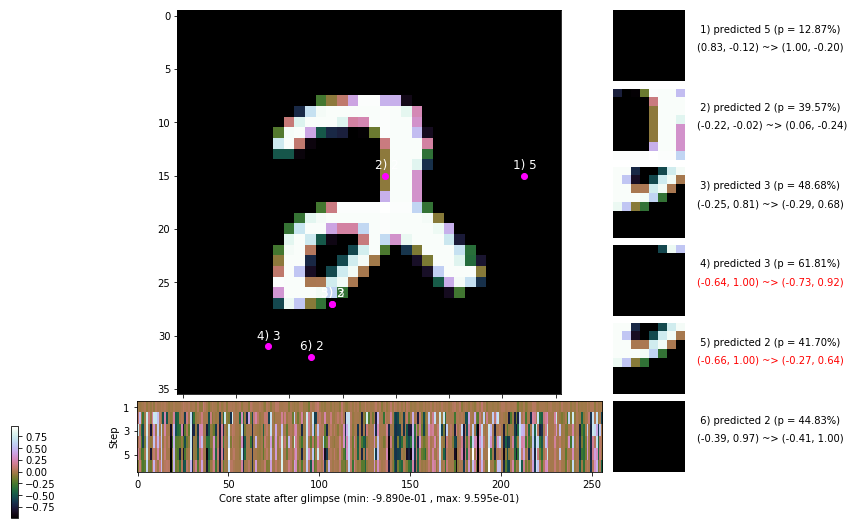

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 135.6 ms/b | lr: 8.55e-04 | grad 2norm: 12.96 | grad inf norm:  2.930
         Weights || abs max:  1.61 ( 4374.02) | mean: -2.11e-04 ( 0.02) | var: 3.57e-02 (  512.78)
          Biases || abs max:  0.78 (  105.83) | mean: -9.01e-02 ( 0.10) | var: 3.81e-02 (  197.84)
                    class loss: 0.392 | steps: 2.398 | reward:  3.357 | acc.: 86.97%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 149.4 ms/b | lr: 8.54e-04 | grad 2norm: 12.81 | grad inf norm:  2.987
         Weights || abs max:  1.64 ( 3197.12) | mean: -2.24e-04 ( 0.02) | var: 3.58e-02 (  116.07)
          Biases || abs max:  0.78 (   99.79) | mean: -8.98e-02 ( 0.09) | var: 3.83e-02 (   40.67)
                    class loss: 0.380 | steps: 2.393 | reward:  3.377 | acc.: 87.05%

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1.

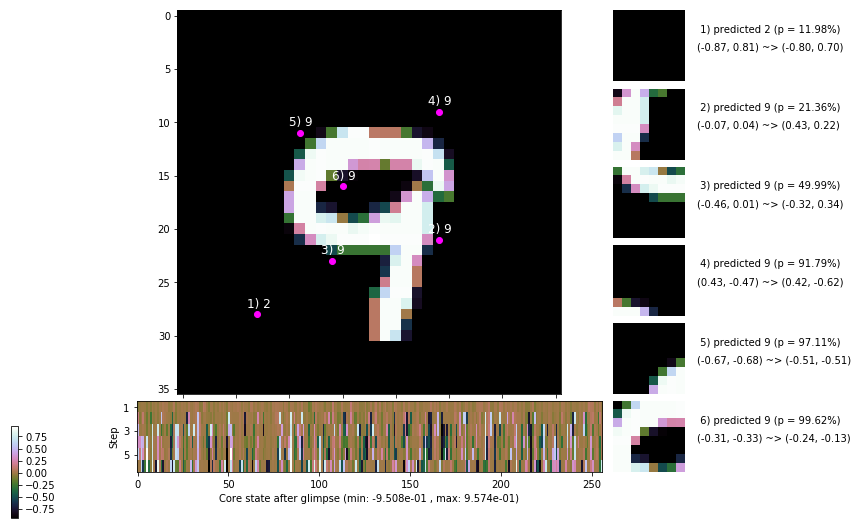

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.5 ms/b | lr: 8.52e-04 | grad 2norm: 12.58 | grad inf norm:  3.033
         Weights || abs max:  1.66 ( 5117.67) | mean: -2.03e-04 ( 0.02) | var: 3.60e-02 ( 1257.82)
          Biases || abs max:  0.79 (   62.49) | mean: -9.08e-02 ( 0.07) | var: 3.87e-02 (   13.96)
                    class loss: 0.383 | steps: 2.392 | reward:  3.392 | acc.: 87.13%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 149.7 ms/b | lr: 8.51e-04 | grad 2norm: 12.32 | grad inf norm:  2.887
         Weights || abs max:  1.66 ( 3862.36) | mean: -2.16e-04 ( 0.02) | var: 3.62e-02 (  596.50)
          Biases || abs max:  0.80 (   82.67) | mean: -9.10e-02 ( 0.09) | var: 3.90e-02 (   29.70)
                    class loss: 0.368 | steps: 2.355 | reward:  3.459 | acc.: 87.92%

	Target class: 8 | Discounted rewards: [-0.539, -0.389, 1

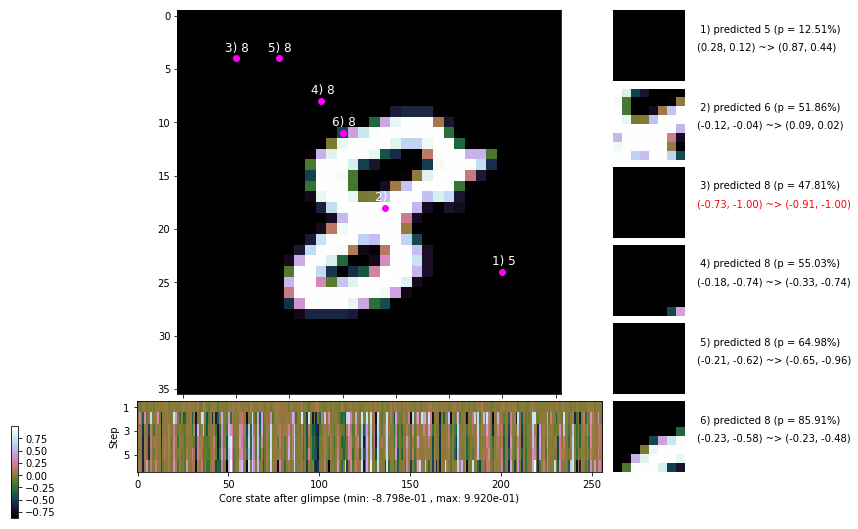

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 136.9 ms/b | lr: 8.50e-04 | grad 2norm: 12.70 | grad inf norm:  2.967
         Weights || abs max:  1.65 ( 4936.56) | mean: -1.83e-04 ( 0.02) | var: 3.64e-02 ( 1580.19)
          Biases || abs max:  0.79 (   32.88) | mean: -9.15e-02 ( 0.06) | var: 3.92e-02 (    7.63)
                    class loss: 0.380 | steps: 2.409 | reward:  3.407 | acc.: 87.57%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 134.4 ms/b | lr: 8.49e-04 | grad 2norm: 12.64 | grad inf norm:  2.958
         Weights || abs max:  1.66 (     inf) | mean: -1.49e-04 (  inf) | var: 3.65e-02 (     nan)
          Biases || abs max:  0.79 (   61.23) | mean: -9.23e-02 ( 0.07) | var: 3.95e-02 (   33.64)
                    class loss: 0.378 | steps: 2.404 | reward:  3.414 | acc.: 87.23%

	Target class: 2 | Discounted rewards: [-0.404, 0.961, -0

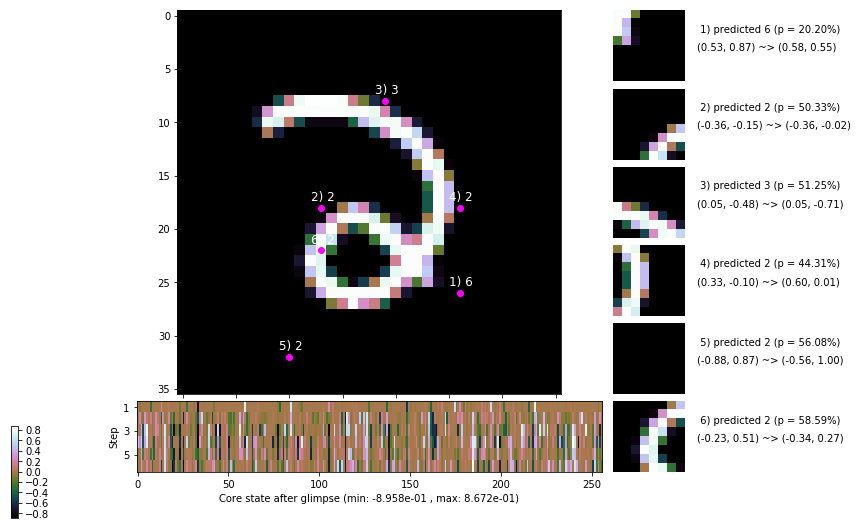

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


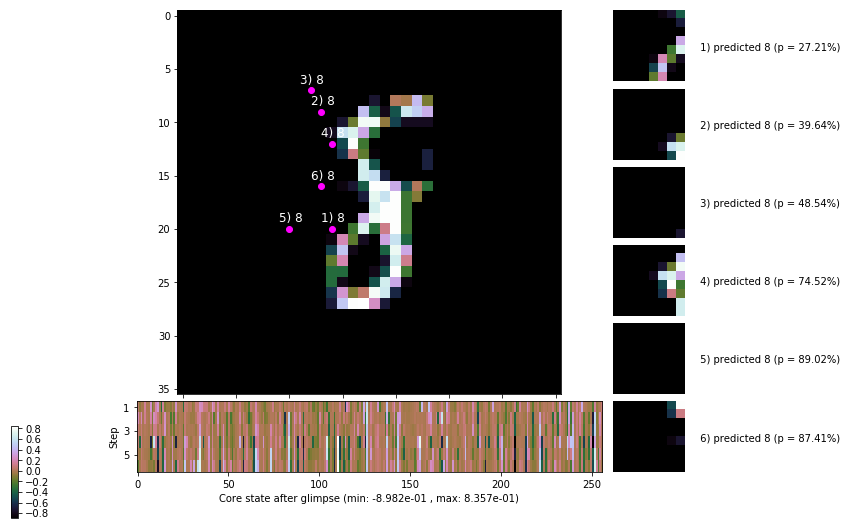


	Target class: 5 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


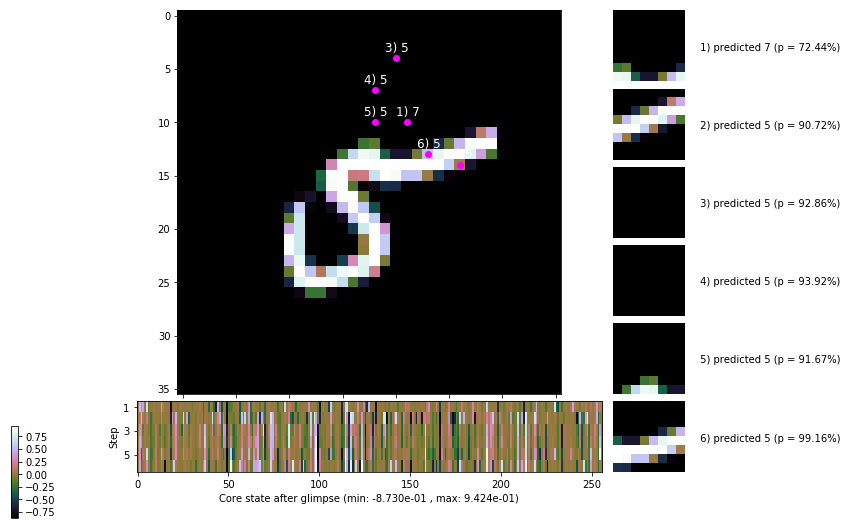

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


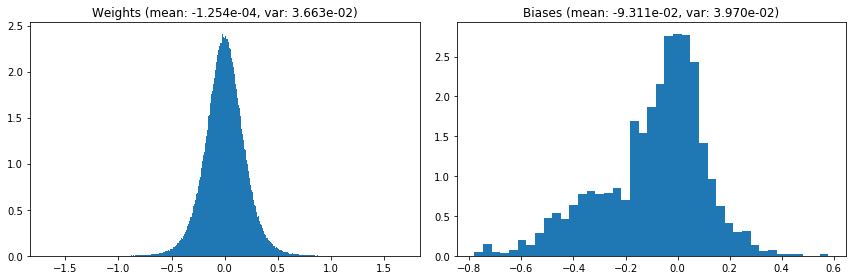

                                      Location network weights and biases


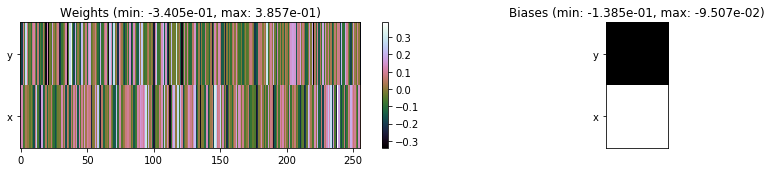

---------------------------------------------------------------------------------------------------------------
Elapsed time:  420.42 sec | TRAIN >> class loss: 0.3871 | steps:  2.395    | reward:  3.3896    | acc.: 87.075% :(
                          | VAL   >> class loss: 0.3660 | steps:  2.309 :( | reward:  3.5892    | acc.: 87.860% :(


Epoch  12/400) lr = 0.0008478
 b    300/  3000 >> 135.3 ms/b | lr: 8.47e-04 | grad 2norm: 12.56 | grad inf norm:  2.957
         Weights || abs max:  1.67 ( 2794.44) | mean: -1.32e-04 ( 0.02) | var: 3.67e-02 (  160.15)
          Biases || abs max:  0.79 (  101.80) | mean: -9.29e-02 ( 0.10) | var: 3.98e-02 (   48.72)
                    class loss: 0.369 | steps: 2.381 | reward:  3.435 | acc.: 88.00%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 132.7 ms/b | lr: 8.46e-04 | grad 2norm: 12.57 | grad inf norm:  2.953
         Weights || abs max:  1.67 ( 3649.99) | mean: -1.57e-04 (

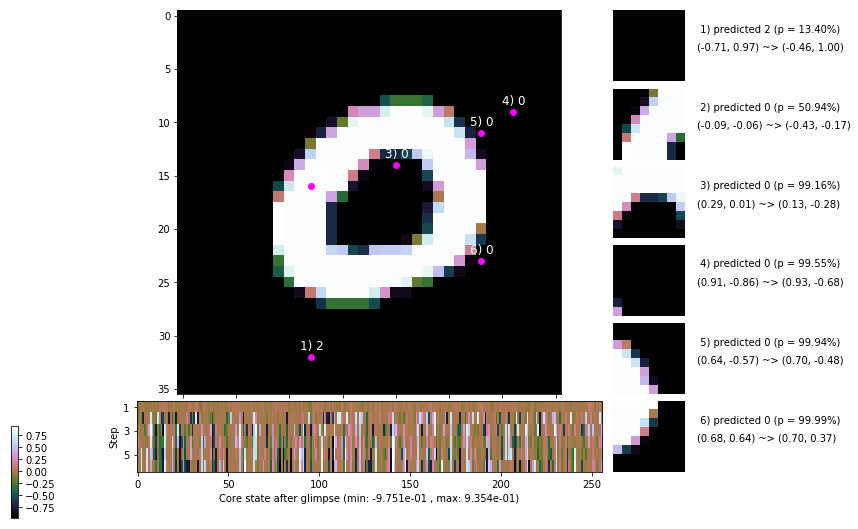

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 136.5 ms/b | lr: 8.44e-04 | grad 2norm: 12.27 | grad inf norm:  2.862
         Weights || abs max:  1.67 (12213.67) | mean: -1.74e-04 ( 0.03) | var: 3.71e-02 (15393.39)
          Biases || abs max:  0.79 (   74.43) | mean: -9.34e-02 ( 0.08) | var: 4.05e-02 (   15.49)
                    class loss: 0.353 | steps: 2.358 | reward:  3.488 | acc.: 88.25%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 135.5 ms/b | lr: 8.44e-04 | grad 2norm: 12.53 | grad inf norm:  2.923
         Weights || abs max:  1.69 ( 4699.27) | mean: -1.58e-04 ( 0.02) | var: 3.73e-02 ( 1151.31)
          Biases || abs max:  0.80 (  184.41) | mean: -9.40e-02 ( 0.14) | var: 4.06e-02 ( 1010.09)
                    class loss: 0.380 | steps: 2.406 | reward:  3.377 | acc.: 87.42%

	Target class: 4 | Discounted rewards: [-0.389, 1.111, 1.

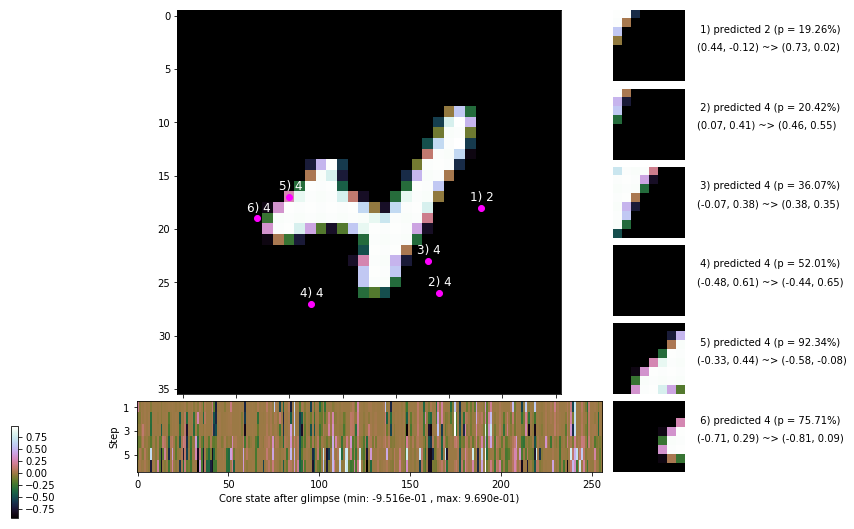

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 140.9 ms/b | lr: 8.42e-04 | grad 2norm: 12.24 | grad inf norm:  2.923
         Weights || abs max:  1.70 ( 3670.32) | mean: -1.56e-04 ( 0.02) | var: 3.74e-02 (  321.06)
          Biases || abs max:  0.80 (   74.61) | mean: -9.47e-02 ( 0.09) | var: 4.11e-02 (   25.28)
                    class loss: 0.341 | steps: 2.364 | reward:  3.479 | acc.: 88.48%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 138.2 ms/b | lr: 8.41e-04 | grad 2norm: 12.41 | grad inf norm:  2.955
         Weights || abs max:  1.70 ( 6362.67) | mean: -1.73e-04 ( 0.02) | var: 3.77e-02 ( 6903.68)
          Biases || abs max:  0.82 (  148.15) | mean: -9.48e-02 ( 0.11) | var: 4.12e-02 (  480.81)
                    class loss: 0.362 | steps: 2.370 | reward:  3.475 | acc.: 88.57%

	Target class: 3 | Discounted rewards: [-0.389, 1.111, 1.

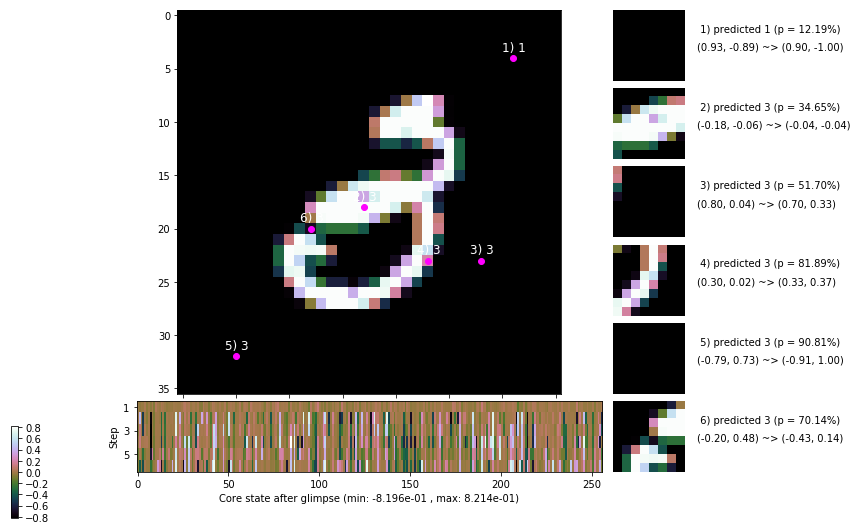

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 135.7 ms/b | lr: 8.39e-04 | grad 2norm: 12.49 | grad inf norm:  2.868
         Weights || abs max:  1.71 ( 4296.50) | mean: -1.60e-04 ( 0.02) | var: 3.79e-02 (  696.40)
          Biases || abs max:  0.83 (   68.34) | mean: -9.52e-02 ( 0.08) | var: 4.15e-02 (   27.70)
                    class loss: 0.334 | steps: 2.345 | reward:  3.493 | acc.: 88.67%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 136.6 ms/b | lr: 8.39e-04 | grad 2norm: 12.48 | grad inf norm:  2.850
         Weights || abs max:  1.70 ( 4334.31) | mean: -1.23e-04 ( 0.02) | var: 3.80e-02 ( 1603.43)
          Biases || abs max:  0.83 (   79.56) | mean: -9.63e-02 ( 0.08) | var: 4.18e-02 (   63.01)
                    class loss: 0.362 | steps: 2.381 | reward:  3.428 | acc.: 88.15%

	Target class: 4 | Discounted rewards: [1.111, 1.109, 1.0

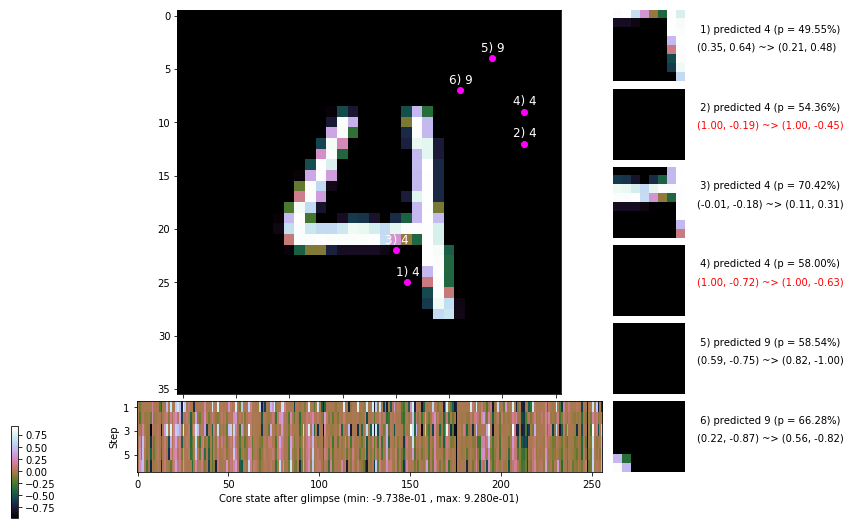

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 135.2 ms/b | lr: 8.37e-04 | grad 2norm: 12.49 | grad inf norm:  2.944
         Weights || abs max:  1.71 ( 2910.12) | mean: -8.21e-05 ( 0.01) | var: 3.82e-02 (  159.18)
          Biases || abs max:  0.84 (   60.13) | mean: -9.62e-02 ( 0.07) | var: 4.21e-02 (   15.21)
                    class loss: 0.340 | steps: 2.352 | reward:  3.515 | acc.: 88.85%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 129.4 ms/b | lr: 8.36e-04 | grad 2norm: 12.33 | grad inf norm:  2.944
         Weights || abs max:  1.73 ( 3492.22) | mean: -1.19e-04 ( 0.02) | var: 3.84e-02 (  268.02)
          Biases || abs max:  0.87 (   57.54) | mean: -9.62e-02 ( 0.07) | var: 4.22e-02 (   29.67)
                    class loss: 0.333 | steps: 2.333 | reward:  3.521 | acc.: 88.48%

	Target class: 0 | Discounted rewards: [-0.389, 1.111, 1.

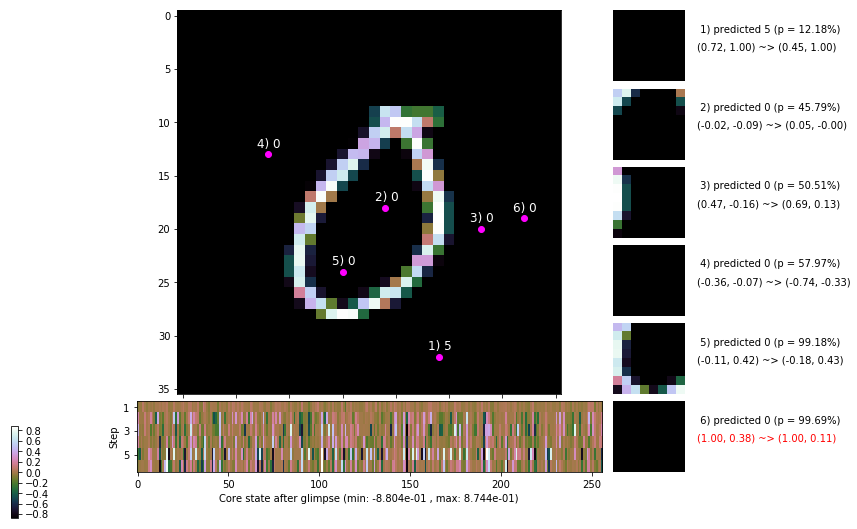

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [-0.539, -0.389, 1.111, 1.110, 1.100, 1.000]


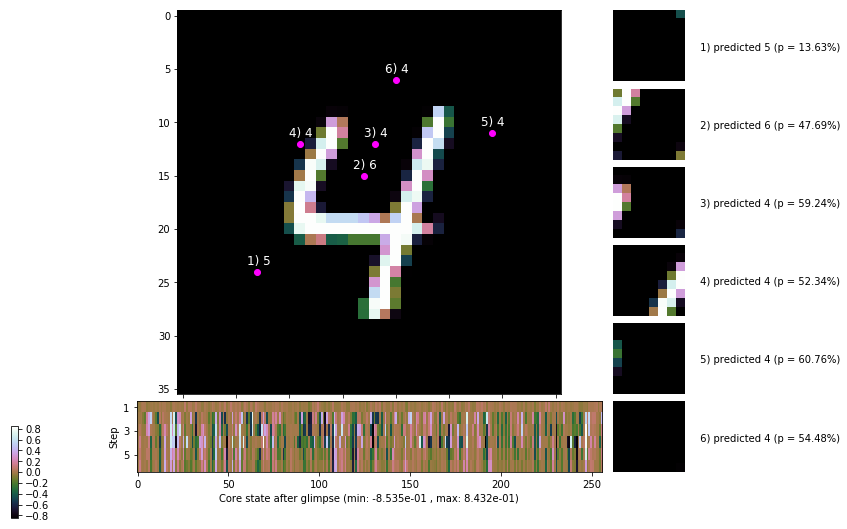


	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


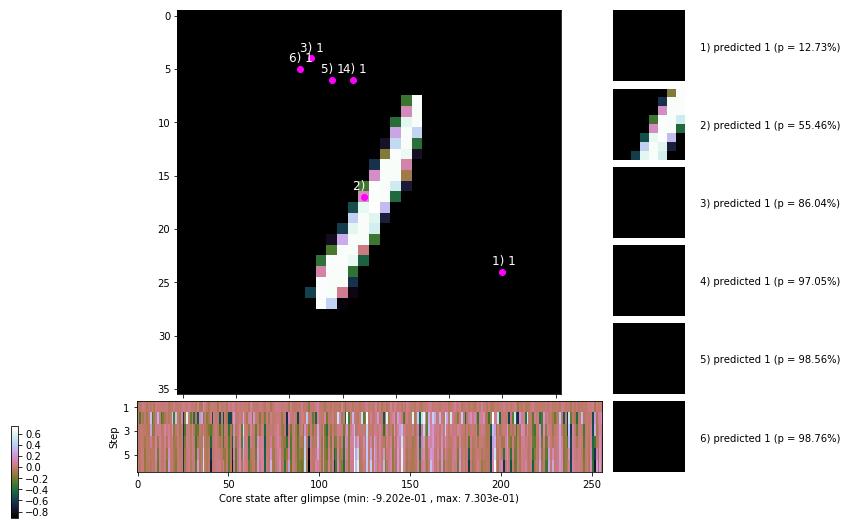

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


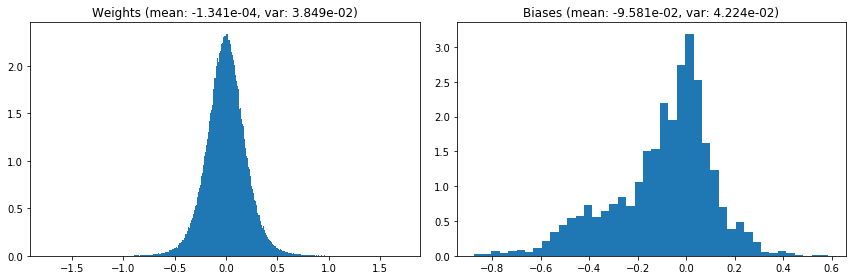

                                      Location network weights and biases


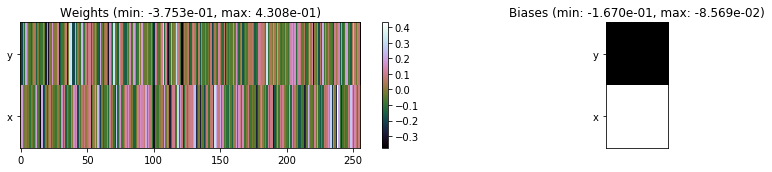

---------------------------------------------------------------------------------------------------------------
Elapsed time:  407.32 sec | TRAIN >> class loss: 0.3531 | steps:  2.366    | reward:  3.4658    | acc.: 88.288% 
                          | VAL   >> class loss: 0.3207 | steps:  2.252    | reward:  3.6696    | acc.: 89.140% 


Epoch  13/400) lr = 0.0008352
 b    300/  3000 >> 126.6 ms/b | lr: 8.34e-04 | grad 2norm: 12.63 | grad inf norm:  2.860
         Weights || abs max:  1.73 ( 3190.47) | mean: -1.19e-04 ( 0.02) | var: 3.86e-02 (  561.90)
          Biases || abs max:  0.87 (  195.98) | mean: -9.59e-02 ( 0.13) | var: 4.23e-02 (  520.75)
                    class loss: 0.345 | steps: 2.368 | reward:  3.458 | acc.: 88.72%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.7 ms/b | lr: 8.34e-04 | grad 2norm: 12.58 | grad inf norm:  3.039
         Weights || abs max:  1.74 ( 4673.13) | mean: -1.04e-04 ( 0.0

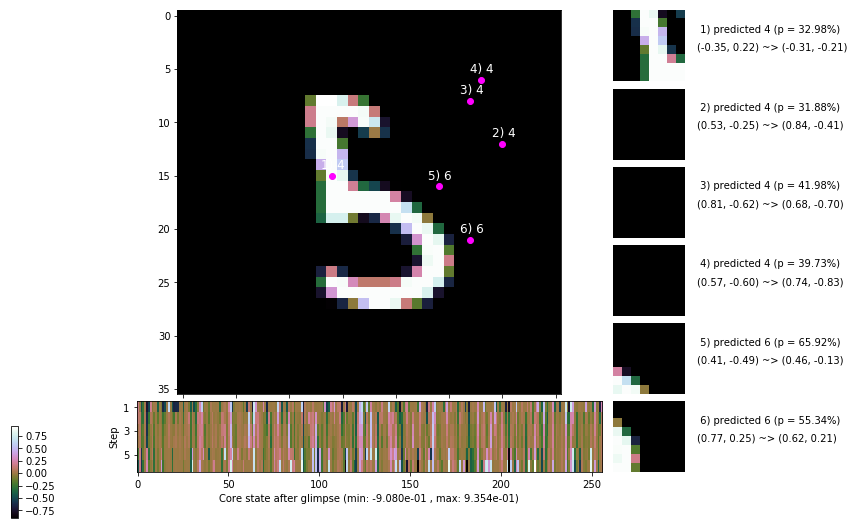

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 141.9 ms/b | lr: 8.32e-04 | grad 2norm: 12.17 | grad inf norm:  3.013
         Weights || abs max:  1.75 ( 3701.89) | mean: -9.35e-05 ( 0.02) | var: 3.89e-02 (  362.81)
          Biases || abs max:  0.87 (   74.80) | mean: -9.70e-02 ( 0.09) | var: 4.28e-02 (   21.12)
                    class loss: 0.321 | steps: 2.332 | reward:  3.533 | acc.: 89.47%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 145.3 ms/b | lr: 8.31e-04 | grad 2norm: 12.56 | grad inf norm:  2.939
         Weights || abs max:  1.75 ( 3273.61) | mean: -1.09e-04 ( 0.02) | var: 3.91e-02 (  189.06)
          Biases || abs max:  0.87 (   39.54) | mean: -9.78e-02 ( 0.07) | var: 4.32e-02 (    4.11)
                    class loss: 0.363 | steps: 2.357 | reward:  3.468 | acc.: 88.32%

	Target class: 3 | Discounted rewards: [-0.389, 1.111, 1.

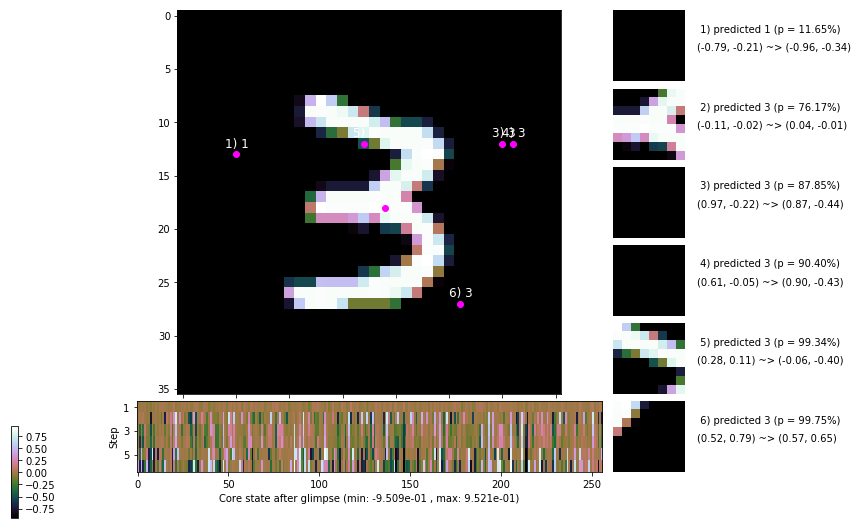

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 144.8 ms/b | lr: 8.29e-04 | grad 2norm: 12.48 | grad inf norm:  2.989
         Weights || abs max:  1.76 ( 2064.96) | mean: -7.62e-05 ( 0.01) | var: 3.93e-02 (   38.25)
          Biases || abs max:  0.88 (   93.09) | mean: -9.81e-02 ( 0.09) | var: 4.35e-02 (   79.56)
                    class loss: 0.368 | steps: 2.367 | reward:  3.446 | acc.: 88.03%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 146.0 ms/b | lr: 8.29e-04 | grad 2norm: 12.38 | grad inf norm:  3.125
         Weights || abs max:  1.77 ( 4291.31) | mean: -1.15e-04 ( 0.02) | var: 3.95e-02 ( 1183.44)
          Biases || abs max:  0.88 (  110.15) | mean: -9.83e-02 ( 0.12) | var: 4.38e-02 (  236.82)
                    class loss: 0.359 | steps: 2.354 | reward:  3.486 | acc.: 88.17%

	Target class: 5 | Discounted rewards: [-0.389, 1.111, 1.

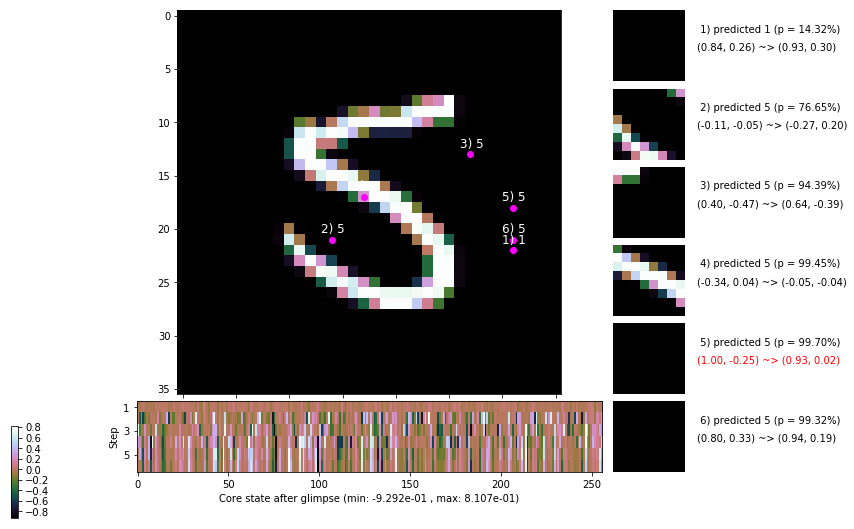

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.0 ms/b | lr: 8.27e-04 | grad 2norm: 12.11 | grad inf norm:  2.930
         Weights || abs max:  1.78 ( 4241.57) | mean: -1.08e-04 ( 0.02) | var: 3.97e-02 (  553.76)
          Biases || abs max:  0.89 (  119.20) | mean: -9.87e-02 ( 0.12) | var: 4.40e-02 (  156.48)
                    class loss: 0.372 | steps: 2.378 | reward:  3.446 | acc.: 88.30%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 143.7 ms/b | lr: 8.26e-04 | grad 2norm: 12.23 | grad inf norm:  2.961
         Weights || abs max:  1.80 ( 3963.96) | mean: -1.05e-04 ( 0.02) | var: 3.98e-02 (  269.36)
          Biases || abs max:  0.89 (   62.71) | mean: -9.96e-02 ( 0.08) | var: 4.44e-02 (   28.28)
                    class loss: 0.366 | steps: 2.356 | reward:  3.462 | acc.: 87.62%

	Target class: 8 | Discounted rewards: [-0.539, -0.389, 1

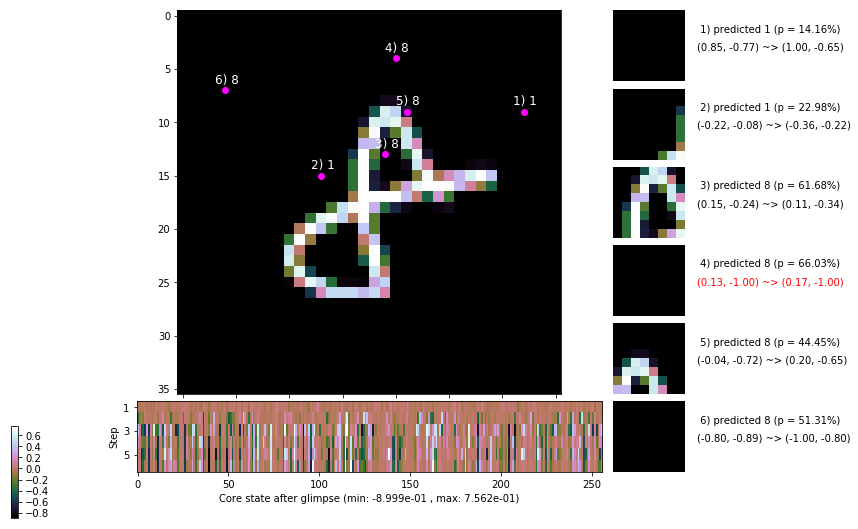

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 137.6 ms/b | lr: 8.24e-04 | grad 2norm: 12.36 | grad inf norm:  3.028
         Weights || abs max:  1.80 ( 3425.26) | mean: -1.03e-04 ( 0.02) | var: 4.00e-02 (  411.18)
          Biases || abs max:  0.89 (   92.88) | mean: -9.95e-02 ( 0.10) | var: 4.43e-02 (  132.98)
                    class loss: 0.348 | steps: 2.355 | reward:  3.485 | acc.: 88.38%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.8 ms/b | lr: 8.24e-04 | grad 2norm: 12.26 | grad inf norm:  2.973
         Weights || abs max:  1.81 ( 9175.66) | mean: -1.61e-04 ( 0.03) | var: 4.02e-02 (20084.89)
          Biases || abs max:  0.89 (  189.30) | mean: -1.00e-01 ( 0.13) | var: 4.46e-02 (  415.90)
                    class loss: 0.348 | steps: 2.363 | reward:  3.467 | acc.: 88.48%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

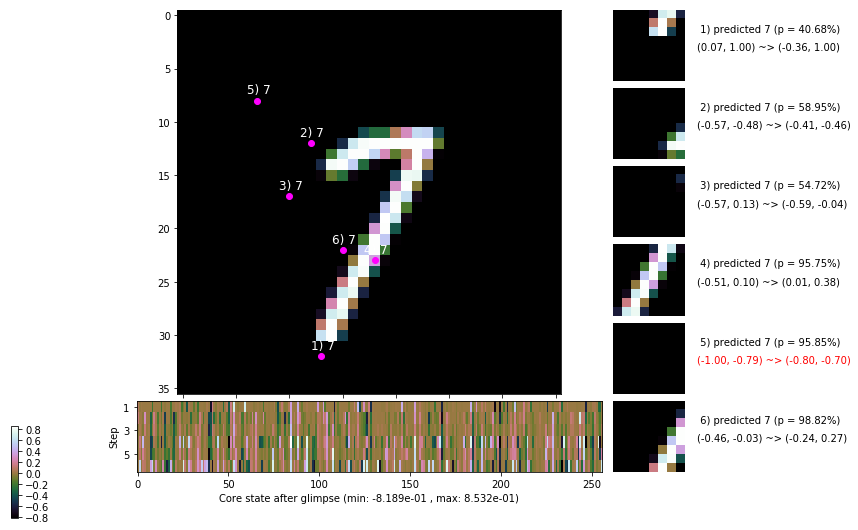

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


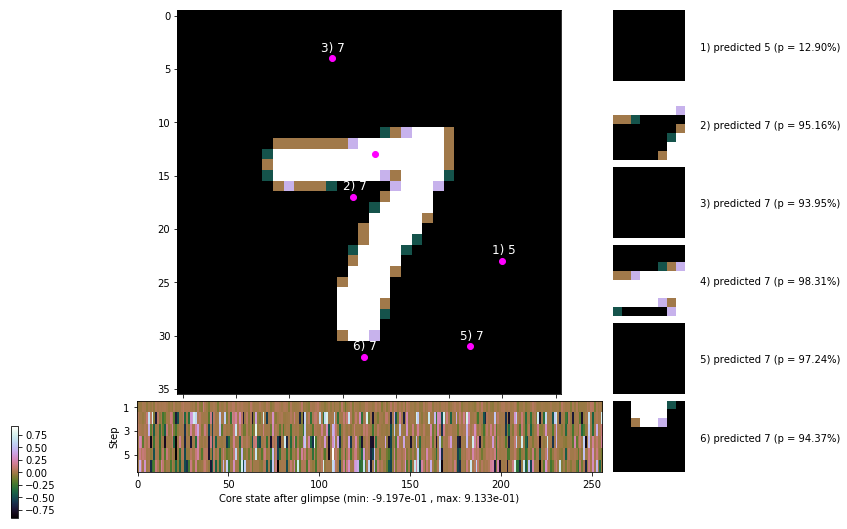


	Target class: 3 | Discounted rewards: [1.096, 0.961, -0.389, 1.110, 1.100, 1.000]


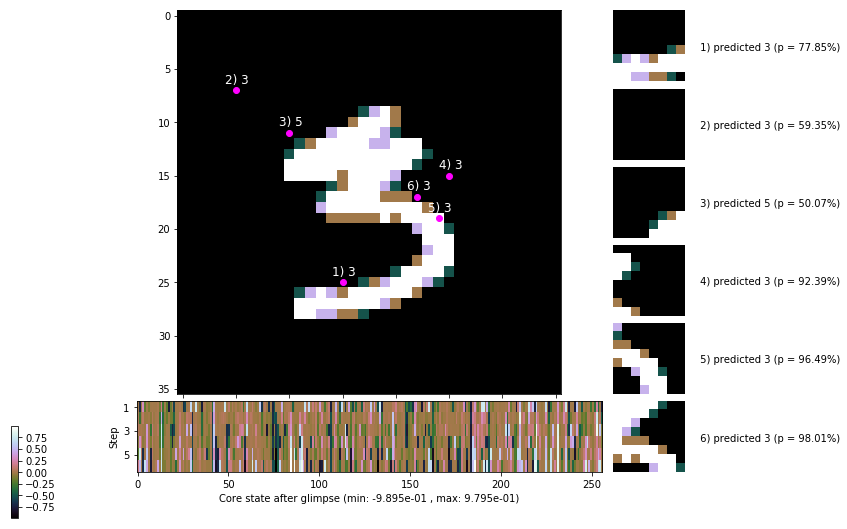

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


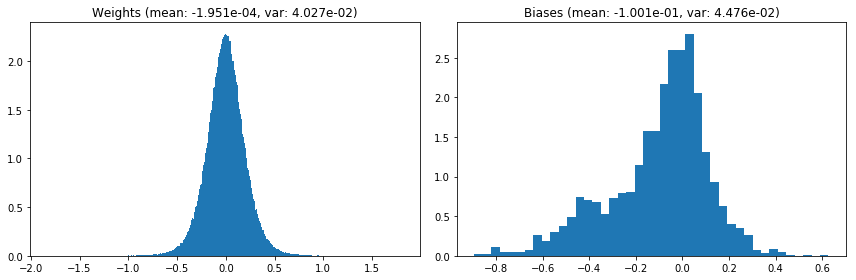

                                      Location network weights and biases


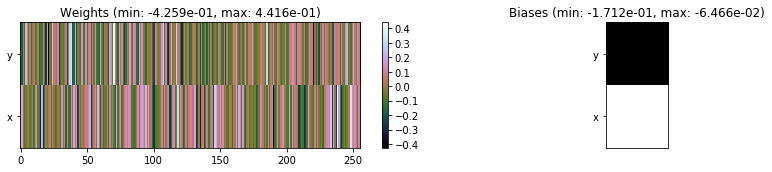

---------------------------------------------------------------------------------------------------------------
Elapsed time:  425.81 sec | TRAIN >> class loss: 0.3541 | steps:  2.358    | reward:  3.4734    | acc.: 88.380% 
                          | VAL   >> class loss: 0.3651 | steps:  2.288 :( | reward:  3.5868 :( | acc.: 87.020% :(


Epoch  14/400) lr = 0.0008228
 b    300/  3000 >> 143.6 ms/b | lr: 8.22e-04 | grad 2norm: 12.28 | grad inf norm:  2.955
         Weights || abs max:  1.83 ( 3258.73) | mean: -1.97e-04 ( 0.01) | var: 4.04e-02 (  431.40)
          Biases || abs max:  0.90 (   46.72) | mean: -1.00e-01 ( 0.06) | var: 4.48e-02 (   10.26)
                    class loss: 0.341 | steps: 2.368 | reward:  3.475 | acc.: 88.55%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 134.2 ms/b | lr: 8.21e-04 | grad 2norm: 12.07 | grad inf norm:  2.908
         Weights || abs max:  1.83 ( 2217.56) | mean: -2.07e-04 ( 0

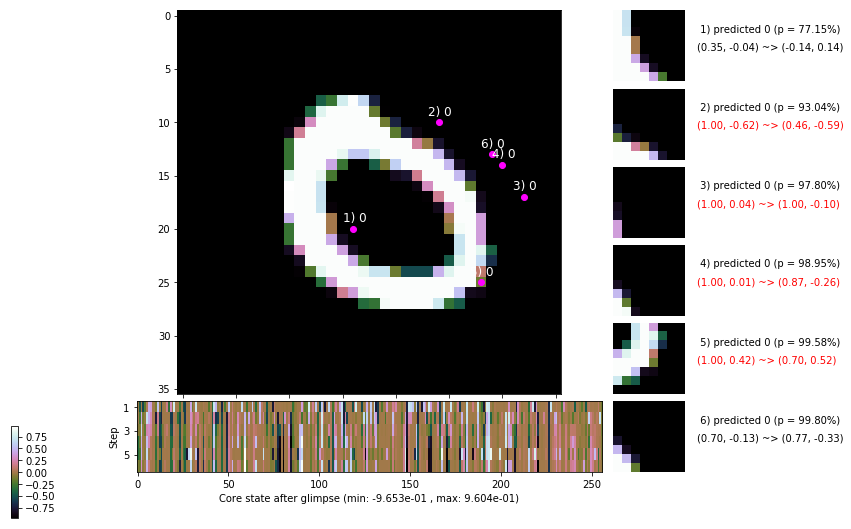

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 137.4 ms/b | lr: 8.19e-04 | grad 2norm: 12.15 | grad inf norm:  2.950
         Weights || abs max:  1.83 ( 2933.95) | mean: -2.43e-04 ( 0.01) | var: 4.07e-02 (  263.97)
          Biases || abs max:  0.89 (   59.29) | mean: -1.02e-01 ( 0.08) | var: 4.54e-02 (   11.19)
                    class loss: 0.350 | steps: 2.344 | reward:  3.462 | acc.: 88.23%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 137.0 ms/b | lr: 8.19e-04 | grad 2norm: 12.14 | grad inf norm:  2.977
         Weights || abs max:  1.85 ( 2070.12) | mean: -2.43e-04 ( 0.01) | var: 4.09e-02 (   76.39)
          Biases || abs max:  0.89 (  110.93) | mean: -1.02e-01 ( 0.10) | var: 4.56e-02 (  139.90)
                    class loss: 0.323 | steps: 2.337 | reward:  3.551 | acc.: 89.55%

	Target class: 5 | Discounted rewards: [-0.556, -0.556, -

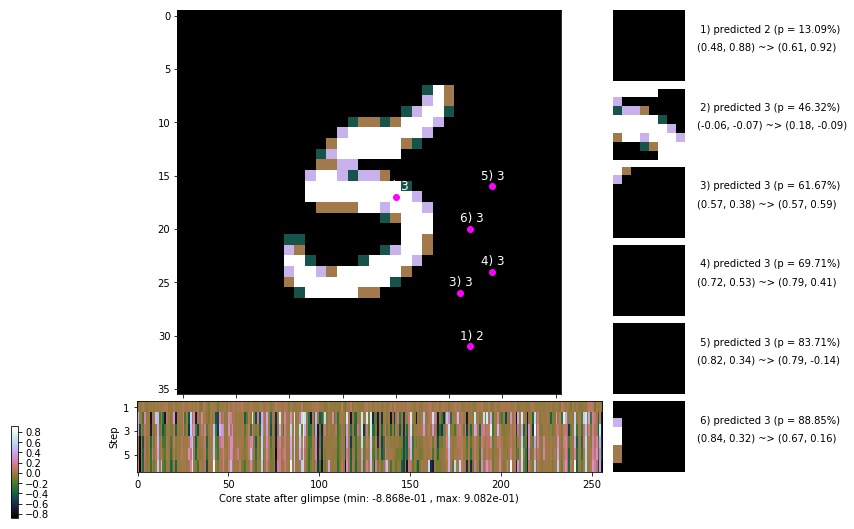

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 138.2 ms/b | lr: 8.17e-04 | grad 2norm: 12.08 | grad inf norm:  2.842
         Weights || abs max:  1.85 (19892.67) | mean: -2.32e-04 ( 0.05) | var: 4.11e-02 (124016.69)
          Biases || abs max:  0.89 (  111.98) | mean: -1.02e-01 ( 0.10) | var: 4.59e-02 (  195.39)
                    class loss: 0.328 | steps: 2.335 | reward:  3.530 | acc.: 89.38%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 156.6 ms/b | lr: 8.16e-04 | grad 2norm: 12.31 | grad inf norm:  2.991
         Weights || abs max:  1.85 ( 5046.87) | mean: -2.15e-04 ( 0.02) | var: 4.13e-02 ( 3646.65)
          Biases || abs max:  0.88 ( 1051.57) | mean: -1.02e-01 ( 0.46) | var: 4.61e-02 (104746.51)
                    class loss: 0.346 | steps: 2.376 | reward:  3.485 | acc.: 88.93%

	Target class: 7 | Discounted rewards: [-0.556, -0.556,

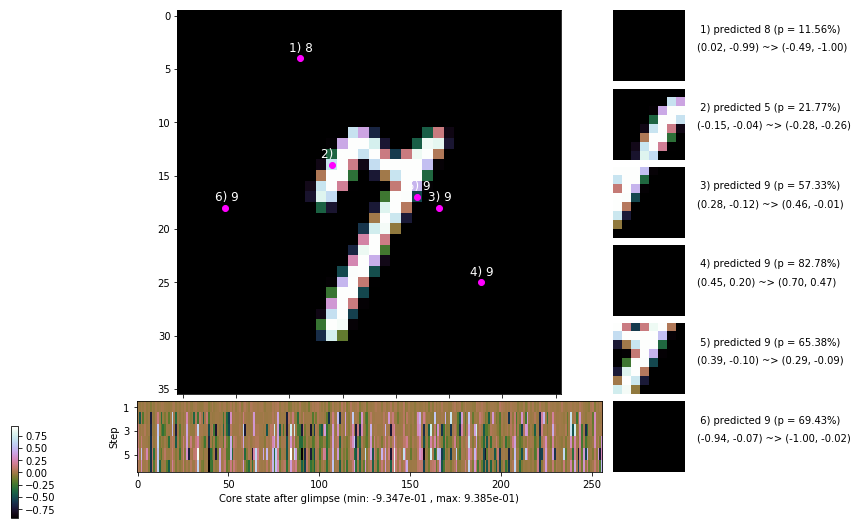

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 135.8 ms/b | lr: 8.15e-04 | grad 2norm: 12.31 | grad inf norm:  2.881
         Weights || abs max:  1.87 ( 7980.13) | mean: -1.95e-04 ( 0.03) | var: 4.14e-02 ( 5654.45)
          Biases || abs max:  0.88 (  112.71) | mean: -1.03e-01 ( 0.10) | var: 4.65e-02 (  357.94)
                    class loss: 0.342 | steps: 2.360 | reward:  3.518 | acc.: 89.25%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 134.1 ms/b | lr: 8.14e-04 | grad 2norm: 12.33 | grad inf norm:  2.991
         Weights || abs max:  1.86 ( 3859.51) | mean: -1.83e-04 ( 0.02) | var: 4.16e-02 (  260.80)
          Biases || abs max:  0.88 (   57.43) | mean: -1.04e-01 ( 0.07) | var: 4.67e-02 (   15.17)
                    class loss: 0.329 | steps: 2.352 | reward:  3.505 | acc.: 88.72%

	Target class: 8 | Discounted rewards: [-0.389, 1.111, 1.

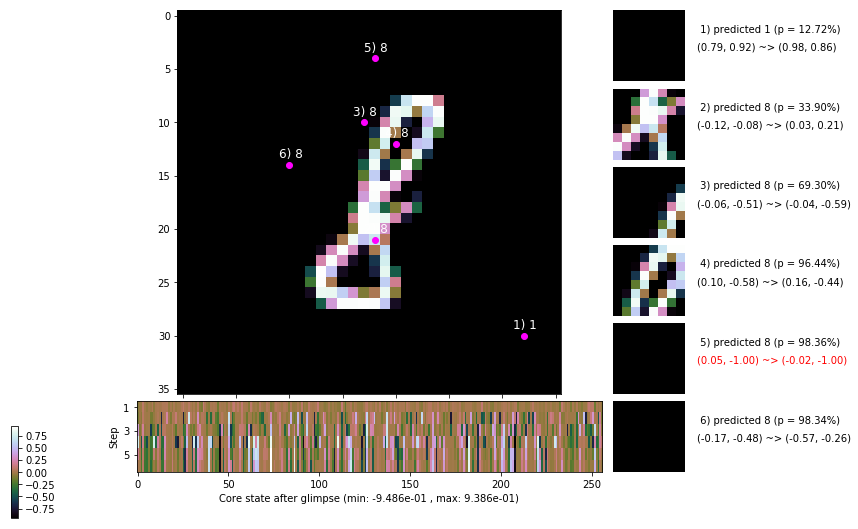

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 135.4 ms/b | lr: 8.12e-04 | grad 2norm: 12.03 | grad inf norm:  2.802
         Weights || abs max:  1.87 ( 3027.02) | mean: -1.74e-04 ( 0.02) | var: 4.18e-02 (  120.09)
          Biases || abs max:  0.89 (   32.09) | mean: -1.04e-01 ( 0.05) | var: 4.69e-02 (    3.30)
                    class loss: 0.332 | steps: 2.341 | reward:  3.546 | acc.: 89.28%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 132.9 ms/b | lr: 8.11e-04 | grad 2norm: 12.38 | grad inf norm:  2.897
         Weights || abs max:  1.87 ( 4127.55) | mean: -1.75e-04 ( 0.02) | var: 4.19e-02 ( 1120.59)
          Biases || abs max:  0.89 (   63.49) | mean: -1.04e-01 ( 0.07) | var: 4.72e-02 (   26.12)
                    class loss: 0.341 | steps: 2.357 | reward:  3.486 | acc.: 88.77%

	Target class: 3 | Discounted rewards: [-0.556, -0.555, -

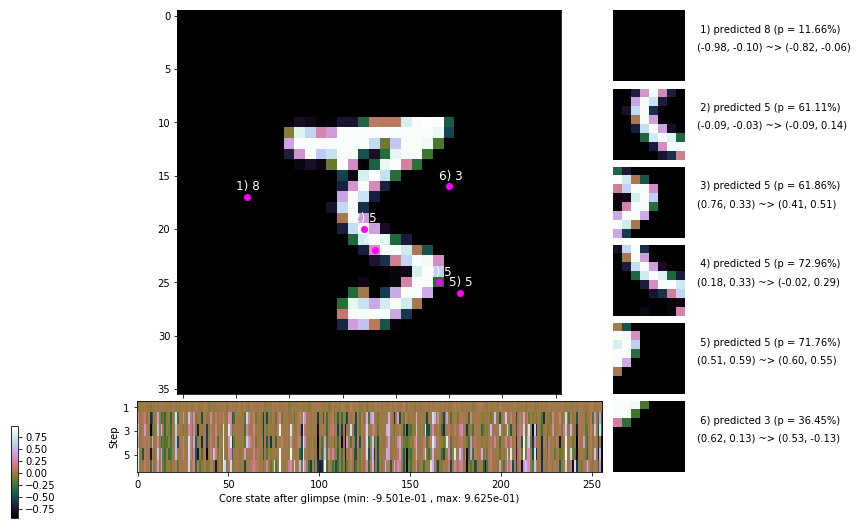

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


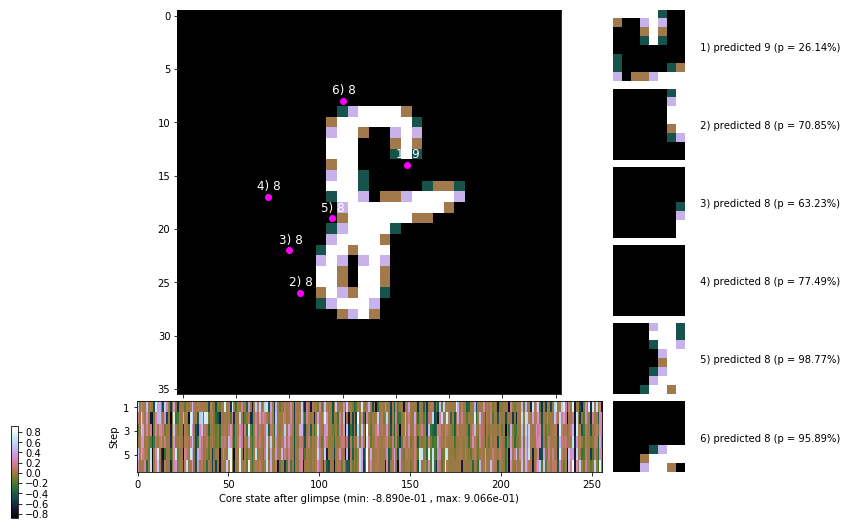


	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


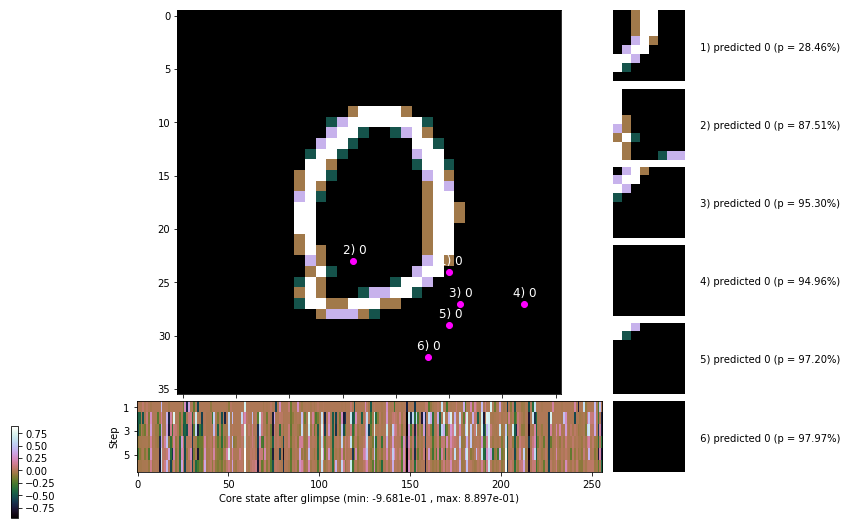

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


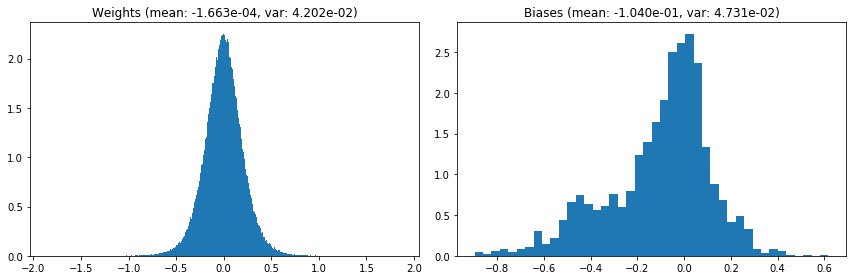

                                      Location network weights and biases


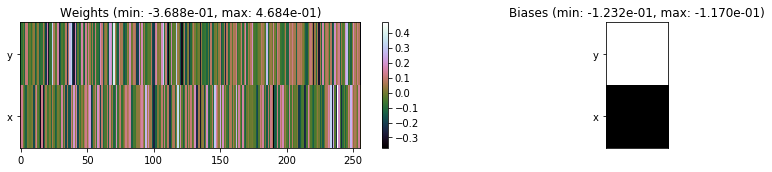

---------------------------------------------------------------------------------------------------------------
Elapsed time:  416.08 sec | TRAIN >> class loss: 0.3373 | steps:  2.351    | reward:  3.5072    | acc.: 88.967% 
                          | VAL   >> class loss: 0.2864 | steps:  2.205    | reward:  3.7980    | acc.: 90.620% 


Epoch  15/400) lr = 0.0008105
 b    300/  3000 >> 134.4 ms/b | lr: 8.10e-04 | grad 2norm: 12.35 | grad inf norm:  2.936
         Weights || abs max:  1.87 ( 2549.77) | mean: -1.68e-04 ( 0.01) | var: 4.21e-02 (  135.40)
          Biases || abs max:  0.90 ( 2376.84) | mean: -1.04e-01 ( 0.97) | var: 4.73e-02 (614884.56)
                    class loss: 0.341 | steps: 2.365 | reward:  3.477 | acc.: 88.83%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 135.1 ms/b | lr: 8.09e-04 | grad 2norm: 12.56 | grad inf norm:  2.984
         Weights || abs max:  1.88 ( 8157.12) | mean: -1.92e-04 ( 0.

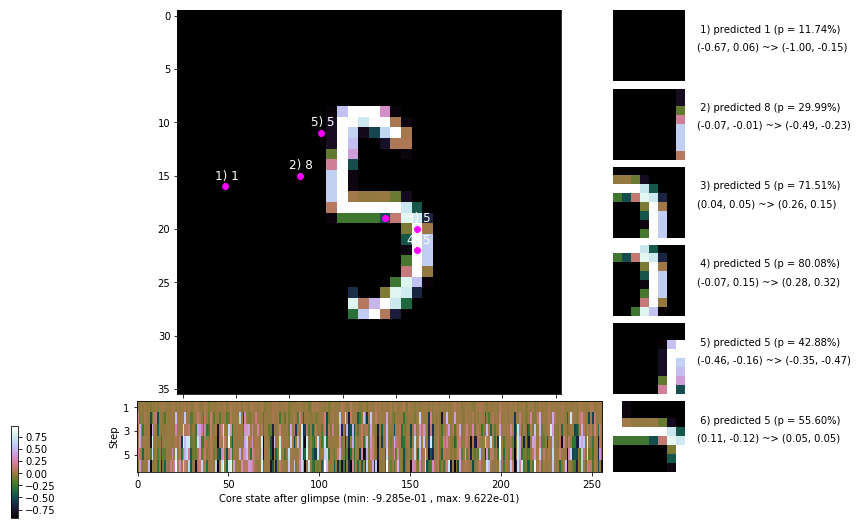

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 136.0 ms/b | lr: 8.07e-04 | grad 2norm: 12.42 | grad inf norm:  2.894
         Weights || abs max:  1.88 ( 5147.53) | mean: -1.83e-04 ( 0.02) | var: 4.24e-02 ( 3670.47)
          Biases || abs max:  0.91 (   59.19) | mean: -1.04e-01 ( 0.07) | var: 4.78e-02 (   13.48)
                    class loss: 0.334 | steps: 2.335 | reward:  3.518 | acc.: 88.75%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 134.3 ms/b | lr: 8.06e-04 | grad 2norm: 12.19 | grad inf norm:  3.009
         Weights || abs max:  1.87 ( 2241.66) | mean: -1.60e-04 ( 0.01) | var: 4.26e-02 (   92.91)
          Biases || abs max:  0.91 (  157.13) | mean: -1.05e-01 ( 0.12) | var: 4.81e-02 (  440.85)
                    class loss: 0.319 | steps: 2.324 | reward:  3.570 | acc.: 89.72%

	Target class: 1 | Discounted rewards: [0.946, -0.539, -0

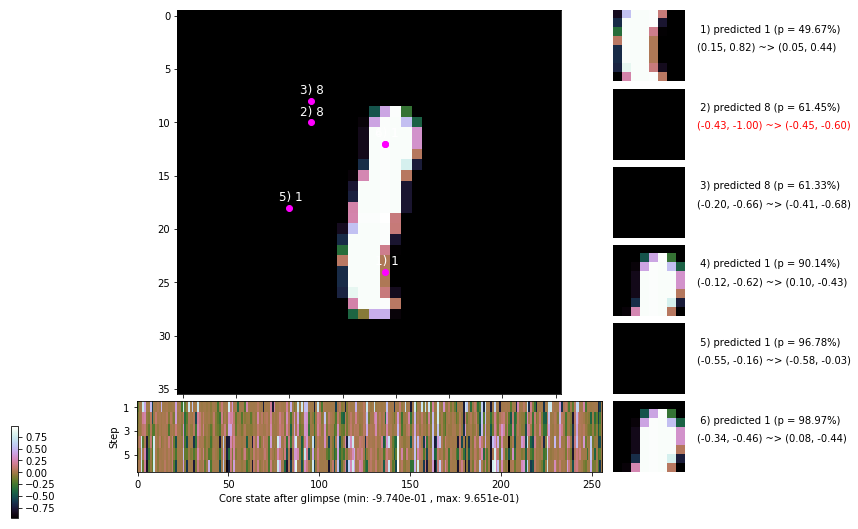

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 136.3 ms/b | lr: 8.05e-04 | grad 2norm: 12.25 | grad inf norm:  2.912
         Weights || abs max:  1.87 ( 4274.93) | mean: -1.47e-04 ( 0.02) | var: 4.27e-02 ( 1881.30)
          Biases || abs max:  0.93 (   75.23) | mean: -1.06e-01 ( 0.08) | var: 4.84e-02 (   44.91)
                    class loss: 0.319 | steps: 2.333 | reward:  3.549 | acc.: 89.63%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 138.7 ms/b | lr: 8.04e-04 | grad 2norm: 12.21 | grad inf norm:  2.998
         Weights || abs max:  1.87 ( 4786.27) | mean: -1.40e-04 ( 0.02) | var: 4.29e-02 (  986.17)
          Biases || abs max:  0.94 (  120.57) | mean: -1.06e-01 ( 0.10) | var: 4.86e-02 (  299.78)
                    class loss: 0.315 | steps: 2.343 | reward:  3.533 | acc.: 89.55%

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.

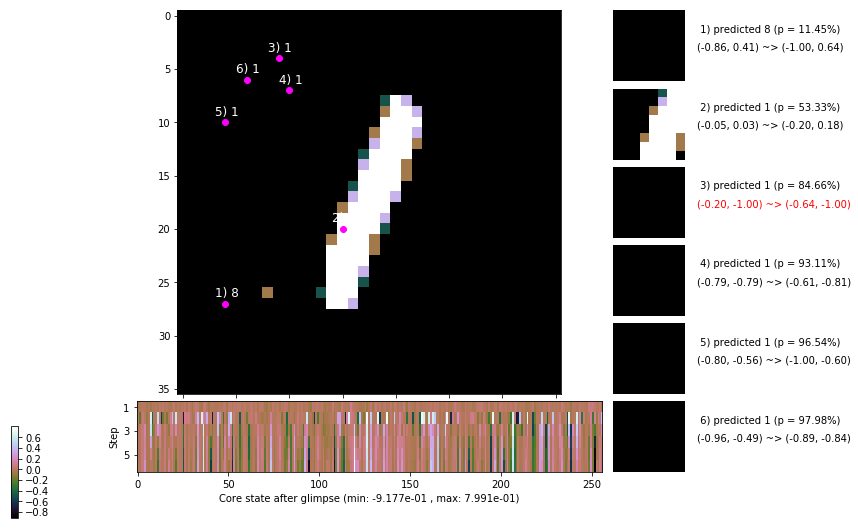

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 136.1 ms/b | lr: 8.02e-04 | grad 2norm: 11.79 | grad inf norm:  2.743
         Weights || abs max:  1.88 ( 8823.29) | mean: -1.15e-04 ( 0.03) | var: 4.31e-02 ( 7438.39)
          Biases || abs max:  0.94 (   82.83) | mean: -1.06e-01 ( 0.09) | var: 4.86e-02 (   40.99)
                    class loss: 0.300 | steps: 2.292 | reward:  3.628 | acc.: 90.15%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.8 ms/b | lr: 8.02e-04 | grad 2norm: 12.28 | grad inf norm:  2.876
         Weights || abs max:  1.88 ( 5389.78) | mean: -1.23e-04 ( 0.02) | var: 4.32e-02 ( 1695.74)
          Biases || abs max:  0.94 (  183.08) | mean: -1.07e-01 ( 0.15) | var: 4.87e-02 (  711.59)
                    class loss: 0.324 | steps: 2.349 | reward:  3.512 | acc.: 89.10%

	Target class: 8 | Discounted rewards: [-0.389, 1.111, 1.

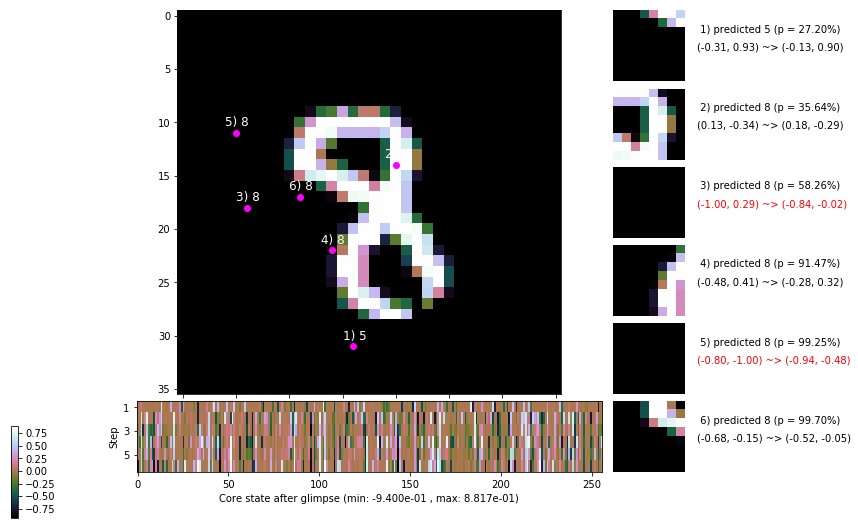

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 137.2 ms/b | lr: 8.00e-04 | grad 2norm: 12.04 | grad inf norm:  2.797
         Weights || abs max:  1.89 ( 3445.14) | mean: -1.09e-04 ( 0.02) | var: 4.34e-02 (  585.15)
          Biases || abs max:  0.94 (  110.44) | mean: -1.07e-01 ( 0.13) | var: 4.90e-02 (  682.79)
                    class loss: 0.311 | steps: 2.293 | reward:  3.608 | acc.: 90.07%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.9 ms/b | lr: 7.99e-04 | grad 2norm: 12.20 | grad inf norm:  2.776
         Weights || abs max:  1.89 ( 6514.48) | mean: -1.37e-04 ( 0.02) | var: 4.36e-02 ( 9329.46)
          Biases || abs max:  0.93 (   66.04) | mean: -1.07e-01 ( 0.08) | var: 4.90e-02 (   23.43)
                    class loss: 0.318 | steps: 2.316 | reward:  3.576 | acc.: 89.73%

	Target class: 2 | Discounted rewards: [-0.539, -0.389, 1

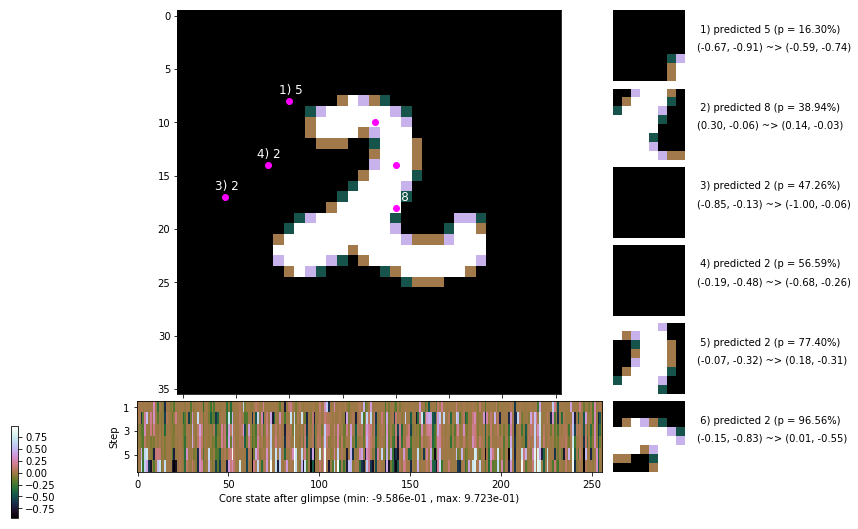

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


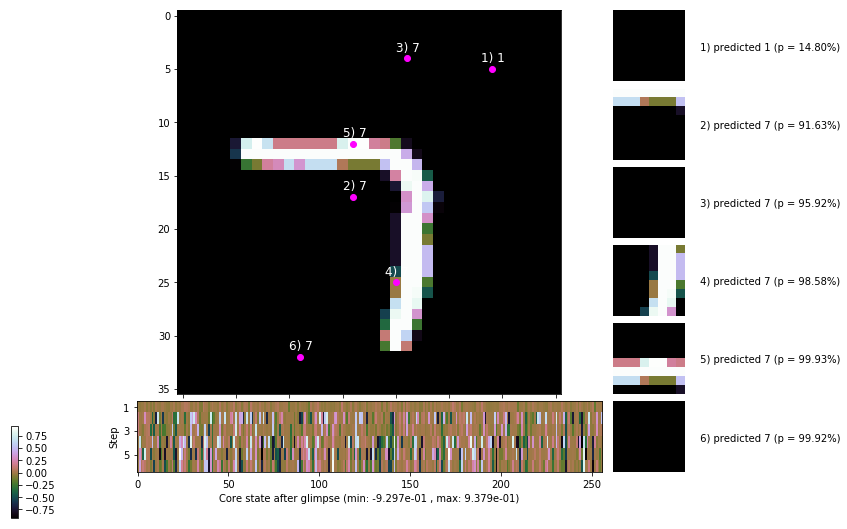


	Target class: 5 | Discounted rewards: [-0.555, -0.554, -0.539, -0.390, 1.100, 1.000]


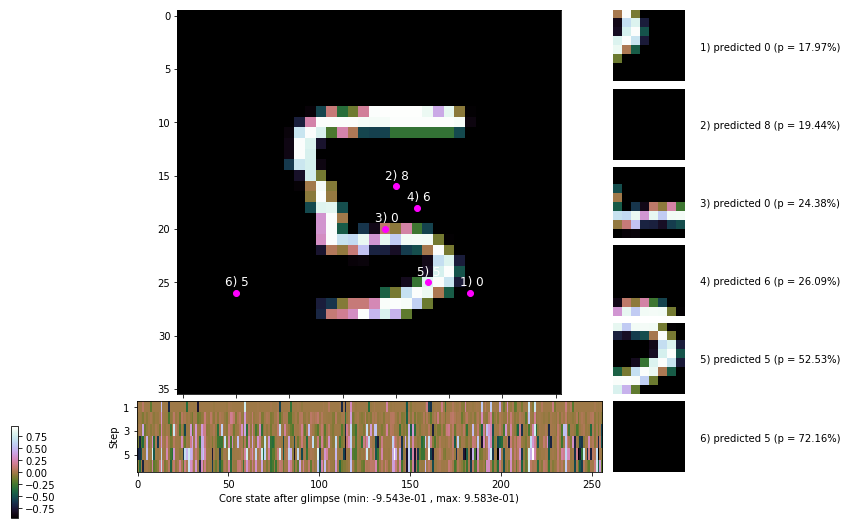

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


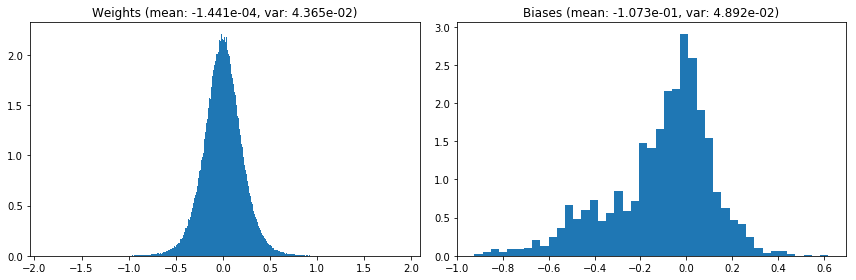

                                      Location network weights and biases


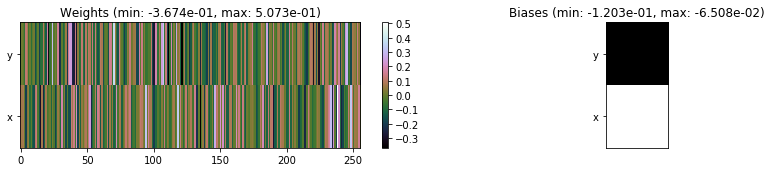

---------------------------------------------------------------------------------------------------------------
Elapsed time:  414.74 sec | TRAIN >> class loss: 0.3221 | steps:  2.332    | reward:  3.5452    | acc.: 89.430% 
                          | VAL   >> class loss: 0.2894 | steps:  2.192    | reward:  3.8040    | acc.: 90.380% :(


Epoch  16/400) lr = 0.0007984
 b    300/  3000 >> 136.0 ms/b | lr: 7.98e-04 | grad 2norm: 12.37 | grad inf norm:  2.865
         Weights || abs max:  1.89 ( 4374.73) | mean: -1.25e-04 ( 0.02) | var: 4.37e-02 (  772.44)
          Biases || abs max:  0.93 (   55.62) | mean: -1.07e-01 ( 0.08) | var: 4.91e-02 (   12.88)
                    class loss: 0.327 | steps: 2.318 | reward:  3.565 | acc.: 89.25%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 132.7 ms/b | lr: 7.97e-04 | grad 2norm: 12.20 | grad inf norm:  2.900
         Weights || abs max:  1.90 ( 3017.44) | mean: -8.36e-05 ( 0

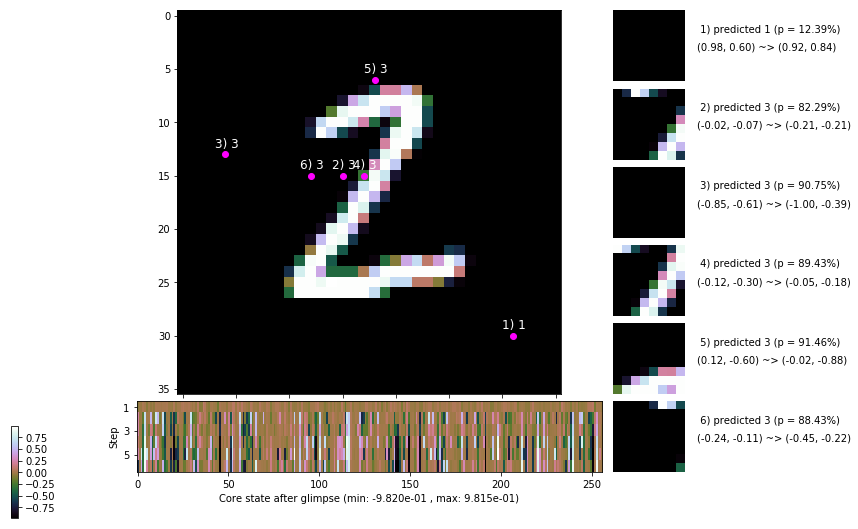

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 135.6 ms/b | lr: 7.95e-04 | grad 2norm: 12.06 | grad inf norm:  2.858
         Weights || abs max:  1.89 ( 3797.75) | mean: -2.72e-05 ( 0.02) | var: 4.40e-02 (  515.54)
          Biases || abs max:  0.92 (   81.25) | mean: -1.08e-01 ( 0.08) | var: 4.99e-02 (   53.78)
                    class loss: 0.321 | steps: 2.314 | reward:  3.591 | acc.: 89.77%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 136.4 ms/b | lr: 7.94e-04 | grad 2norm: 12.32 | grad inf norm:  2.934
         Weights || abs max:  1.90 ( 4392.06) | mean: -6.05e-05 ( 0.02) | var: 4.42e-02 ( 2227.90)
          Biases || abs max:  0.93 (   84.45) | mean: -1.09e-01 ( 0.08) | var: 5.01e-02 (   57.39)
                    class loss: 0.315 | steps: 2.324 | reward:  3.558 | acc.: 89.18%

	Target class: 3 | Discounted rewards: [-0.389, 1.111, 1.

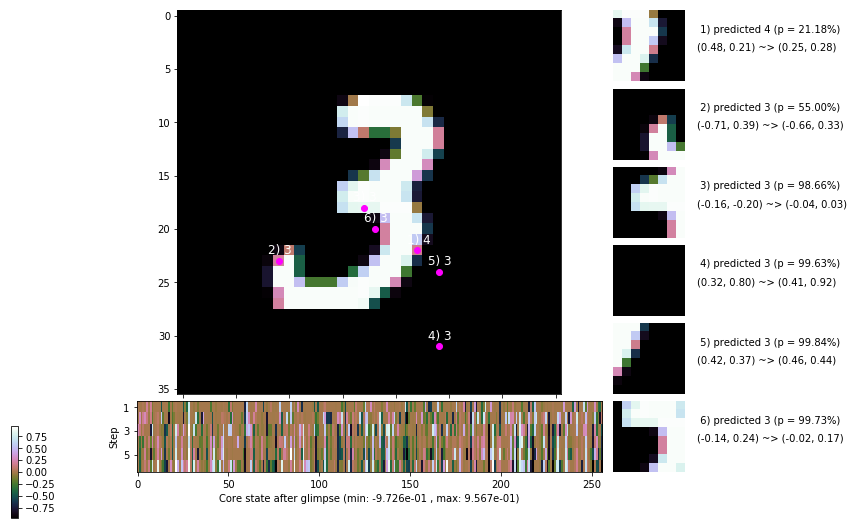

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 137.1 ms/b | lr: 7.93e-04 | grad 2norm: 12.77 | grad inf norm:  2.906
         Weights || abs max:  1.89 ( 6054.40) | mean: -9.49e-05 ( 0.02) | var: 4.44e-02 ( 6335.64)
          Biases || abs max:  0.94 (   93.17) | mean: -1.08e-01 ( 0.08) | var: 5.03e-02 (  221.42)
                    class loss: 0.326 | steps: 2.329 | reward:  3.529 | acc.: 88.92%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 134.8 ms/b | lr: 7.92e-04 | grad 2norm: 11.95 | grad inf norm:  2.831
         Weights || abs max:  1.89 ( 3125.55) | mean: -8.67e-05 ( 0.01) | var: 4.45e-02 (  243.90)
          Biases || abs max:  0.93 (   79.95) | mean: -1.09e-01 ( 0.09) | var: 5.07e-02 (   34.81)
                    class loss: 0.310 | steps: 2.293 | reward:  3.615 | acc.: 89.87%

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.

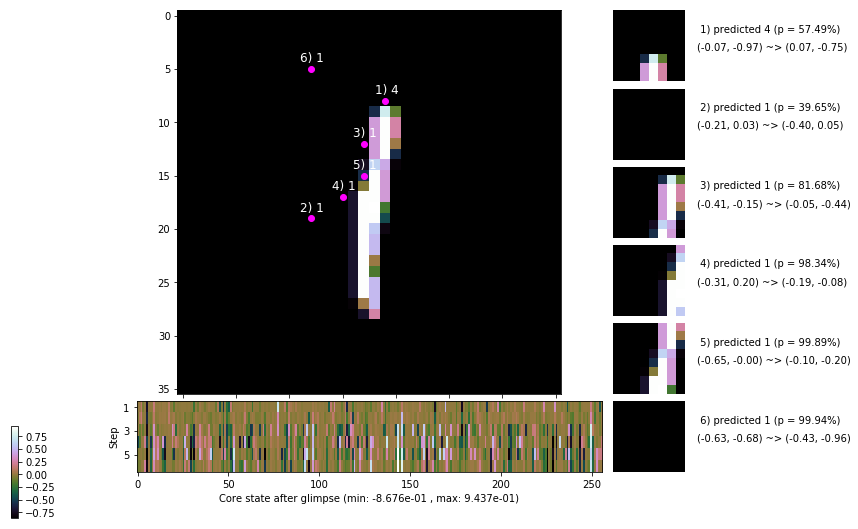

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 135.1 ms/b | lr: 7.90e-04 | grad 2norm: 12.22 | grad inf norm:  2.908
         Weights || abs max:  1.89 ( 3460.15) | mean: -9.02e-05 ( 0.02) | var: 4.47e-02 (  344.44)
          Biases || abs max:  0.92 (  205.32) | mean: -1.09e-01 ( 0.14) | var: 5.08e-02 ( 2252.79)
                    class loss: 0.310 | steps: 2.309 | reward:  3.602 | acc.: 90.38%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 136.5 ms/b | lr: 7.90e-04 | grad 2norm: 12.00 | grad inf norm:  2.846
         Weights || abs max:  1.89 ( 3395.60) | mean: -8.14e-05 ( 0.02) | var: 4.48e-02 (  190.36)
          Biases || abs max:  0.93 (  125.82) | mean: -1.09e-01 ( 0.11) | var: 5.10e-02 (   91.70)
                    class loss: 0.301 | steps: 2.281 | reward:  3.641 | acc.: 90.32%

	Target class: 8 | Discounted rewards: [-0.539, -0.389, 1

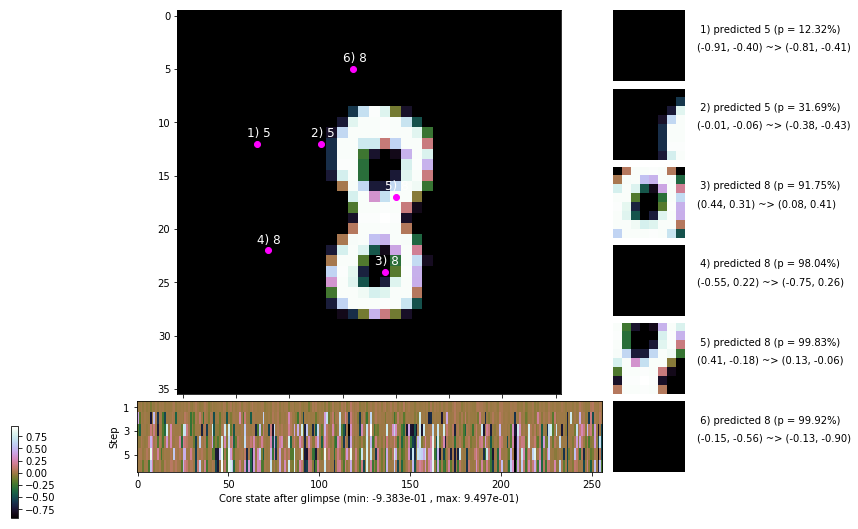

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 137.0 ms/b | lr: 7.88e-04 | grad 2norm: 12.01 | grad inf norm:  2.949
         Weights || abs max:  1.88 ( 4125.95) | mean: -9.22e-05 ( 0.02) | var: 4.50e-02 (  430.59)
          Biases || abs max:  0.94 (   45.84) | mean: -1.09e-01 ( 0.06) | var: 5.12e-02 (    6.10)
                    class loss: 0.315 | steps: 2.318 | reward:  3.569 | acc.: 89.68%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 135.4 ms/b | lr: 7.87e-04 | grad 2norm: 12.13 | grad inf norm:  2.887
         Weights || abs max:  1.88 ( 6799.67) | mean: -1.24e-04 ( 0.02) | var: 4.51e-02 ( 5773.56)
          Biases || abs max:  0.94 (   72.26) | mean: -1.10e-01 ( 0.08) | var: 5.14e-02 (   36.86)
                    class loss: 0.325 | steps: 2.329 | reward:  3.549 | acc.: 89.53%

	Target class: 4 | Discounted rewards: [-0.389, 1.111, 1.

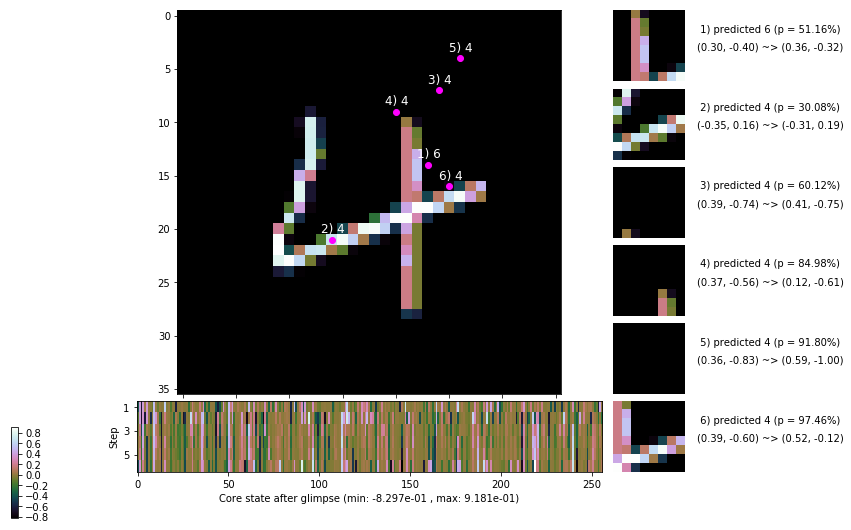

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [-0.555, -0.554, -0.539, -0.390, 1.100, 1.000]


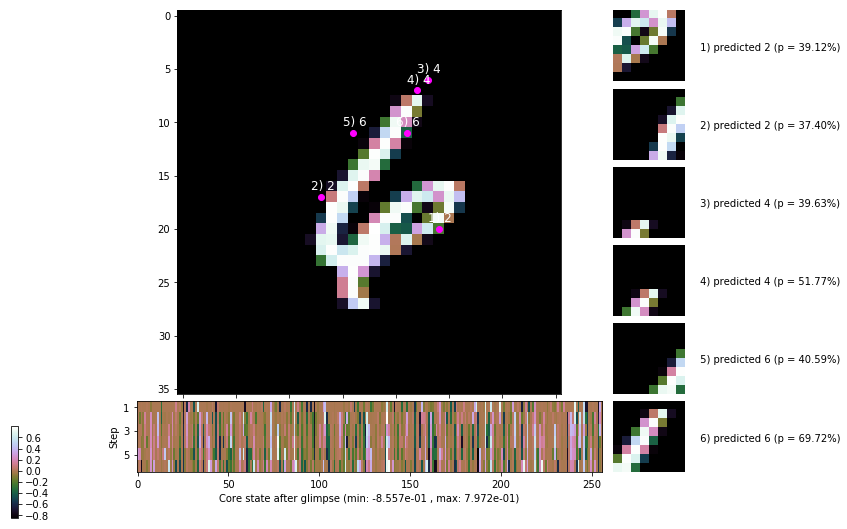


	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


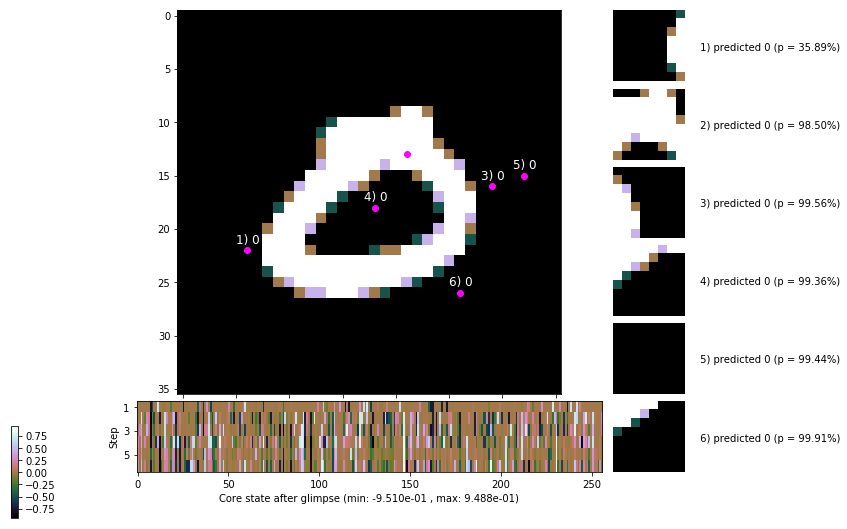

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


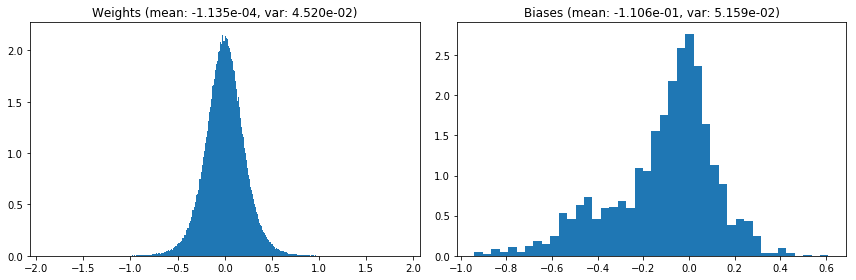

                                      Location network weights and biases


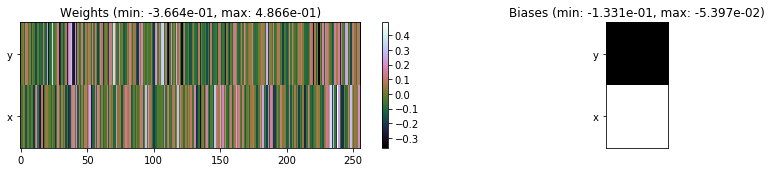

---------------------------------------------------------------------------------------------------------------
Elapsed time:  407.55 sec | TRAIN >> class loss: 0.3166 | steps:  2.313    | reward:  3.5792    | acc.: 89.665% 
                          | VAL   >> class loss: 0.2981 | steps:  2.183    | reward:  3.7932 :( | acc.: 90.360% :(


Epoch  17/400) lr = 0.0007865
 b    300/  3000 >> 133.0 ms/b | lr: 7.86e-04 | grad 2norm: 11.86 | grad inf norm:  2.824
         Weights || abs max:  1.89 ( 2073.07) | mean: -1.12e-04 ( 0.01) | var: 4.53e-02 (   46.42)
          Biases || abs max:  0.95 (   59.79) | mean: -1.11e-01 ( 0.07) | var: 5.18e-02 (   36.65)
                    class loss: 0.321 | steps: 2.305 | reward:  3.586 | acc.: 89.77%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 133.3 ms/b | lr: 7.85e-04 | grad 2norm: 11.80 | grad inf norm:  2.780
         Weights || abs max:  1.91 ( 3396.10) | mean: -1.15e-04 ( 0

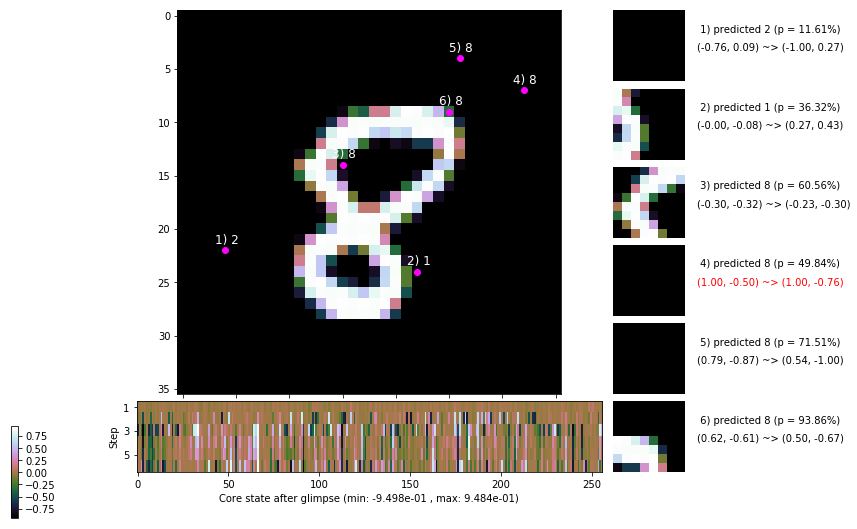

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 136.1 ms/b | lr: 7.83e-04 | grad 2norm: 12.13 | grad inf norm:  2.919
         Weights || abs max:  1.92 ( 6400.65) | mean: -8.41e-05 ( 0.02) | var: 4.56e-02 ( 2960.38)
          Biases || abs max:  0.96 (  102.32) | mean: -1.11e-01 ( 0.10) | var: 5.22e-02 (   42.49)
                    class loss: 0.309 | steps: 2.309 | reward:  3.600 | acc.: 89.80%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 146.6 ms/b | lr: 7.83e-04 | grad 2norm: 12.23 | grad inf norm:  2.978
         Weights || abs max:  1.93 (45979.47) | mean: -8.76e-05 ( 0.09) | var: 4.58e-02 (562339.31)
          Biases || abs max:  0.97 (  167.52) | mean: -1.11e-01 ( 0.12) | var: 5.24e-02 (  858.40)
                    class loss: 0.305 | steps: 2.288 | reward:  3.639 | acc.: 90.40%

	Target class: 8 | Discounted rewards: [-0.539, -0.389, 

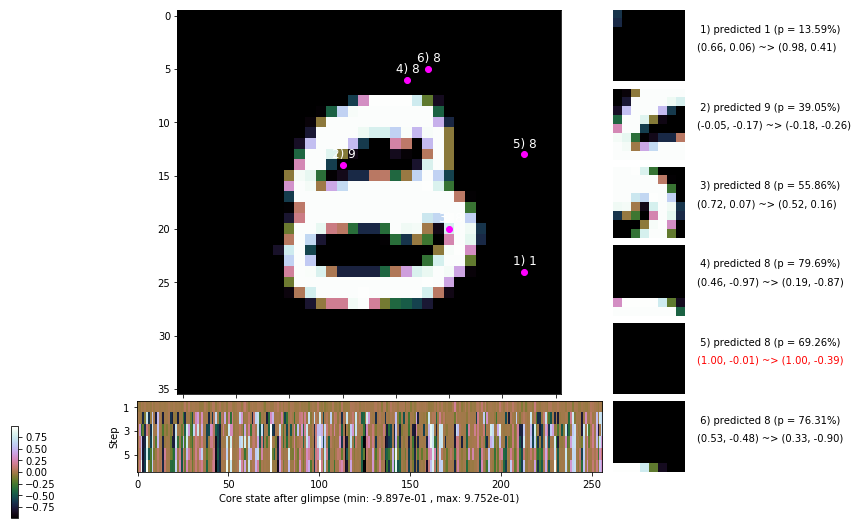

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 147.8 ms/b | lr: 7.81e-04 | grad 2norm: 12.29 | grad inf norm:  2.897
         Weights || abs max:  1.94 ( 9357.39) | mean: -8.36e-05 ( 0.03) | var: 4.59e-02 (20333.45)
          Biases || abs max:  0.97 (   71.17) | mean: -1.11e-01 ( 0.08) | var: 5.27e-02 (   16.50)
                    class loss: 0.314 | steps: 2.316 | reward:  3.572 | acc.: 89.32%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 136.2 ms/b | lr: 7.80e-04 | grad 2norm: 12.06 | grad inf norm:  2.925
         Weights || abs max:  1.93 ( 8700.45) | mean: -4.44e-05 ( 0.02) | var: 4.60e-02 (23610.45)
          Biases || abs max:  0.99 (  552.08) | mean: -1.12e-01 ( 0.28) | var: 5.32e-02 (22212.04)
                    class loss: 0.316 | steps: 2.292 | reward:  3.622 | acc.: 89.48%

	Target class: 4 | Discounted rewards: [-0.389, 1.111, 1.

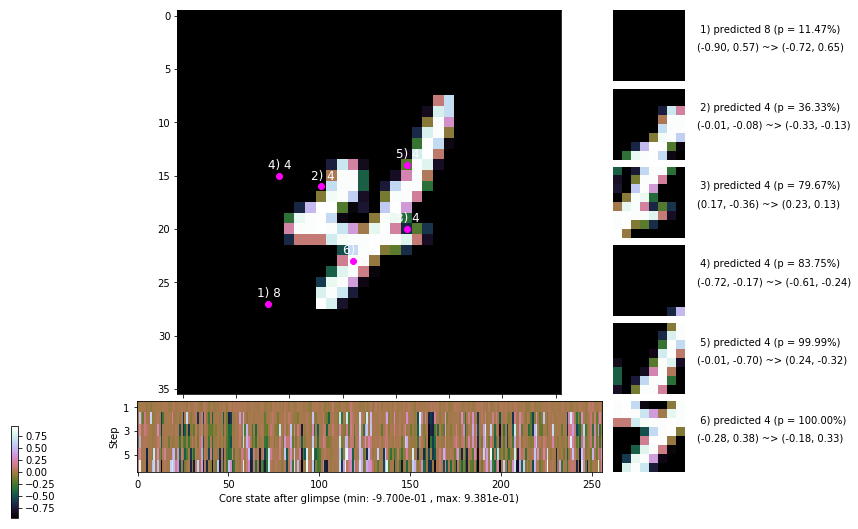

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.3 ms/b | lr: 7.79e-04 | grad 2norm: 12.25 | grad inf norm:  2.776
         Weights || abs max:  1.93 ( 8938.52) | mean: -7.38e-05 ( 0.03) | var: 4.62e-02 (23938.87)
          Biases || abs max:  0.99 (  374.84) | mean: -1.12e-01 ( 0.24) | var: 5.32e-02 ( 7847.51)
                    class loss: 0.314 | steps: 2.322 | reward:  3.594 | acc.: 89.93%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 135.5 ms/b | lr: 7.78e-04 | grad 2norm: 12.25 | grad inf norm:  2.830
         Weights || abs max:  1.93 ( 4917.90) | mean: -8.46e-05 ( 0.02) | var: 4.63e-02 ( 1524.25)
          Biases || abs max:  0.99 (   78.66) | mean: -1.13e-01 ( 0.08) | var: 5.34e-02 (   22.33)
                    class loss: 0.313 | steps: 2.287 | reward:  3.637 | acc.: 89.92%

	Target class: 1 | Discounted rewards: [0.946, -0.539, -0

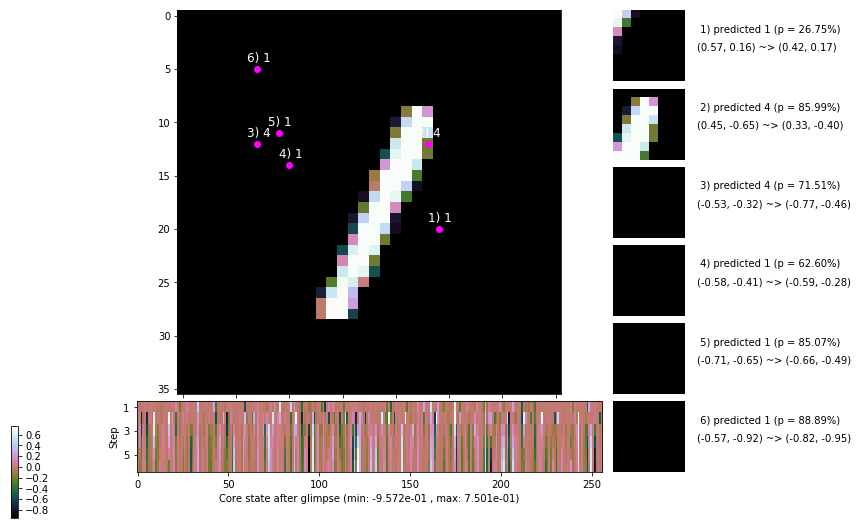

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 136.3 ms/b | lr: 7.76e-04 | grad 2norm: 11.80 | grad inf norm:  2.750
         Weights || abs max:  1.93 ( 2458.00) | mean: -8.75e-05 ( 0.01) | var: 4.65e-02 (  103.70)
          Biases || abs max:  1.00 (   82.26) | mean: -1.13e-01 ( 0.08) | var: 5.34e-02 (   39.74)
                    class loss: 0.282 | steps: 2.280 | reward:  3.665 | acc.: 90.58%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 136.5 ms/b | lr: 7.76e-04 | grad 2norm: 12.26 | grad inf norm:  2.711
         Weights || abs max:  1.95 ( 3120.52) | mean: -5.11e-05 ( 0.01) | var: 4.66e-02 (  623.48)
          Biases || abs max:  1.01 (  148.89) | mean: -1.13e-01 ( 0.12) | var: 5.35e-02 (  831.64)
                    class loss: 0.310 | steps: 2.289 | reward:  3.641 | acc.: 90.12%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

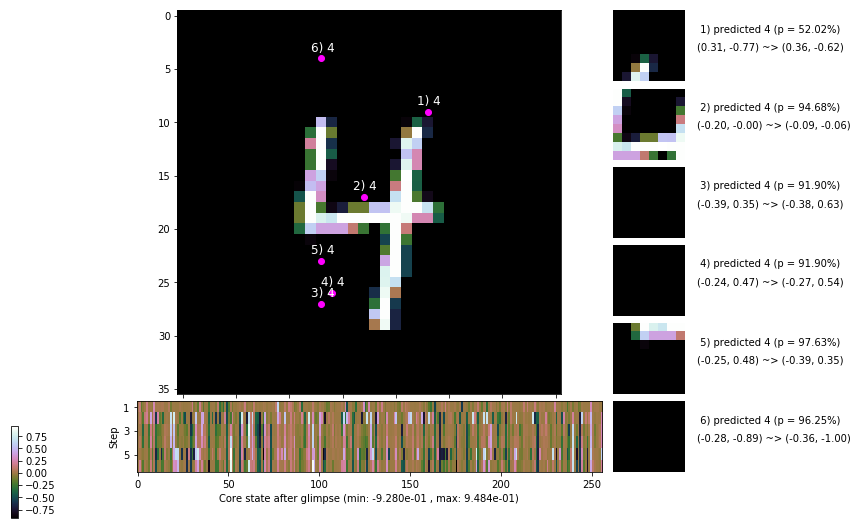

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


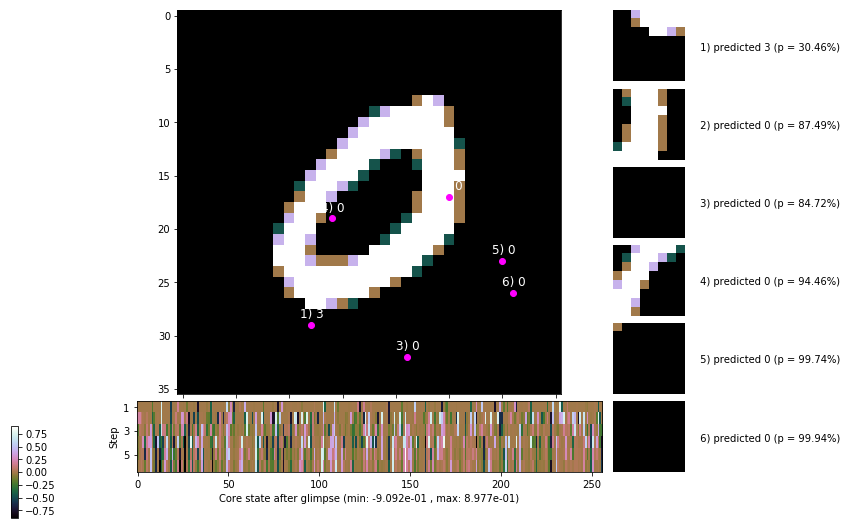


	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


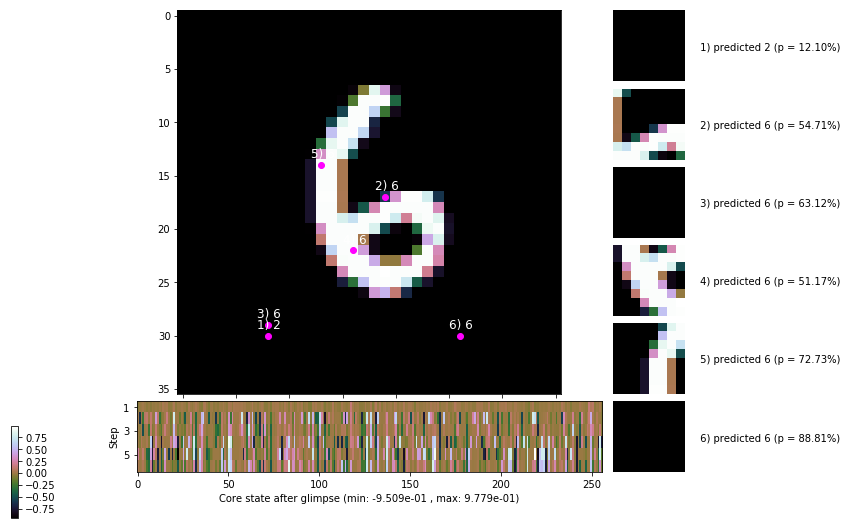

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


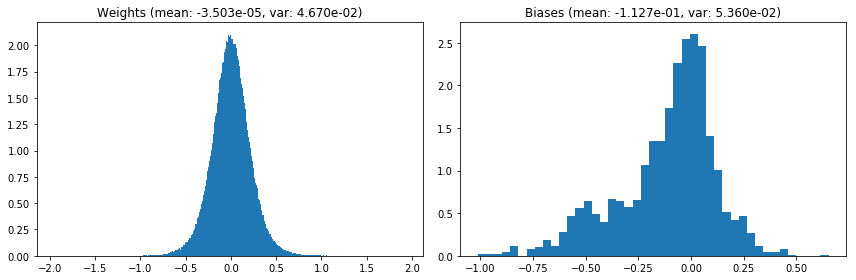

                                      Location network weights and biases


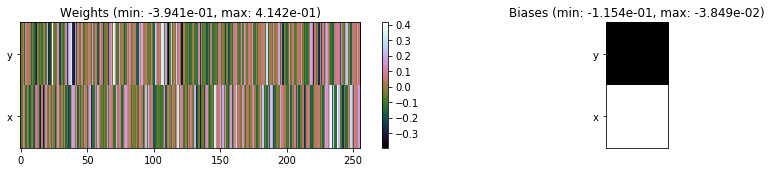

---------------------------------------------------------------------------------------------------------------
Elapsed time:  416.95 sec | TRAIN >> class loss: 0.3091 | steps:  2.300    | reward:  3.6136    | acc.: 89.962% 
                          | VAL   >> class loss: 0.2886 | steps:  2.176    | reward:  3.8496    | acc.: 90.740% 


Epoch  18/400) lr = 0.0007748
 b    300/  3000 >> 135.6 ms/b | lr: 7.74e-04 | grad 2norm: 12.16 | grad inf norm:  2.866
         Weights || abs max:  1.96 (14174.98) | mean: -4.00e-05 ( 0.04) | var: 4.68e-02 (55902.36)
          Biases || abs max:  1.02 (   86.64) | mean: -1.13e-01 ( 0.09) | var: 5.39e-02 (  150.09)
                    class loss: 0.310 | steps: 2.267 | reward:  3.647 | acc.: 89.98%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 134.7 ms/b | lr: 7.73e-04 | grad 2norm: 11.99 | grad inf norm:  2.906
         Weights || abs max:  1.97 ( 3075.22) | mean: -6.60e-05 ( 0.0

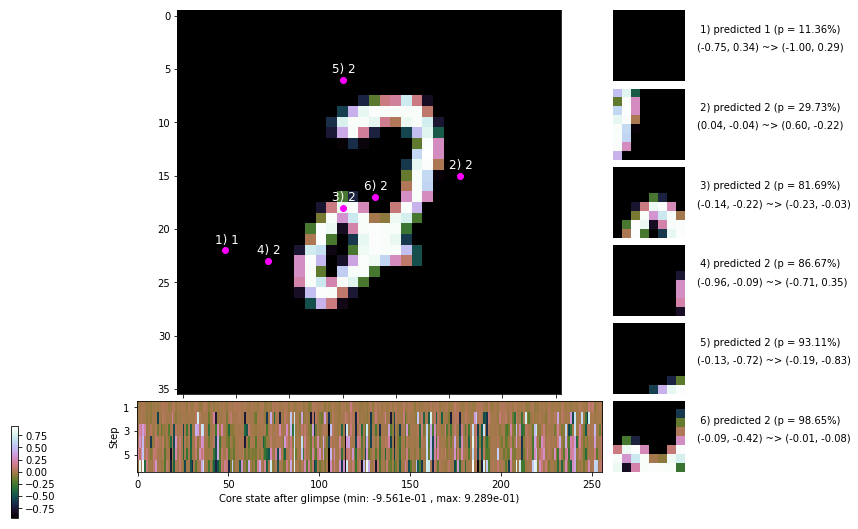

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 132.8 ms/b | lr: 7.72e-04 | grad 2norm: 12.10 | grad inf norm:  2.884
         Weights || abs max:  1.97 ( 2056.15) | mean: -1.02e-04 ( 0.01) | var: 4.71e-02 (   62.53)
          Biases || abs max:  1.04 (  147.63) | mean: -1.14e-01 ( 0.12) | var: 5.45e-02 (  663.99)
                    class loss: 0.303 | steps: 2.299 | reward:  3.607 | acc.: 89.92%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 134.9 ms/b | lr: 7.71e-04 | grad 2norm: 12.12 | grad inf norm:  2.887
         Weights || abs max:  1.97 ( 4825.22) | mean: -1.07e-04 ( 0.02) | var: 4.72e-02 ( 2321.58)
          Biases || abs max:  1.04 (  416.93) | mean: -1.15e-01 ( 0.28) | var: 5.48e-02 ( 5424.40)
                    class loss: 0.321 | steps: 2.298 | reward:  3.618 | acc.: 90.13%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

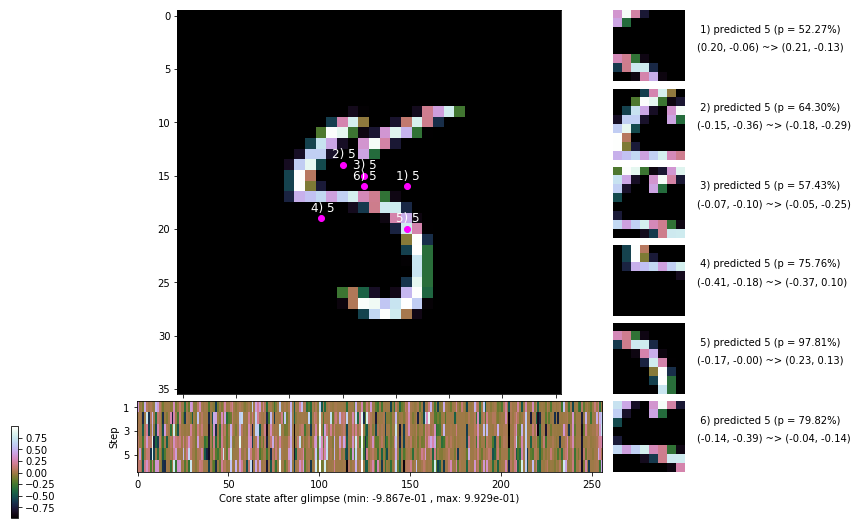

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 137.7 ms/b | lr: 7.69e-04 | grad 2norm: 11.89 | grad inf norm:  2.720
         Weights || abs max:  1.97 ( 3999.88) | mean: -1.14e-04 ( 0.02) | var: 4.73e-02 (  568.19)
          Biases || abs max:  1.04 (  908.32) | mean: -1.15e-01 ( 0.41) | var: 5.51e-02 (72869.19)
                    class loss: 0.296 | steps: 2.313 | reward:  3.595 | acc.: 90.30%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 136.8 ms/b | lr: 7.69e-04 | grad 2norm: 11.98 | grad inf norm:  2.767
         Weights || abs max:  1.99 ( 3759.56) | mean: -1.22e-04 ( 0.02) | var: 4.75e-02 (  300.00)
          Biases || abs max:  1.05 (   69.79) | mean: -1.15e-01 ( 0.08) | var: 5.52e-02 (   47.44)
                    class loss: 0.305 | steps: 2.318 | reward:  3.588 | acc.: 89.98%

	Target class: 7 | Discounted rewards: [-0.539, -0.389, 1

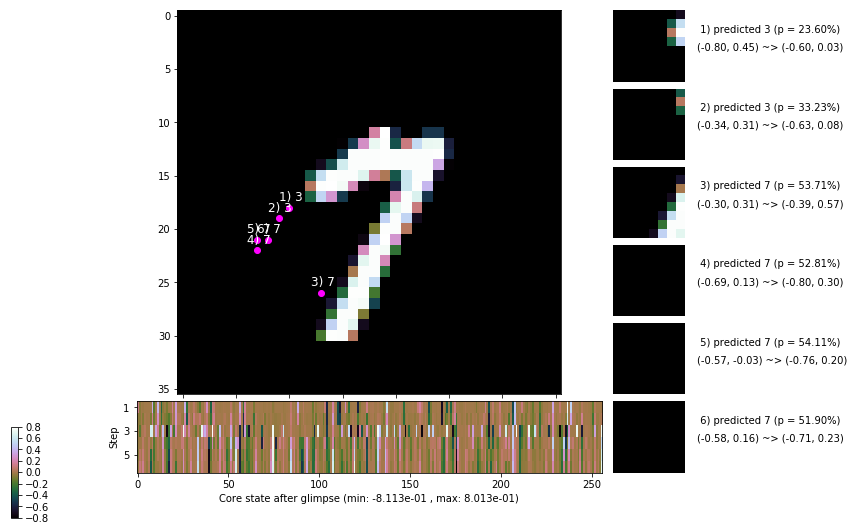

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 139.4 ms/b | lr: 7.67e-04 | grad 2norm: 11.89 | grad inf norm:  2.686
         Weights || abs max:  1.99 ( 3660.49) | mean: -1.00e-04 ( 0.02) | var: 4.76e-02 (  559.15)
          Biases || abs max:  1.05 (   72.22) | mean: -1.15e-01 ( 0.08) | var: 5.55e-02 (   46.21)
                    class loss: 0.317 | steps: 2.318 | reward:  3.575 | acc.: 89.80%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.1 ms/b | lr: 7.66e-04 | grad 2norm: 11.39 | grad inf norm:  2.750
         Weights || abs max:  2.00 ( 3057.98) | mean: -1.04e-04 ( 0.01) | var: 4.78e-02 (  142.16)
          Biases || abs max:  1.05 (   75.73) | mean: -1.16e-01 ( 0.08) | var: 5.56e-02 (   24.05)
                    class loss: 0.279 | steps: 2.273 | reward:  3.687 | acc.: 90.80%

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.1

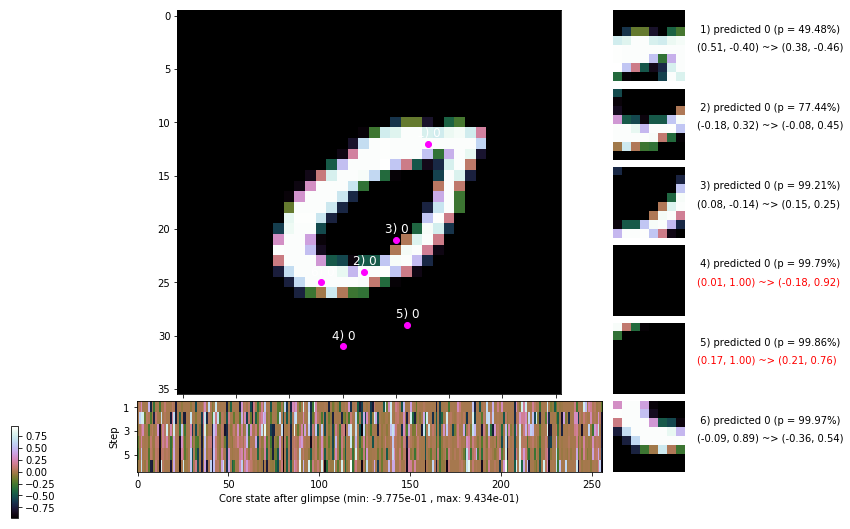

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.8 ms/b | lr: 7.65e-04 | grad 2norm: 11.94 | grad inf norm:  2.933
         Weights || abs max:  1.99 ( 5197.90) | mean: -1.23e-04 ( 0.02) | var: 4.79e-02 (  905.80)
          Biases || abs max:  1.05 (   49.66) | mean: -1.15e-01 ( 0.07) | var: 5.57e-02 (   15.41)
                    class loss: 0.307 | steps: 2.318 | reward:  3.594 | acc.: 90.18%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 135.9 ms/b | lr: 7.64e-04 | grad 2norm: 11.97 | grad inf norm:  2.856
         Weights || abs max:  1.98 ( 3361.18) | mean: -1.64e-04 ( 0.01) | var: 4.80e-02 (  239.88)
          Biases || abs max:  1.05 (  193.50) | mean: -1.16e-01 ( 0.13) | var: 5.59e-02 ( 1285.61)
                    class loss: 0.317 | steps: 2.291 | reward:  3.626 | acc.: 89.58%

	Target class: 3 | Discounted rewards: [-0.389, 1.111, 1.

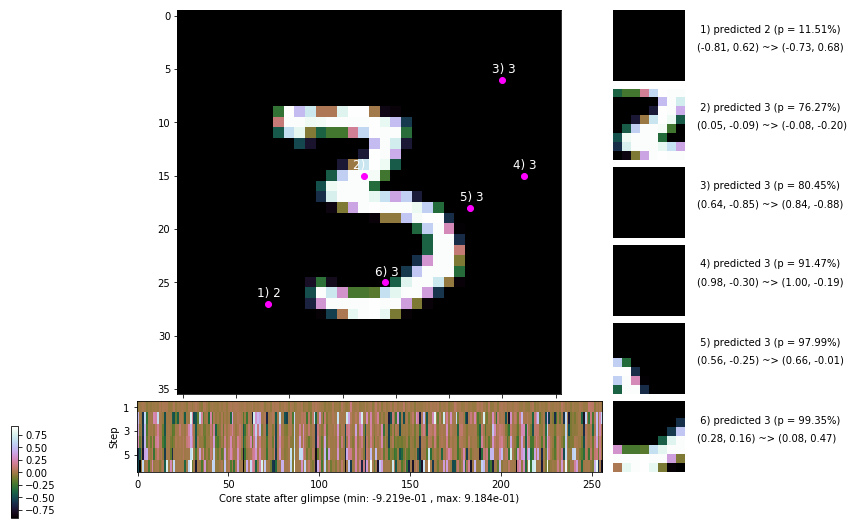

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


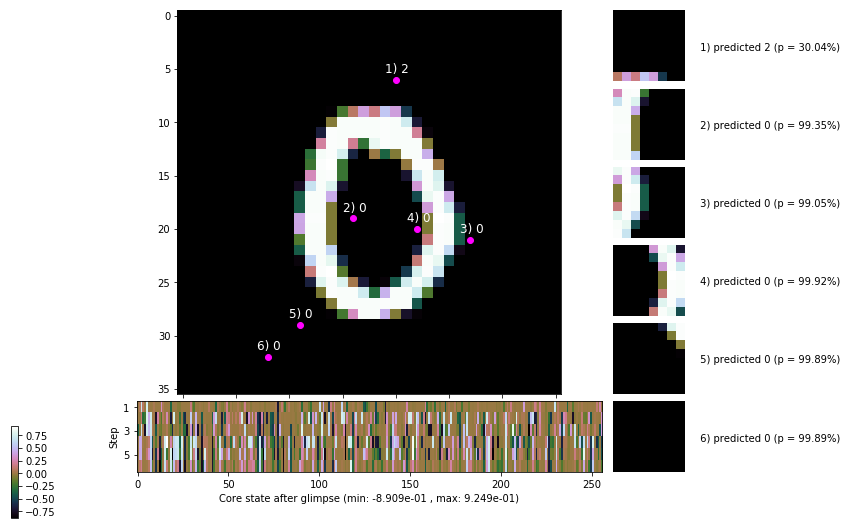


	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


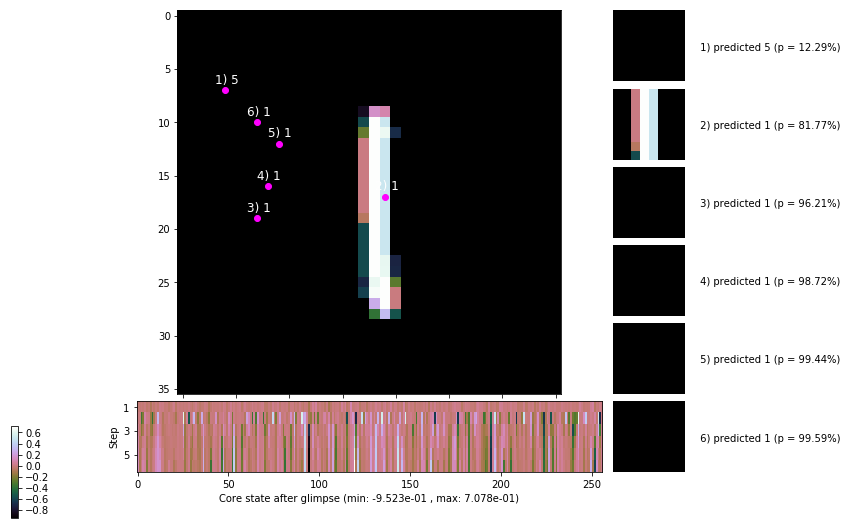

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


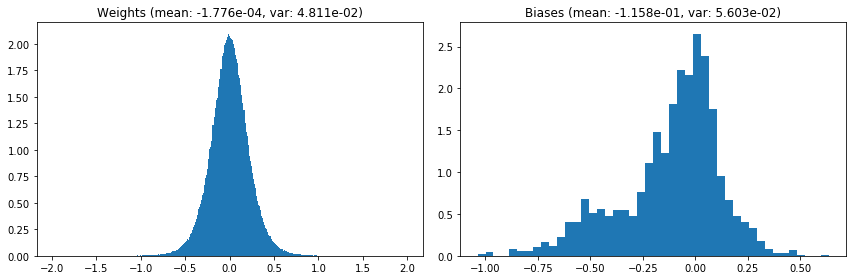

                                      Location network weights and biases


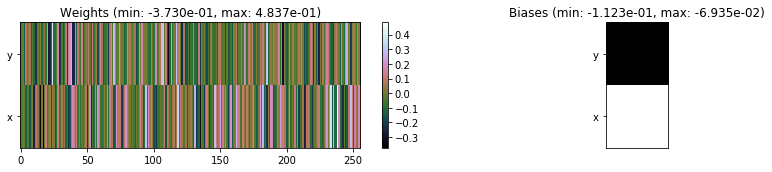

---------------------------------------------------------------------------------------------------------------
Elapsed time:  415.64 sec | TRAIN >> class loss: 0.3067 | steps:  2.296    | reward:  3.6165    | acc.: 90.050% 
                          | VAL   >> class loss: 0.2561 | steps:  2.163    | reward:  3.8607    | acc.: 91.500% 


Epoch  19/400) lr = 0.0007633
 b    300/  3000 >> 136.4 ms/b | lr: 7.63e-04 | grad 2norm: 12.08 | grad inf norm:  2.862
         Weights || abs max:  1.99 ( 2479.29) | mean: -1.81e-04 ( 0.01) | var: 4.82e-02 (  190.60)
          Biases || abs max:  1.03 (   50.54) | mean: -1.16e-01 ( 0.07) | var: 5.61e-02 (   18.59)
                    class loss: 0.298 | steps: 2.304 | reward:  3.610 | acc.: 90.17%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 134.7 ms/b | lr: 7.62e-04 | grad 2norm: 11.88 | grad inf norm:  2.764
         Weights || abs max:  2.00 ( 3810.26) | mean: -2.14e-04 ( 0.0

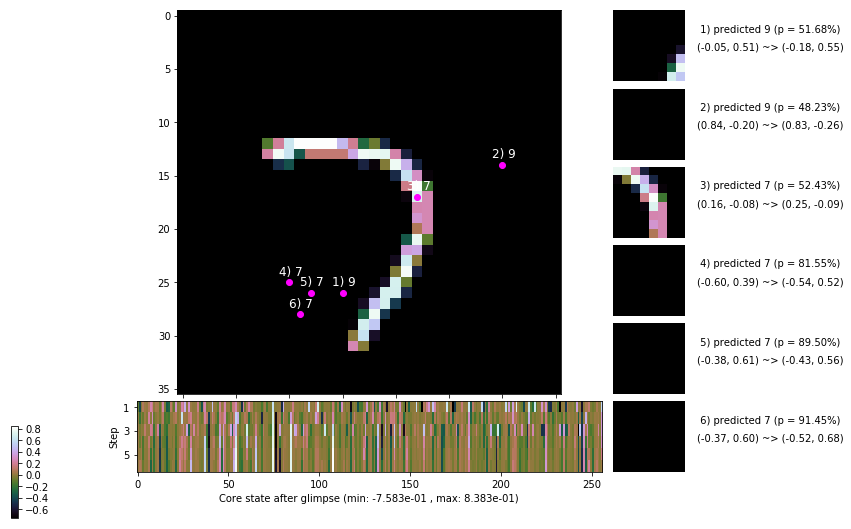

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 136.5 ms/b | lr: 7.60e-04 | grad 2norm: 12.03 | grad inf norm:  2.788
         Weights || abs max:  2.00 ( 6035.12) | mean: -2.04e-04 ( 0.02) | var: 4.85e-02 ( 7421.32)
          Biases || abs max:  1.01 (  137.53) | mean: -1.16e-01 ( 0.10) | var: 5.63e-02 (  303.23)
                    class loss: 0.300 | steps: 2.300 | reward:  3.618 | acc.: 90.17%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 134.4 ms/b | lr: 7.59e-04 | grad 2norm: 12.16 | grad inf norm:  2.901
         Weights || abs max:  2.00 ( 4534.10) | mean: -1.82e-04 ( 0.02) | var: 4.86e-02 (  748.86)
          Biases || abs max:  1.01 (   91.60) | mean: -1.16e-01 ( 0.08) | var: 5.66e-02 (   40.17)
                    class loss: 0.306 | steps: 2.318 | reward:  3.603 | acc.: 90.15%

	Target class: 2 | Discounted rewards: [-0.556, -0.556, -

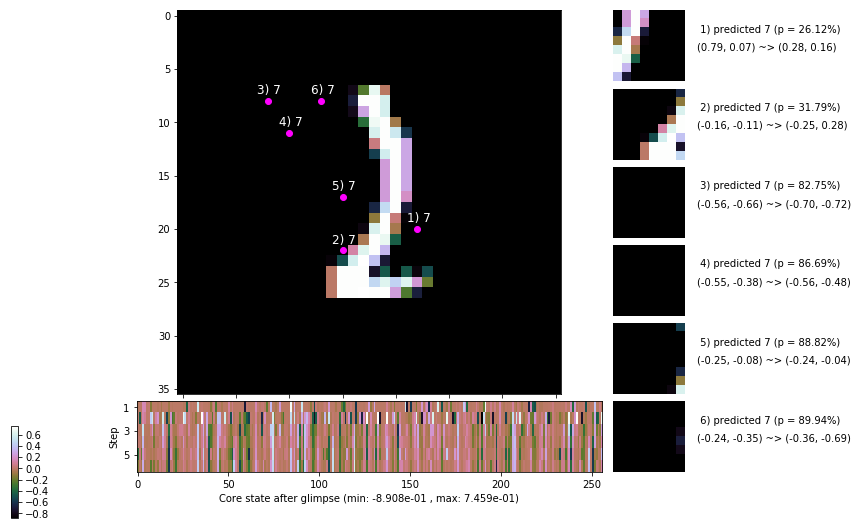

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 136.6 ms/b | lr: 7.58e-04 | grad 2norm: 11.94 | grad inf norm:  2.850
         Weights || abs max:  2.01 ( 1466.36) | mean: -1.56e-04 ( 0.01) | var: 4.87e-02 (   16.85)
          Biases || abs max:  1.03 (   62.67) | mean: -1.17e-01 ( 0.08) | var: 5.67e-02 (   11.94)
                    class loss: 0.288 | steps: 2.299 | reward:  3.646 | acc.: 90.60%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 135.1 ms/b | lr: 7.57e-04 | grad 2norm: 12.07 | grad inf norm:  2.831
         Weights || abs max:  2.02 ( 4106.88) | mean: -1.82e-04 ( 0.02) | var: 4.89e-02 (  536.89)
          Biases || abs max:  1.02 (  144.69) | mean: -1.17e-01 ( 0.12) | var: 5.69e-02 (  465.18)
                    class loss: 0.308 | steps: 2.272 | reward:  3.615 | acc.: 90.07%

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.1

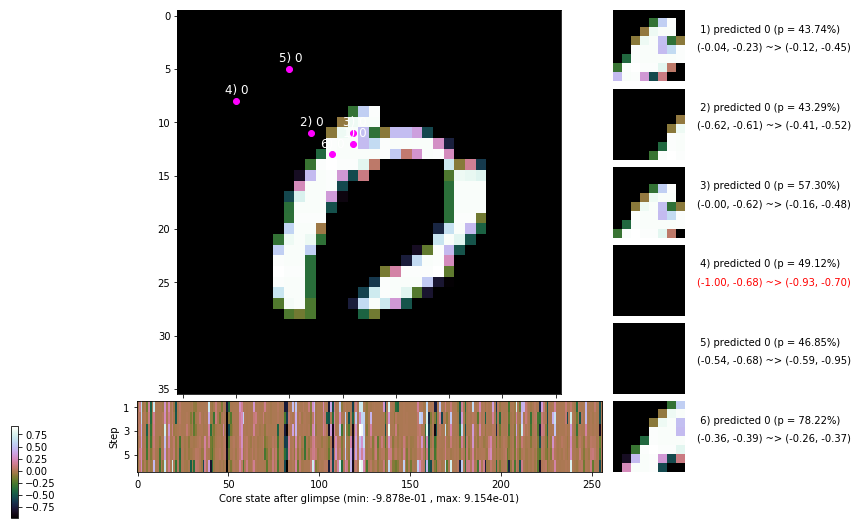

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 135.5 ms/b | lr: 7.56e-04 | grad 2norm: 11.80 | grad inf norm:  2.838
         Weights || abs max:  2.02 ( 9641.57) | mean: -1.61e-04 ( 0.03) | var: 4.90e-02 (12011.27)
          Biases || abs max:  1.04 (   56.58) | mean: -1.17e-01 ( 0.07) | var: 5.73e-02 (   10.80)
                    class loss: 0.317 | steps: 2.286 | reward:  3.631 | acc.: 90.13%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 134.3 ms/b | lr: 7.55e-04 | grad 2norm: 12.03 | grad inf norm:  2.886
         Weights || abs max:  2.02 ( 6462.10) | mean: -1.62e-04 ( 0.02) | var: 4.91e-02 ( 3804.54)
          Biases || abs max:  1.05 (   76.71) | mean: -1.18e-01 ( 0.07) | var: 5.76e-02 (   38.23)
                    class loss: 0.302 | steps: 2.280 | reward:  3.619 | acc.: 90.18%

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.1

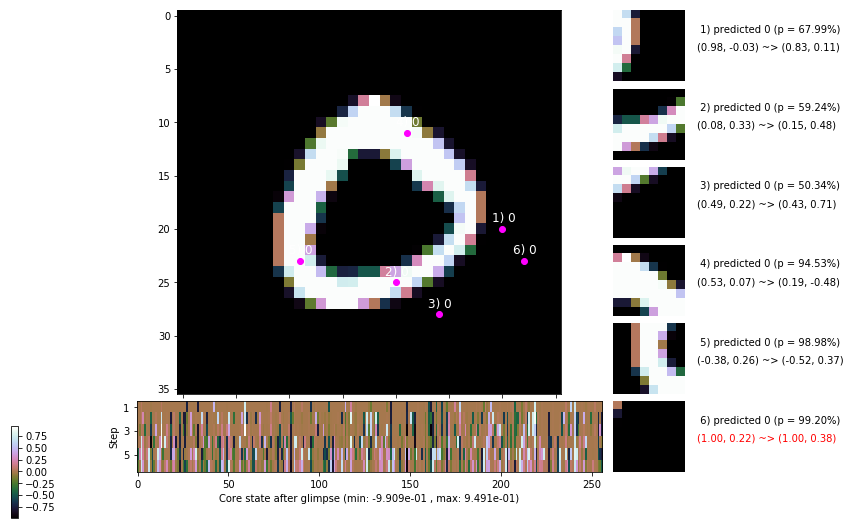

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 135.5 ms/b | lr: 7.53e-04 | grad 2norm: 11.80 | grad inf norm:  2.899
         Weights || abs max:  2.03 ( 3261.41) | mean: -1.80e-04 ( 0.01) | var: 4.93e-02 (  220.12)
          Biases || abs max:  1.05 (  225.02) | mean: -1.18e-01 ( 0.14) | var: 5.77e-02 ( 2398.02)
                    class loss: 0.288 | steps: 2.263 | reward:  3.696 | acc.: 91.02%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 134.3 ms/b | lr: 7.53e-04 | grad 2norm: 11.73 | grad inf norm:  2.818
         Weights || abs max:  2.03 ( 9698.14) | mean: -1.24e-04 ( 0.03) | var: 4.94e-02 (22780.21)
          Biases || abs max:  1.05 (   99.45) | mean: -1.18e-01 ( 0.09) | var: 5.80e-02 (   68.03)
                    class loss: 0.292 | steps: 2.270 | reward:  3.671 | acc.: 90.73%

	Target class: 1 | Discounted rewards: [-0.554, -0.539, -

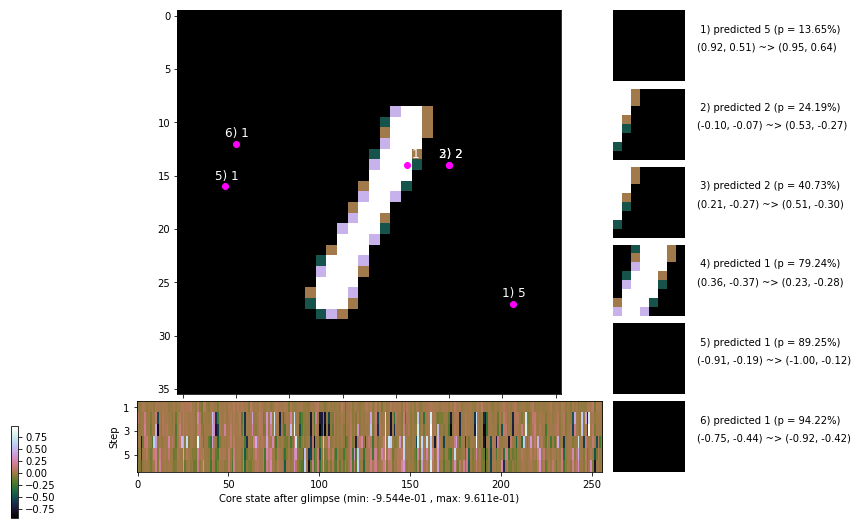

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


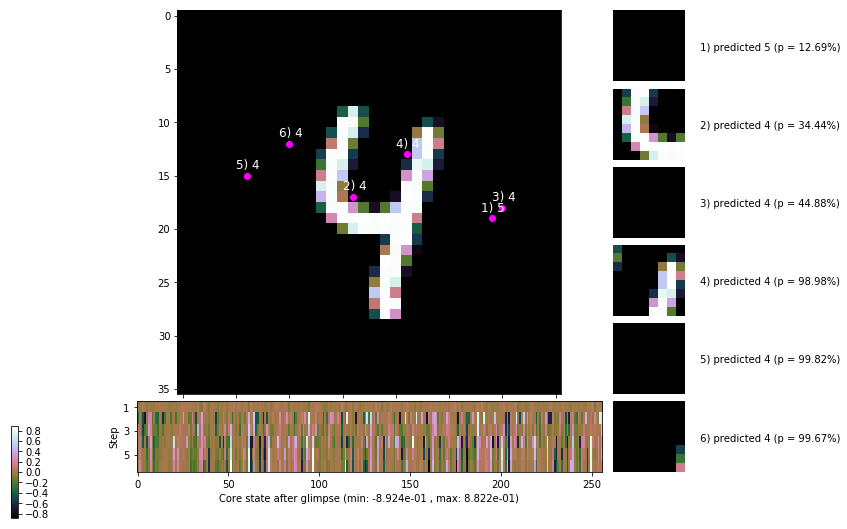


	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


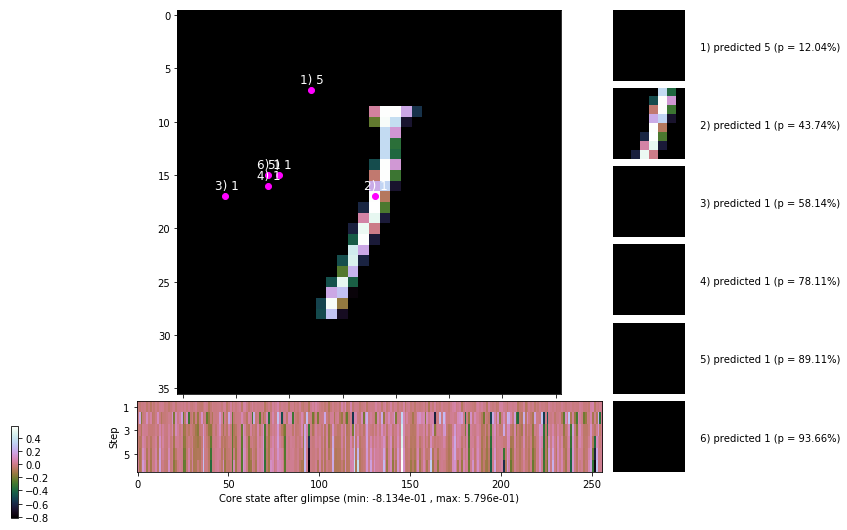

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


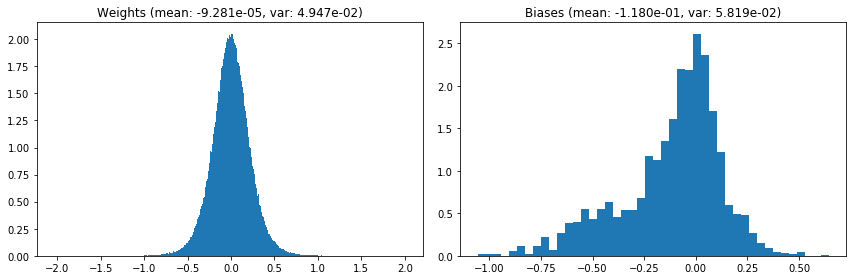

                                      Location network weights and biases


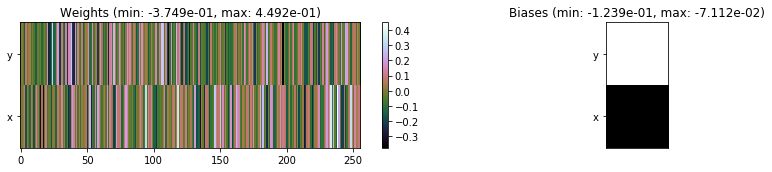

---------------------------------------------------------------------------------------------------------------
Elapsed time:  406.56 sec | TRAIN >> class loss: 0.2980 | steps:  2.291    | reward:  3.6341    | acc.: 90.408% 
                          | VAL   >> class loss: 0.2651 | steps:  2.171 :( | reward:  3.8685    | acc.: 91.560% 


Epoch  20/400) lr = 0.0007519
 b    300/  3000 >> 136.0 ms/b | lr: 7.51e-04 | grad 2norm: 12.06 | grad inf norm:  2.876
         Weights || abs max:  2.04 ( 6460.42) | mean: -1.29e-04 ( 0.02) | var: 4.95e-02 ( 4553.47)
          Biases || abs max:  1.06 (  136.71) | mean: -1.18e-01 ( 0.11) | var: 5.84e-02 (  277.93)
                    class loss: 0.300 | steps: 2.307 | reward:  3.611 | acc.: 90.42%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 136.0 ms/b | lr: 7.50e-04 | grad 2norm: 12.09 | grad inf norm:  2.910
         Weights || abs max:  2.05 ( 2260.08) | mean: -1.29e-04 ( 0.0

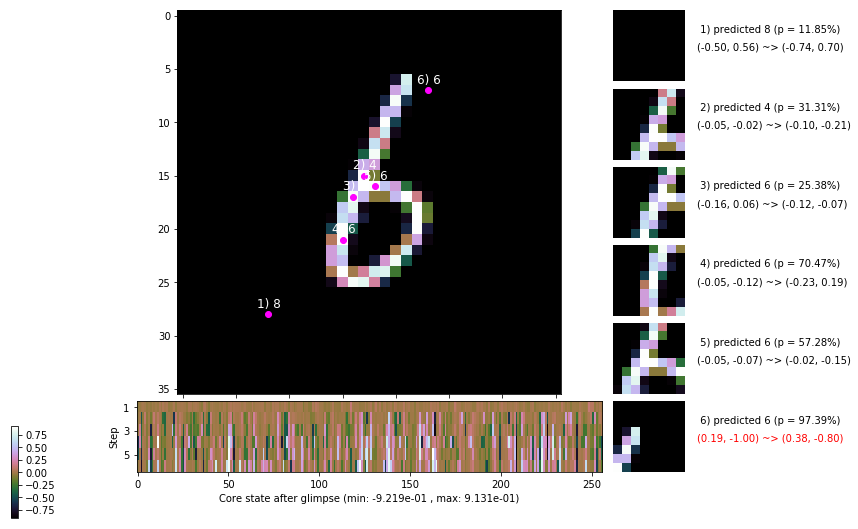

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 173.2 ms/b | lr: 7.49e-04 | grad 2norm: 11.75 | grad inf norm:  2.784
         Weights || abs max:  2.05 ( 2831.81) | mean: -1.47e-04 ( 0.01) | var: 4.98e-02 (  210.90)
          Biases || abs max:  1.07 (  236.24) | mean: -1.18e-01 ( 0.15) | var: 5.89e-02 (  988.61)
                    class loss: 0.297 | steps: 2.301 | reward:  3.623 | acc.: 90.03%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 135.3 ms/b | lr: 7.48e-04 | grad 2norm: 11.61 | grad inf norm:  2.891
         Weights || abs max:  2.05 ( 8734.63) | mean: -1.52e-04 ( 0.02) | var: 5.00e-02 (26518.22)
          Biases || abs max:  1.06 (   51.71) | mean: -1.18e-01 ( 0.07) | var: 5.89e-02 (    5.98)
                    class loss: 0.286 | steps: 2.291 | reward:  3.666 | acc.: 90.80%

	Target class: 9 | Discounted rewards: [1.111, 1.111, 1.1

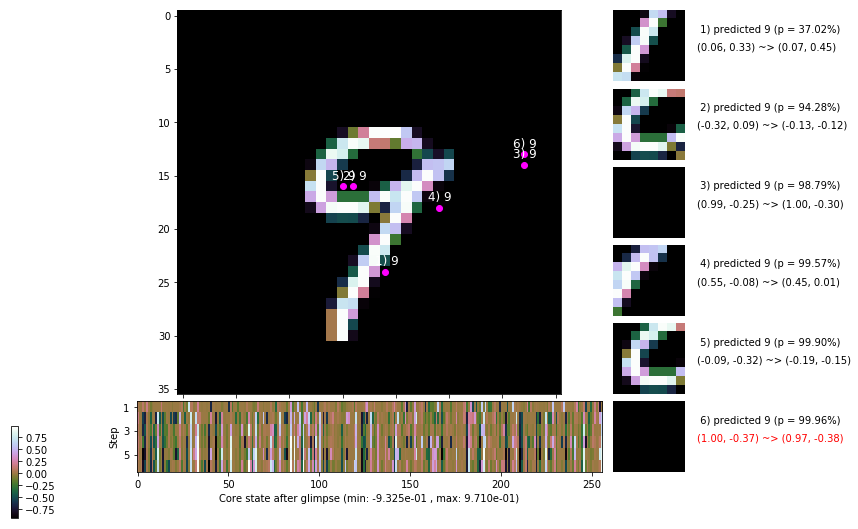

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 137.5 ms/b | lr: 7.47e-04 | grad 2norm: 11.95 | grad inf norm:  2.894
         Weights || abs max:  2.05 (10043.95) | mean: -1.82e-04 ( 0.03) | var: 5.01e-02 (15950.79)
          Biases || abs max:  1.05 (   71.21) | mean: -1.18e-01 ( 0.08) | var: 5.92e-02 (   31.57)
                    class loss: 0.307 | steps: 2.255 | reward:  3.684 | acc.: 90.22%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 137.0 ms/b | lr: 7.46e-04 | grad 2norm: 11.83 | grad inf norm:  2.806
         Weights || abs max:  2.06 ( 2079.19) | mean: -1.95e-04 ( 0.01) | var: 5.02e-02 (   73.87)
          Biases || abs max:  1.06 (   32.32) | mean: -1.18e-01 ( 0.06) | var: 5.93e-02 (    2.54)
                    class loss: 0.302 | steps: 2.297 | reward:  3.624 | acc.: 90.47%

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1.

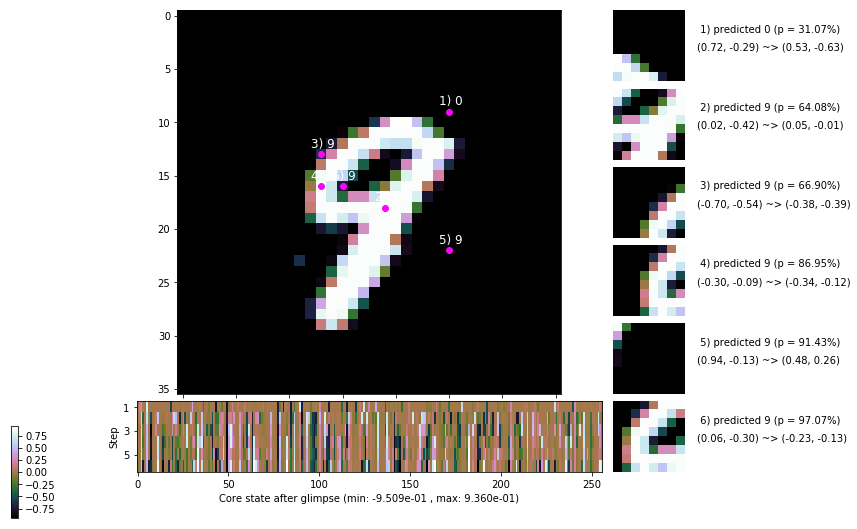

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 138.5 ms/b | lr: 7.44e-04 | grad 2norm: 11.84 | grad inf norm:  2.771
         Weights || abs max:  2.07 ( 3789.96) | mean: -1.87e-04 ( 0.02) | var: 5.04e-02 (  390.95)
          Biases || abs max:  1.06 (  105.41) | mean: -1.19e-01 ( 0.10) | var: 5.95e-02 (   85.00)
                    class loss: 0.307 | steps: 2.300 | reward:  3.632 | acc.: 90.15%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 137.9 ms/b | lr: 7.44e-04 | grad 2norm: 11.63 | grad inf norm:  2.832
         Weights || abs max:  2.09 ( 2652.35) | mean: -1.80e-04 ( 0.01) | var: 5.05e-02 (  171.99)
          Biases || abs max:  1.07 (   79.59) | mean: -1.18e-01 ( 0.08) | var: 5.97e-02 (   38.45)
                    class loss: 0.280 | steps: 2.233 | reward:  3.761 | acc.: 90.88%

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1.

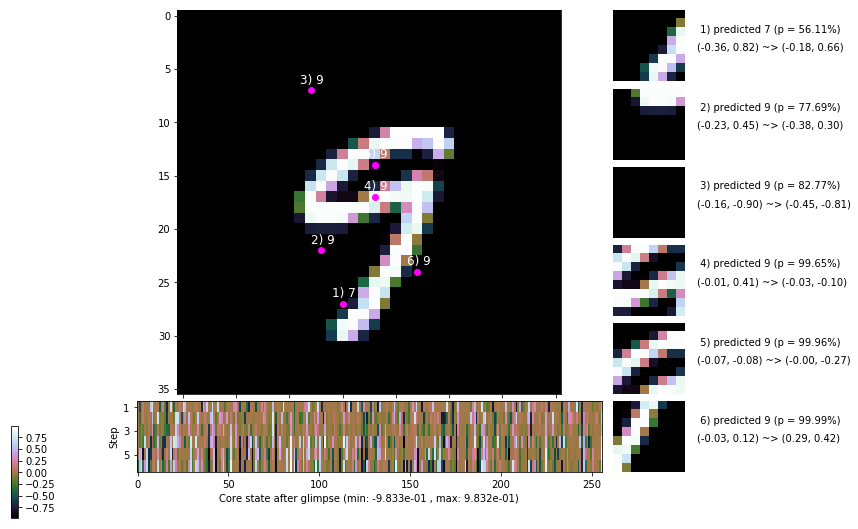

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 137.6 ms/b | lr: 7.42e-04 | grad 2norm: 11.85 | grad inf norm:  2.942
         Weights || abs max:  2.09 ( 3451.63) | mean: -1.34e-04 ( 0.01) | var: 5.07e-02 (  980.53)
          Biases || abs max:  1.08 (   96.21) | mean: -1.19e-01 ( 0.08) | var: 5.99e-02 (  101.90)
                    class loss: 0.290 | steps: 2.255 | reward:  3.699 | acc.: 90.67%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 136.2 ms/b | lr: 7.41e-04 | grad 2norm: 11.89 | grad inf norm:  2.862
         Weights || abs max:  2.11 ( 8809.61) | mean: -1.38e-04 ( 0.02) | var: 5.08e-02 (20547.32)
          Biases || abs max:  1.08 (   74.25) | mean: -1.20e-01 ( 0.07) | var: 6.02e-02 (   73.24)
                    class loss: 0.300 | steps: 2.285 | reward:  3.643 | acc.: 90.35%

	Target class: 0 | Discounted rewards: [-0.539, -0.389, 1

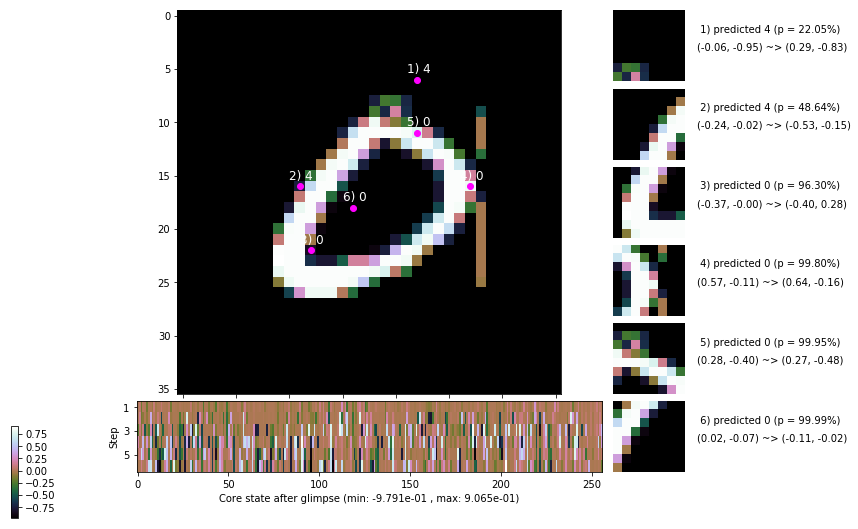

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [-0.554, -0.539, -0.389, 1.110, 1.100, 1.000]


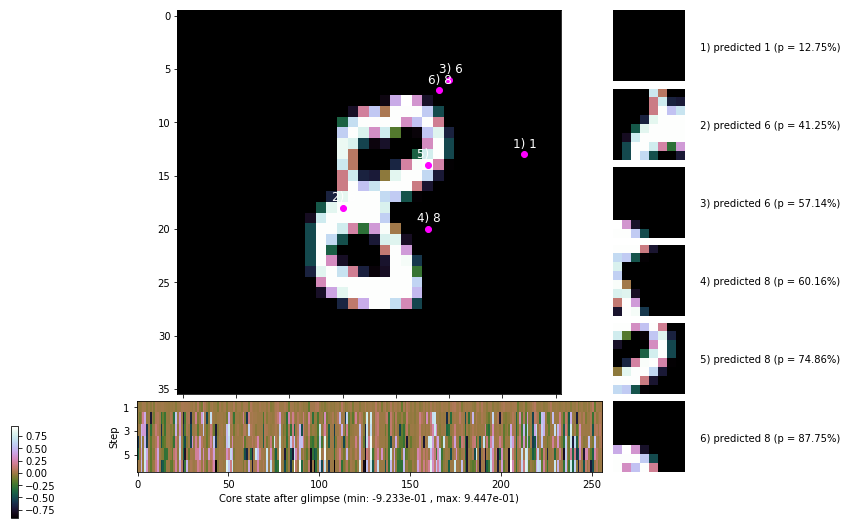


	Target class: 6 | Discounted rewards: [-0.539, -0.389, 1.111, 1.110, 1.100, 1.000]


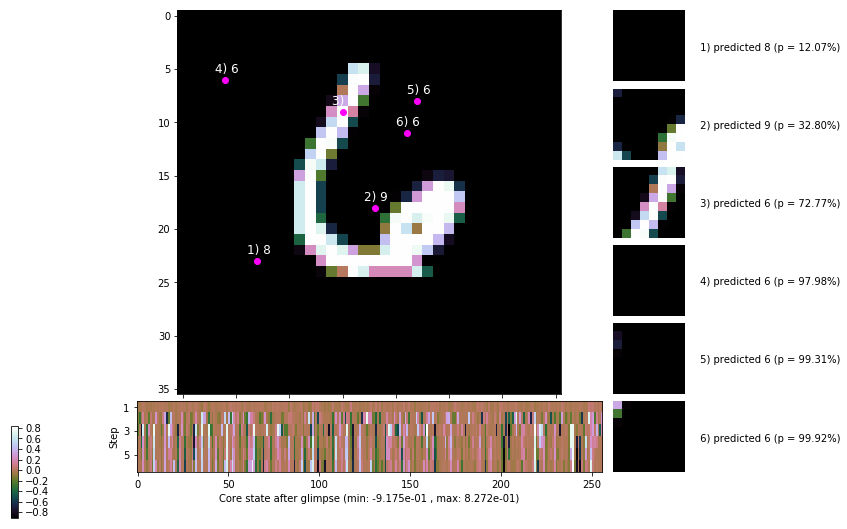

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


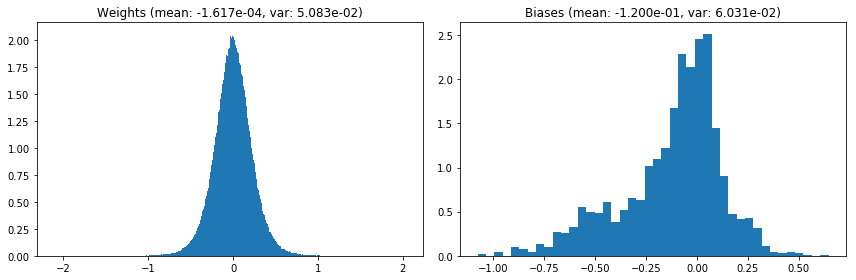

                                      Location network weights and biases


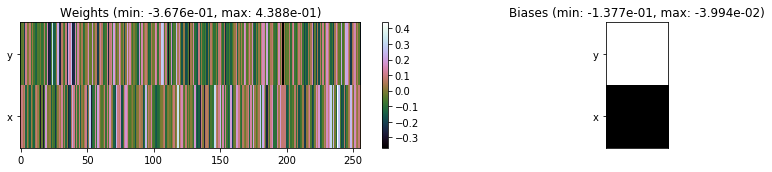

---------------------------------------------------------------------------------------------------------------
Elapsed time:  422.20 sec | TRAIN >> class loss: 0.2973 | steps:  2.283    | reward:  3.6543    | acc.: 90.383% :(
                          | VAL   >> class loss: 0.2578 | steps:  2.140    | reward:  3.9024    | acc.: 91.500% :(


Epoch  21/400) lr = 0.0007407
 b    300/  3000 >> 137.5 ms/b | lr: 7.40e-04 | grad 2norm: 11.91 | grad inf norm:  2.797
         Weights || abs max:  2.10 ( 3969.54) | mean: -1.77e-04 ( 0.02) | var: 5.09e-02 (  702.73)
          Biases || abs max:  1.08 (  121.62) | mean: -1.20e-01 ( 0.09) | var: 6.03e-02 (  324.89)
                    class loss: 0.296 | steps: 2.291 | reward:  3.650 | acc.: 90.48%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 136.5 ms/b | lr: 7.39e-04 | grad 2norm: 11.82 | grad inf norm:  2.875
         Weights || abs max:  2.11 ( 3046.49) | mean: -1.80e-04 (

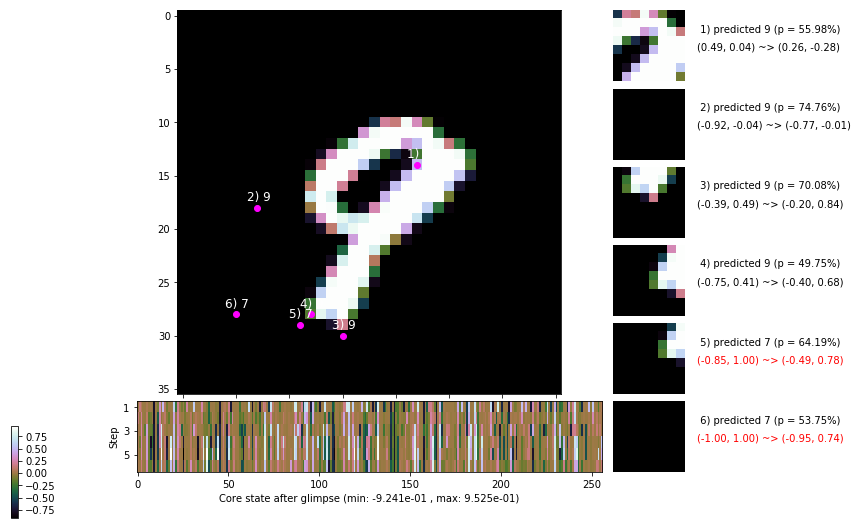

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 138.7 ms/b | lr: 7.38e-04 | grad 2norm: 11.84 | grad inf norm:  2.782
         Weights || abs max:  2.11 ( 5439.09) | mean: -1.75e-04 ( 0.02) | var: 5.12e-02 ( 3485.14)
          Biases || abs max:  1.10 (   44.95) | mean: -1.21e-01 ( 0.06) | var: 6.09e-02 (    9.31)
                    class loss: 0.303 | steps: 2.271 | reward:  3.644 | acc.: 89.62%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 136.7 ms/b | lr: 7.37e-04 | grad 2norm: 11.75 | grad inf norm:  2.876
         Weights || abs max:  2.12 ( 3633.10) | mean: -1.56e-04 ( 0.02) | var: 5.13e-02 (  273.87)
          Biases || abs max:  1.10 (  113.00) | mean: -1.21e-01 ( 0.09) | var: 6.10e-02 (  104.96)
                    class loss: 0.311 | steps: 2.296 | reward:  3.617 | acc.: 90.10%

	Target class: 1 | Discounted rewards: [-0.554, -0.539, -

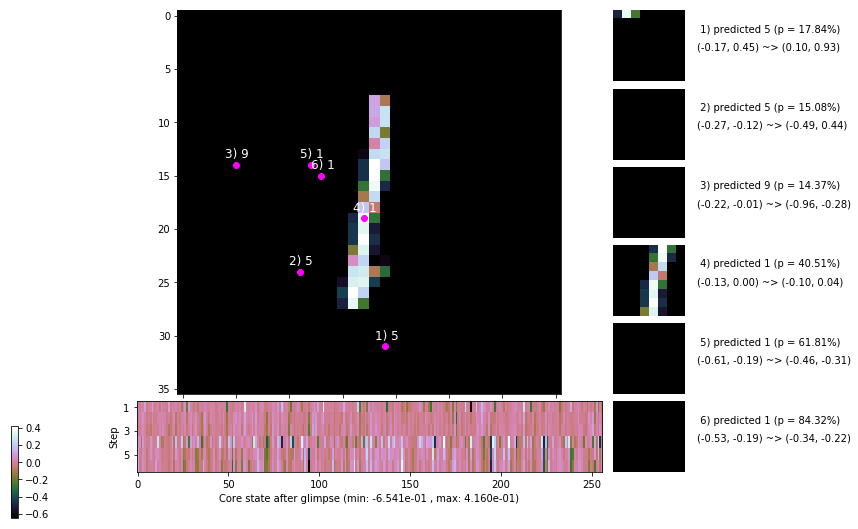

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 138.4 ms/b | lr: 7.36e-04 | grad 2norm: 11.81 | grad inf norm:  2.824
         Weights || abs max:  2.12 ( 2996.83) | mean: -1.72e-04 ( 0.02) | var: 5.14e-02 (  156.21)
          Biases || abs max:  1.10 (  150.93) | mean: -1.21e-01 ( 0.11) | var: 6.08e-02 (  379.92)
                    class loss: 0.278 | steps: 2.255 | reward:  3.704 | acc.: 90.55%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 131.7 ms/b | lr: 7.35e-04 | grad 2norm: 11.91 | grad inf norm:  2.923
         Weights || abs max:  2.12 ( 3945.89) | mean: -1.44e-04 ( 0.02) | var: 5.15e-02 (  618.08)
          Biases || abs max:  1.11 (   60.20) | mean: -1.21e-01 ( 0.07) | var: 6.09e-02 (   14.52)
                    class loss: 0.307 | steps: 2.287 | reward:  3.654 | acc.: 89.95%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

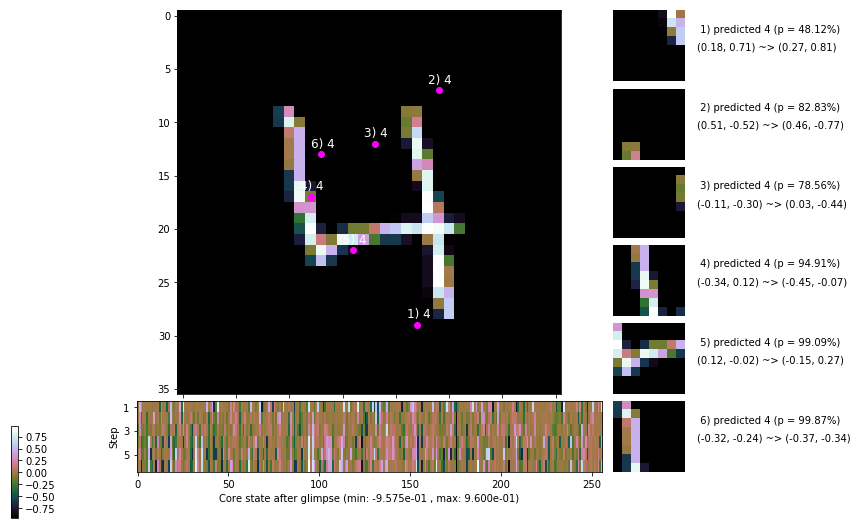

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 157.9 ms/b | lr: 7.33e-04 | grad 2norm: 11.49 | grad inf norm:  2.715
         Weights || abs max:  2.11 ( 5456.04) | mean: -1.06e-04 ( 0.02) | var: 5.17e-02 ( 2500.20)
          Biases || abs max:  1.11 (   47.22) | mean: -1.21e-01 ( 0.06) | var: 6.12e-02 (    8.66)
                    class loss: 0.279 | steps: 2.254 | reward:  3.723 | acc.: 91.12%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 138.8 ms/b | lr: 7.33e-04 | grad 2norm: 11.95 | grad inf norm:  2.955
         Weights || abs max:  2.12 ( 6457.55) | mean: -7.55e-05 ( 0.02) | var: 5.18e-02 ( 3748.38)
          Biases || abs max:  1.13 (  118.56) | mean: -1.21e-01 ( 0.09) | var: 6.14e-02 (  386.32)
                    class loss: 0.319 | steps: 2.292 | reward:  3.627 | acc.: 89.77%

	Target class: 2 | Discounted rewards: [-0.389, 1.111, 1.

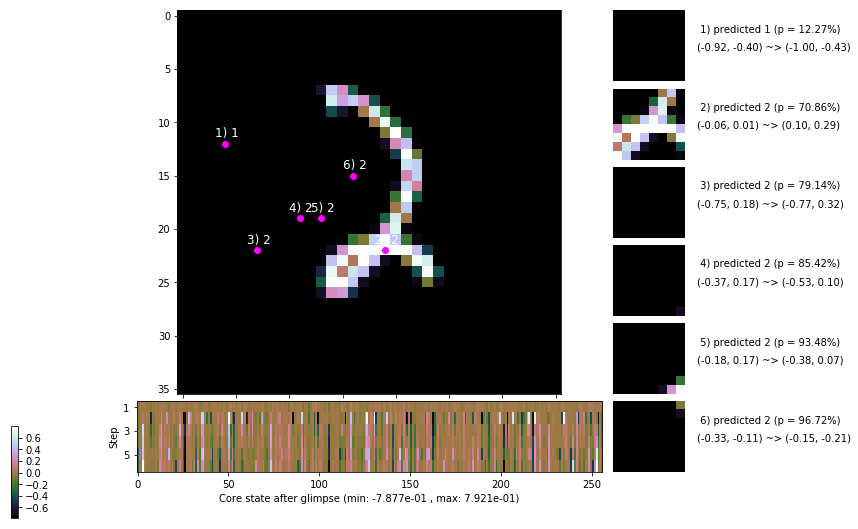

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 137.0 ms/b | lr: 7.31e-04 | grad 2norm: 11.50 | grad inf norm:  2.802
         Weights || abs max:  2.12 ( 8554.11) | mean: -1.12e-04 ( 0.03) | var: 5.19e-02 (13734.61)
          Biases || abs max:  1.13 (   92.14) | mean: -1.22e-01 ( 0.08) | var: 6.18e-02 (   68.91)
                    class loss: 0.301 | steps: 2.287 | reward:  3.657 | acc.: 90.38%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 136.7 ms/b | lr: 7.30e-04 | grad 2norm: 11.59 | grad inf norm:  2.798
         Weights || abs max:  2.12 ( 4954.17) | mean: -1.30e-04 ( 0.02) | var: 5.21e-02 ( 1283.81)
          Biases || abs max:  1.13 (   92.36) | mean: -1.22e-01 ( 0.09) | var: 6.18e-02 (  114.04)
                    class loss: 0.301 | steps: 2.262 | reward:  3.684 | acc.: 90.18%

	Target class: 4 | Discounted rewards: [-0.389, 1.111, 1.

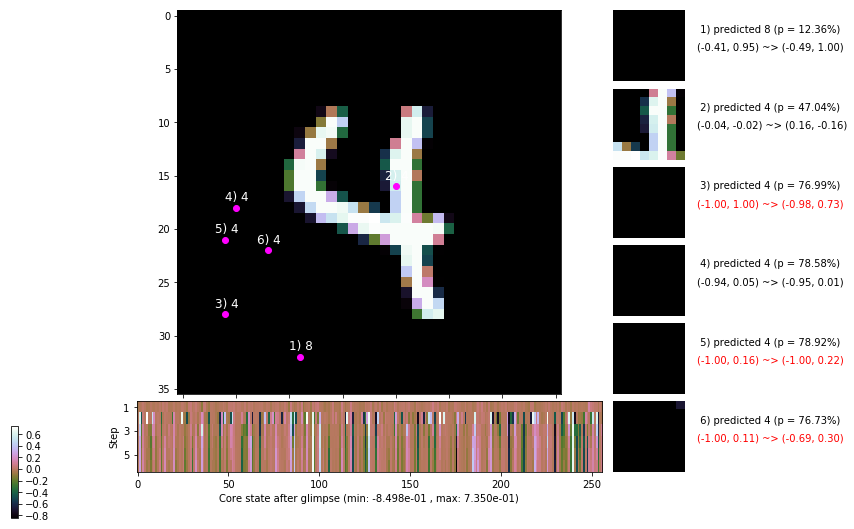

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


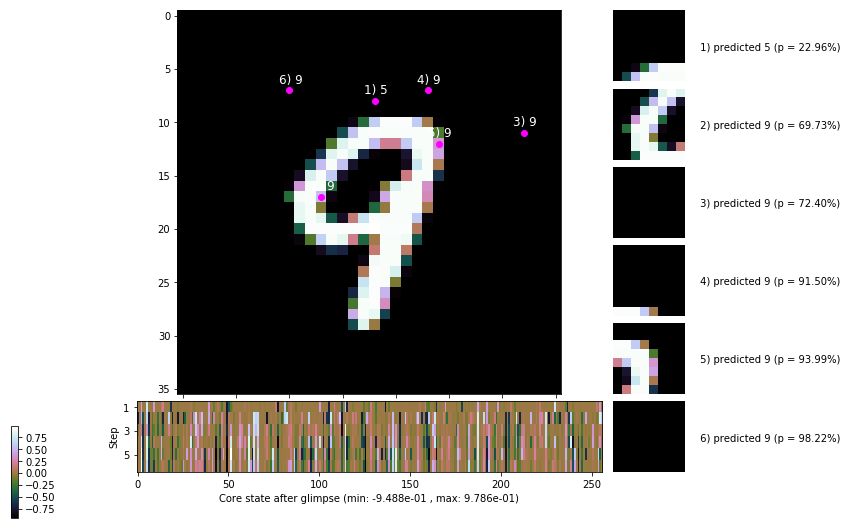


	Target class: 3 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


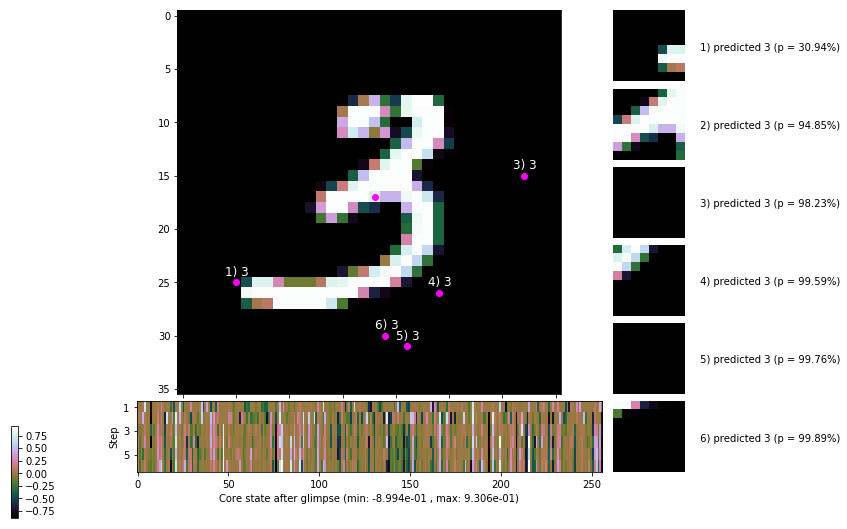

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


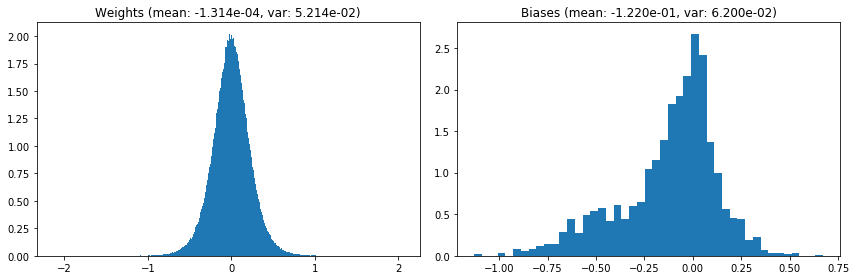

                                      Location network weights and biases


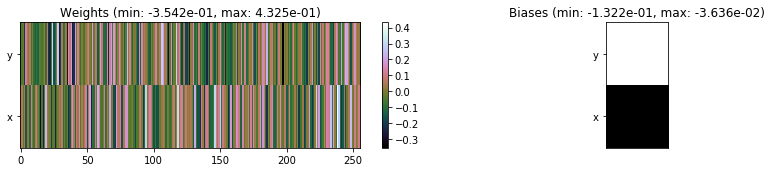

---------------------------------------------------------------------------------------------------------------
Elapsed time:  417.51 sec | TRAIN >> class loss: 0.2999 | steps:  2.277    | reward:  3.6630    | acc.: 90.238% :(
                          | VAL   >> class loss: 0.2904 | steps:  2.165 :( | reward:  3.8517 :( | acc.: 90.680% :(


Epoch  22/400) lr = 0.0007297
 b    300/  3000 >> 136.5 ms/b | lr: 7.29e-04 | grad 2norm: 11.32 | grad inf norm:  2.753
         Weights || abs max:  2.13 ( 2233.26) | mean: -9.31e-05 ( 0.01) | var: 5.22e-02 (  165.69)
          Biases || abs max:  1.13 (  107.82) | mean: -1.23e-01 ( 0.10) | var: 6.23e-02 (   40.47)
                    class loss: 0.306 | steps: 2.278 | reward:  3.646 | acc.: 90.27%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 135.7 ms/b | lr: 7.28e-04 | grad 2norm: 11.44 | grad inf norm:  2.798
         Weights || abs max:  2.14 ( 2733.60) | mean: -8.11e-05 (

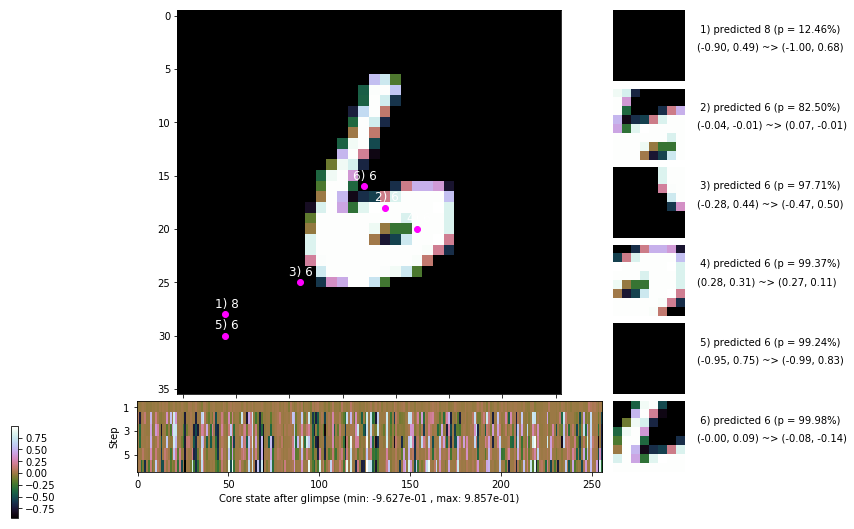

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 136.7 ms/b | lr: 7.27e-04 | grad 2norm: 11.51 | grad inf norm:  2.695
         Weights || abs max:  2.16 ( 4542.12) | mean: -6.31e-05 ( 0.02) | var: 5.24e-02 (  990.64)
          Biases || abs max:  1.16 (   78.92) | mean: -1.23e-01 ( 0.08) | var: 6.22e-02 (   26.89)
                    class loss: 0.294 | steps: 2.273 | reward:  3.679 | acc.: 90.42%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 136.0 ms/b | lr: 7.26e-04 | grad 2norm: 11.82 | grad inf norm:  2.889
         Weights || abs max:  2.16 ( 2339.75) | mean: -7.60e-05 ( 0.01) | var: 5.26e-02 (   71.00)
          Biases || abs max:  1.16 (  803.83) | mean: -1.23e-01 ( 0.36) | var: 6.26e-02 (29800.21)
                    class loss: 0.300 | steps: 2.275 | reward:  3.679 | acc.: 90.55%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

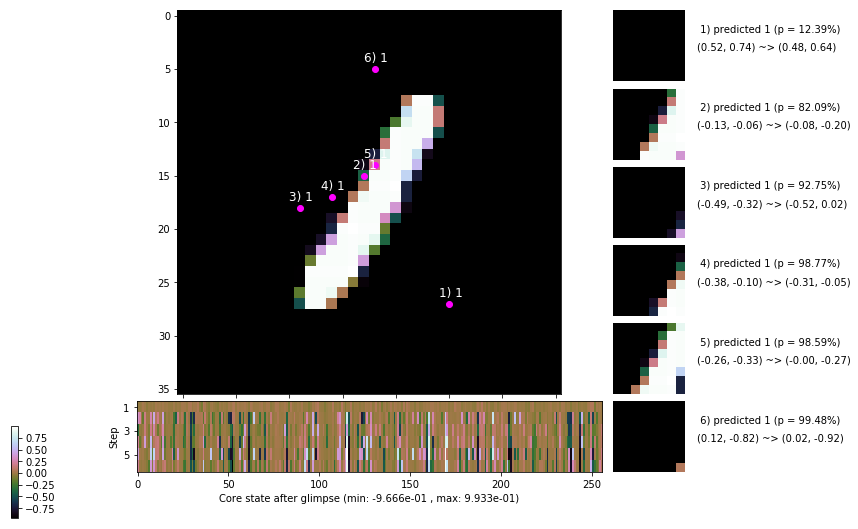

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 134.9 ms/b | lr: 7.25e-04 | grad 2norm: 11.45 | grad inf norm:  2.712
         Weights || abs max:  2.17 ( 4094.78) | mean: -7.70e-05 ( 0.02) | var: 5.27e-02 (  358.63)
          Biases || abs max:  1.16 (   64.64) | mean: -1.23e-01 ( 0.07) | var: 6.28e-02 (   26.63)
                    class loss: 0.288 | steps: 2.228 | reward:  3.733 | acc.: 90.52%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 138.8 ms/b | lr: 7.24e-04 | grad 2norm: 11.30 | grad inf norm:  2.731
         Weights || abs max:  2.17 ( 5265.78) | mean: -4.48e-05 ( 0.02) | var: 5.28e-02 ( 1347.22)
          Biases || abs max:  1.15 (   45.66) | mean: -1.23e-01 ( 0.06) | var: 6.30e-02 (    7.98)
                    class loss: 0.287 | steps: 2.261 | reward:  3.710 | acc.: 90.78%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

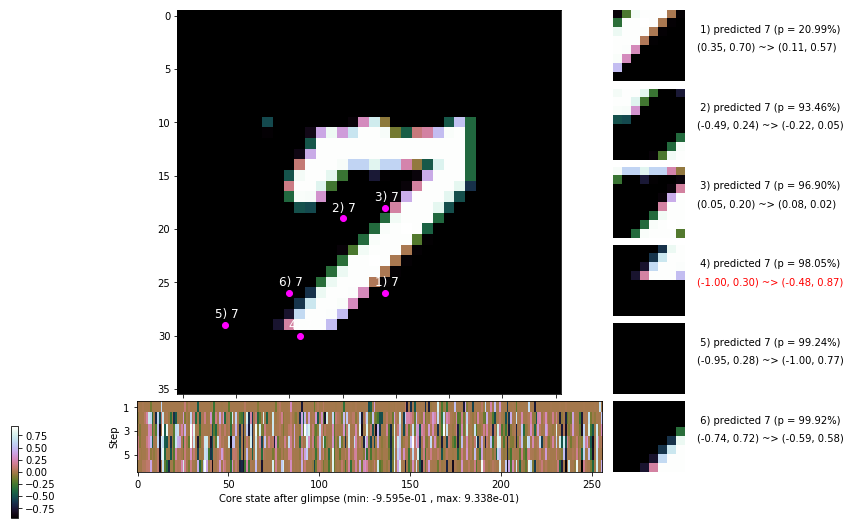

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 149.7 ms/b | lr: 7.22e-04 | grad 2norm: 11.45 | grad inf norm:  2.818
         Weights || abs max:  2.16 ( 6682.80) | mean: -8.01e-06 ( 0.02) | var: 5.29e-02 ( 2162.17)
          Biases || abs max:  1.13 (   66.08) | mean: -1.24e-01 ( 0.08) | var: 6.32e-02 (   15.38)
                    class loss: 0.280 | steps: 2.267 | reward:  3.703 | acc.: 91.10%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.1 ms/b | lr: 7.22e-04 | grad 2norm: 11.27 | grad inf norm:  2.708
         Weights || abs max:  2.16 (16343.62) | mean: -3.19e-05 ( 0.04) | var: 5.30e-02 (30128.39)
          Biases || abs max:  1.13 (18267.35) | mean: -1.23e-01 ( 7.15) | var: 6.33e-02 (38679840.00)
                    class loss: 0.265 | steps: 2.252 | reward:  3.732 | acc.: 91.50%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 

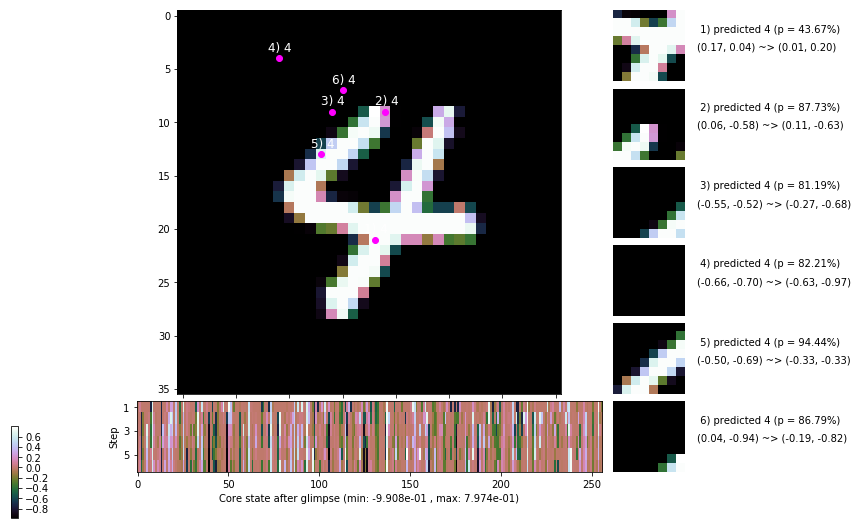

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.0 ms/b | lr: 7.20e-04 | grad 2norm: 11.43 | grad inf norm:  2.792
         Weights || abs max:  2.17 ( 2759.61) | mean: -5.60e-05 ( 0.01) | var: 5.32e-02 (  144.04)
          Biases || abs max:  1.14 (   85.95) | mean: -1.24e-01 ( 0.08) | var: 6.36e-02 (   43.31)
                    class loss: 0.282 | steps: 2.216 | reward:  3.767 | acc.: 91.05%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 137.7 ms/b | lr: 7.20e-04 | grad 2norm: 11.26 | grad inf norm:  2.763
         Weights || abs max:  2.19 ( 2472.45) | mean: -3.35e-05 ( 0.01) | var: 5.33e-02 (  135.25)
          Biases || abs max:  1.13 (   61.46) | mean: -1.24e-01 ( 0.07) | var: 6.39e-02 (   16.79)
                    class loss: 0.265 | steps: 2.226 | reward:  3.765 | acc.: 91.48%

	Target class: 6 | Discounted rewards: [-0.539, -0.389, 1

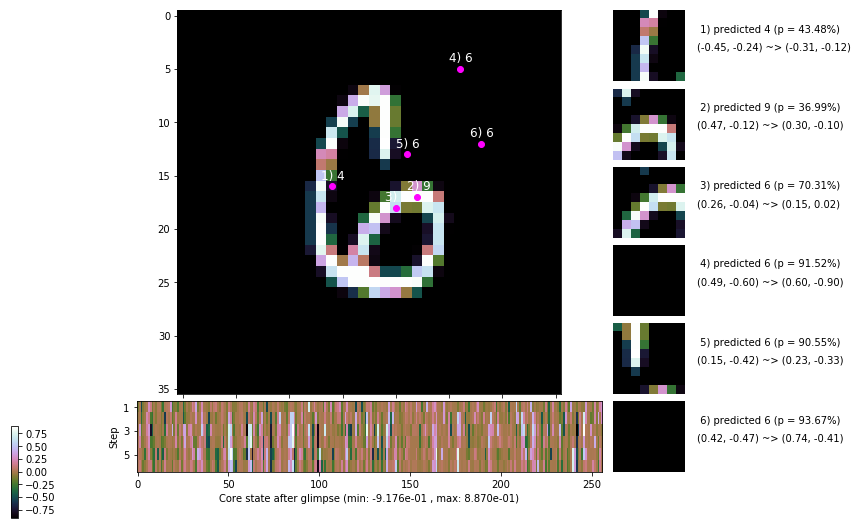

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


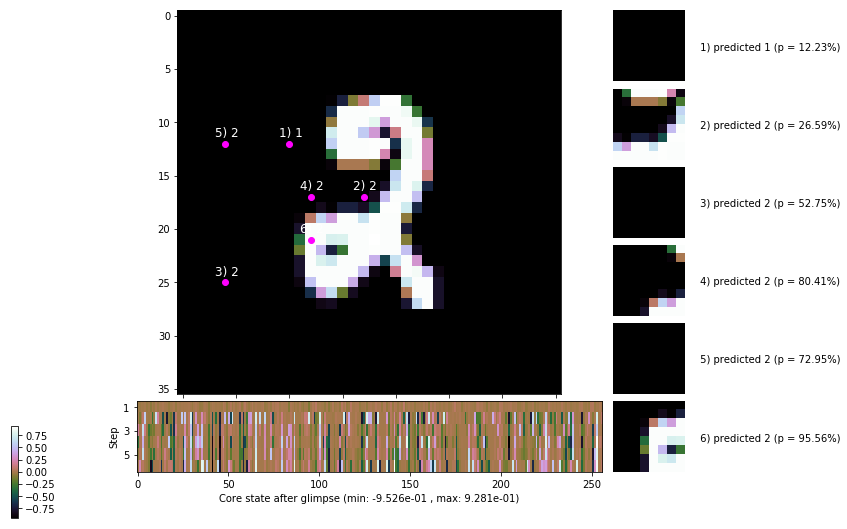


	Target class: 7 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


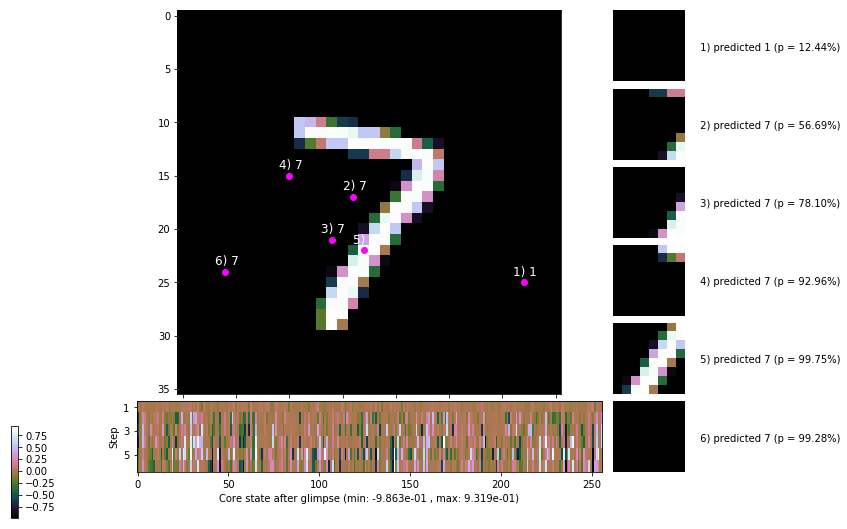

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


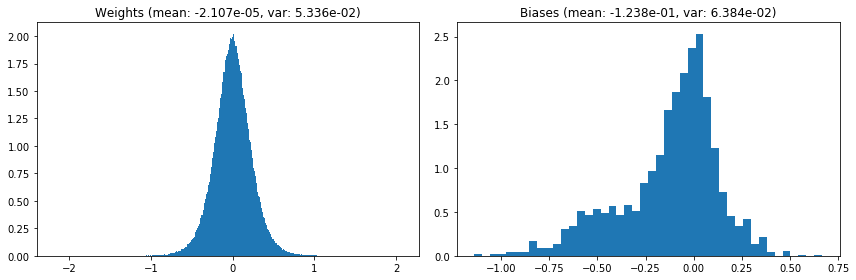

                                      Location network weights and biases


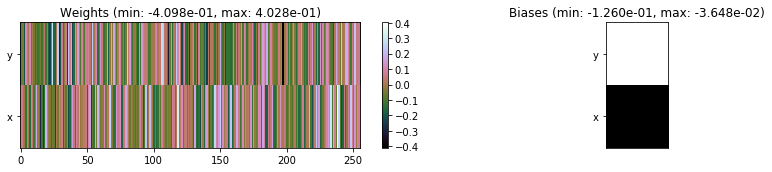

---------------------------------------------------------------------------------------------------------------
Elapsed time:  417.71 sec | TRAIN >> class loss: 0.2858 | steps:  2.253    | reward:  3.7112    | acc.: 90.823% 
                          | VAL   >> class loss: 0.2444 | steps:  2.074    | reward:  4.0281    | acc.: 91.740% 


Epoch  23/400) lr = 0.0007188
 b    300/  3000 >> 162.2 ms/b | lr: 7.18e-04 | grad 2norm: 11.43 | grad inf norm:  2.795
         Weights || abs max:  2.18 ( 4120.46) | mean:  2.51e-06 ( 0.02) | var: 5.34e-02 ( 2132.76)
          Biases || abs max:  1.14 (   79.90) | mean: -1.24e-01 ( 0.08) | var: 6.39e-02 (   32.35)
                    class loss: 0.280 | steps: 2.262 | reward:  3.708 | acc.: 90.80%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 139.6 ms/b | lr: 7.17e-04 | grad 2norm: 11.43 | grad inf norm:  2.792
         Weights || abs max:  2.19 ( 3270.05) | mean:  2.98e-05 ( 0.0

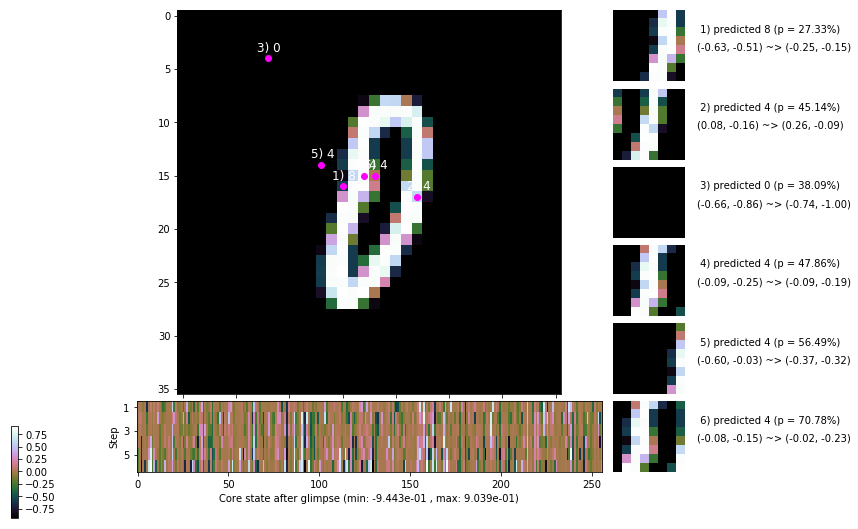

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 140.8 ms/b | lr: 7.16e-04 | grad 2norm: 11.16 | grad inf norm:  2.632
         Weights || abs max:  2.19 ( 4292.35) | mean:  1.01e-05 ( 0.02) | var: 5.37e-02 (  599.11)
          Biases || abs max:  1.16 (  142.26) | mean: -1.25e-01 ( 0.11) | var: 6.42e-02 (  596.33)
                    class loss: 0.260 | steps: 2.225 | reward:  3.788 | acc.: 91.72%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 138.4 ms/b | lr: 7.15e-04 | grad 2norm: 11.41 | grad inf norm:  2.870
         Weights || abs max:  2.18 ( 8003.75) | mean: -1.84e-05 ( 0.02) | var: 5.38e-02 ( 9362.91)
          Biases || abs max:  1.15 (  113.57) | mean: -1.24e-01 ( 0.10) | var: 6.42e-02 (   76.47)
                    class loss: 0.274 | steps: 2.243 | reward:  3.729 | acc.: 91.08%

	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1.

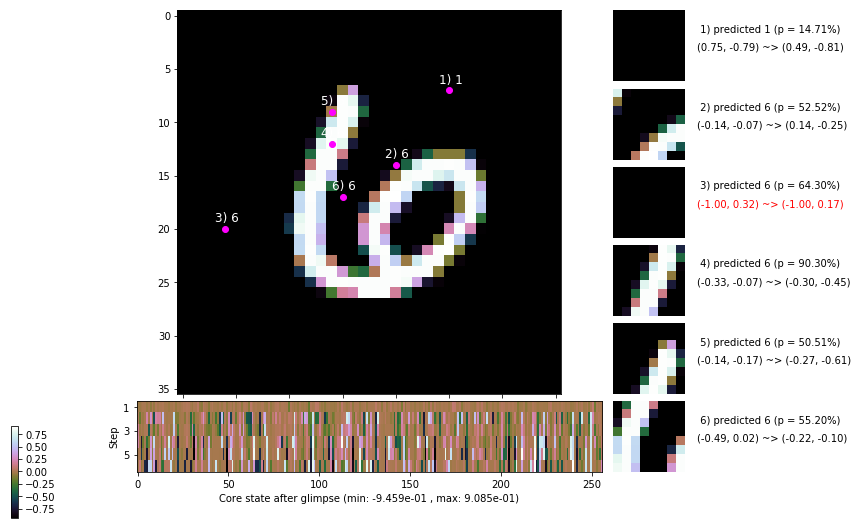

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 139.3 ms/b | lr: 7.14e-04 | grad 2norm: 11.24 | grad inf norm:  2.655
         Weights || abs max:  2.19 ( 5760.79) | mean: -3.81e-05 ( 0.02) | var: 5.39e-02 ( 6652.41)
          Biases || abs max:  1.16 (   54.41) | mean: -1.25e-01 ( 0.07) | var: 6.43e-02 (   39.72)
                    class loss: 0.260 | steps: 2.250 | reward:  3.761 | acc.: 91.55%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 139.2 ms/b | lr: 7.13e-04 | grad 2norm: 11.48 | grad inf norm:  2.730
         Weights || abs max:  2.19 ( 4637.68) | mean: -5.69e-05 ( 0.02) | var: 5.41e-02 ( 1709.42)
          Biases || abs max:  1.16 (  291.02) | mean: -1.26e-01 ( 0.16) | var: 6.45e-02 ( 3693.19)
                    class loss: 0.297 | steps: 2.251 | reward:  3.714 | acc.: 90.67%

	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1.

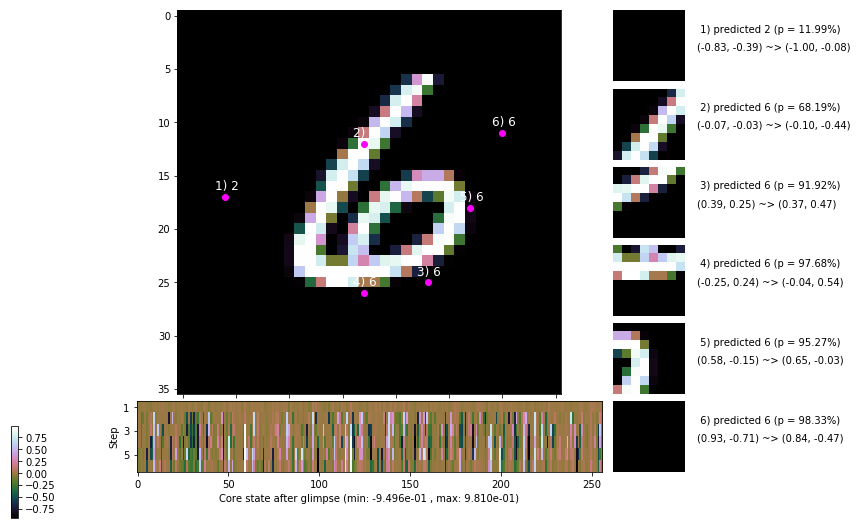

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 141.0 ms/b | lr: 7.12e-04 | grad 2norm: 11.18 | grad inf norm:  2.681
         Weights || abs max:  2.20 ( 5089.64) | mean: -3.79e-05 ( 0.02) | var: 5.42e-02 (  849.68)
          Biases || abs max:  1.16 (  114.99) | mean: -1.25e-01 ( 0.10) | var: 6.46e-02 (  148.81)
                    class loss: 0.274 | steps: 2.249 | reward:  3.716 | acc.: 90.80%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.2 ms/b | lr: 7.11e-04 | grad 2norm: 11.26 | grad inf norm:  2.729
         Weights || abs max:  2.19 ( 2000.05) | mean: -1.96e-05 ( 0.01) | var: 5.43e-02 (   77.48)
          Biases || abs max:  1.16 (  278.88) | mean: -1.26e-01 ( 0.18) | var: 6.47e-02 ( 3016.53)
                    class loss: 0.276 | steps: 2.265 | reward:  3.726 | acc.: 91.08%

	Target class: 6 | Discounted rewards: [0.961, -0.389, 1.

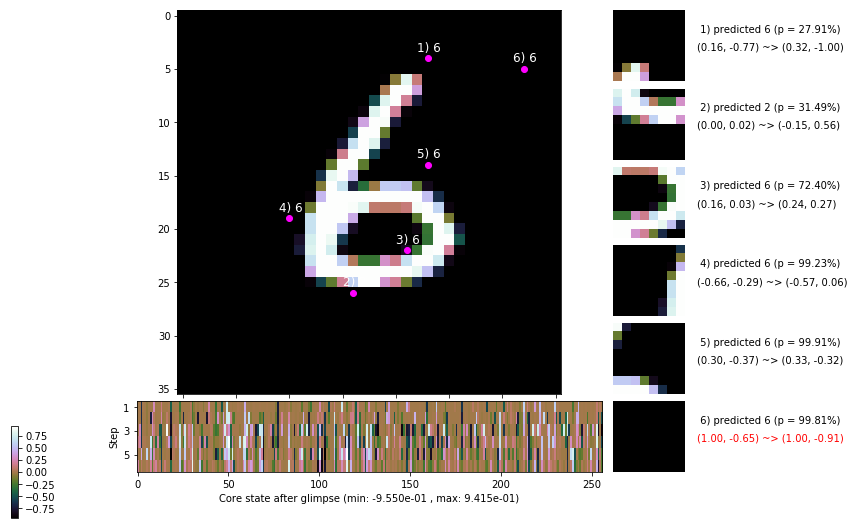

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 140.5 ms/b | lr: 7.10e-04 | grad 2norm: 11.60 | grad inf norm:  2.832
         Weights || abs max:  2.19 ( 4061.08) | mean: -6.61e-05 ( 0.02) | var: 5.44e-02 (  609.05)
          Biases || abs max:  1.16 (  329.34) | mean: -1.26e-01 ( 0.20) | var: 6.50e-02 ( 2714.80)
                    class loss: 0.278 | steps: 2.251 | reward:  3.736 | acc.: 91.10%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 137.2 ms/b | lr: 7.09e-04 | grad 2norm: 11.08 | grad inf norm:  2.572
         Weights || abs max:  2.20 ( 4012.43) | mean: -9.50e-05 ( 0.02) | var: 5.45e-02 (  771.63)
          Biases || abs max:  1.17 (  138.83) | mean: -1.26e-01 ( 0.12) | var: 6.51e-02 (  668.44)
                    class loss: 0.259 | steps: 2.202 | reward:  3.804 | acc.: 92.00%

	Target class: 4 | Discounted rewards: [-0.389, 1.111, 1.

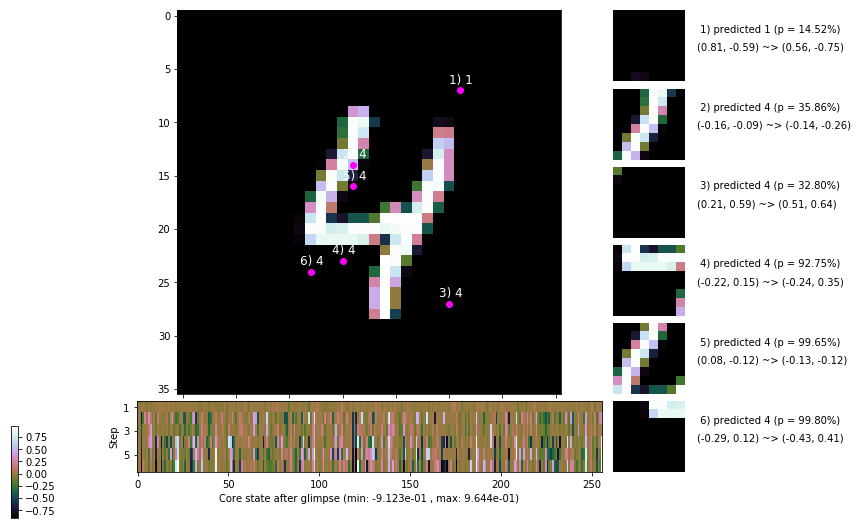

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


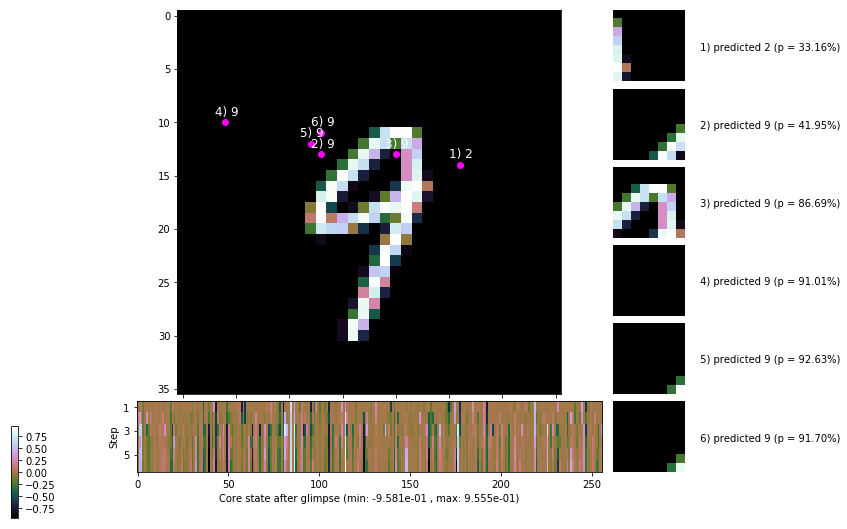


	Target class: 7 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


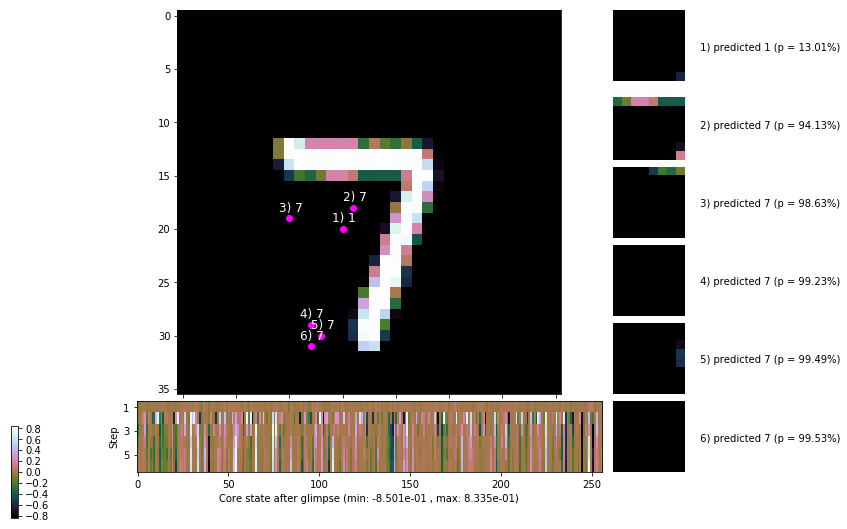

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


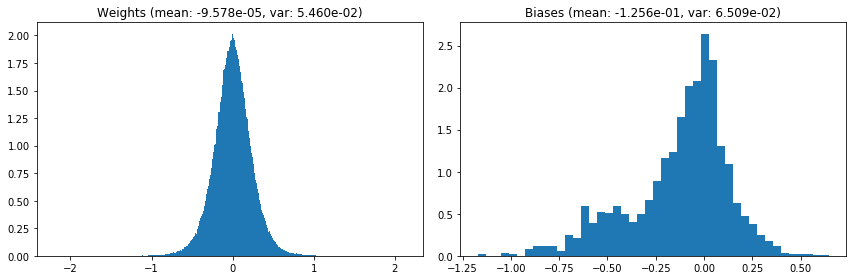

                                      Location network weights and biases


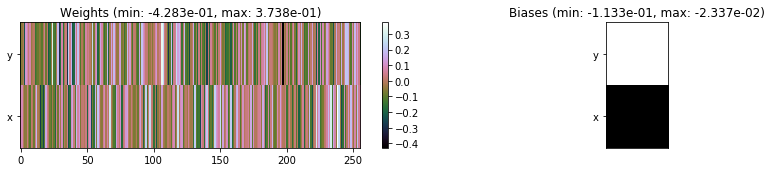

---------------------------------------------------------------------------------------------------------------
Elapsed time:  425.87 sec | TRAIN >> class loss: 0.2742 | steps:  2.244    | reward:  3.7431    | acc.: 91.165% 
                          | VAL   >> class loss: 0.2217 | steps:  2.102 :( | reward:  4.0173 :( | acc.: 92.660% 


Epoch  24/400) lr = 0.0007081
 b    300/  3000 >> 137.9 ms/b | lr: 7.07e-04 | grad 2norm: 11.28 | grad inf norm:  2.707
         Weights || abs max:  2.21 ( 3009.51) | mean: -9.51e-05 ( 0.01) | var: 5.47e-02 (  209.93)
          Biases || abs max:  1.19 (  116.89) | mean: -1.26e-01 ( 0.11) | var: 6.50e-02 (   79.84)
                    class loss: 0.270 | steps: 2.234 | reward:  3.749 | acc.: 91.30%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 137.7 ms/b | lr: 7.07e-04 | grad 2norm: 11.19 | grad inf norm:  2.774
         Weights || abs max:  2.20 ( 3239.38) | mean: -1.07e-04 ( 0.0

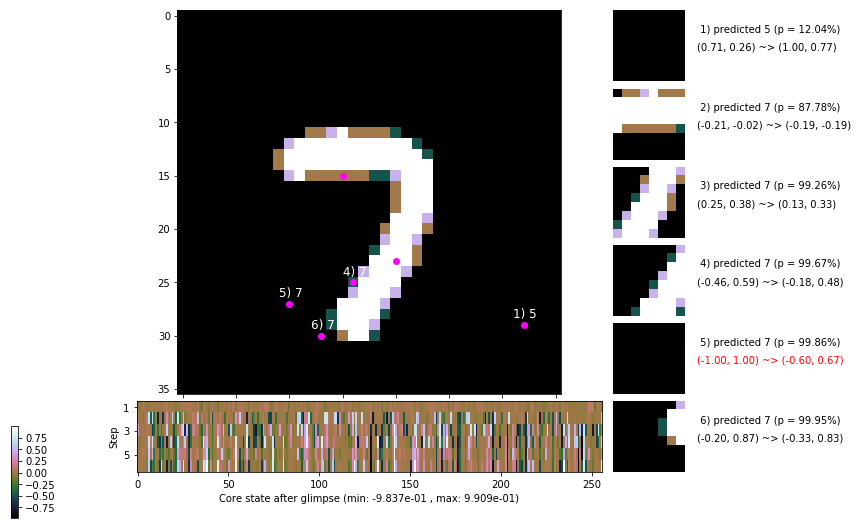

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 140.0 ms/b | lr: 7.05e-04 | grad 2norm: 11.15 | grad inf norm:  2.677
         Weights || abs max:  2.20 ( 9426.32) | mean: -1.10e-04 ( 0.03) | var: 5.49e-02 ( 6689.74)
          Biases || abs max:  1.19 (  150.61) | mean: -1.26e-01 ( 0.12) | var: 6.53e-02 (  288.37)
                    class loss: 0.262 | steps: 2.235 | reward:  3.781 | acc.: 91.63%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 140.9 ms/b | lr: 7.05e-04 | grad 2norm: 11.48 | grad inf norm:  2.847
         Weights || abs max:  2.20 (12142.53) | mean: -1.24e-04 ( 0.03) | var: 5.50e-02 (41079.09)
          Biases || abs max:  1.19 (  108.53) | mean: -1.27e-01 ( 0.10) | var: 6.58e-02 (   58.42)
                    class loss: 0.288 | steps: 2.239 | reward:  3.733 | acc.: 90.62%

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.

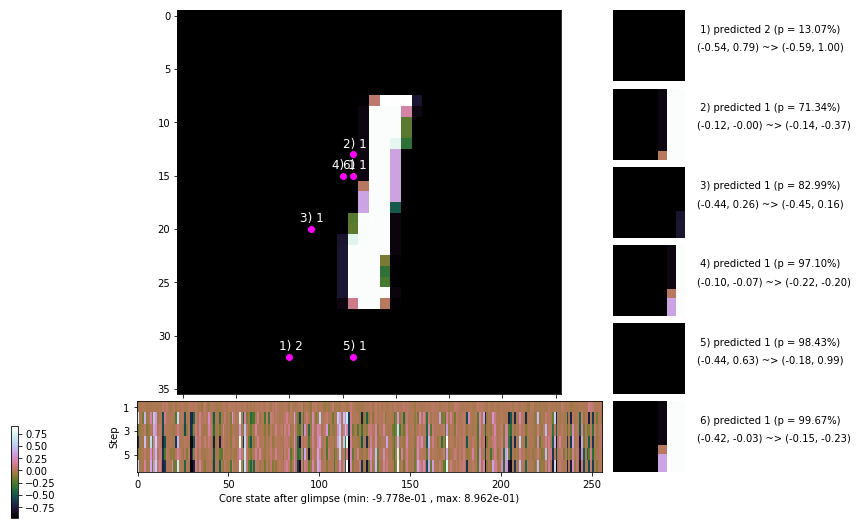

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.4 ms/b | lr: 7.03e-04 | grad 2norm: 11.09 | grad inf norm:  2.761
         Weights || abs max:  2.20 (14827.78) | mean: -8.02e-05 ( 0.04) | var: 5.51e-02 (66603.22)
          Biases || abs max:  1.19 (   71.55) | mean: -1.28e-01 ( 0.08) | var: 6.61e-02 (   26.06)
                    class loss: 0.265 | steps: 2.232 | reward:  3.779 | acc.: 91.57%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 138.3 ms/b | lr: 7.02e-04 | grad 2norm: 11.36 | grad inf norm:  2.754
         Weights || abs max:  2.21 ( 3565.40) | mean: -7.32e-05 ( 0.02) | var: 5.52e-02 (  289.43)
          Biases || abs max:  1.19 (  104.97) | mean: -1.27e-01 ( 0.09) | var: 6.60e-02 (   54.23)
                    class loss: 0.279 | steps: 2.250 | reward:  3.733 | acc.: 91.20%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

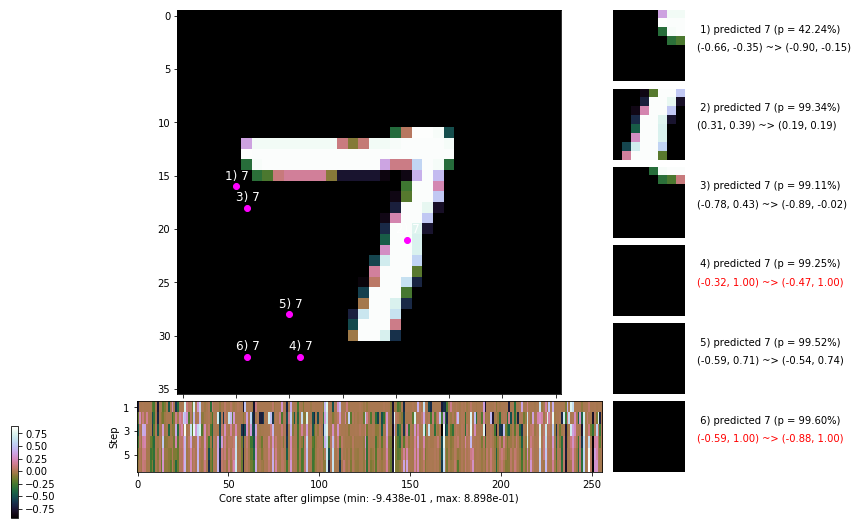

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 139.7 ms/b | lr: 7.01e-04 | grad 2norm: 11.58 | grad inf norm:  2.784
         Weights || abs max:  2.22 ( 6569.73) | mean: -8.80e-05 ( 0.02) | var: 5.53e-02 ( 6224.27)
          Biases || abs max:  1.20 (  797.64) | mean: -1.27e-01 ( 0.37) | var: 6.60e-02 (50017.86)
                    class loss: 0.270 | steps: 2.227 | reward:  3.721 | acc.: 90.82%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.6 ms/b | lr: 7.00e-04 | grad 2norm: 11.22 | grad inf norm:  2.675
         Weights || abs max:  2.22 ( 4695.19) | mean: -9.20e-05 ( 0.02) | var: 5.54e-02 ( 1317.33)
          Biases || abs max:  1.22 (  193.90) | mean: -1.27e-01 ( 0.13) | var: 6.64e-02 (  643.80)
                    class loss: 0.270 | steps: 2.226 | reward:  3.788 | acc.: 91.38%

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.1

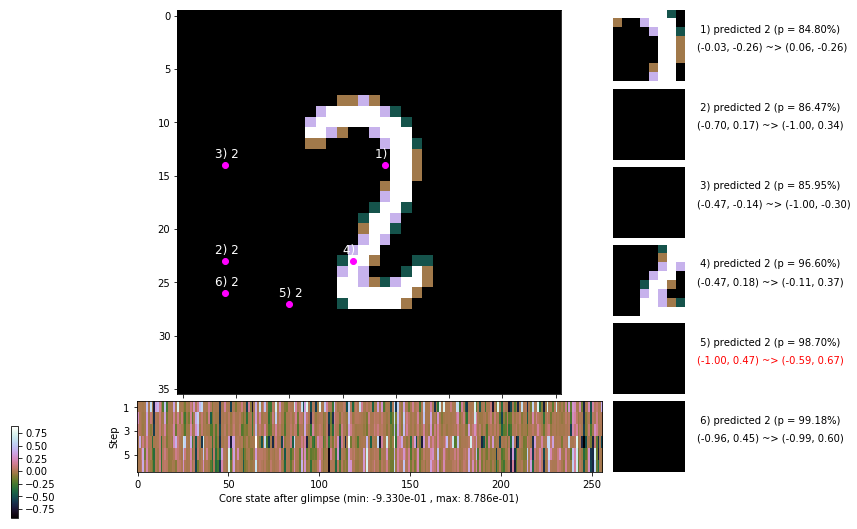

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 139.9 ms/b | lr: 6.99e-04 | grad 2norm: 11.34 | grad inf norm:  2.833
         Weights || abs max:  2.22 ( 2623.73) | mean: -1.09e-04 ( 0.01) | var: 5.55e-02 (   67.20)
          Biases || abs max:  1.22 (   78.53) | mean: -1.27e-01 ( 0.08) | var: 6.67e-02 (   26.39)
                    class loss: 0.277 | steps: 2.224 | reward:  3.775 | acc.: 91.22%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 137.4 ms/b | lr: 6.98e-04 | grad 2norm: 11.16 | grad inf norm:  2.648
         Weights || abs max:  2.22 ( 5591.82) | mean: -1.05e-04 ( 0.02) | var: 5.56e-02 ( 3162.31)
          Biases || abs max:  1.23 (   66.01) | mean: -1.28e-01 ( 0.08) | var: 6.70e-02 (   54.96)
                    class loss: 0.293 | steps: 2.232 | reward:  3.753 | acc.: 90.70%

	Target class: 4 | Discounted rewards: [-0.539, -0.389, 1

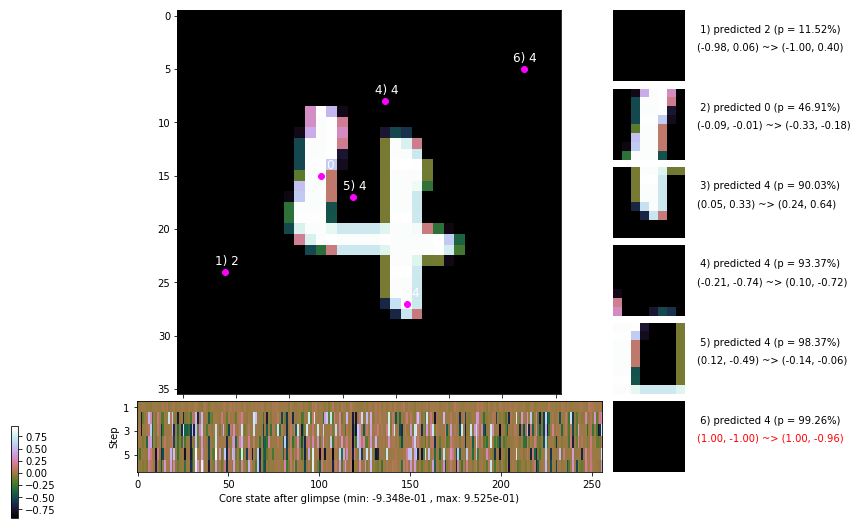

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


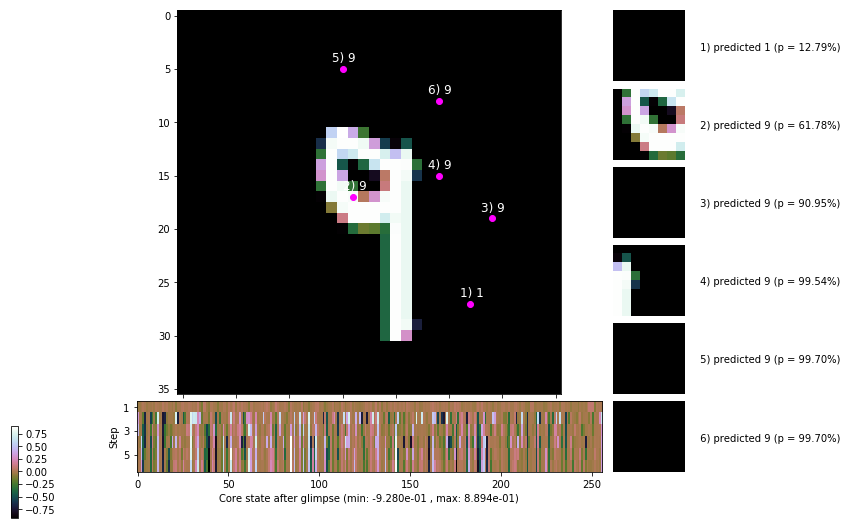


	Target class: 8 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


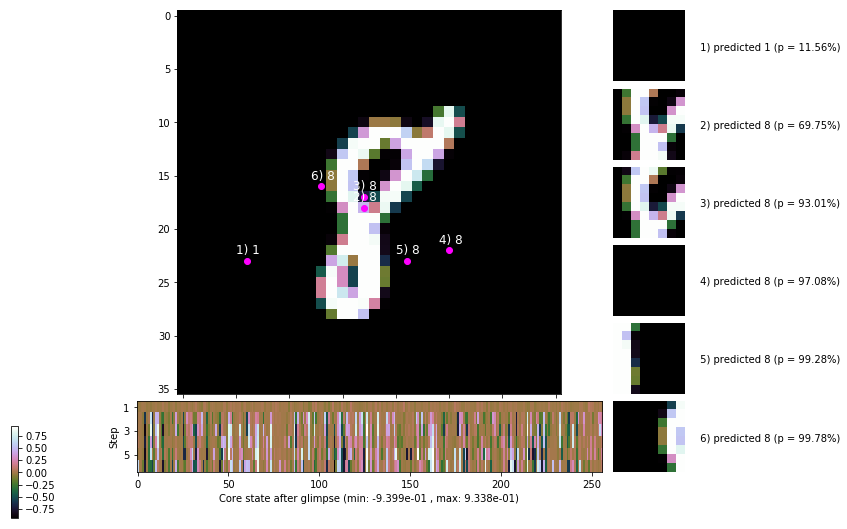

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


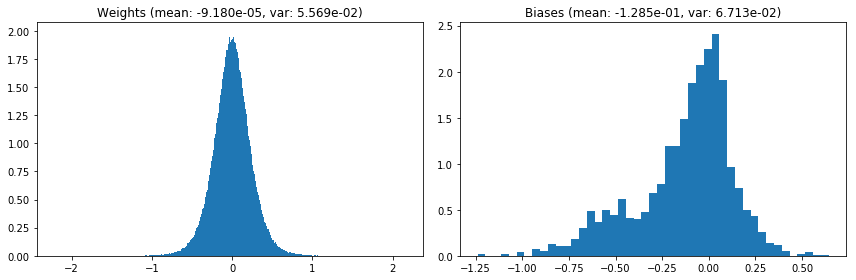

                                      Location network weights and biases


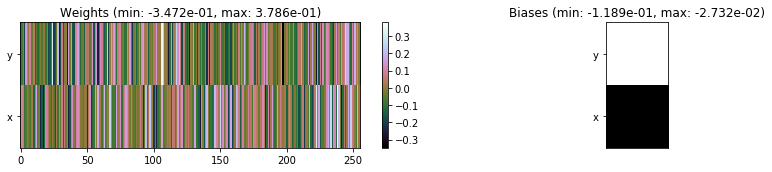

---------------------------------------------------------------------------------------------------------------
Elapsed time:  424.36 sec | TRAIN >> class loss: 0.2733 | steps:  2.231    | reward:  3.7624    | acc.: 91.228% 
                          | VAL   >> class loss: 0.2497 | steps:  2.111 :( | reward:  3.9639 :( | acc.: 91.500% :(


Epoch  25/400) lr = 0.0006976
 b    300/  3000 >> 145.7 ms/b | lr: 6.97e-04 | grad 2norm: 11.20 | grad inf norm:  2.889
         Weights || abs max:  2.22 ( 3063.03) | mean: -1.11e-04 ( 0.01) | var: 5.58e-02 (  214.49)
          Biases || abs max:  1.24 (   76.97) | mean: -1.28e-01 ( 0.08) | var: 6.72e-02 (   37.98)
                    class loss: 0.267 | steps: 2.225 | reward:  3.758 | acc.: 91.30%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 137.9 ms/b | lr: 6.96e-04 | grad 2norm: 11.34 | grad inf norm:  2.722
         Weights || abs max:  2.22 ( 2221.45) | mean: -1.09e-04 ( 0

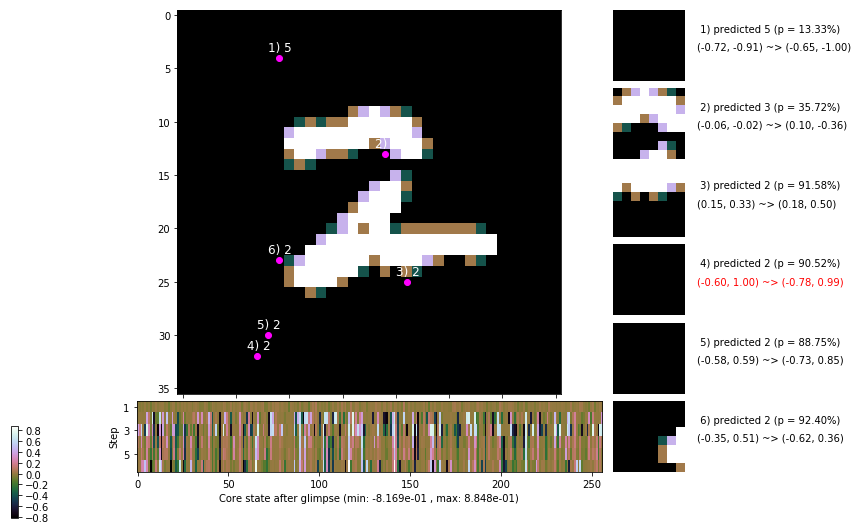

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.8 ms/b | lr: 6.95e-04 | grad 2norm: 11.17 | grad inf norm:  2.735
         Weights || abs max:  2.24 ( 5033.24) | mean: -1.24e-04 ( 0.02) | var: 5.60e-02 ( 3539.68)
          Biases || abs max:  1.24 (  123.33) | mean: -1.28e-01 ( 0.12) | var: 6.73e-02 (  143.68)
                    class loss: 0.270 | steps: 2.229 | reward:  3.781 | acc.: 91.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 142.2 ms/b | lr: 6.94e-04 | grad 2norm: 11.21 | grad inf norm:  2.690
         Weights || abs max:  2.24 ( 2578.13) | mean: -1.26e-04 ( 0.01) | var: 5.61e-02 (   94.58)
          Biases || abs max:  1.24 (   72.89) | mean: -1.29e-01 ( 0.09) | var: 6.75e-02 (   13.73)
                    class loss: 0.276 | steps: 2.204 | reward:  3.802 | acc.: 91.48%

	Target class: 0 | Discounted rewards: [-0.389, 1.111, 1.

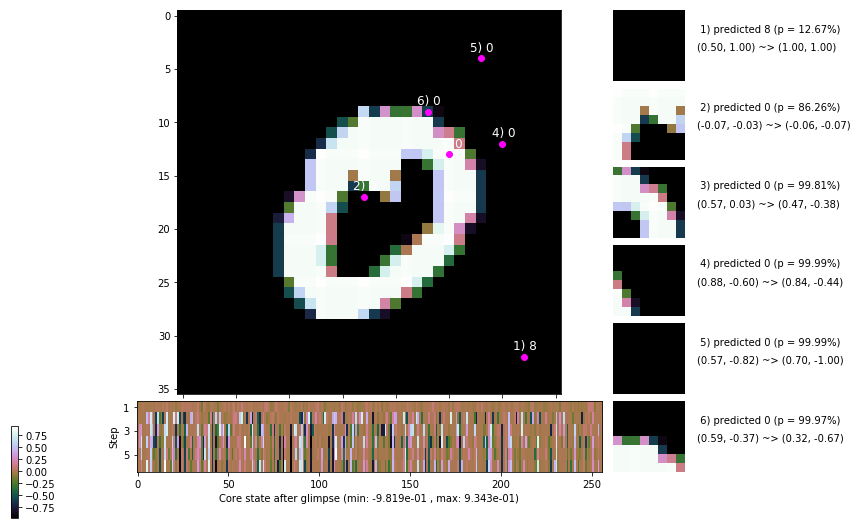

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 138.3 ms/b | lr: 6.93e-04 | grad 2norm: 11.34 | grad inf norm:  2.861
         Weights || abs max:  2.23 ( 4679.57) | mean: -1.03e-04 ( 0.02) | var: 5.62e-02 (  636.83)
          Biases || abs max:  1.23 (  452.59) | mean: -1.29e-01 ( 0.24) | var: 6.78e-02 (10470.39)
                    class loss: 0.269 | steps: 2.212 | reward:  3.799 | acc.: 91.53%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 136.7 ms/b | lr: 6.92e-04 | grad 2norm: 11.60 | grad inf norm:  2.888
         Weights || abs max:  2.22 ( 4739.67) | mean: -1.17e-04 ( 0.02) | var: 5.63e-02 ( 1573.77)
          Biases || abs max:  1.23 (  476.56) | mean: -1.29e-01 ( 0.26) | var: 6.78e-02 ( 8602.12)
                    class loss: 0.284 | steps: 2.229 | reward:  3.753 | acc.: 90.55%

	Target class: 4 | Discounted rewards: [-0.555, -0.554, -

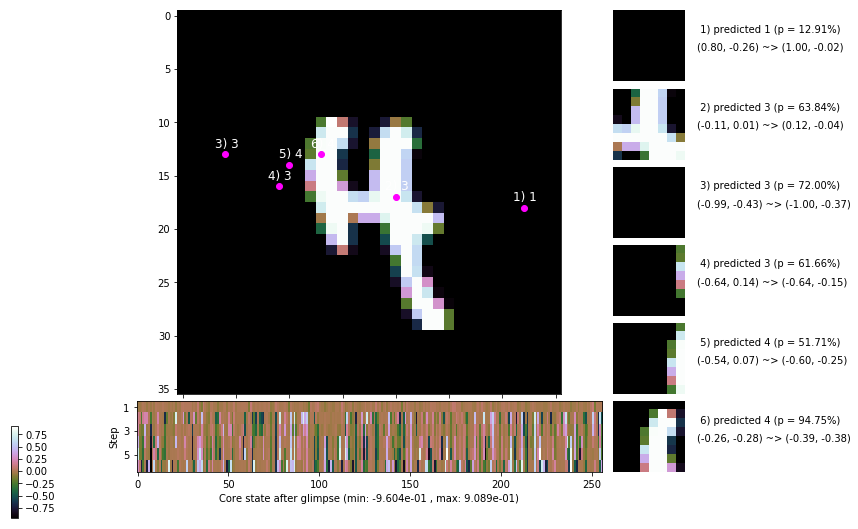

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 140.4 ms/b | lr: 6.91e-04 | grad 2norm: 11.27 | grad inf norm:  2.752
         Weights || abs max:  2.22 ( 3253.98) | mean: -1.11e-04 ( 0.02) | var: 5.64e-02 (  185.10)
          Biases || abs max:  1.23 (  161.49) | mean: -1.29e-01 ( 0.13) | var: 6.81e-02 (   83.17)
                    class loss: 0.263 | steps: 2.212 | reward:  3.805 | acc.: 91.60%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.0 ms/b | lr: 6.90e-04 | grad 2norm: 11.39 | grad inf norm:  2.796
         Weights || abs max:  2.23 ( 2396.01) | mean: -1.07e-04 ( 0.01) | var: 5.66e-02 (  163.53)
          Biases || abs max:  1.22 (  207.25) | mean: -1.29e-01 ( 0.14) | var: 6.83e-02 (  423.28)
                    class loss: 0.275 | steps: 2.230 | reward:  3.737 | acc.: 90.82%

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1.

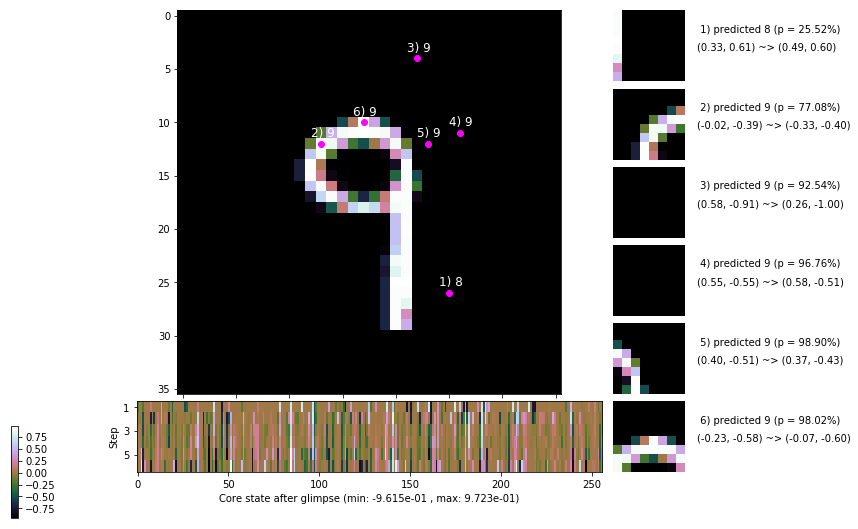

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 161.1 ms/b | lr: 6.89e-04 | grad 2norm: 11.16 | grad inf norm:  2.745
         Weights || abs max:  2.25 ( 2804.40) | mean: -1.02e-04 ( 0.01) | var: 5.66e-02 (   94.10)
          Biases || abs max:  1.23 (   78.69) | mean: -1.31e-01 ( 0.08) | var: 6.86e-02 (   58.21)
                    class loss: 0.286 | steps: 2.234 | reward:  3.747 | acc.: 91.02%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 137.2 ms/b | lr: 6.88e-04 | grad 2norm: 11.49 | grad inf norm:  2.689
         Weights || abs max:  2.25 ( 2342.19) | mean: -1.15e-04 ( 0.01) | var: 5.67e-02 (  102.99)
          Biases || abs max:  1.23 (  142.81) | mean: -1.31e-01 ( 0.11) | var: 6.86e-02 (  749.86)
                    class loss: 0.283 | steps: 2.204 | reward:  3.763 | acc.: 90.58%

	Target class: 8 | Discounted rewards: [-0.556, -0.555, -

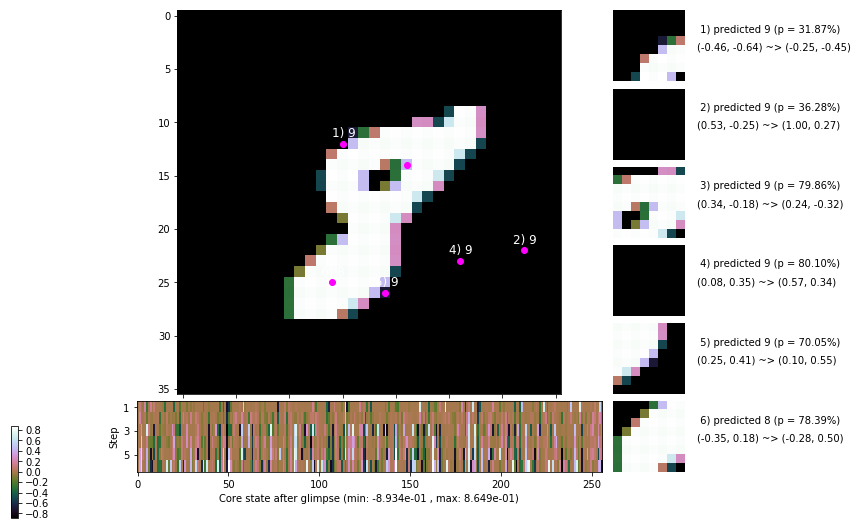

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


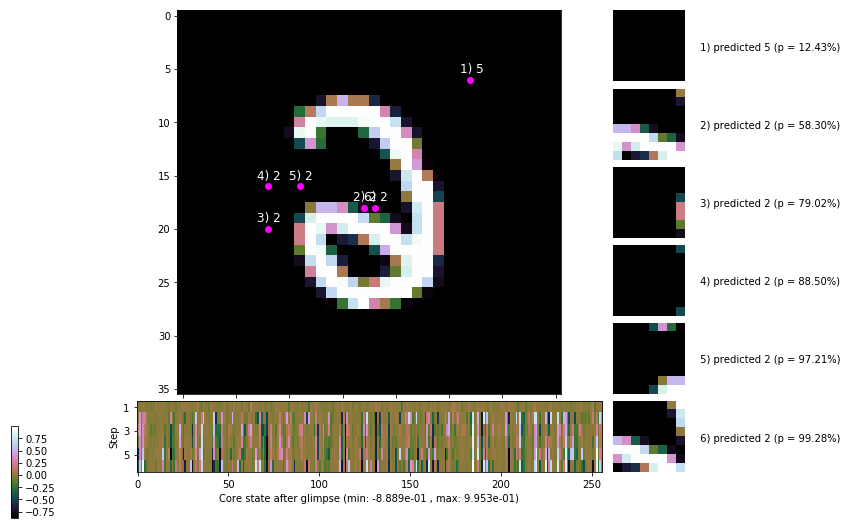


	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


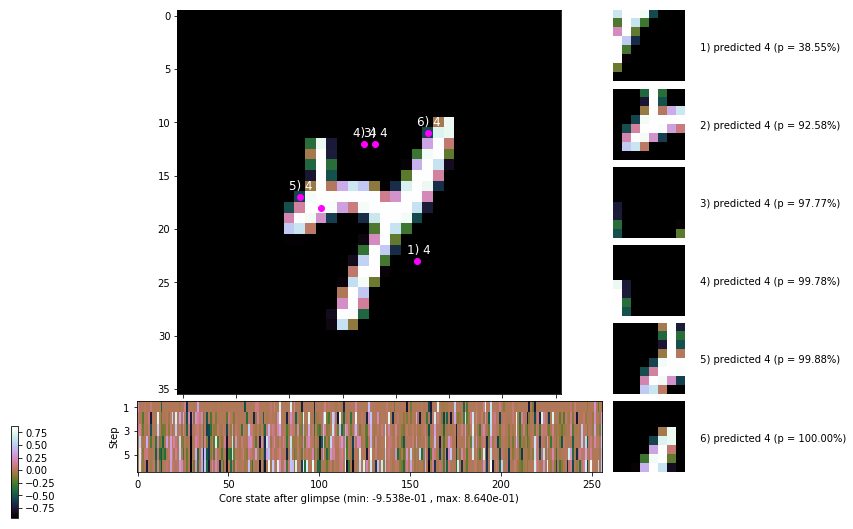

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


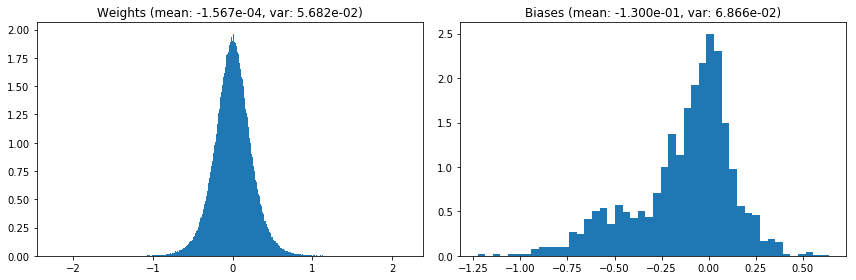

                                      Location network weights and biases


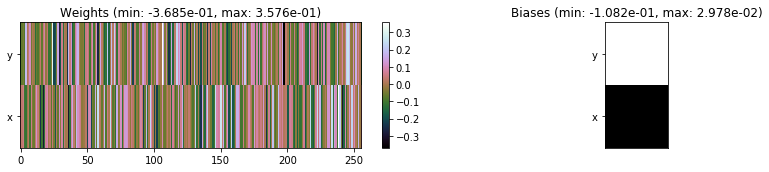

---------------------------------------------------------------------------------------------------------------
Elapsed time:  427.70 sec | TRAIN >> class loss: 0.2741 | steps:  2.225    | reward:  3.7672    | acc.: 91.160% :(
                          | VAL   >> class loss: 0.2620 | steps:  2.094 :( | reward:  3.9828 :( | acc.: 91.260% :(


Epoch  26/400) lr = 0.0006872
 b    300/  3000 >> 138.6 ms/b | lr: 6.86e-04 | grad 2norm: 11.36 | grad inf norm:  2.750
         Weights || abs max:  2.24 (73135.92) | mean: -1.48e-04 ( 0.14) | var: 5.69e-02 (2675088.75)
          Biases || abs max:  1.23 (  249.46) | mean: -1.30e-01 ( 0.15) | var: 6.86e-02 ( 2123.65)
                    class loss: 0.282 | steps: 2.255 | reward:  3.735 | acc.: 91.27%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 138.9 ms/b | lr: 6.86e-04 | grad 2norm: 11.52 | grad inf norm:  2.867
         Weights || abs max:  2.22 ( 7570.84) | mean: -9.35e-05

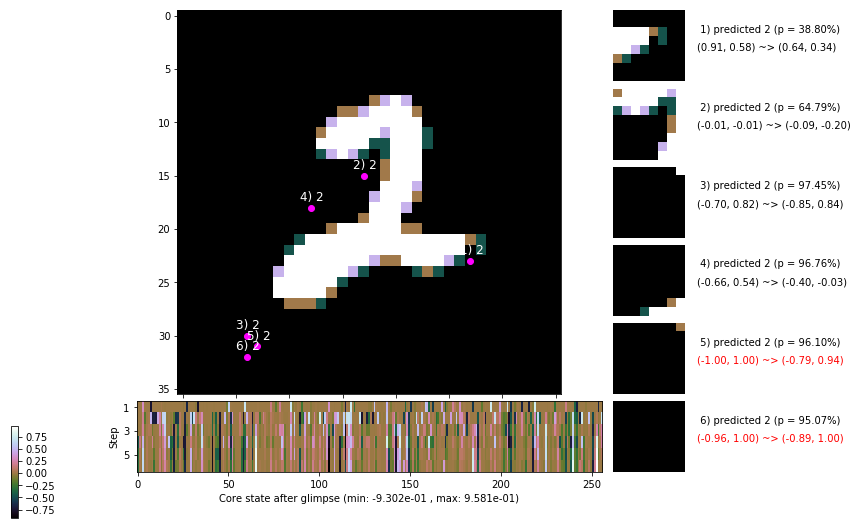

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 139.0 ms/b | lr: 6.84e-04 | grad 2norm: 11.70 | grad inf norm:  2.829
         Weights || abs max:  2.21 (12470.13) | mean: -9.80e-05 ( 0.03) | var: 5.71e-02 (15726.38)
          Biases || abs max:  1.23 ( 1395.17) | mean: -1.30e-01 ( 0.61) | var: 6.86e-02 (161945.47)
                    class loss: 0.301 | steps: 2.225 | reward:  3.732 | acc.: 90.10%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 138.7 ms/b | lr: 6.84e-04 | grad 2norm: 11.40 | grad inf norm:  2.732
         Weights || abs max:  2.21 ( 3721.03) | mean: -1.29e-04 ( 0.02) | var: 5.72e-02 (  421.20)
          Biases || abs max:  1.23 (  126.08) | mean: -1.30e-01 ( 0.12) | var: 6.88e-02 (  148.63)
                    class loss: 0.291 | steps: 2.221 | reward:  3.762 | acc.: 90.77%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.

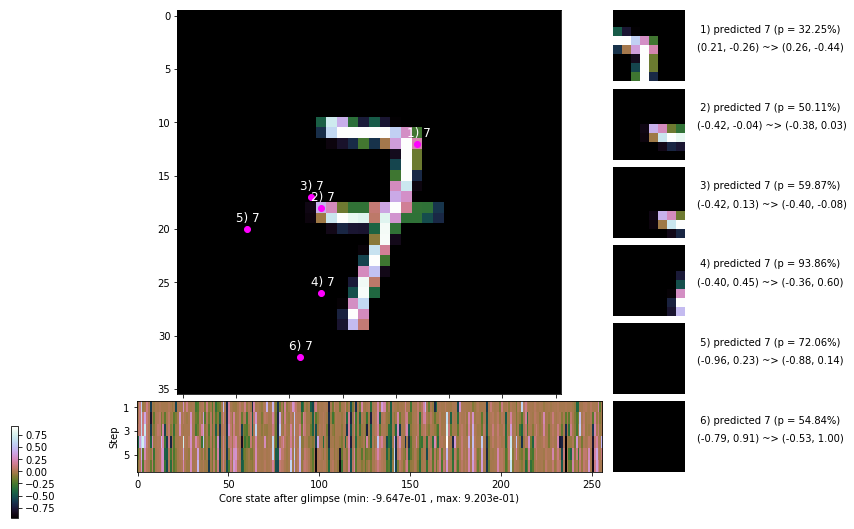

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 138.8 ms/b | lr: 6.82e-04 | grad 2norm: 11.80 | grad inf norm:  2.921
         Weights || abs max:  2.22 ( 3309.64) | mean: -1.09e-04 ( 0.02) | var: 5.73e-02 (  480.81)
          Biases || abs max:  1.23 (  268.73) | mean: -1.30e-01 ( 0.24) | var: 6.90e-02 ( 8780.48)
                    class loss: 0.306 | steps: 2.230 | reward:  3.725 | acc.: 89.97%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 137.8 ms/b | lr: 6.82e-04 | grad 2norm: 11.80 | grad inf norm:  2.812
         Weights || abs max:  2.21 ( 2691.26) | mean: -5.54e-05 ( 0.01) | var: 5.74e-02 (  109.65)
          Biases || abs max:  1.23 (  101.41) | mean: -1.31e-01 ( 0.09) | var: 6.90e-02 (   39.21)
                    class loss: 0.302 | steps: 2.260 | reward:  3.696 | acc.: 90.08%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

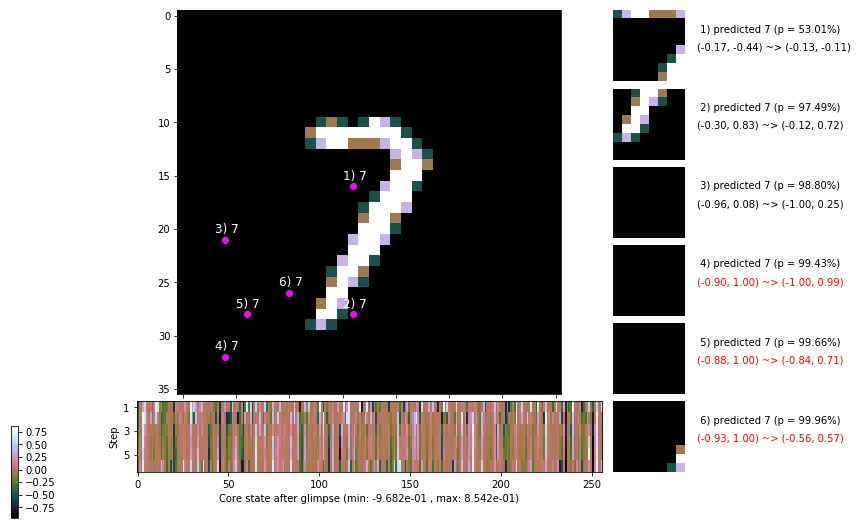

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 139.4 ms/b | lr: 6.80e-04 | grad 2norm: 11.50 | grad inf norm:  2.793
         Weights || abs max:  2.21 ( 6084.14) | mean: -4.43e-05 ( 0.02) | var: 5.76e-02 ( 3964.25)
          Biases || abs max:  1.22 (  158.90) | mean: -1.30e-01 ( 0.12) | var: 6.92e-02 (  702.75)
                    class loss: 0.290 | steps: 2.229 | reward:  3.733 | acc.: 90.25%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 138.0 ms/b | lr: 6.80e-04 | grad 2norm: 11.82 | grad inf norm:  2.921
         Weights || abs max:  2.22 ( 6876.47) | mean: -5.29e-05 ( 0.02) | var: 5.77e-02 ( 3811.57)
          Biases || abs max:  1.21 (   54.86) | mean: -1.31e-01 ( 0.07) | var: 6.95e-02 (   17.66)
                    class loss: 0.300 | steps: 2.244 | reward:  3.704 | acc.: 90.20%

	Target class: 9 | Discounted rewards: [1.111, 1.111, 1.1

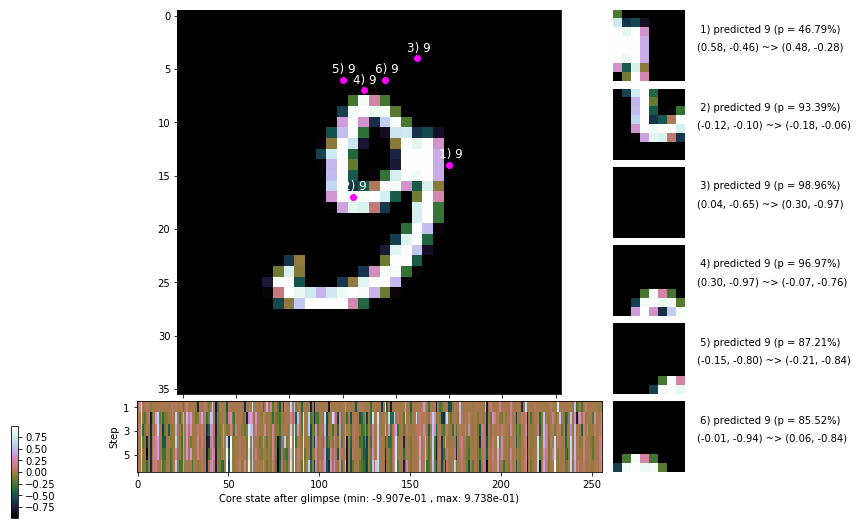

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 138.4 ms/b | lr: 6.78e-04 | grad 2norm: 11.69 | grad inf norm:  2.816
         Weights || abs max:  2.22 ( 4398.68) | mean: -3.68e-05 ( 0.02) | var: 5.78e-02 (  759.40)
          Biases || abs max:  1.22 (  448.84) | mean: -1.32e-01 ( 0.25) | var: 6.99e-02 ( 8873.51)
                    class loss: 0.300 | steps: 2.223 | reward:  3.733 | acc.: 89.90%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 137.0 ms/b | lr: 6.78e-04 | grad 2norm: 11.45 | grad inf norm:  2.710
         Weights || abs max:  2.22 ( 5421.30) | mean: -5.07e-05 ( 0.02) | var: 5.79e-02 ( 1657.13)
          Biases || abs max:  1.21 (  186.84) | mean: -1.32e-01 ( 0.14) | var: 6.99e-02 (  798.78)
                    class loss: 0.285 | steps: 2.228 | reward:  3.733 | acc.: 90.45%

	Target class: 2 | Discounted rewards: [-0.556, -0.556, -

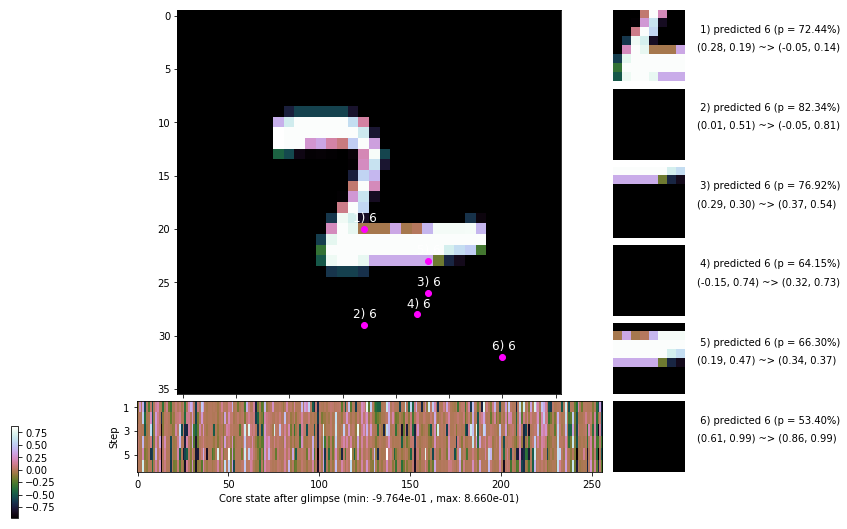

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


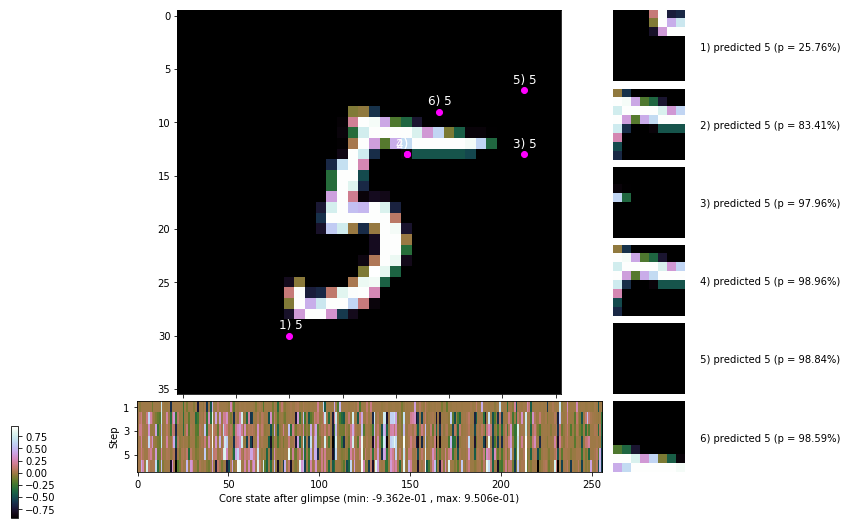


	Target class: 0 | Discounted rewards: [-0.539, -0.389, 1.111, 1.110, 1.100, 1.000]


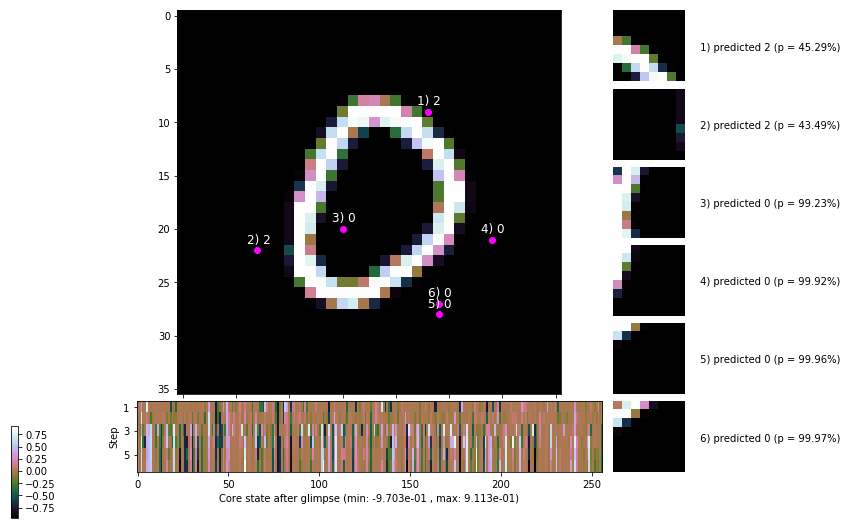

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


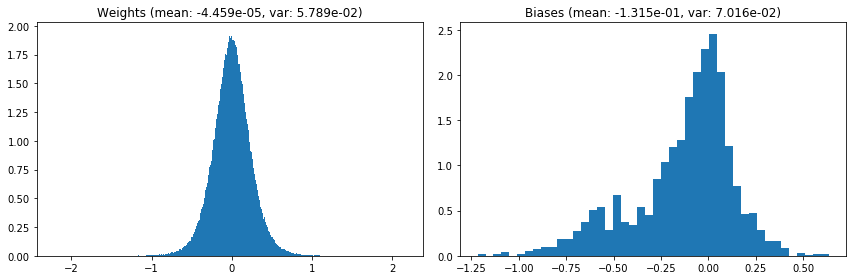

                                      Location network weights and biases


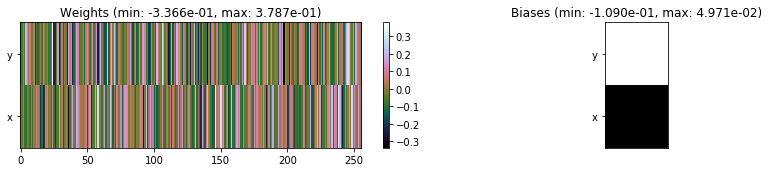

---------------------------------------------------------------------------------------------------------------
Elapsed time:  416.07 sec | TRAIN >> class loss: 0.2961 | steps:  2.234 :( | reward:  3.7295 :( | acc.: 90.328% :(
                          | VAL   >> class loss: 0.2620 | steps:  2.097 :( | reward:  3.9765 :( | acc.: 91.200% :(


Epoch  27/400) lr = 0.0006769
 b    300/  3000 >> 136.4 ms/b | lr: 6.76e-04 | grad 2norm: 11.42 | grad inf norm:  2.825
         Weights || abs max:  2.22 (45717.31) | mean: -4.54e-05 ( 0.09) | var: 5.79e-02 (888449.62)
          Biases || abs max:  1.22 (  118.58) | mean: -1.32e-01 ( 0.11) | var: 7.04e-02 (  161.30)
                    class loss: 0.294 | steps: 2.240 | reward:  3.735 | acc.: 90.50%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.6 ms/b | lr: 6.76e-04 | grad 2norm: 11.26 | grad inf norm:  2.847
         Weights || abs max:  2.23 ( 6318.81) | mean: -3.18e-05 

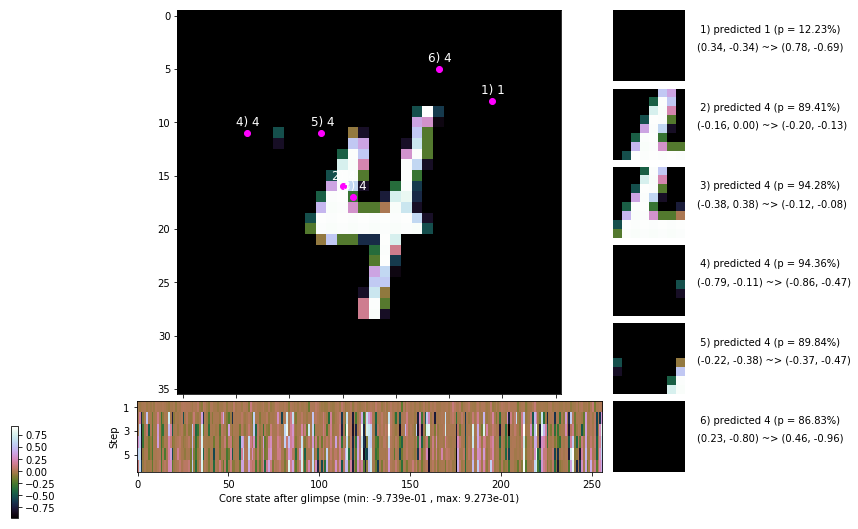

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.1 ms/b | lr: 6.74e-04 | grad 2norm: 11.00 | grad inf norm:  2.715
         Weights || abs max:  2.24 ( 2237.16) | mean: -5.60e-05 ( 0.01) | var: 5.82e-02 (   42.73)
          Biases || abs max:  1.21 (  147.92) | mean: -1.31e-01 ( 0.11) | var: 7.06e-02 (  208.60)
                    class loss: 0.259 | steps: 2.215 | reward:  3.797 | acc.: 91.28%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 138.1 ms/b | lr: 6.74e-04 | grad 2norm: 11.18 | grad inf norm:  2.717
         Weights || abs max:  2.24 ( 3368.05) | mean: -6.17e-05 ( 0.02) | var: 5.83e-02 (  180.27)
          Biases || abs max:  1.20 (  125.62) | mean: -1.31e-01 ( 0.11) | var: 7.06e-02 (  108.54)
                    class loss: 0.269 | steps: 2.227 | reward:  3.767 | acc.: 91.03%

	Target class: 9 | Discounted rewards: [-0.539, -0.389, 1

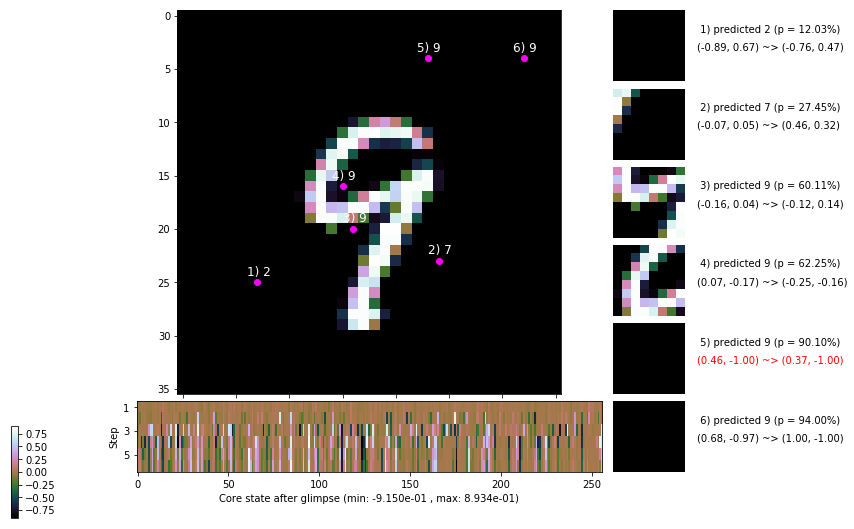

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 139.2 ms/b | lr: 6.72e-04 | grad 2norm: 11.50 | grad inf norm:  2.771
         Weights || abs max:  2.24 ( 3053.75) | mean: -6.72e-05 ( 0.02) | var: 5.84e-02 (  267.84)
          Biases || abs max:  1.21 (   61.73) | mean: -1.31e-01 ( 0.08) | var: 7.09e-02 (   10.89)
                    class loss: 0.302 | steps: 2.259 | reward:  3.696 | acc.: 90.02%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 136.3 ms/b | lr: 6.72e-04 | grad 2norm: 11.13 | grad inf norm:  2.754
         Weights || abs max:  2.25 ( 5823.24) | mean: -6.97e-05 ( 0.02) | var: 5.85e-02 (  900.22)
          Biases || abs max:  1.21 (  126.93) | mean: -1.32e-01 ( 0.12) | var: 7.11e-02 (   95.03)
                    class loss: 0.279 | steps: 2.236 | reward:  3.751 | acc.: 91.05%

	Target class: 0 | Discounted rewards: [-0.389, 1.111, 1.

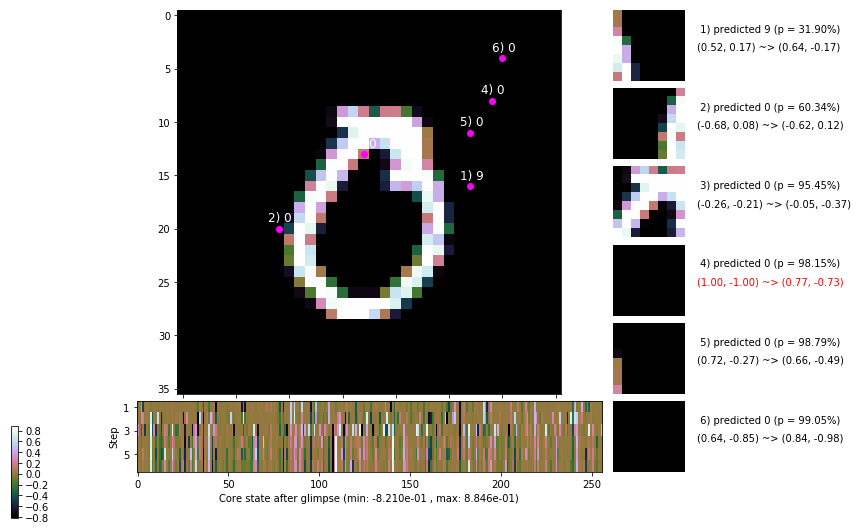

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 137.7 ms/b | lr: 6.70e-04 | grad 2norm: 11.29 | grad inf norm:  2.680
         Weights || abs max:  2.24 ( 2670.57) | mean: -5.11e-05 ( 0.01) | var: 5.86e-02 (   95.69)
          Biases || abs max:  1.21 (  220.01) | mean: -1.32e-01 ( 0.15) | var: 7.10e-02 ( 1581.58)
                    class loss: 0.271 | steps: 2.217 | reward:  3.787 | acc.: 91.48%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 134.5 ms/b | lr: 6.70e-04 | grad 2norm: 11.08 | grad inf norm:  2.655
         Weights || abs max:  2.24 ( 7541.41) | mean: -4.43e-05 ( 0.02) | var: 5.87e-02 (11111.94)
          Biases || abs max:  1.21 (  124.91) | mean: -1.32e-01 ( 0.11) | var: 7.10e-02 (  221.33)
                    class loss: 0.273 | steps: 2.225 | reward:  3.759 | acc.: 91.35%

	Target class: 6 | Discounted rewards: [0.959, -0.406, 0.

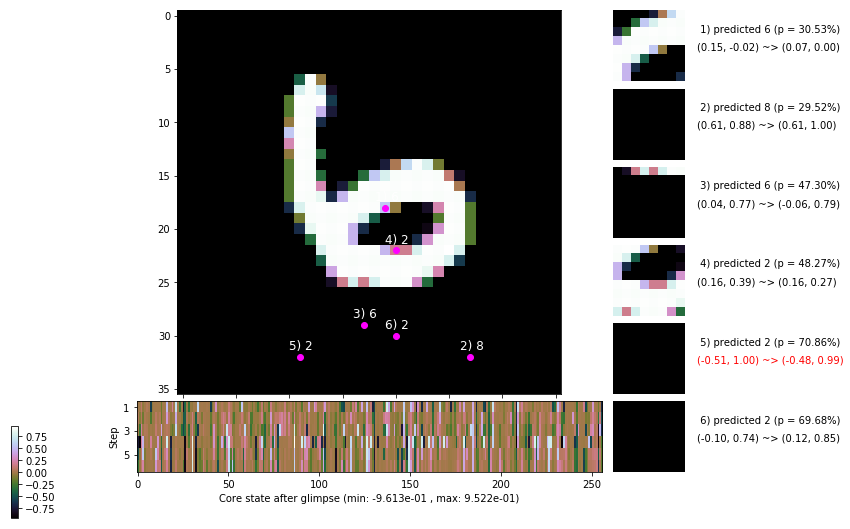

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 138.9 ms/b | lr: 6.68e-04 | grad 2norm: 11.17 | grad inf norm:  2.674
         Weights || abs max:  2.25 ( 2397.36) | mean: -4.97e-05 ( 0.01) | var: 5.88e-02 (  246.21)
          Biases || abs max:  1.22 (   83.92) | mean: -1.32e-01 ( 0.10) | var: 7.11e-02 (   36.55)
                    class loss: 0.269 | steps: 2.224 | reward:  3.777 | acc.: 91.45%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.4 ms/b | lr: 6.68e-04 | grad 2norm: 11.32 | grad inf norm:  2.908
         Weights || abs max:  2.25 ( 5160.92) | mean: -6.79e-05 ( 0.02) | var: 5.89e-02 ( 5297.56)
          Biases || abs max:  1.23 (  114.02) | mean: -1.32e-01 ( 0.10) | var: 7.14e-02 (  162.40)
                    class loss: 0.299 | steps: 2.247 | reward:  3.707 | acc.: 90.23%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

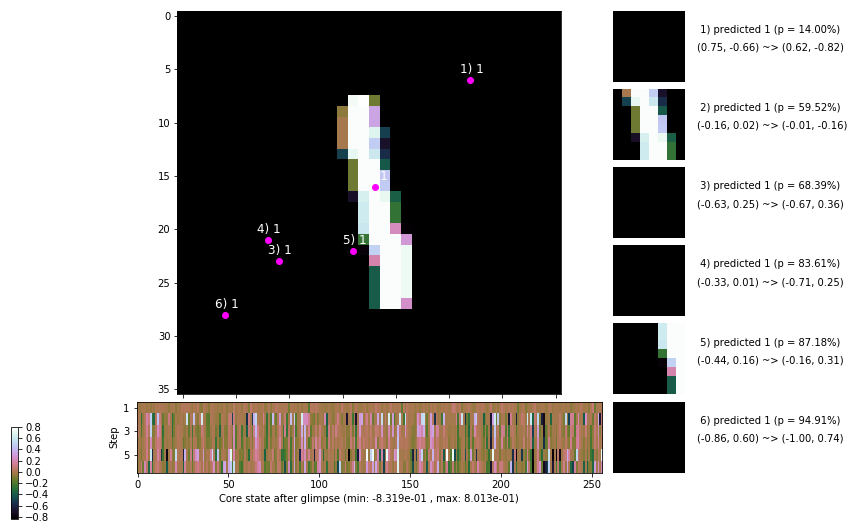

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.094, 0.944, -0.556, -0.555, -0.550, -0.500]


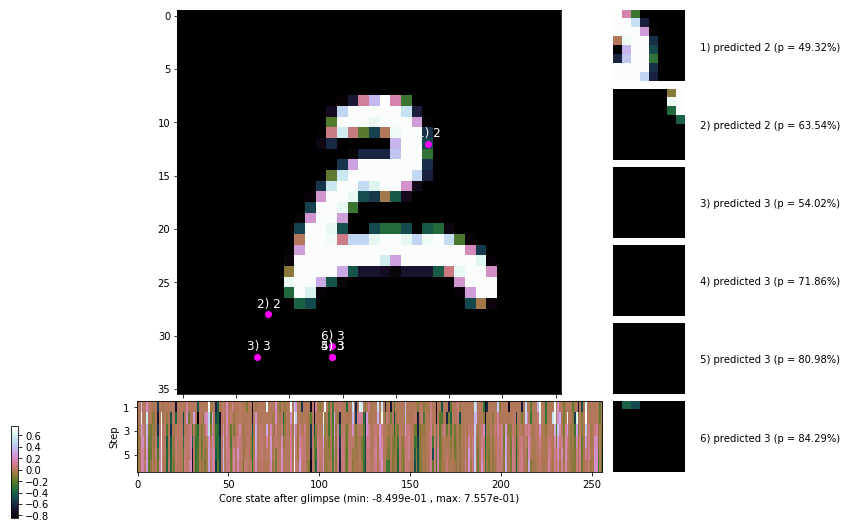


	Target class: 5 | Discounted rewards: [-0.404, 0.961, -0.389, 1.110, 1.100, 1.000]


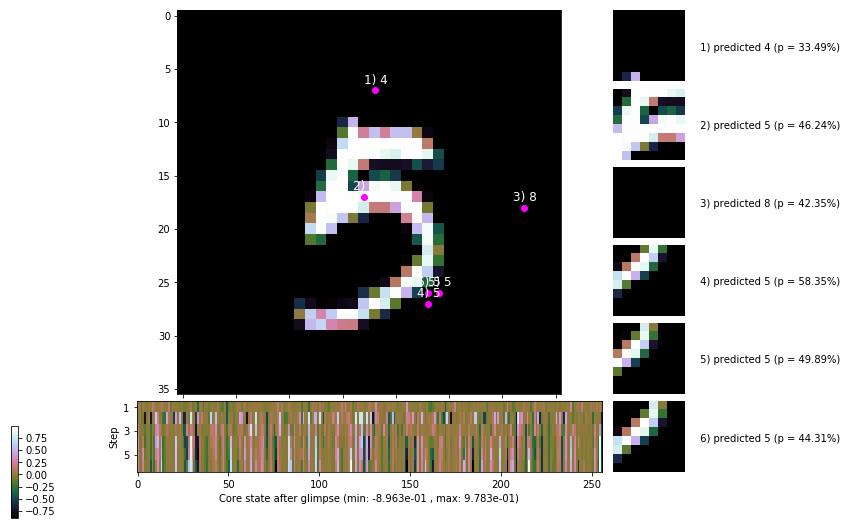

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


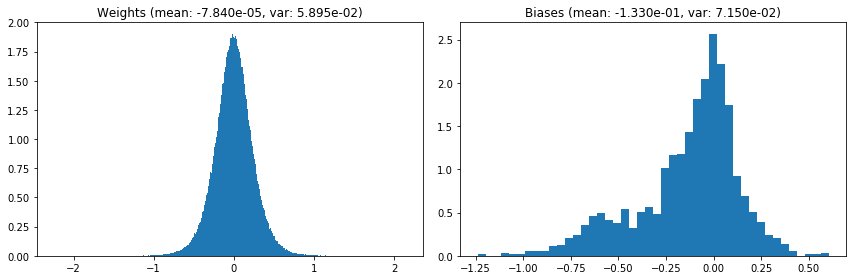

                                      Location network weights and biases


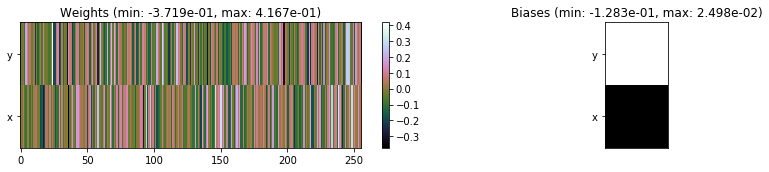

---------------------------------------------------------------------------------------------------------------
Elapsed time:  422.07 sec | TRAIN >> class loss: 0.2803 | steps:  2.232 :( | reward:  3.7536 :( | acc.: 90.892% :(
                          | VAL   >> class loss: 0.2668 | steps:  2.106 :( | reward:  3.9456 :( | acc.: 90.920% :(


Epoch  28/400) lr = 0.0006668
 b    300/  3000 >> 145.9 ms/b | lr: 6.66e-04 | grad 2norm: 11.12 | grad inf norm:  2.819
         Weights || abs max:  2.25 ( 1929.65) | mean: -5.20e-05 ( 0.01) | var: 5.90e-02 (   44.02)
          Biases || abs max:  1.24 (  117.14) | mean: -1.33e-01 ( 0.11) | var: 7.18e-02 (   87.72)
                    class loss: 0.300 | steps: 2.205 | reward:  3.763 | acc.: 90.35%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 140.2 ms/b | lr: 6.66e-04 | grad 2norm: 10.92 | grad inf norm:  2.654
         Weights || abs max:  2.26 (10397.65) | mean: -3.35e-05 (

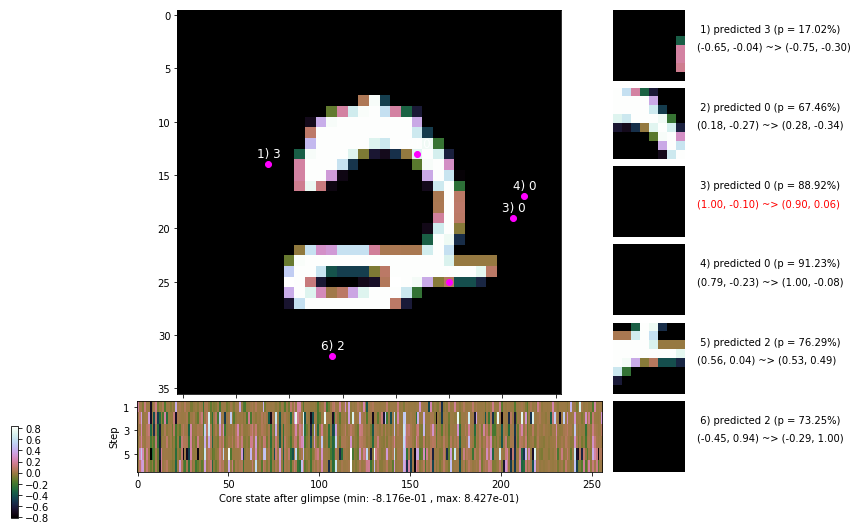

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 139.9 ms/b | lr: 6.64e-04 | grad 2norm: 11.52 | grad inf norm:  2.820
         Weights || abs max:  2.26 ( 2130.19) | mean: -6.64e-05 ( 0.01) | var: 5.92e-02 (  133.42)
          Biases || abs max:  1.22 (   91.75) | mean: -1.33e-01 ( 0.10) | var: 7.17e-02 (   26.50)
                    class loss: 0.296 | steps: 2.235 | reward:  3.720 | acc.: 90.27%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 137.5 ms/b | lr: 6.64e-04 | grad 2norm: 11.20 | grad inf norm:  2.815
         Weights || abs max:  2.27 ( 2705.30) | mean: -6.09e-05 ( 0.01) | var: 5.93e-02 (   99.42)
          Biases || abs max:  1.21 (   68.06) | mean: -1.34e-01 ( 0.09) | var: 7.18e-02 (   21.09)
                    class loss: 0.283 | steps: 2.252 | reward:  3.711 | acc.: 90.85%

	Target class: 9 | Discounted rewards: [1.111, 1.111, 1.1

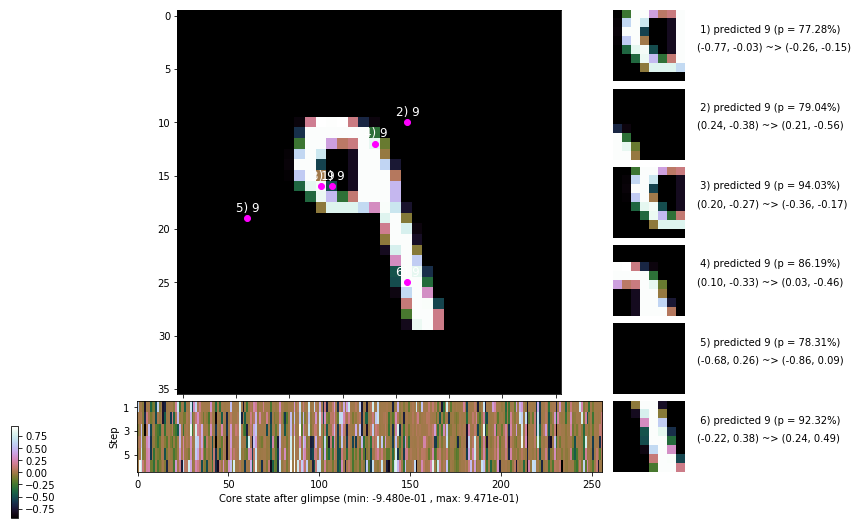

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 139.4 ms/b | lr: 6.62e-04 | grad 2norm: 11.10 | grad inf norm:  2.709
         Weights || abs max:  2.26 ( 2987.61) | mean: -3.56e-05 ( 0.02) | var: 5.94e-02 (  286.12)
          Biases || abs max:  1.21 (   95.12) | mean: -1.34e-01 ( 0.10) | var: 7.18e-02 (  163.95)
                    class loss: 0.291 | steps: 2.228 | reward:  3.751 | acc.: 90.57%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 143.9 ms/b | lr: 6.62e-04 | grad 2norm: 10.53 | grad inf norm:  2.494
         Weights || abs max:  2.26 ( 5476.30) | mean: -3.70e-05 ( 0.02) | var: 5.95e-02 ( 1422.51)
          Biases || abs max:  1.23 (   79.41) | mean: -1.34e-01 ( 0.09) | var: 7.20e-02 (   49.69)
                    class loss: 0.264 | steps: 2.205 | reward:  3.789 | acc.: 91.20%

	Target class: 5 | Discounted rewards: [-0.554, -0.539, -

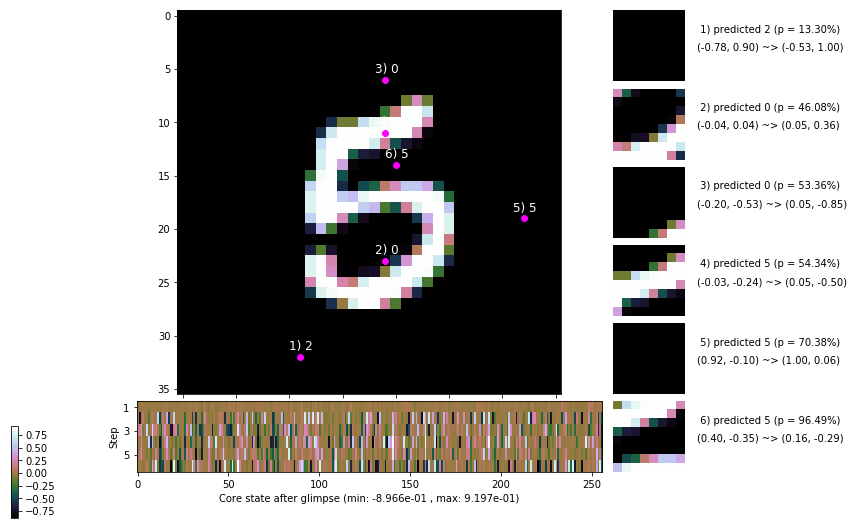

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 158.5 ms/b | lr: 6.60e-04 | grad 2norm: 11.17 | grad inf norm:  2.702
         Weights || abs max:  2.28 ( 5855.72) | mean: -6.73e-06 ( 0.02) | var: 5.96e-02 ( 5463.23)
          Biases || abs max:  1.23 (   58.33) | mean: -1.34e-01 ( 0.07) | var: 7.22e-02 (   18.96)
                    class loss: 0.285 | steps: 2.245 | reward:  3.735 | acc.: 90.90%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.3 ms/b | lr: 6.60e-04 | grad 2norm: 11.08 | grad inf norm:  2.664
         Weights || abs max:  2.28 ( 3531.34) | mean: -6.51e-06 ( 0.02) | var: 5.97e-02 (  468.52)
          Biases || abs max:  1.23 (  275.74) | mean: -1.33e-01 ( 0.17) | var: 7.22e-02 ( 3112.76)
                    class loss: 0.268 | steps: 2.213 | reward:  3.786 | acc.: 91.25%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

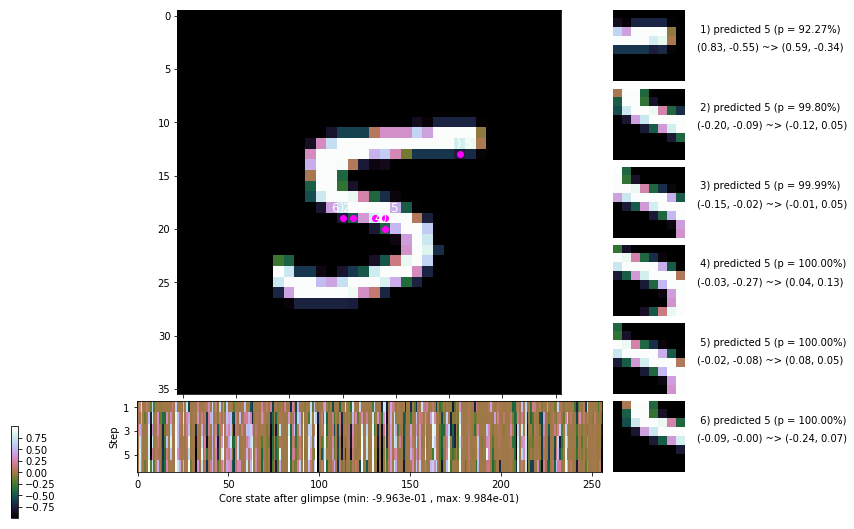

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 139.0 ms/b | lr: 6.58e-04 | grad 2norm: 10.93 | grad inf norm:  2.738
         Weights || abs max:  2.28 ( 4865.42) | mean: -1.11e-05 ( 0.02) | var: 5.98e-02 (  927.63)
          Biases || abs max:  1.23 ( 1186.80) | mean: -1.33e-01 ( 0.52) | var: 7.24e-02 (144635.72)
                    class loss: 0.274 | steps: 2.233 | reward:  3.769 | acc.: 91.38%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 137.5 ms/b | lr: 6.58e-04 | grad 2norm: 11.11 | grad inf norm:  2.823
         Weights || abs max:  2.29 (18982.41) | mean:  3.49e-06 ( 0.05) | var: 5.99e-02 (89988.29)
          Biases || abs max:  1.24 (   54.08) | mean: -1.34e-01 ( 0.08) | var: 7.26e-02 (    8.52)
                    class loss: 0.283 | steps: 2.227 | reward:  3.744 | acc.: 90.87%

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1

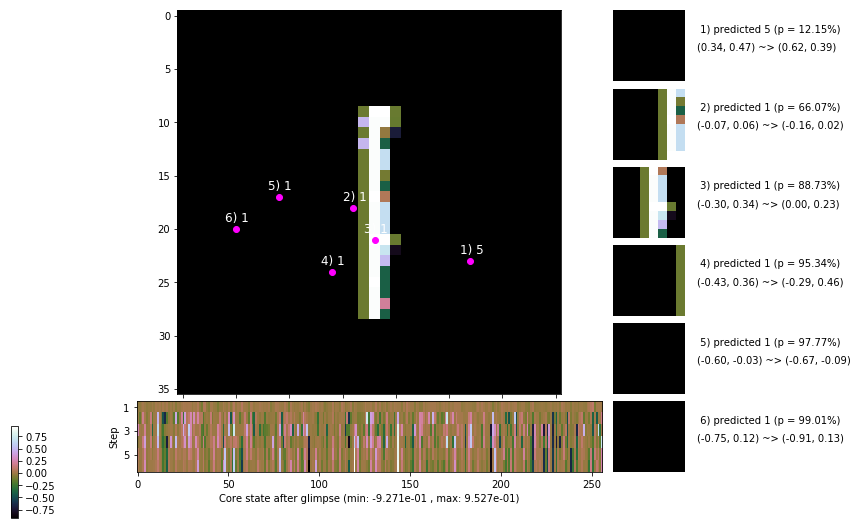

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


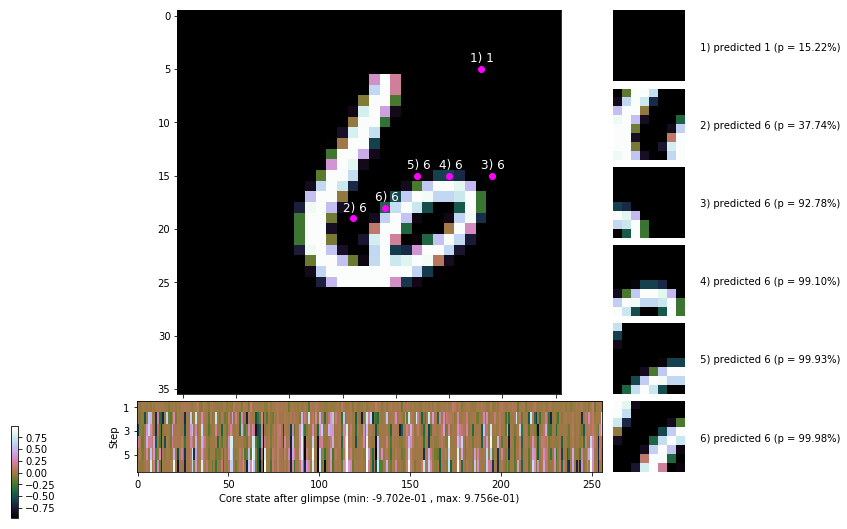


	Target class: 8 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


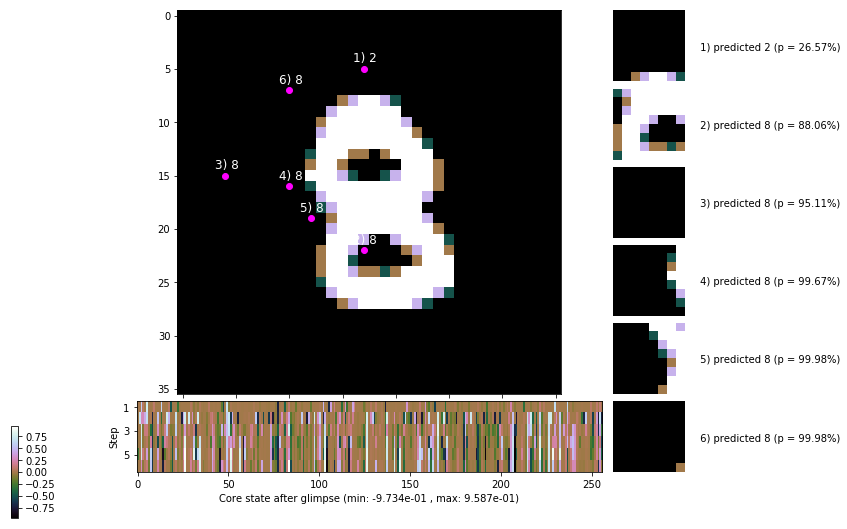

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


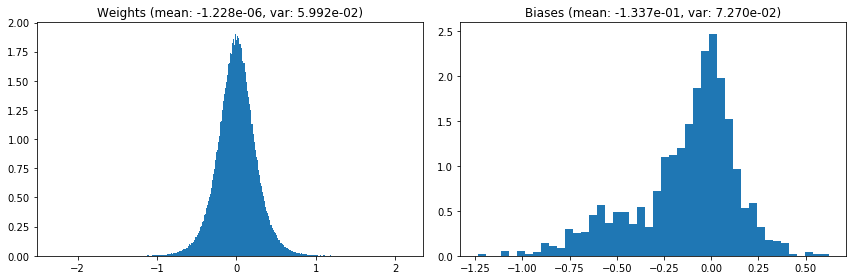

                                      Location network weights and biases


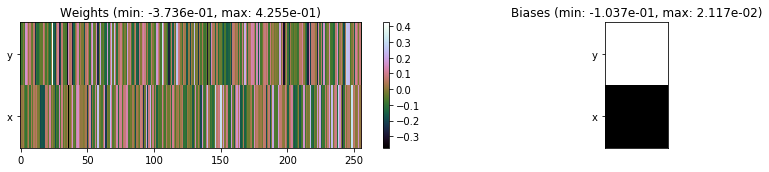

---------------------------------------------------------------------------------------------------------------
Elapsed time:  426.99 sec | TRAIN >> class loss: 0.2829 | steps:  2.226 :( | reward:  3.7546 :( | acc.: 90.832% :(
                          | VAL   >> class loss: 0.2405 | steps:  2.110 :( | reward:  3.9930 :( | acc.: 92.100% :(


Epoch  29/400) lr = 0.0006569
 b    300/  3000 >> 138.5 ms/b | lr: 6.56e-04 | grad 2norm: 10.86 | grad inf norm:  2.678
         Weights || abs max:  2.31 ( 2662.19) | mean: -1.89e-05 ( 0.01) | var: 6.00e-02 (  126.33)
          Biases || abs max:  1.24 (  206.22) | mean: -1.34e-01 ( 0.14) | var: 7.28e-02 (  638.71)
                    class loss: 0.272 | steps: 2.208 | reward:  3.804 | acc.: 91.18%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 136.6 ms/b | lr: 6.56e-04 | grad 2norm: 10.94 | grad inf norm:  2.744
         Weights || abs max:  2.32 ( 9719.32) | mean: -4.48e-05 (

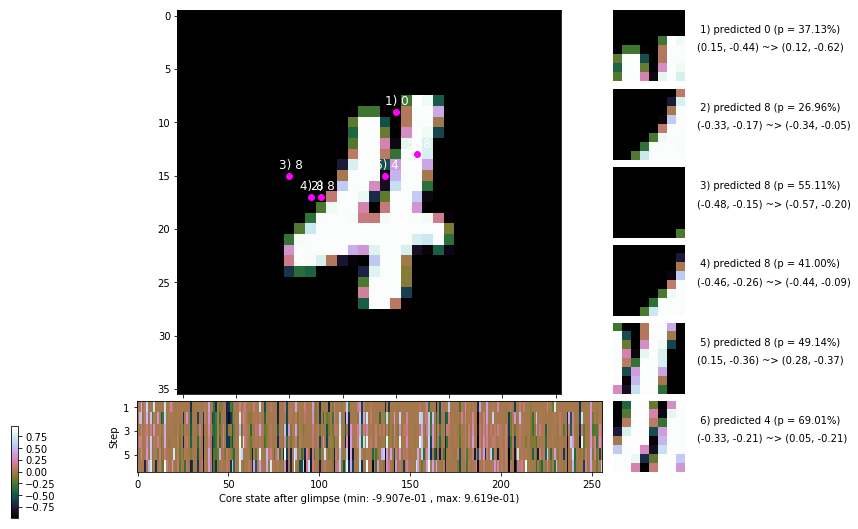

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 140.1 ms/b | lr: 6.54e-04 | grad 2norm: 11.05 | grad inf norm:  2.722
         Weights || abs max:  2.32 ( 4878.88) | mean: -5.49e-05 ( 0.02) | var: 6.02e-02 ( 3031.71)
          Biases || abs max:  1.24 (  102.42) | mean: -1.34e-01 ( 0.11) | var: 7.31e-02 (   42.45)
                    class loss: 0.270 | steps: 2.231 | reward:  3.787 | acc.: 91.35%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.0 ms/b | lr: 6.54e-04 | grad 2norm: 11.00 | grad inf norm:  2.783
         Weights || abs max:  2.32 ( 2710.89) | mean: -6.80e-05 ( 0.01) | var: 6.03e-02 (   98.40)
          Biases || abs max:  1.24 (  307.46) | mean: -1.34e-01 ( 0.24) | var: 7.31e-02 ( 6435.58)
                    class loss: 0.268 | steps: 2.207 | reward:  3.791 | acc.: 91.10%

	Target class: 7 | Discounted rewards: [-0.539, -0.389, 1

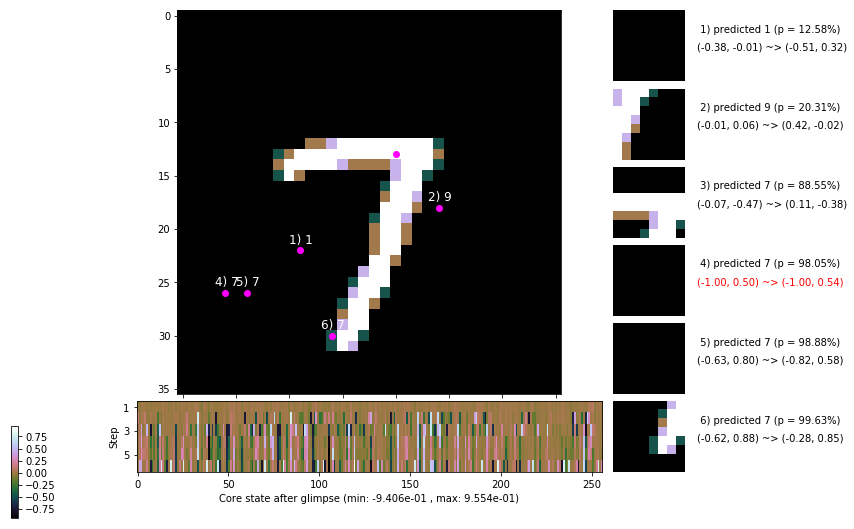

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 140.7 ms/b | lr: 6.52e-04 | grad 2norm: 11.42 | grad inf norm:  2.820
         Weights || abs max:  2.32 ( 3447.25) | mean: -8.95e-05 ( 0.02) | var: 6.04e-02 (  279.17)
          Biases || abs max:  1.24 (   66.17) | mean: -1.34e-01 ( 0.08) | var: 7.32e-02 (   23.20)
                    class loss: 0.272 | steps: 2.203 | reward:  3.787 | acc.: 91.05%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 139.3 ms/b | lr: 6.52e-04 | grad 2norm: 11.23 | grad inf norm:  2.676
         Weights || abs max:  2.33 ( 3019.42) | mean: -9.40e-05 ( 0.01) | var: 6.05e-02 (  188.24)
          Biases || abs max:  1.24 (   38.00) | mean: -1.34e-01 ( 0.07) | var: 7.32e-02 (    3.55)
                    class loss: 0.275 | steps: 2.224 | reward:  3.757 | acc.: 90.65%

	Target class: 4 | Discounted rewards: [-0.389, 1.111, 1.

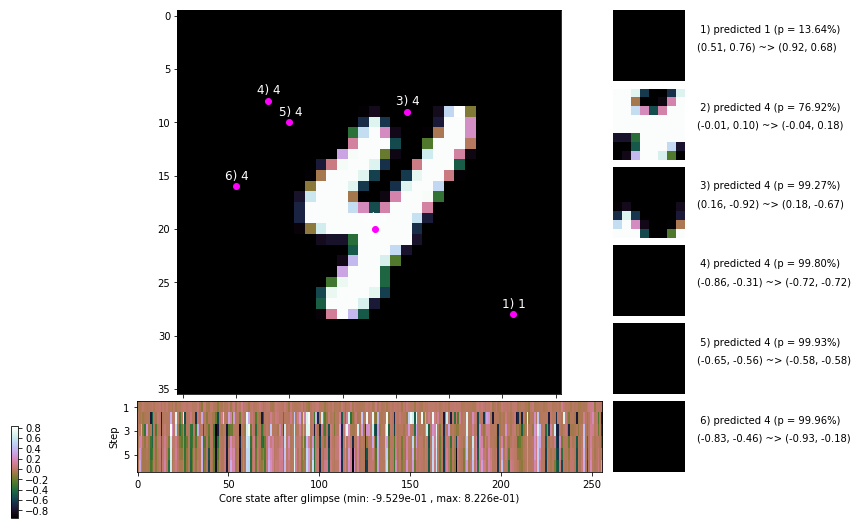

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 139.3 ms/b | lr: 6.50e-04 | grad 2norm: 11.10 | grad inf norm:  2.795
         Weights || abs max:  2.33 ( 6304.48) | mean: -9.68e-05 ( 0.02) | var: 6.06e-02 ( 2606.16)
          Biases || abs max:  1.25 (   70.65) | mean: -1.35e-01 ( 0.09) | var: 7.35e-02 (   23.80)
                    class loss: 0.276 | steps: 2.213 | reward:  3.795 | acc.: 91.00%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.0 ms/b | lr: 6.50e-04 | grad 2norm: 11.32 | grad inf norm:  2.867
         Weights || abs max:  2.33 (27716.96) | mean: -1.16e-04 ( 0.06) | var: 6.07e-02 (314134.75)
          Biases || abs max:  1.26 (   76.59) | mean: -1.35e-01 ( 0.08) | var: 7.39e-02 (   33.57)
                    class loss: 0.283 | steps: 2.233 | reward:  3.757 | acc.: 90.67%

	Target class: 0 | Discounted rewards: [-0.539, -0.389, 

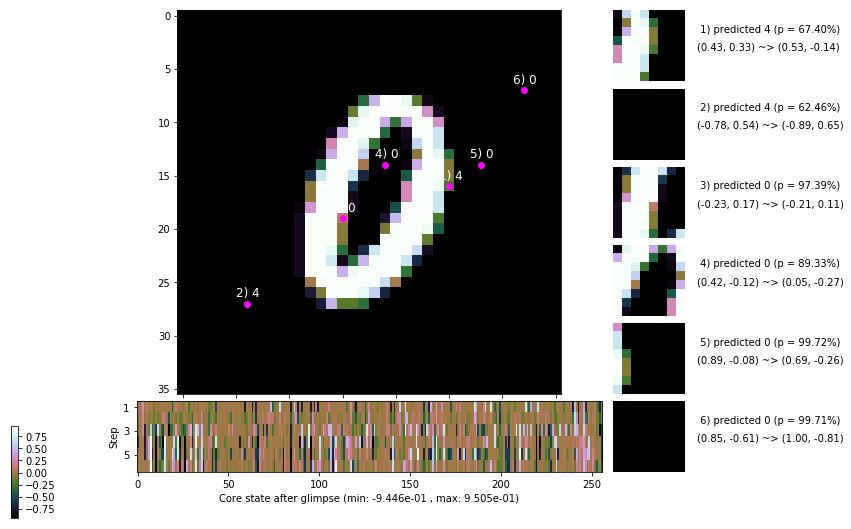

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 140.0 ms/b | lr: 6.48e-04 | grad 2norm: 11.05 | grad inf norm:  2.765
         Weights || abs max:  2.33 ( 4805.62) | mean: -1.32e-04 ( 0.02) | var: 6.08e-02 (  584.47)
          Biases || abs max:  1.27 (  108.91) | mean: -1.35e-01 ( 0.11) | var: 7.41e-02 (   89.80)
                    class loss: 0.266 | steps: 2.212 | reward:  3.784 | acc.: 90.92%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.0 ms/b | lr: 6.48e-04 | grad 2norm: 11.22 | grad inf norm:  2.721
         Weights || abs max:  2.34 ( 8362.74) | mean: -1.07e-04 ( 0.03) | var: 6.09e-02 ( 8077.68)
          Biases || abs max:  1.27 (  112.89) | mean: -1.35e-01 ( 0.10) | var: 7.42e-02 (  280.29)
                    class loss: 0.269 | steps: 2.218 | reward:  3.770 | acc.: 91.52%

	Target class: 0 | Discounted rewards: [-0.556, -0.555, -

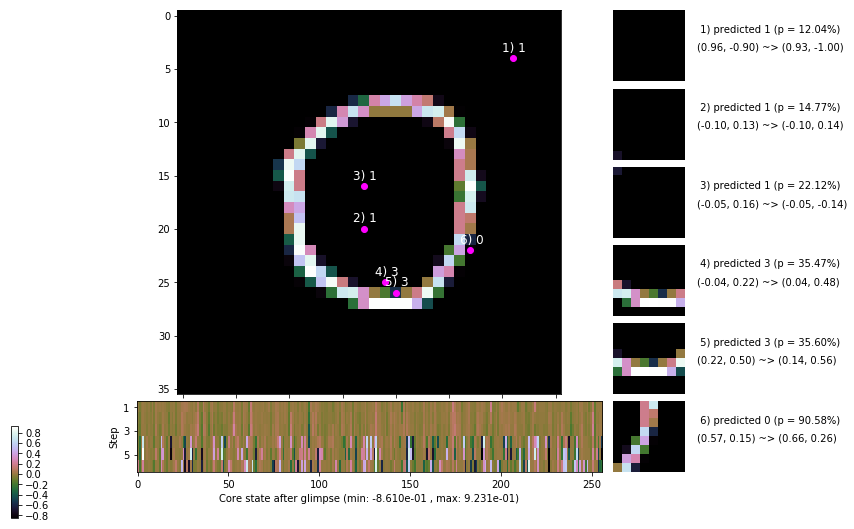

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


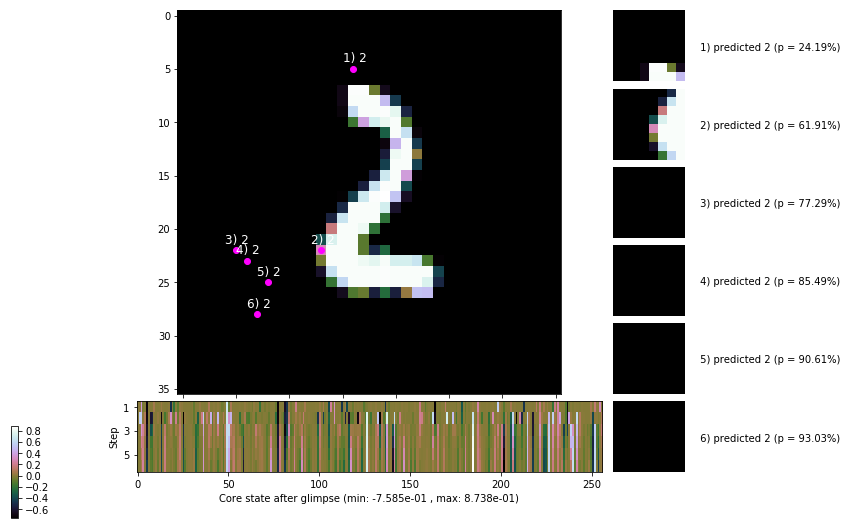


	Target class: 0 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


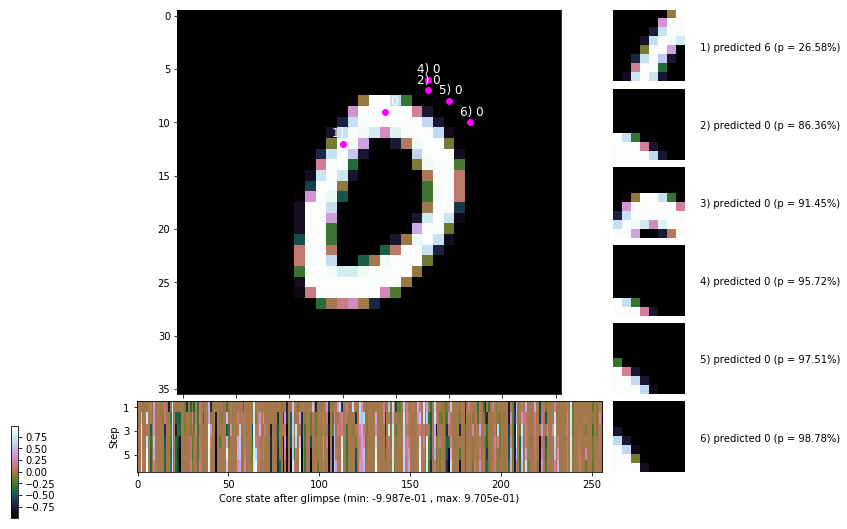

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


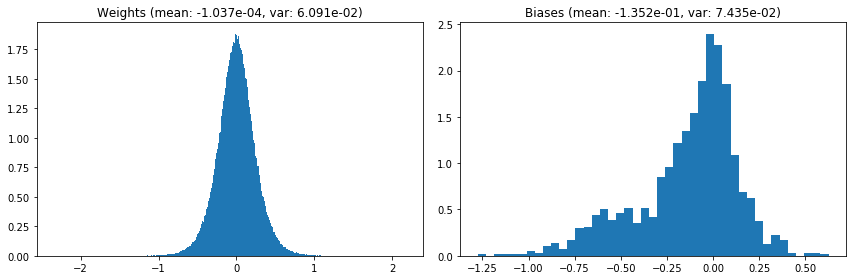

                                      Location network weights and biases


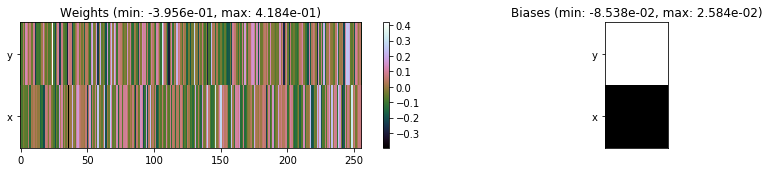

---------------------------------------------------------------------------------------------------------------
Elapsed time:  419.75 sec | TRAIN >> class loss: 0.2724 | steps:  2.215    | reward:  3.7818    | acc.: 91.033% :(
                          | VAL   >> class loss: 0.2451 | steps:  2.119 :( | reward:  3.9558 :( | acc.: 91.580% :(


Epoch  30/400) lr = 0.0006471
 b    300/  3000 >> 149.3 ms/b | lr: 6.46e-04 | grad 2norm: 10.94 | grad inf norm:  2.619
         Weights || abs max:  2.34 ( 2115.31) | mean: -1.13e-04 ( 0.01) | var: 6.10e-02 (   49.80)
          Biases || abs max:  1.27 (   75.30) | mean: -1.35e-01 ( 0.09) | var: 7.41e-02 (   24.52)
                    class loss: 0.270 | steps: 2.212 | reward:  3.795 | acc.: 91.03%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.6 ms/b | lr: 6.46e-04 | grad 2norm: 10.78 | grad inf norm:  2.671
         Weights || abs max:  2.34 ( 2895.04) | mean: -1.41e-04 (

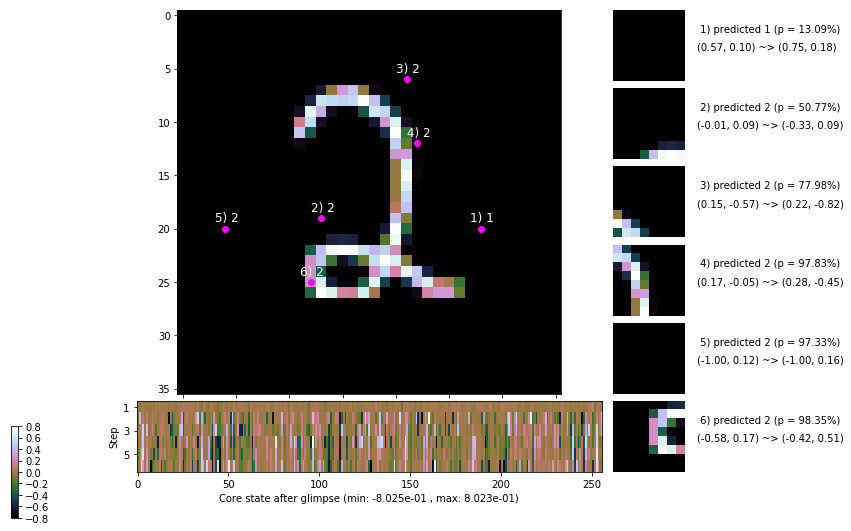

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.2 ms/b | lr: 6.45e-04 | grad 2norm: 11.07 | grad inf norm:  2.678
         Weights || abs max:  2.34 ( 3791.64) | mean: -1.24e-04 ( 0.02) | var: 6.12e-02 (  563.51)
          Biases || abs max:  1.28 (  431.34) | mean: -1.36e-01 ( 0.24) | var: 7.43e-02 ( 9404.90)
                    class loss: 0.278 | steps: 2.208 | reward:  3.803 | acc.: 91.23%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 140.6 ms/b | lr: 6.44e-04 | grad 2norm: 10.96 | grad inf norm:  2.679
         Weights || abs max:  2.33 ( 5570.66) | mean: -1.33e-04 ( 0.02) | var: 6.13e-02 ( 1976.41)
          Biases || abs max:  1.27 (  245.18) | mean: -1.36e-01 ( 0.16) | var: 7.45e-02 ( 1274.41)
                    class loss: 0.281 | steps: 2.217 | reward:  3.762 | acc.: 90.42%

	Target class: 3 | Discounted rewards: [1.111, 1.111, 1.1

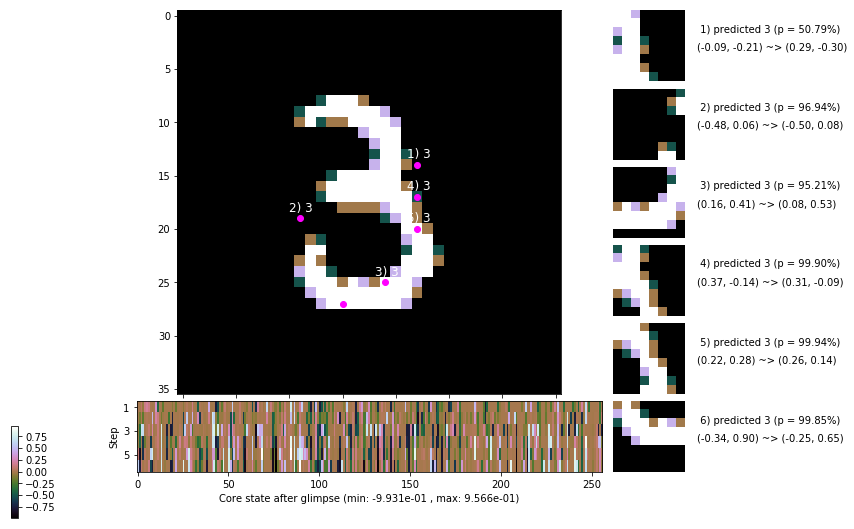

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 141.9 ms/b | lr: 6.43e-04 | grad 2norm: 10.84 | grad inf norm:  2.722
         Weights || abs max:  2.34 ( 2565.42) | mean: -1.52e-04 ( 0.01) | var: 6.13e-02 (  106.97)
          Biases || abs max:  1.27 (   89.68) | mean: -1.36e-01 ( 0.10) | var: 7.47e-02 (   34.07)
                    class loss: 0.272 | steps: 2.233 | reward:  3.744 | acc.: 91.08%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.7 ms/b | lr: 6.42e-04 | grad 2norm: 11.24 | grad inf norm:  2.781
         Weights || abs max:  2.36 ( 3516.25) | mean: -1.65e-04 ( 0.02) | var: 6.14e-02 (  230.59)
          Biases || abs max:  1.28 (  121.01) | mean: -1.36e-01 ( 0.10) | var: 7.50e-02 (  175.90)
                    class loss: 0.287 | steps: 2.245 | reward:  3.725 | acc.: 90.47%

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.1

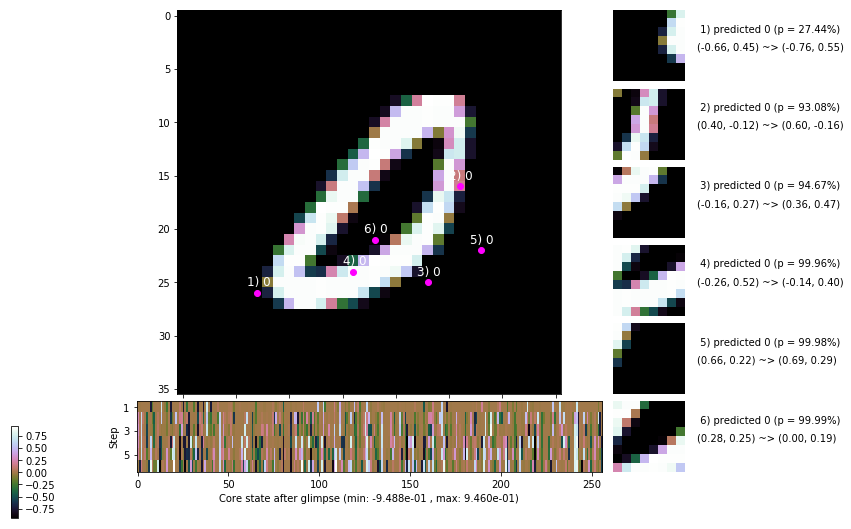

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.0 ms/b | lr: 6.41e-04 | grad 2norm: 11.06 | grad inf norm:  2.792
         Weights || abs max:  2.36 ( 2484.68) | mean: -1.65e-04 ( 0.01) | var: 6.15e-02 (  165.44)
          Biases || abs max:  1.28 (   62.21) | mean: -1.36e-01 ( 0.07) | var: 7.52e-02 (   13.35)
                    class loss: 0.274 | steps: 2.222 | reward:  3.758 | acc.: 90.98%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 142.2 ms/b | lr: 6.40e-04 | grad 2norm: 11.05 | grad inf norm:  2.703
         Weights || abs max:  2.37 ( 4418.67) | mean: -1.51e-04 ( 0.02) | var: 6.16e-02 ( 1792.17)
          Biases || abs max:  1.27 (   85.52) | mean: -1.36e-01 ( 0.09) | var: 7.54e-02 (   63.39)
                    class loss: 0.278 | steps: 2.238 | reward:  3.756 | acc.: 90.98%

	Target class: 2 | Discounted rewards: [-0.389, 1.111, 1.

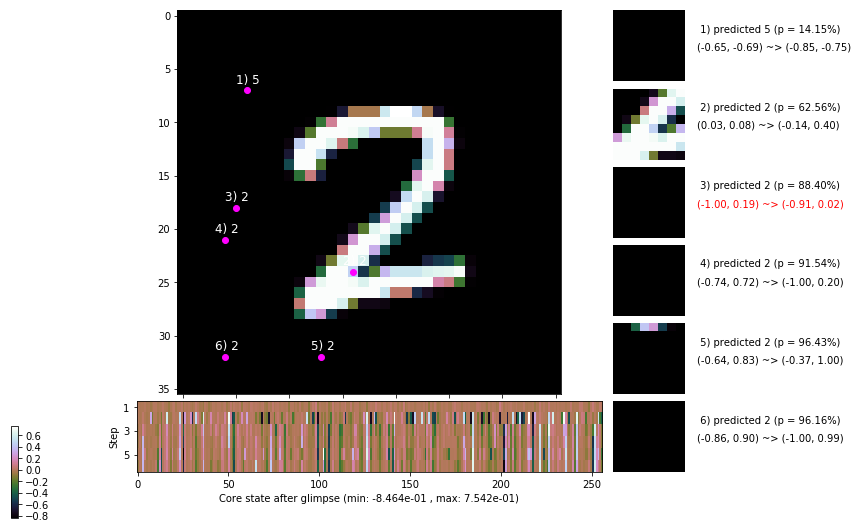

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.2 ms/b | lr: 6.39e-04 | grad 2norm: 11.13 | grad inf norm:  2.820
         Weights || abs max:  2.38 ( 4552.51) | mean: -1.59e-04 ( 0.02) | var: 6.17e-02 (  800.50)
          Biases || abs max:  1.27 (  134.11) | mean: -1.36e-01 ( 0.12) | var: 7.54e-02 (  192.49)
                    class loss: 0.286 | steps: 2.232 | reward:  3.755 | acc.: 90.83%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.8 ms/b | lr: 6.38e-04 | grad 2norm: 10.91 | grad inf norm:  2.827
         Weights || abs max:  2.40 ( 4270.71) | mean: -1.84e-04 ( 0.02) | var: 6.18e-02 (  826.64)
          Biases || abs max:  1.26 (  215.40) | mean: -1.37e-01 ( 0.15) | var: 7.57e-02 ( 1548.37)
                    class loss: 0.283 | steps: 2.216 | reward:  3.780 | acc.: 90.47%

	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1.

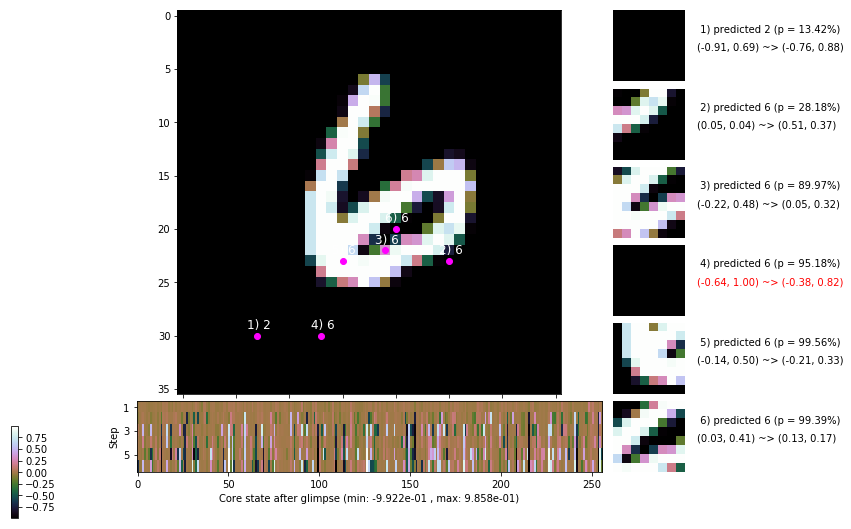

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.961, -0.390, 1.096, 0.960, -0.400, 1.000]


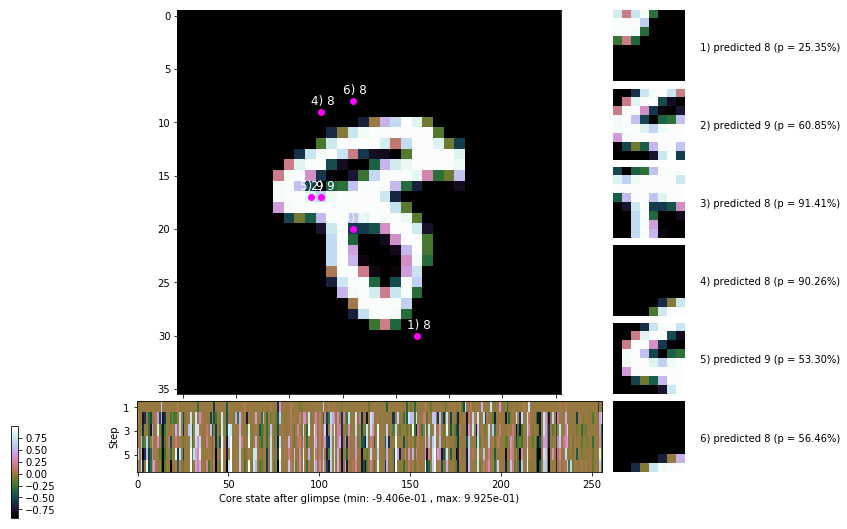


	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


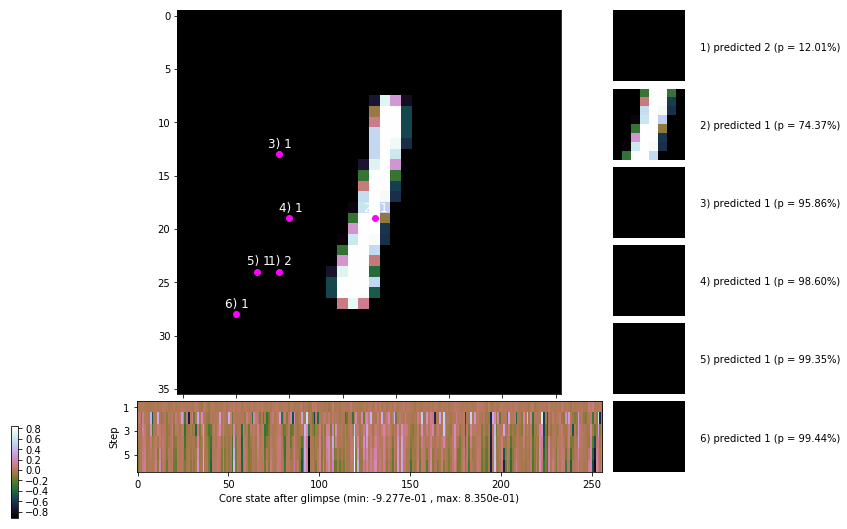

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


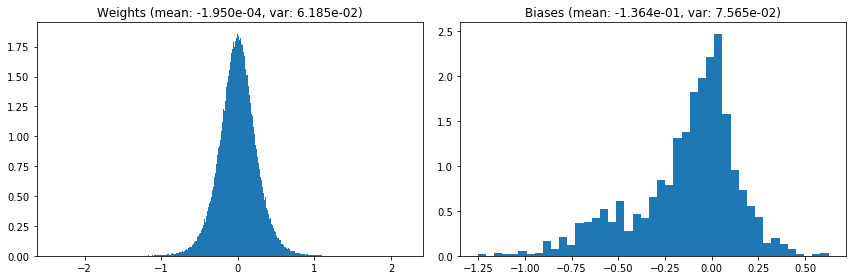

                                      Location network weights and biases


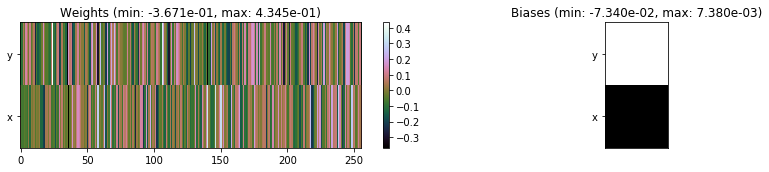

---------------------------------------------------------------------------------------------------------------
Elapsed time:  428.23 sec | TRAIN >> class loss: 0.2769 | steps:  2.223 :( | reward:  3.7663 :( | acc.: 90.933% :(
                          | VAL   >> class loss: 0.3025 | steps:  2.174 :( | reward:  3.8454 :( | acc.: 89.400% :(


Epoch  31/400) lr = 0.0006375
 b    300/  3000 >> 140.6 ms/b | lr: 6.37e-04 | grad 2norm: 10.67 | grad inf norm:  2.743
         Weights || abs max:  2.40 ( 2974.49) | mean: -1.89e-04 ( 0.01) | var: 6.19e-02 (  182.63)
          Biases || abs max:  1.25 (  352.05) | mean: -1.37e-01 ( 0.20) | var: 7.56e-02 ( 2795.38)
                    class loss: 0.285 | steps: 2.235 | reward:  3.748 | acc.: 90.47%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 141.7 ms/b | lr: 6.36e-04 | grad 2norm: 10.69 | grad inf norm:  2.692
         Weights || abs max:  2.39 ( 4918.52) | mean: -1.74e-04 (

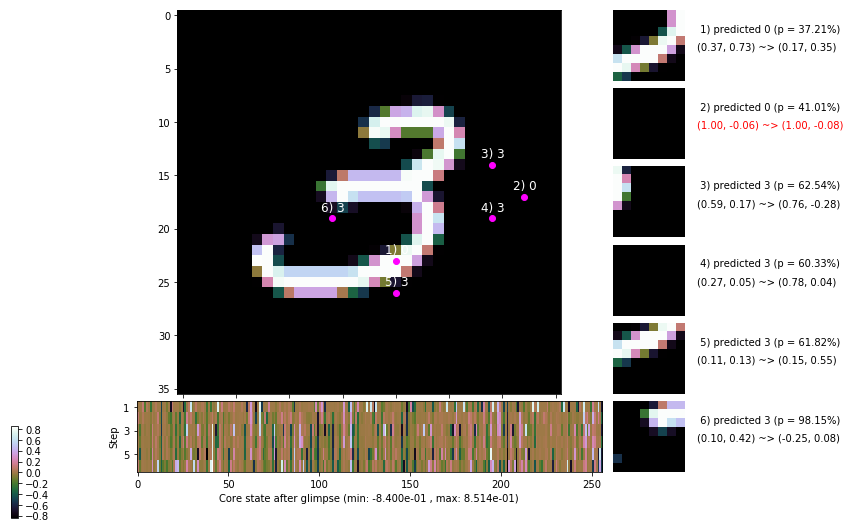

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.7 ms/b | lr: 6.35e-04 | grad 2norm: 11.14 | grad inf norm:  2.870
         Weights || abs max:  2.39 ( 6820.18) | mean: -1.73e-04 ( 0.02) | var: 6.21e-02 ( 6582.41)
          Biases || abs max:  1.26 (  285.83) | mean: -1.37e-01 ( 0.17) | var: 7.63e-02 ( 2507.12)
                    class loss: 0.308 | steps: 2.258 | reward:  3.675 | acc.: 89.68%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.5 ms/b | lr: 6.34e-04 | grad 2norm: 11.01 | grad inf norm:  2.726
         Weights || abs max:  2.39 ( 3908.63) | mean: -1.49e-04 ( 0.02) | var: 6.21e-02 (  675.03)
          Biases || abs max:  1.27 (  292.87) | mean: -1.38e-01 ( 0.17) | var: 7.68e-02 ( 3457.43)
                    class loss: 0.302 | steps: 2.237 | reward:  3.734 | acc.: 90.22%

	Target class: 0 | Discounted rewards: [-0.539, -0.389, 1

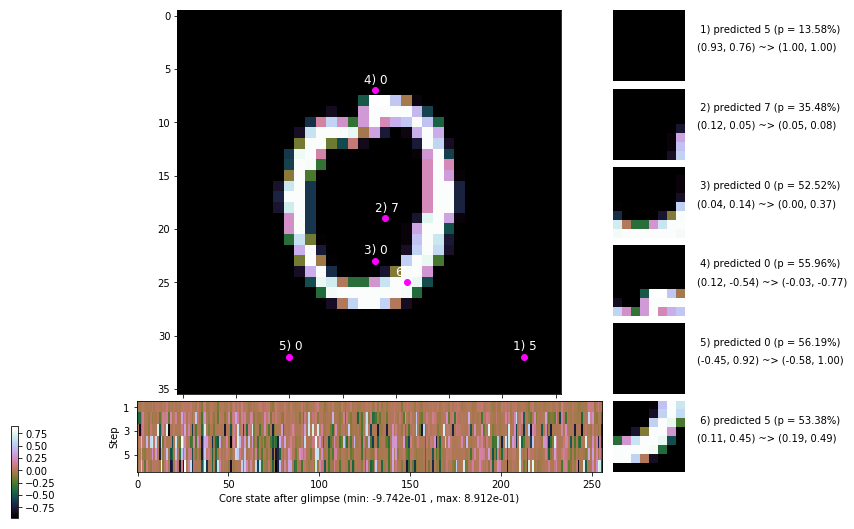

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 151.4 ms/b | lr: 6.33e-04 | grad 2norm: 11.03 | grad inf norm:  2.846
         Weights || abs max:  2.38 ( 8300.54) | mean: -9.61e-05 ( 0.02) | var: 6.22e-02 ( 3963.11)
          Biases || abs max:  1.28 (   80.73) | mean: -1.39e-01 ( 0.09) | var: 7.70e-02 (   46.80)
                    class loss: 0.287 | steps: 2.247 | reward:  3.723 | acc.: 90.62%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.8 ms/b | lr: 6.32e-04 | grad 2norm: 11.04 | grad inf norm:  2.742
         Weights || abs max:  2.40 ( 2195.88) | mean: -9.98e-05 ( 0.01) | var: 6.23e-02 (  100.19)
          Biases || abs max:  1.27 (  152.88) | mean: -1.39e-01 ( 0.12) | var: 7.71e-02 (  382.27)
                    class loss: 0.304 | steps: 2.261 | reward:  3.674 | acc.: 89.82%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

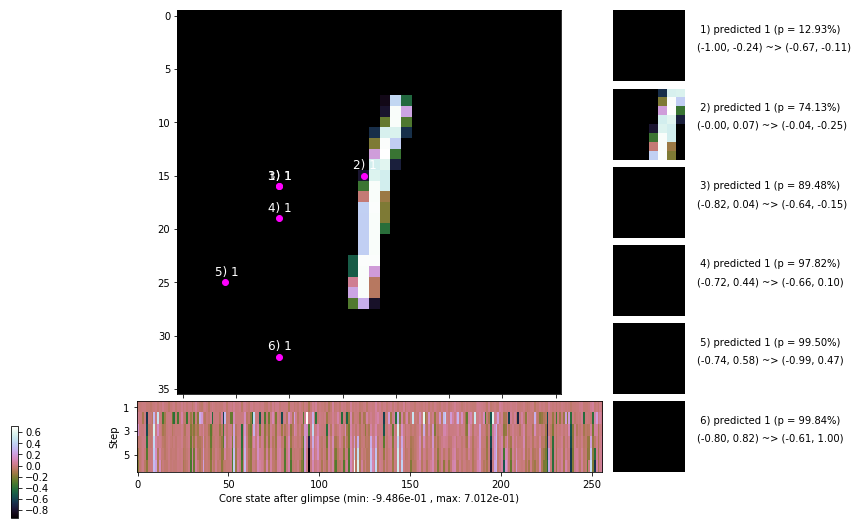

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 141.1 ms/b | lr: 6.31e-04 | grad 2norm: 10.94 | grad inf norm:  2.839
         Weights || abs max:  2.40 ( 3950.72) | mean: -8.00e-05 ( 0.02) | var: 6.24e-02 (  723.14)
          Biases || abs max:  1.28 (  140.86) | mean: -1.39e-01 ( 0.11) | var: 7.73e-02 (  348.53)
                    class loss: 0.291 | steps: 2.231 | reward:  3.738 | acc.: 90.53%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.9 ms/b | lr: 6.31e-04 | grad 2norm: 11.05 | grad inf norm:  2.726
         Weights || abs max:  2.41 (15477.99) | mean: -7.68e-05 ( 0.04) | var: 6.25e-02 (42168.75)
          Biases || abs max:  1.28 (   80.33) | mean: -1.39e-01 ( 0.09) | var: 7.75e-02 (  112.61)
                    class loss: 0.288 | steps: 2.229 | reward:  3.736 | acc.: 90.53%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

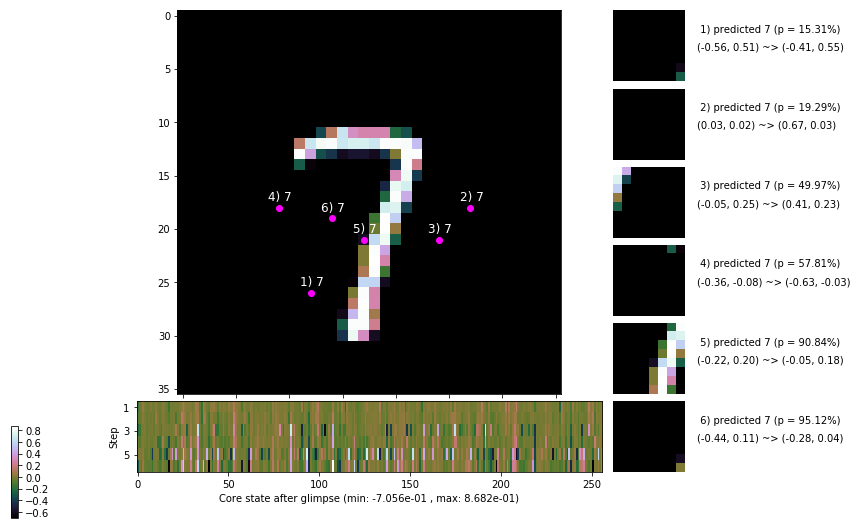

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 140.1 ms/b | lr: 6.29e-04 | grad 2norm: 10.99 | grad inf norm:  2.751
         Weights || abs max:  2.42 ( 3537.18) | mean: -1.13e-04 ( 0.02) | var: 6.26e-02 ( 1089.00)
          Biases || abs max:  1.29 (   77.30) | mean: -1.39e-01 ( 0.08) | var: 7.75e-02 (   22.10)
                    class loss: 0.290 | steps: 2.249 | reward:  3.701 | acc.: 89.85%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.1 ms/b | lr: 6.29e-04 | grad 2norm: 11.09 | grad inf norm:  2.775
         Weights || abs max:  2.42 ( 2737.38) | mean: -1.14e-04 ( 0.01) | var: 6.27e-02 (  137.56)
          Biases || abs max:  1.29 (  177.54) | mean: -1.39e-01 ( 0.14) | var: 7.76e-02 (  146.02)
                    class loss: 0.291 | steps: 2.234 | reward:  3.728 | acc.: 90.40%

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.1

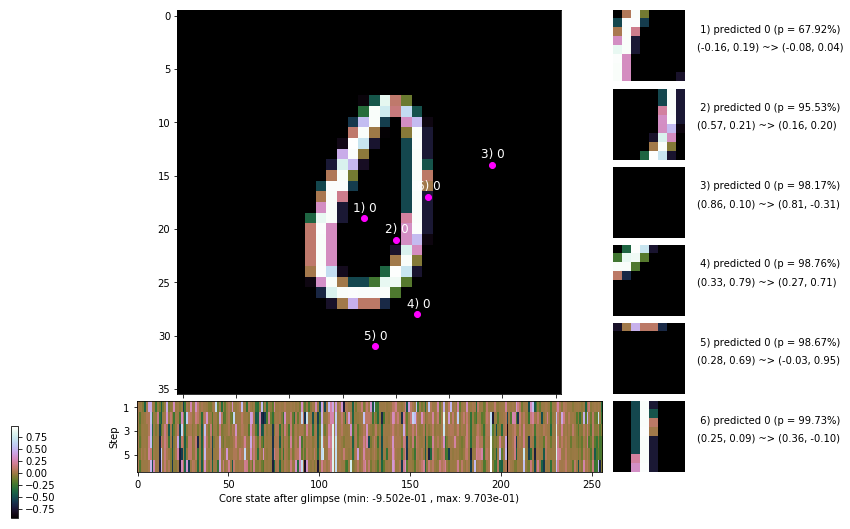

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


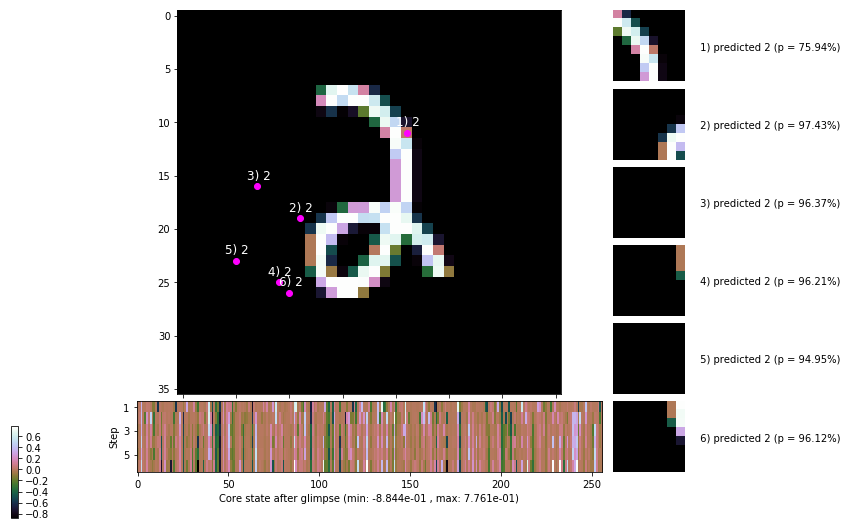


	Target class: 3 | Discounted rewards: [-0.539, -0.389, 1.111, 1.110, 1.100, 1.000]


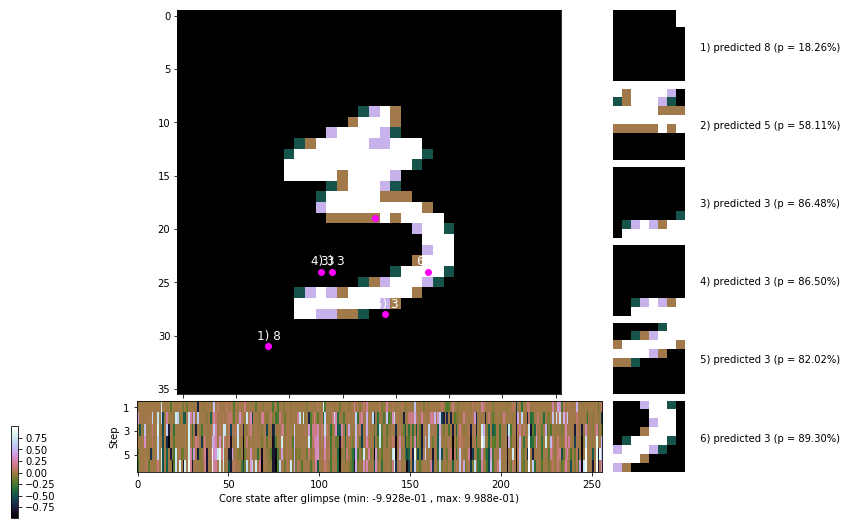

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


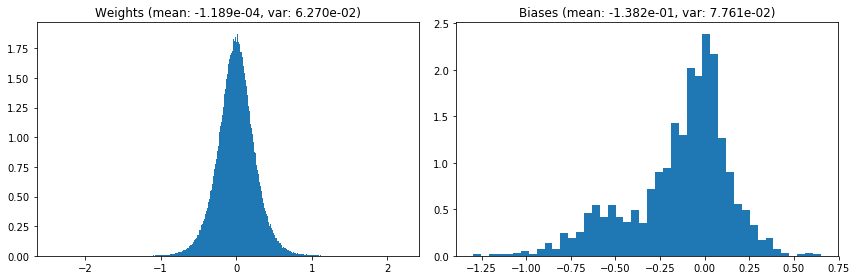

                                      Location network weights and biases


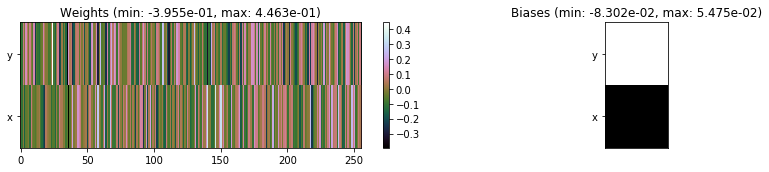

---------------------------------------------------------------------------------------------------------------
Elapsed time:  430.78 sec | TRAIN >> class loss: 0.2912 | steps:  2.238 :( | reward:  3.7258 :( | acc.: 90.350% :(
                          | VAL   >> class loss: 0.2852 | steps:  2.146 :( | reward:  3.8964 :( | acc.: 90.460% :(


Epoch  32/400) lr = 0.000628
 b    300/  3000 >> 140.2 ms/b | lr: 6.27e-04 | grad 2norm: 10.92 | grad inf norm:  2.787
         Weights || abs max:  2.42 ( 3642.51) | mean: -1.23e-04 ( 0.02) | var: 6.27e-02 (  258.42)
          Biases || abs max:  1.29 (  134.88) | mean: -1.38e-01 ( 0.11) | var: 7.77e-02 (   95.12)
                    class loss: 0.287 | steps: 2.224 | reward:  3.756 | acc.: 90.40%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 140.7 ms/b | lr: 6.27e-04 | grad 2norm: 11.23 | grad inf norm:  2.901
         Weights || abs max:  2.42 ( 3035.90) | mean: -1.33e-04 ( 

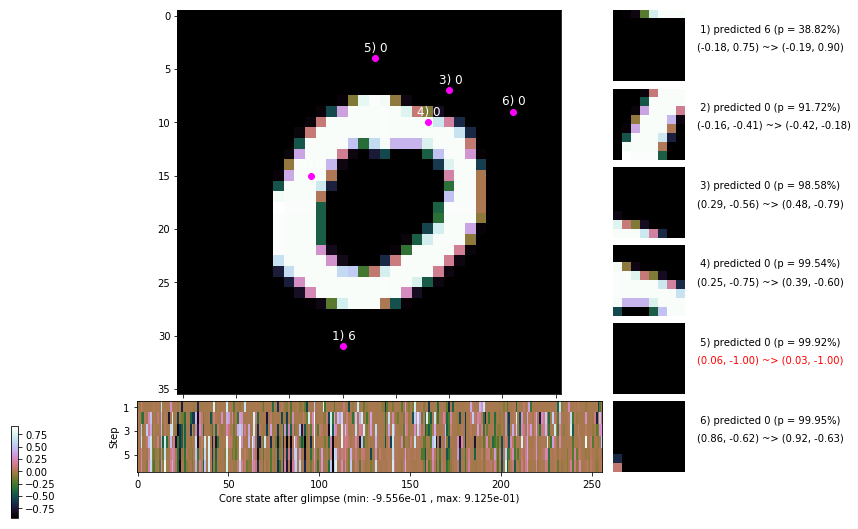

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 139.2 ms/b | lr: 6.25e-04 | grad 2norm: 10.95 | grad inf norm:  2.782
         Weights || abs max:  2.42 ( 3516.23) | mean: -1.31e-04 ( 0.01) | var: 6.29e-02 (  284.14)
          Biases || abs max:  1.29 (  680.40) | mean: -1.39e-01 ( 0.32) | var: 7.80e-02 (35630.06)
                    class loss: 0.293 | steps: 2.233 | reward:  3.743 | acc.: 90.08%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.5 ms/b | lr: 6.25e-04 | grad 2norm: 11.08 | grad inf norm:  2.856
         Weights || abs max:  2.42 ( 6874.17) | mean: -1.19e-04 ( 0.02) | var: 6.30e-02 ( 6894.29)
          Biases || abs max:  1.29 (   70.45) | mean: -1.39e-01 ( 0.08) | var: 7.81e-02 (  189.63)
                    class loss: 0.302 | steps: 2.236 | reward:  3.731 | acc.: 89.85%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

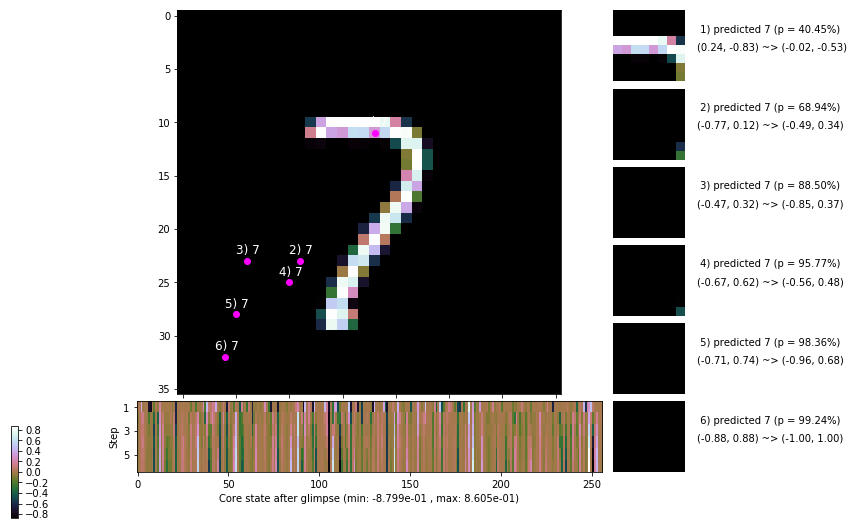

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.0 ms/b | lr: 6.24e-04 | grad 2norm: 10.88 | grad inf norm:  2.777
         Weights || abs max:  2.41 ( 4991.12) | mean: -1.69e-04 ( 0.02) | var: 6.31e-02 ( 1759.55)
          Biases || abs max:  1.30 (  130.84) | mean: -1.39e-01 ( 0.12) | var: 7.82e-02 (  196.58)
                    class loss: 0.302 | steps: 2.262 | reward:  3.683 | acc.: 90.15%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 139.7 ms/b | lr: 6.23e-04 | grad 2norm: 10.89 | grad inf norm:  2.665
         Weights || abs max:  2.41 ( 3993.77) | mean: -1.98e-04 ( 0.02) | var: 6.32e-02 (  648.74)
          Biases || abs max:  1.30 (   62.69) | mean: -1.39e-01 ( 0.08) | var: 7.84e-02 (   19.90)
                    class loss: 0.298 | steps: 2.195 | reward:  3.804 | acc.: 90.45%

	Target class: 3 | Discounted rewards: [-0.389, 1.111, 1.

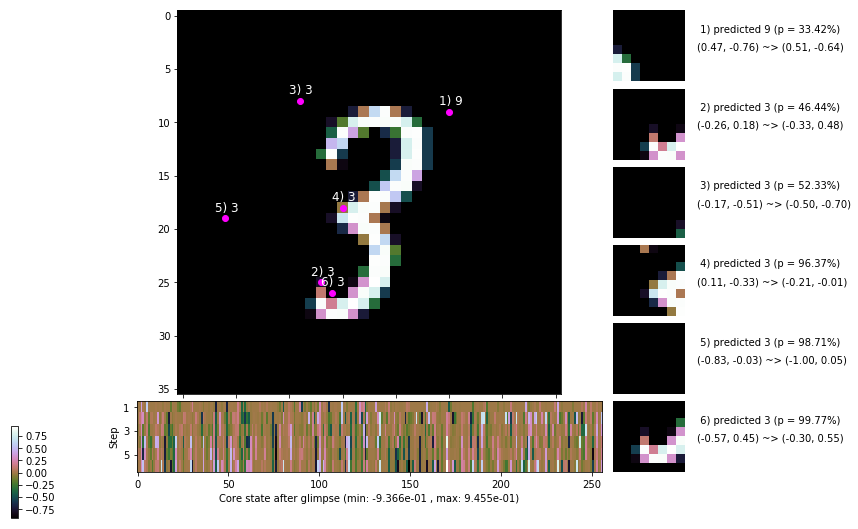

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.9 ms/b | lr: 6.22e-04 | grad 2norm: 10.78 | grad inf norm:  2.842
         Weights || abs max:  2.41 ( 2829.92) | mean: -1.84e-04 ( 0.01) | var: 6.33e-02 (   88.86)
          Biases || abs max:  1.29 (  367.90) | mean: -1.39e-01 ( 0.20) | var: 7.85e-02 ( 9724.52)
                    class loss: 0.280 | steps: 2.221 | reward:  3.772 | acc.: 90.77%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.8 ms/b | lr: 6.21e-04 | grad 2norm: 10.96 | grad inf norm:  2.731
         Weights || abs max:  2.42 ( 2159.01) | mean: -2.04e-04 ( 0.01) | var: 6.34e-02 (  157.45)
          Biases || abs max:  1.29 (   38.19) | mean: -1.39e-01 ( 0.06) | var: 7.85e-02 (    4.08)
                    class loss: 0.299 | steps: 2.225 | reward:  3.741 | acc.: 89.80%

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.1

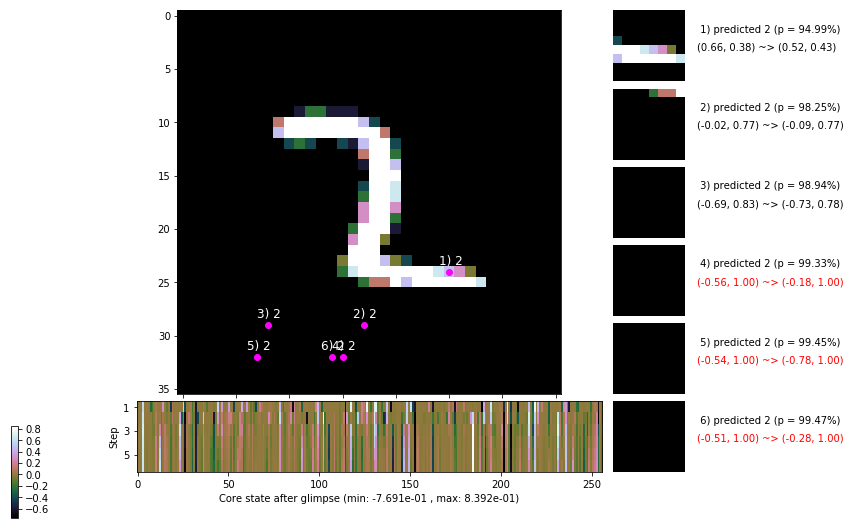

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.9 ms/b | lr: 6.20e-04 | grad 2norm: 10.52 | grad inf norm:  2.628
         Weights || abs max:  2.43 ( 5804.73) | mean: -2.06e-04 ( 0.02) | var: 6.35e-02 ( 6643.36)
          Biases || abs max:  1.30 (   62.15) | mean: -1.39e-01 ( 0.08) | var: 7.88e-02 (    8.51)
                    class loss: 0.280 | steps: 2.222 | reward:  3.756 | acc.: 90.73%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 139.7 ms/b | lr: 6.19e-04 | grad 2norm: 10.86 | grad inf norm:  2.744
         Weights || abs max:  2.43 (231503.36) | mean: -2.06e-04 ( 0.43) | var: 6.36e-02 (28437640.00)
          Biases || abs max:  1.30 (   55.52) | mean: -1.39e-01 ( 0.07) | var: 7.89e-02 (   11.56)
                    class loss: 0.288 | steps: 2.247 | reward:  3.720 | acc.: 90.88%

	Target class: 9 | Discounted rewards: [-0.389, 1.111

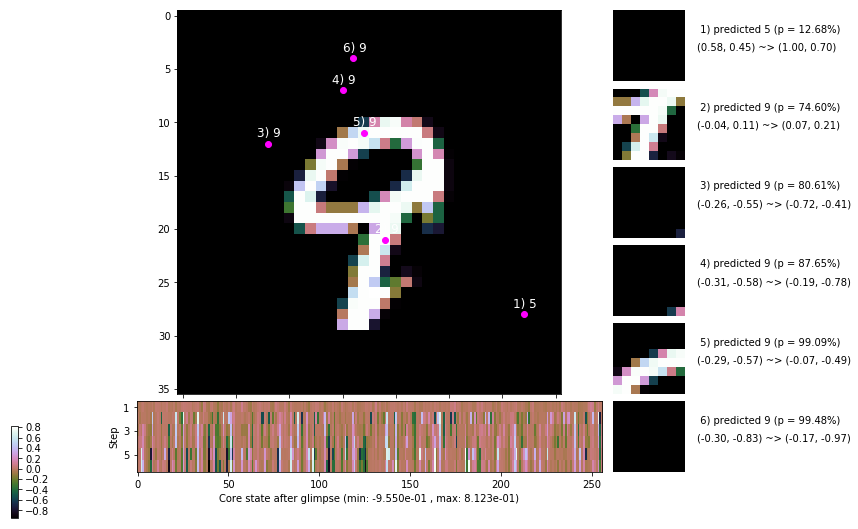

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


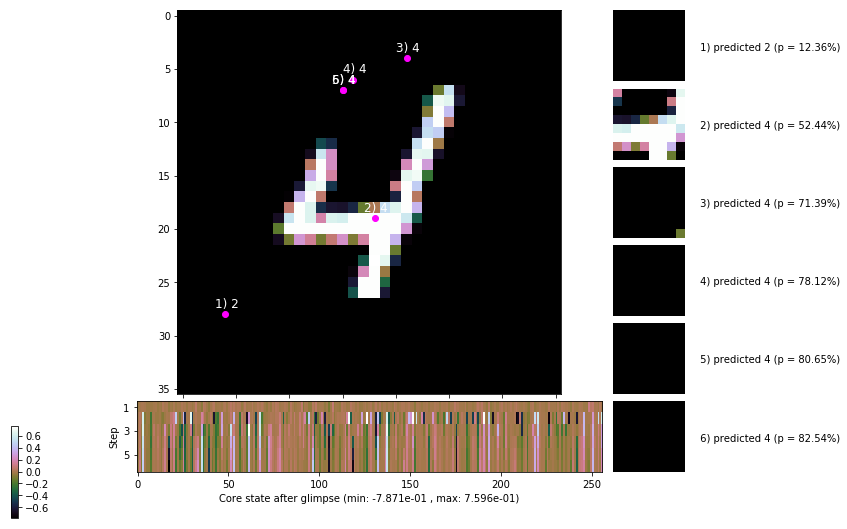


	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


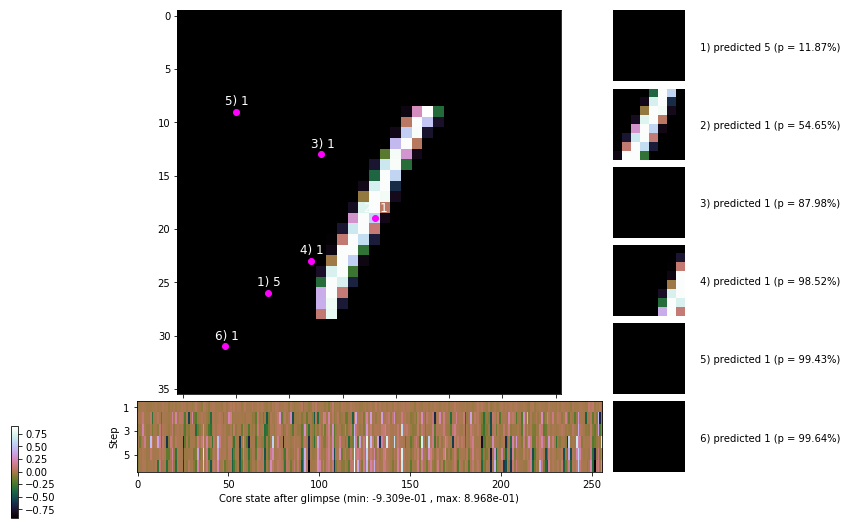

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


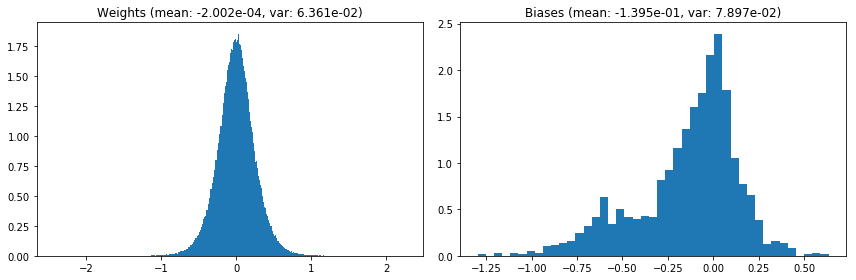

                                      Location network weights and biases


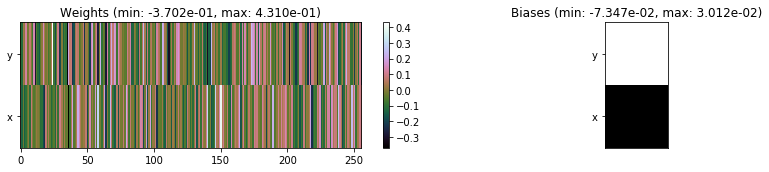

---------------------------------------------------------------------------------------------------------------
Elapsed time:  429.68 sec | TRAIN >> class loss: 0.2935 | steps:  2.230 :( | reward:  3.7415 :( | acc.: 90.270% :(
                          | VAL   >> class loss: 0.2844 | steps:  2.160 :( | reward:  3.8571 :( | acc.: 90.100% :(


Epoch  33/400) lr = 0.0006186
 b    300/  3000 >> 139.6 ms/b | lr: 6.18e-04 | grad 2norm: 10.74 | grad inf norm:  2.742
         Weights || abs max:  2.43 ( 2773.12) | mean: -2.01e-04 ( 0.01) | var: 6.36e-02 (  416.24)
          Biases || abs max:  1.29 (  126.55) | mean: -1.39e-01 ( 0.10) | var: 7.91e-02 (  158.21)
                    class loss: 0.301 | steps: 2.213 | reward:  3.757 | acc.: 90.27%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 141.1 ms/b | lr: 6.17e-04 | grad 2norm: 10.68 | grad inf norm:  2.728
         Weights || abs max:  2.43 ( 2520.56) | mean: -1.84e-04 (

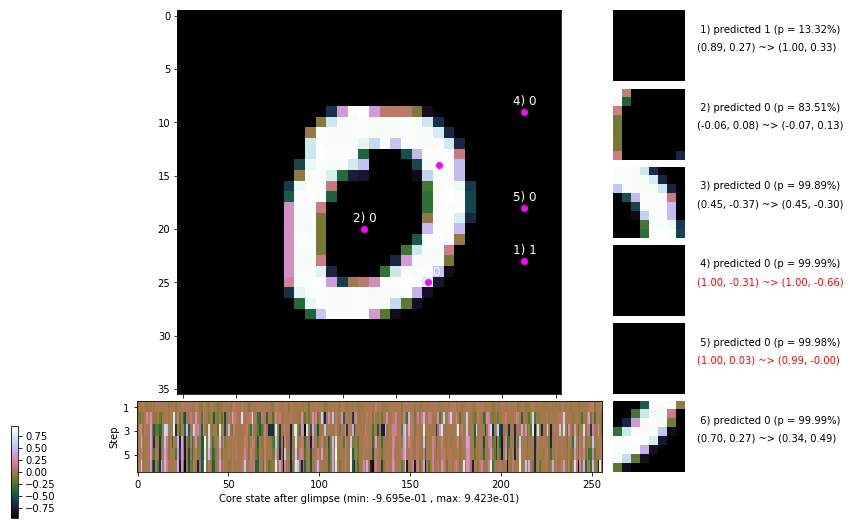

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.6 ms/b | lr: 6.16e-04 | grad 2norm: 10.97 | grad inf norm:  2.721
         Weights || abs max:  2.44 ( 5626.98) | mean: -1.95e-04 ( 0.02) | var: 6.38e-02 ( 6253.51)
          Biases || abs max:  1.31 (  104.41) | mean: -1.40e-01 ( 0.10) | var: 7.92e-02 (   55.64)
                    class loss: 0.308 | steps: 2.239 | reward:  3.722 | acc.: 90.12%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.3 ms/b | lr: 6.16e-04 | grad 2norm: 10.90 | grad inf norm:  2.880
         Weights || abs max:  2.43 ( 2308.14) | mean: -1.58e-04 ( 0.01) | var: 6.39e-02 (  262.43)
          Biases || abs max:  1.31 (   88.00) | mean: -1.40e-01 ( 0.09) | var: 7.92e-02 (   77.03)
                    class loss: 0.309 | steps: 2.219 | reward:  3.745 | acc.: 89.63%

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.

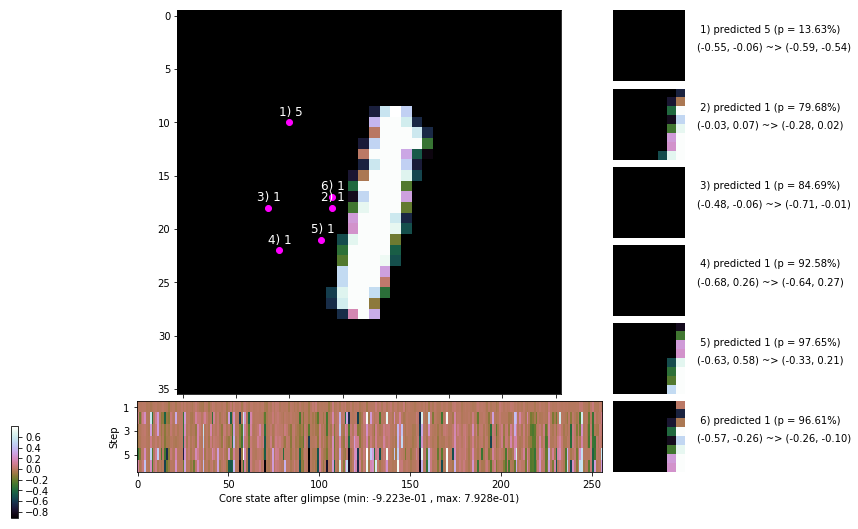

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 140.5 ms/b | lr: 6.14e-04 | grad 2norm: 10.40 | grad inf norm:  2.663
         Weights || abs max:  2.42 ( 2577.78) | mean: -1.44e-04 ( 0.01) | var: 6.40e-02 (  103.74)
          Biases || abs max:  1.31 (  147.84) | mean: -1.40e-01 ( 0.11) | var: 7.92e-02 (  497.67)
                    class loss: 0.260 | steps: 2.171 | reward:  3.860 | acc.: 91.53%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.0 ms/b | lr: 6.14e-04 | grad 2norm: 11.06 | grad inf norm:  2.833
         Weights || abs max:  2.42 ( 3006.87) | mean: -1.47e-04 ( 0.01) | var: 6.41e-02 (  587.73)
          Biases || abs max:  1.31 (  114.55) | mean: -1.40e-01 ( 0.10) | var: 7.93e-02 (  105.77)
                    class loss: 0.313 | steps: 2.232 | reward:  3.749 | acc.: 90.07%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

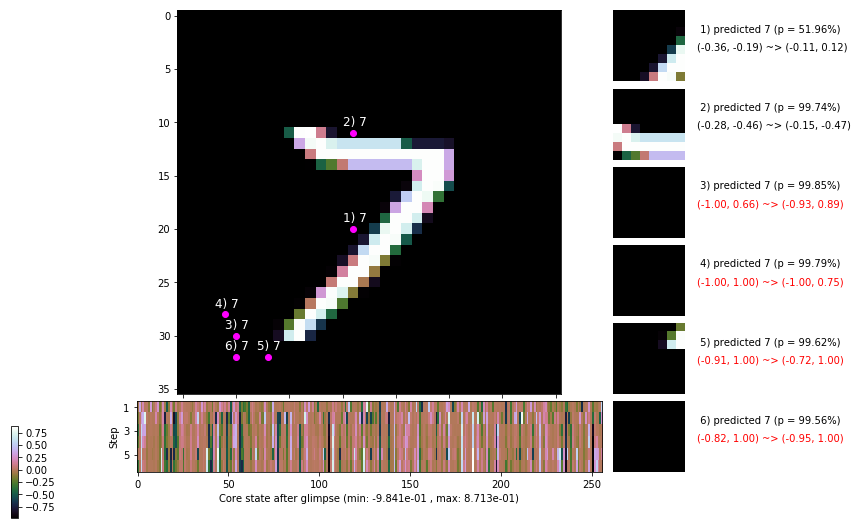

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.2 ms/b | lr: 6.12e-04 | grad 2norm: 10.73 | grad inf norm:  2.714
         Weights || abs max:  2.43 ( 1647.37) | mean: -1.20e-04 ( 0.01) | var: 6.41e-02 (   22.68)
          Biases || abs max:  1.32 (  146.70) | mean: -1.40e-01 ( 0.11) | var: 7.94e-02 (  426.71)
                    class loss: 0.274 | steps: 2.203 | reward:  3.820 | acc.: 90.97%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 140.5 ms/b | lr: 6.12e-04 | grad 2norm: 11.02 | grad inf norm:  2.783
         Weights || abs max:  2.44 ( 3347.09) | mean: -1.08e-04 ( 0.01) | var: 6.42e-02 (  548.16)
          Biases || abs max:  1.30 (  338.81) | mean: -1.40e-01 ( 0.19) | var: 7.94e-02 ( 7872.25)
                    class loss: 0.299 | steps: 2.220 | reward:  3.755 | acc.: 89.75%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

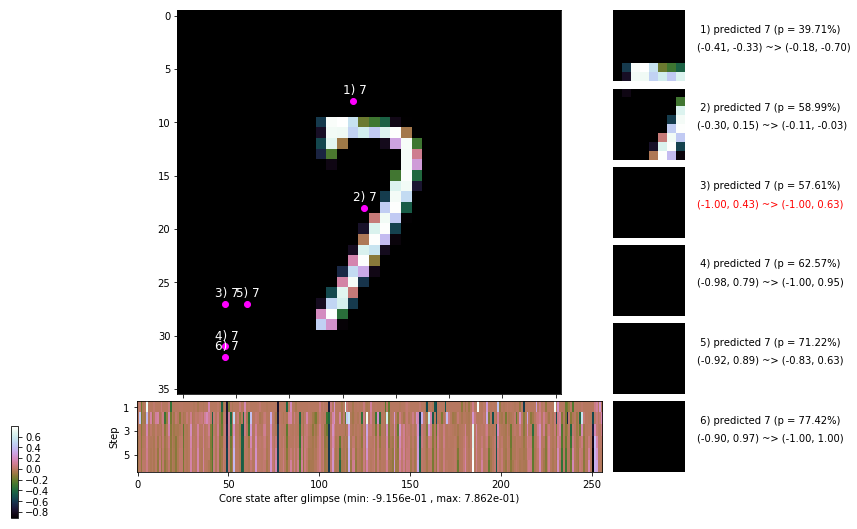

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 141.4 ms/b | lr: 6.11e-04 | grad 2norm: 11.31 | grad inf norm:  2.763
         Weights || abs max:  2.44 ( 7643.93) | mean: -9.97e-05 ( 0.02) | var: 6.43e-02 (10719.82)
          Biases || abs max:  1.29 (  119.18) | mean: -1.40e-01 ( 0.10) | var: 7.95e-02 (  365.53)
                    class loss: 0.308 | steps: 2.246 | reward:  3.713 | acc.: 89.75%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.2 ms/b | lr: 6.10e-04 | grad 2norm: 11.02 | grad inf norm:  2.714
         Weights || abs max:  2.45 (15748.81) | mean: -1.22e-04 ( 0.04) | var: 6.44e-02 (68191.09)
          Biases || abs max:  1.29 (   74.19) | mean: -1.41e-01 ( 0.08) | var: 7.96e-02 (   47.71)
                    class loss: 0.292 | steps: 2.221 | reward:  3.762 | acc.: 90.53%

	Target class: 0 | Discounted rewards: [-0.389, 1.111, 1.

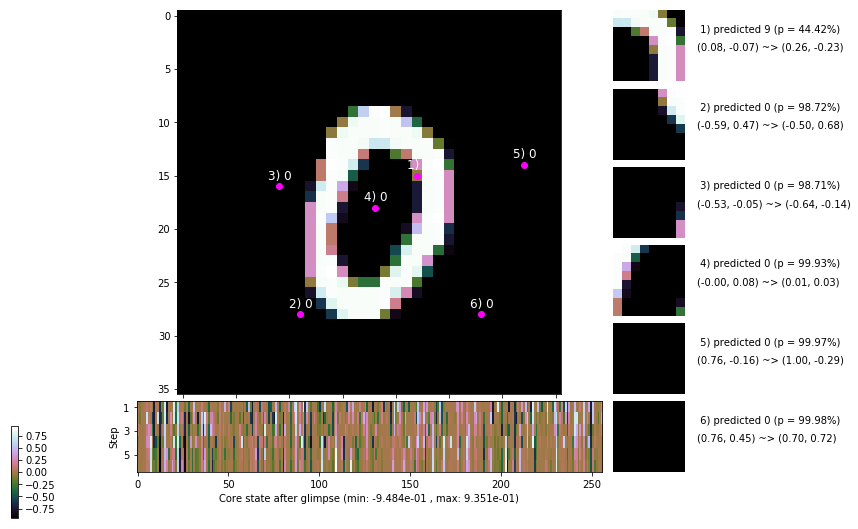

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [-0.541, -0.406, 0.944, -0.555, -0.550, -0.500]


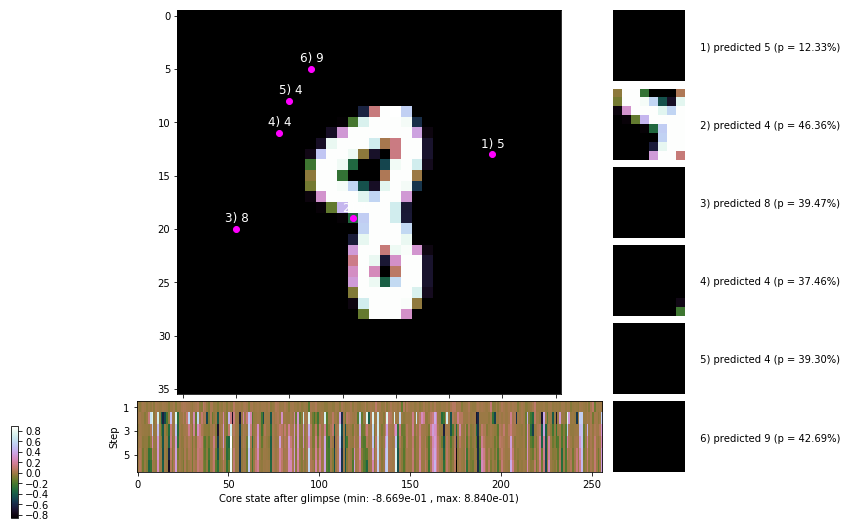


	Target class: 7 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


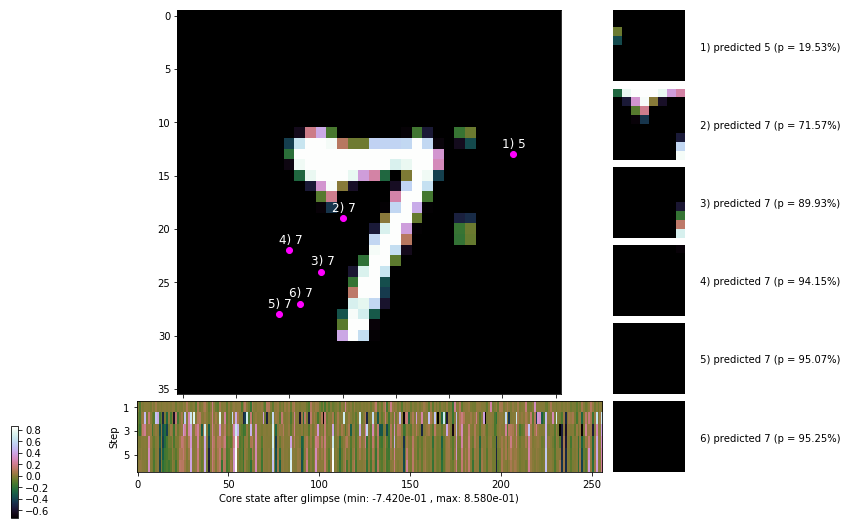

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


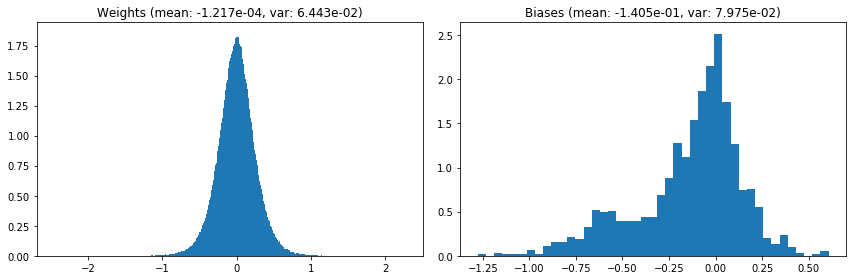

                                      Location network weights and biases


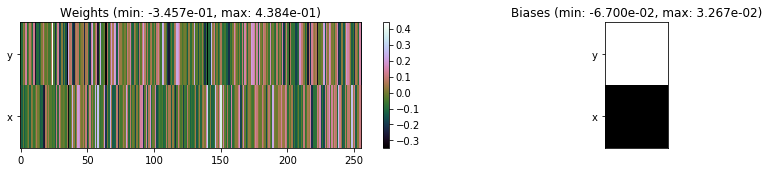

---------------------------------------------------------------------------------------------------------------
Elapsed time:  424.21 sec | TRAIN >> class loss: 0.2955 | steps:  2.219 :( | reward:  3.7642 :( | acc.: 90.333% :(
                          | VAL   >> class loss: 0.2818 | steps:  2.128 :( | reward:  3.9285 :( | acc.: 90.160% :(


Epoch  34/400) lr = 0.0006094
 b    300/  3000 >> 145.3 ms/b | lr: 6.09e-04 | grad 2norm: 10.97 | grad inf norm:  2.771
         Weights || abs max:  2.45 ( 3308.24) | mean: -1.06e-04 ( 0.01) | var: 6.45e-02 (  177.44)
          Biases || abs max:  1.28 (   31.84) | mean: -1.40e-01 ( 0.06) | var: 7.97e-02 (    2.00)
                    class loss: 0.286 | steps: 2.229 | reward:  3.761 | acc.: 90.80%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 157.6 ms/b | lr: 6.08e-04 | grad 2norm: 11.08 | grad inf norm:  2.775
         Weights || abs max:  2.45 (200759.69) | mean: -8.46e-05 

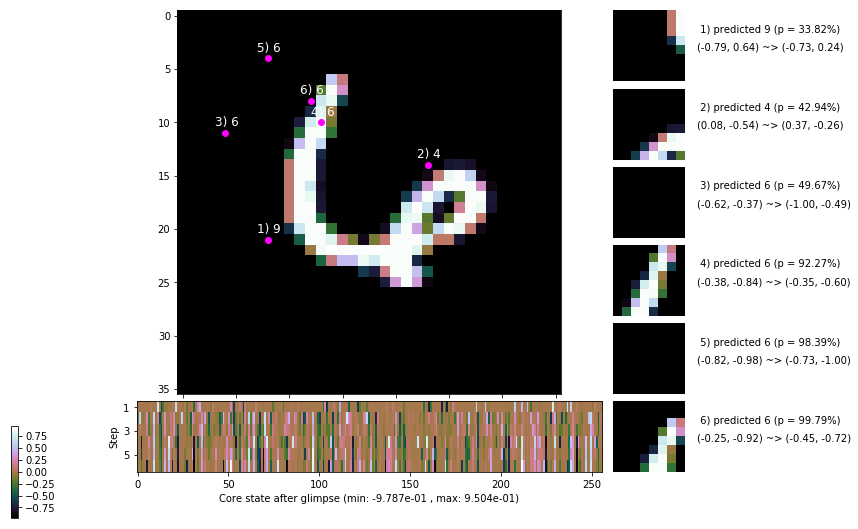

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 141.7 ms/b | lr: 6.07e-04 | grad 2norm: 10.82 | grad inf norm:  2.770
         Weights || abs max:  2.44 ( 2914.59) | mean: -1.00e-04 ( 0.01) | var: 6.46e-02 (  632.54)
          Biases || abs max:  1.28 (   47.28) | mean: -1.41e-01 ( 0.07) | var: 8.02e-02 (   16.13)
                    class loss: 0.299 | steps: 2.247 | reward:  3.727 | acc.: 90.33%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.6 ms/b | lr: 6.06e-04 | grad 2norm: 10.59 | grad inf norm:  2.727
         Weights || abs max:  2.44 ( 6175.37) | mean: -1.12e-04 ( 0.02) | var: 6.47e-02 ( 3247.24)
          Biases || abs max:  1.28 (   92.02) | mean: -1.42e-01 ( 0.09) | var: 8.03e-02 (   54.01)
                    class loss: 0.296 | steps: 2.257 | reward:  3.706 | acc.: 90.18%

	Target class: 6 | Discounted rewards: [-0.554, -0.539, -

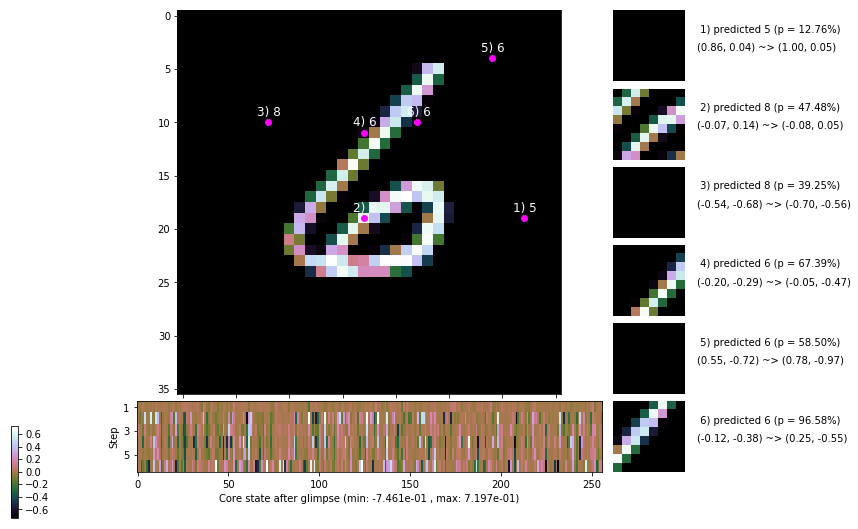

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.2 ms/b | lr: 6.05e-04 | grad 2norm: 10.83 | grad inf norm:  2.861
         Weights || abs max:  2.45 ( 5891.30) | mean: -1.48e-04 ( 0.02) | var: 6.48e-02 ( 5777.39)
          Biases || abs max:  1.30 (   81.65) | mean: -1.41e-01 ( 0.08) | var: 8.04e-02 (  156.92)
                    class loss: 0.293 | steps: 2.227 | reward:  3.746 | acc.: 90.55%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.4 ms/b | lr: 6.05e-04 | grad 2norm: 10.55 | grad inf norm:  2.674
         Weights || abs max:  2.45 ( 6261.63) | mean: -1.56e-04 ( 0.02) | var: 6.49e-02 ( 2843.34)
          Biases || abs max:  1.30 (   83.73) | mean: -1.41e-01 ( 0.09) | var: 8.06e-02 (  111.69)
                    class loss: 0.300 | steps: 2.237 | reward:  3.717 | acc.: 90.20%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.1

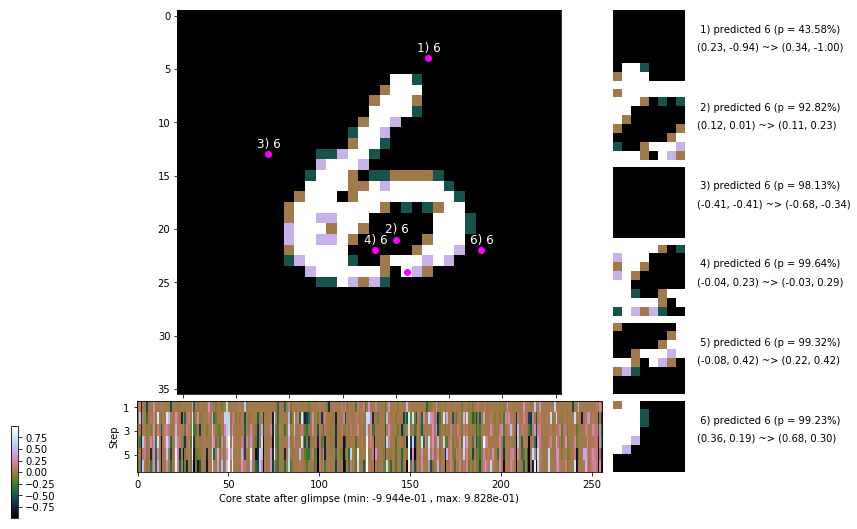

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 143.5 ms/b | lr: 6.03e-04 | grad 2norm: 10.41 | grad inf norm:  2.778
         Weights || abs max:  2.45 ( 2038.54) | mean: -1.67e-04 ( 0.01) | var: 6.50e-02 (   68.78)
          Biases || abs max:  1.29 (   40.10) | mean: -1.41e-01 ( 0.06) | var: 8.06e-02 (    3.36)
                    class loss: 0.271 | steps: 2.192 | reward:  3.808 | acc.: 91.35%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 142.6 ms/b | lr: 6.03e-04 | grad 2norm: 10.88 | grad inf norm:  2.809
         Weights || abs max:  2.46 ( 3465.30) | mean: -1.78e-04 ( 0.01) | var: 6.51e-02 (  524.19)
          Biases || abs max:  1.30 (  141.80) | mean: -1.40e-01 ( 0.10) | var: 8.05e-02 (  519.73)
                    class loss: 0.284 | steps: 2.222 | reward:  3.776 | acc.: 90.98%

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1.

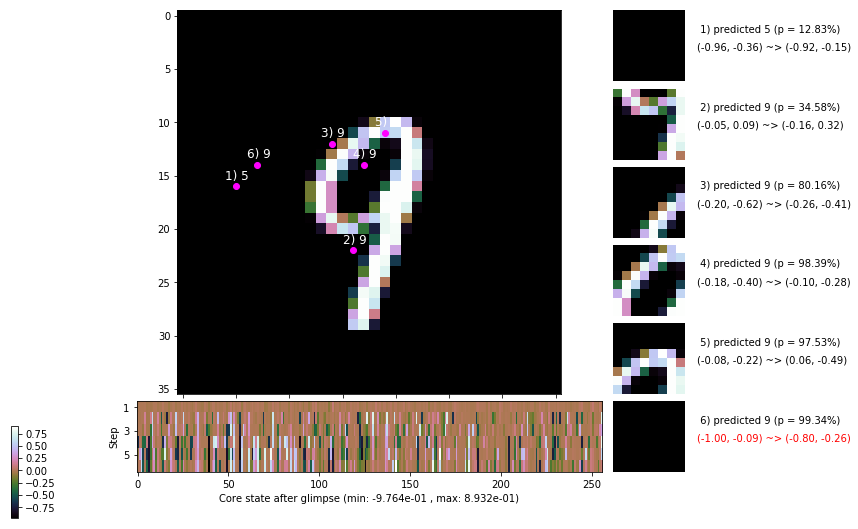

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.2 ms/b | lr: 6.02e-04 | grad 2norm: 10.96 | grad inf norm:  2.810
         Weights || abs max:  2.47 ( 2899.11) | mean: -1.70e-04 ( 0.01) | var: 6.51e-02 (  125.15)
          Biases || abs max:  1.30 (  129.43) | mean: -1.41e-01 ( 0.10) | var: 8.08e-02 (  303.84)
                    class loss: 0.295 | steps: 2.209 | reward:  3.758 | acc.: 89.88%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 139.0 ms/b | lr: 6.01e-04 | grad 2norm: 10.84 | grad inf norm:  2.760
         Weights || abs max:  2.48 ( 6159.37) | mean: -2.03e-04 ( 0.02) | var: 6.52e-02 ( 5649.00)
          Biases || abs max:  1.31 (   86.34) | mean: -1.41e-01 ( 0.08) | var: 8.08e-02 (   37.10)
                    class loss: 0.288 | steps: 2.220 | reward:  3.748 | acc.: 90.48%

	Target class: 3 | Discounted rewards: [-0.539, -0.389, 1

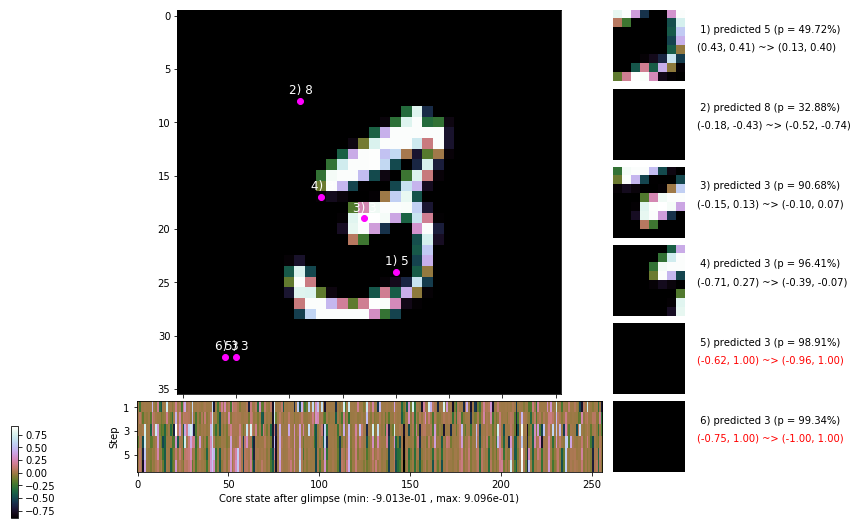

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


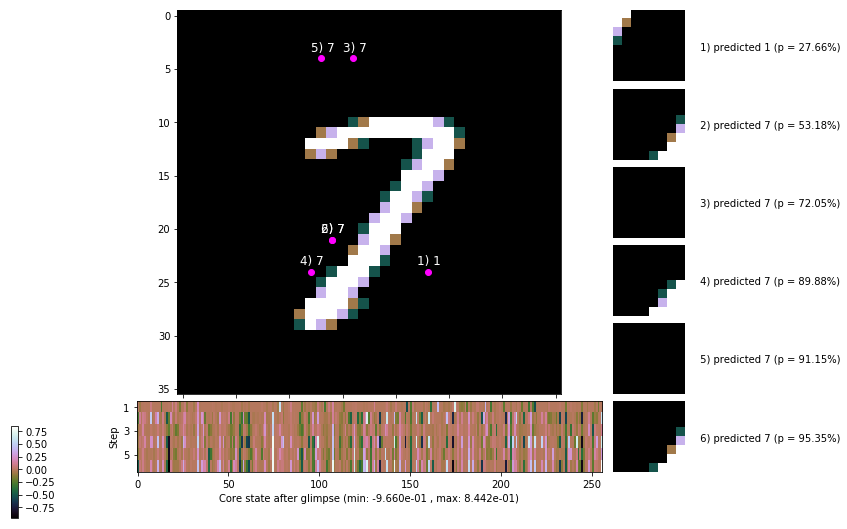


	Target class: 8 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


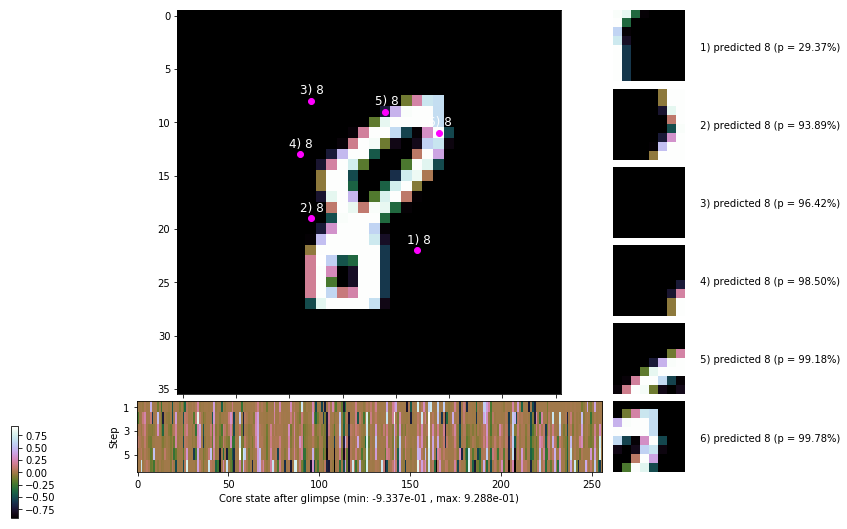

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


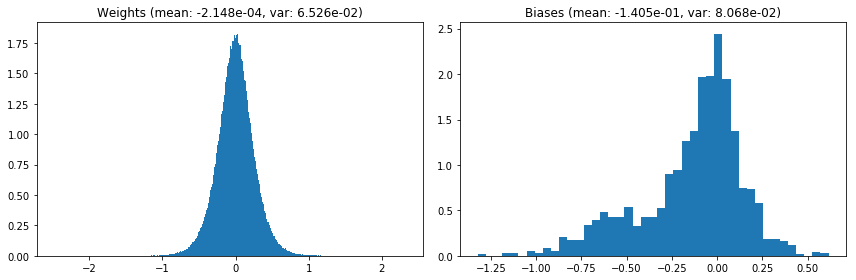

                                      Location network weights and biases


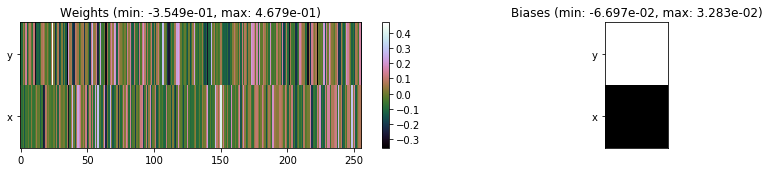

---------------------------------------------------------------------------------------------------------------
Elapsed time:  430.93 sec | TRAIN >> class loss: 0.2911 | steps:  2.227 :( | reward:  3.7498 :( | acc.: 90.515% :(
                          | VAL   >> class loss: 0.2879 | steps:  2.114 :( | reward:  3.9336 :( | acc.: 90.020% :(


Epoch  35/400) lr = 0.0006003
 b    300/  3000 >> 142.4 ms/b | lr: 6.00e-04 | grad 2norm: 11.01 | grad inf norm:  2.824
         Weights || abs max:  2.49 ( 4272.69) | mean: -2.01e-04 ( 0.02) | var: 6.53e-02 ( 1500.75)
          Biases || abs max:  1.32 (  173.79) | mean: -1.41e-01 ( 0.13) | var: 8.09e-02 (  239.85)
                    class loss: 0.305 | steps: 2.238 | reward:  3.732 | acc.: 90.25%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 139.0 ms/b | lr: 5.99e-04 | grad 2norm: 10.75 | grad inf norm:  2.789
         Weights || abs max:  2.48 ( 2733.63) | mean: -1.83e-04 (

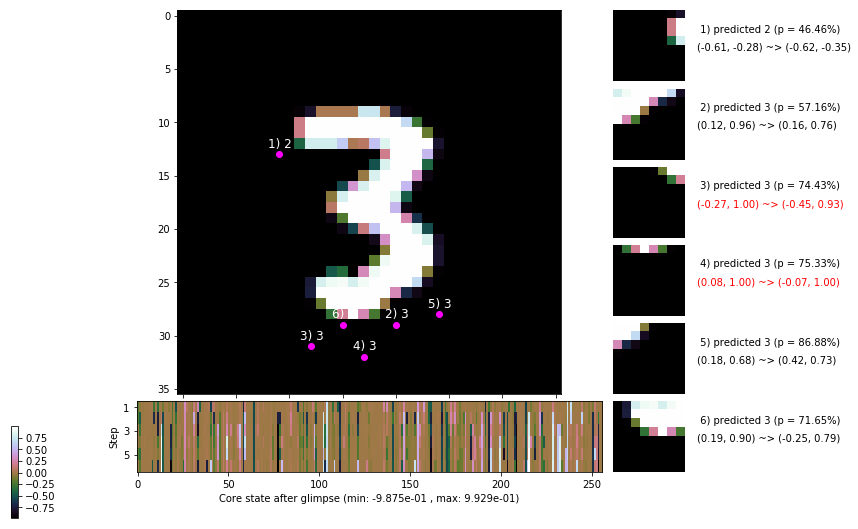

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.5 ms/b | lr: 5.98e-04 | grad 2norm: 10.77 | grad inf norm:  2.732
         Weights || abs max:  2.49 ( 5789.14) | mean: -2.04e-04 ( 0.02) | var: 6.54e-02 ( 2056.09)
          Biases || abs max:  1.31 (   56.12) | mean: -1.42e-01 ( 0.07) | var: 8.13e-02 (    9.11)
                    class loss: 0.286 | steps: 2.212 | reward:  3.782 | acc.: 91.08%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.5 ms/b | lr: 5.97e-04 | grad 2norm: 10.52 | grad inf norm:  2.687
         Weights || abs max:  2.49 ( 3515.78) | mean: -1.92e-04 ( 0.01) | var: 6.55e-02 (  553.02)
          Biases || abs max:  1.31 (  183.21) | mean: -1.41e-01 ( 0.13) | var: 8.13e-02 (  800.82)
                    class loss: 0.297 | steps: 2.189 | reward:  3.797 | acc.: 90.83%

	Target class: 4 | Discounted rewards: [-0.389, 1.111, 1.

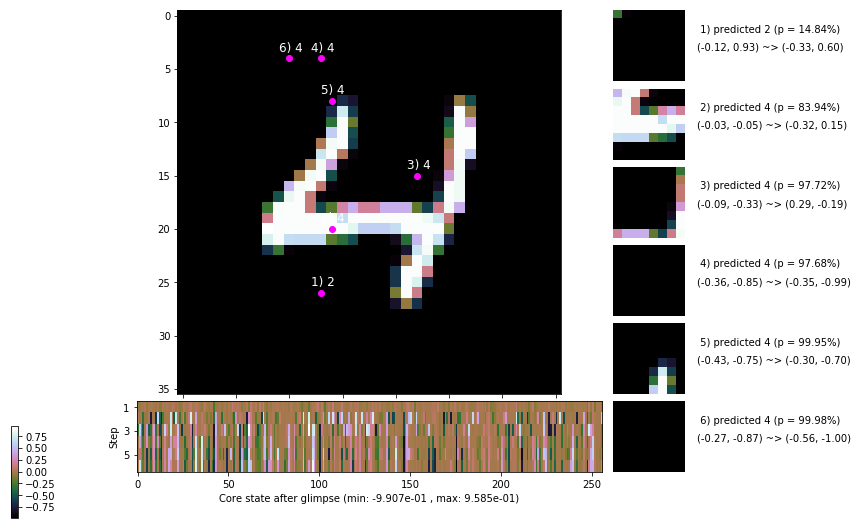

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 162.4 ms/b | lr: 5.96e-04 | grad 2norm: 10.65 | grad inf norm:  2.722
         Weights || abs max:  2.49 ( 3895.39) | mean: -2.30e-04 ( 0.02) | var: 6.56e-02 ( 1097.38)
          Biases || abs max:  1.32 (  110.95) | mean: -1.41e-01 ( 0.09) | var: 8.15e-02 (  187.32)
                    class loss: 0.286 | steps: 2.219 | reward:  3.758 | acc.: 90.63%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.9 ms/b | lr: 5.96e-04 | grad 2norm: 10.75 | grad inf norm:  2.806
         Weights || abs max:  2.49 ( 2024.07) | mean: -2.41e-04 ( 0.01) | var: 6.57e-02 (   69.55)
          Biases || abs max:  1.32 (  100.94) | mean: -1.41e-01 ( 0.09) | var: 8.15e-02 (  116.15)
                    class loss: 0.298 | steps: 2.226 | reward:  3.736 | acc.: 90.25%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.1

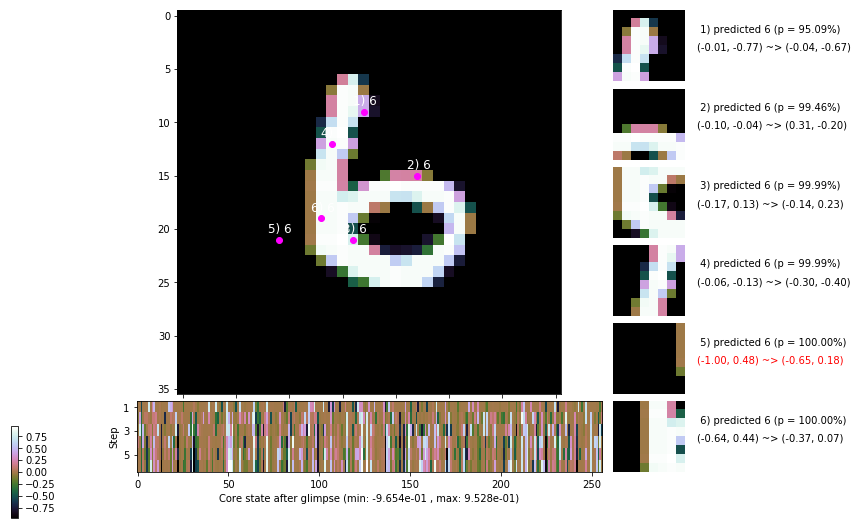

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.8 ms/b | lr: 5.94e-04 | grad 2norm: 10.64 | grad inf norm:  2.832
         Weights || abs max:  2.49 ( 2742.68) | mean: -2.13e-04 ( 0.01) | var: 6.58e-02 (  127.86)
          Biases || abs max:  1.31 (   56.54) | mean: -1.41e-01 ( 0.07) | var: 8.15e-02 (   23.03)
                    class loss: 0.290 | steps: 2.228 | reward:  3.749 | acc.: 90.20%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 140.1 ms/b | lr: 5.94e-04 | grad 2norm: 10.79 | grad inf norm:  2.872
         Weights || abs max:  2.49 ( 2202.11) | mean: -1.73e-04 ( 0.01) | var: 6.58e-02 (   66.22)
          Biases || abs max:  1.31 (   75.70) | mean: -1.41e-01 ( 0.09) | var: 8.16e-02 (   32.38)
                    class loss: 0.302 | steps: 2.228 | reward:  3.732 | acc.: 89.62%

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1.

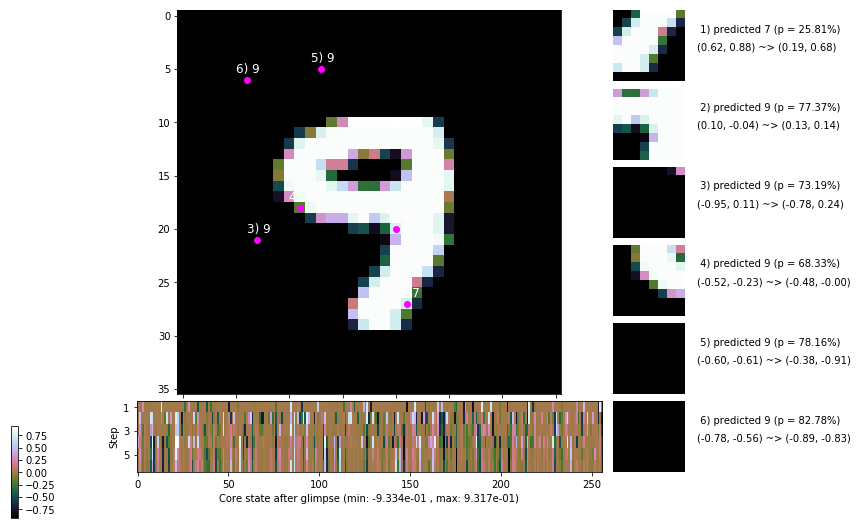

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.4 ms/b | lr: 5.93e-04 | grad 2norm: 10.70 | grad inf norm:  2.663
         Weights || abs max:  2.49 ( 2643.27) | mean: -1.79e-04 ( 0.01) | var: 6.59e-02 (  170.42)
          Biases || abs max:  1.31 (  211.94) | mean: -1.41e-01 ( 0.14) | var: 8.16e-02 (  264.99)
                    class loss: 0.287 | steps: 2.215 | reward:  3.759 | acc.: 90.18%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.8 ms/b | lr: 5.92e-04 | grad 2norm: 10.81 | grad inf norm:  2.869
         Weights || abs max:  2.50 ( 2548.52) | mean: -1.64e-04 ( 0.01) | var: 6.60e-02 (   90.76)
          Biases || abs max:  1.31 (   95.12) | mean: -1.41e-01 ( 0.09) | var: 8.20e-02 (   27.98)
                    class loss: 0.308 | steps: 2.240 | reward:  3.705 | acc.: 89.83%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

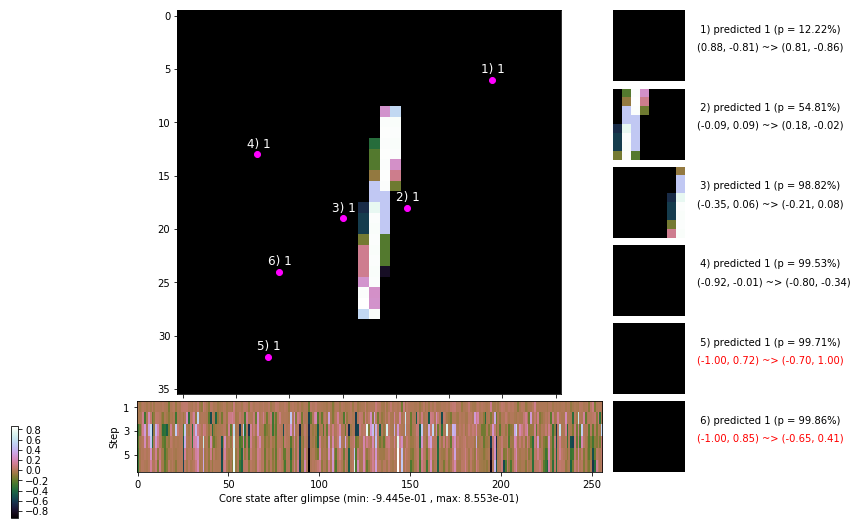

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


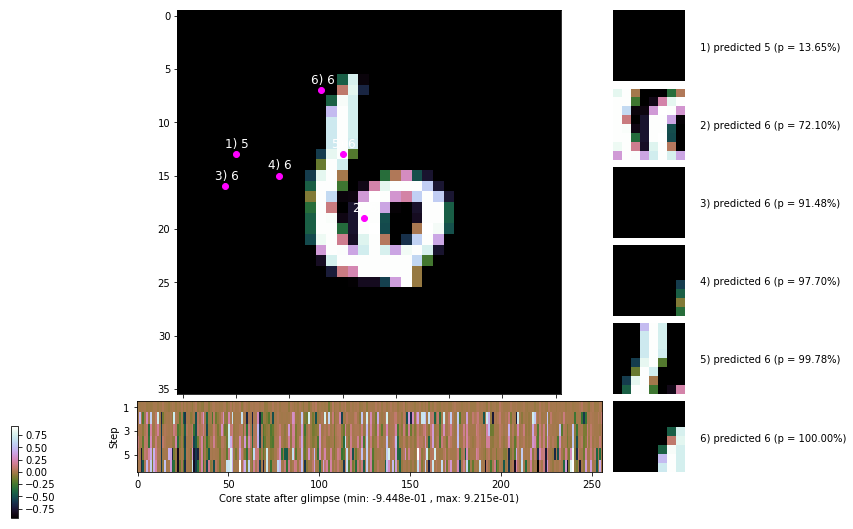


	Target class: 7 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


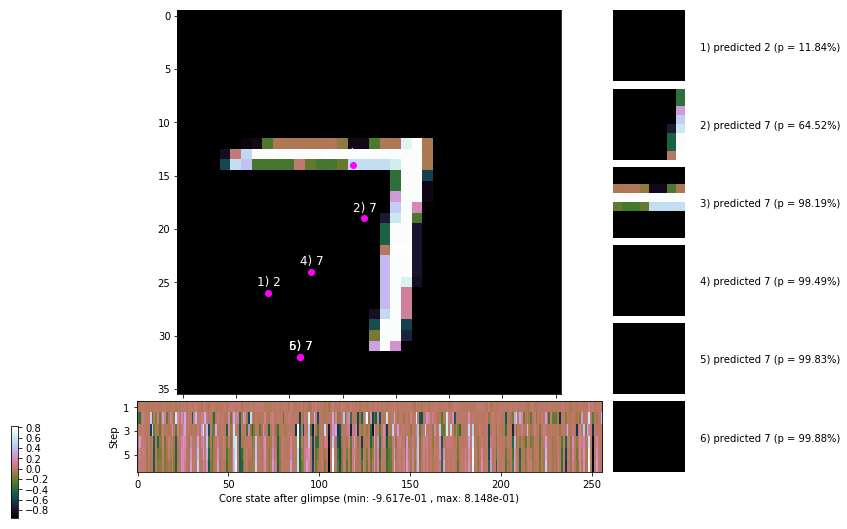

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


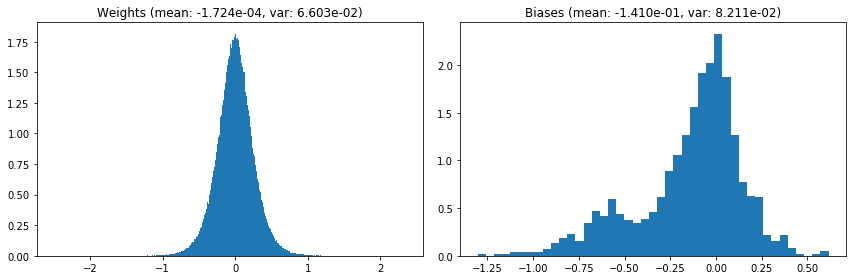

                                      Location network weights and biases


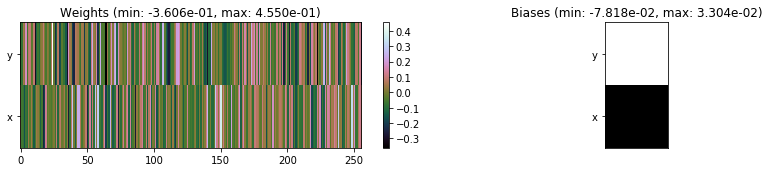

---------------------------------------------------------------------------------------------------------------
Elapsed time:  435.92 sec | TRAIN >> class loss: 0.2941 | steps:  2.222 :( | reward:  3.7489 :( | acc.: 90.353% :(
                          | VAL   >> class loss: 0.2742 | steps:  2.102 :( | reward:  3.9939 :( | acc.: 90.880% :(


Epoch  36/400) lr = 0.0005914
 b    300/  3000 >> 141.0 ms/b | lr: 5.91e-04 | grad 2norm: 10.66 | grad inf norm:  2.797
         Weights || abs max:  2.50 ( 5201.69) | mean: -1.70e-04 ( 0.02) | var: 6.61e-02 ( 1731.57)
          Biases || abs max:  1.30 (  140.90) | mean: -1.41e-01 ( 0.10) | var: 8.22e-02 (  170.32)
                    class loss: 0.289 | steps: 2.220 | reward:  3.765 | acc.: 90.07%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 140.8 ms/b | lr: 5.90e-04 | grad 2norm: 10.37 | grad inf norm:  2.649
         Weights || abs max:  2.51 ( 2724.14) | mean: -1.90e-04 (

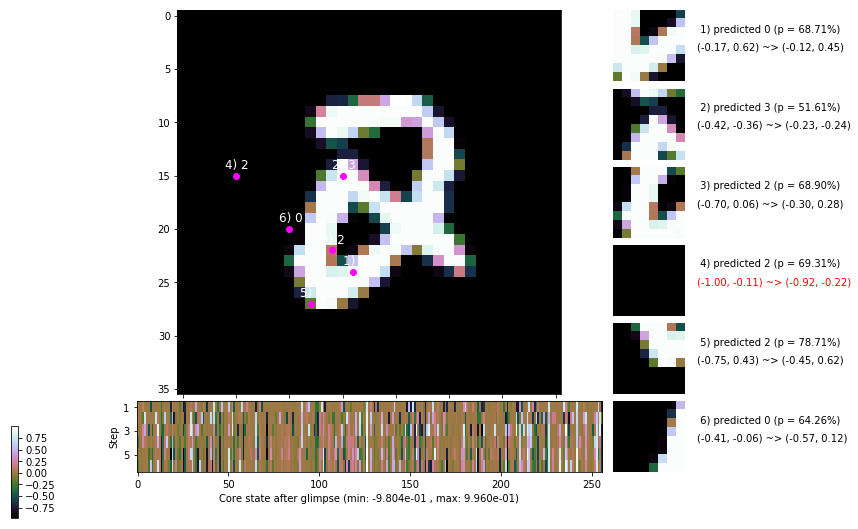

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.1 ms/b | lr: 5.89e-04 | grad 2norm: 10.26 | grad inf norm:  2.723
         Weights || abs max:  2.52 ( 3019.57) | mean: -1.68e-04 ( 0.01) | var: 6.62e-02 (  371.01)
          Biases || abs max:  1.32 (  173.93) | mean: -1.42e-01 ( 0.12) | var: 8.23e-02 (  708.60)
                    class loss: 0.275 | steps: 2.220 | reward:  3.773 | acc.: 91.17%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.6 ms/b | lr: 5.88e-04 | grad 2norm: 10.61 | grad inf norm:  2.724
         Weights || abs max:  2.52 (19032.92) | mean: -1.74e-04 ( 0.04) | var: 6.63e-02 (104240.77)
          Biases || abs max:  1.31 (  135.97) | mean: -1.41e-01 ( 0.12) | var: 8.24e-02 (  650.22)
                    class loss: 0.286 | steps: 2.190 | reward:  3.793 | acc.: 90.58%

	Target class: 7 | Discounted rewards: [-0.539, -0.389, 

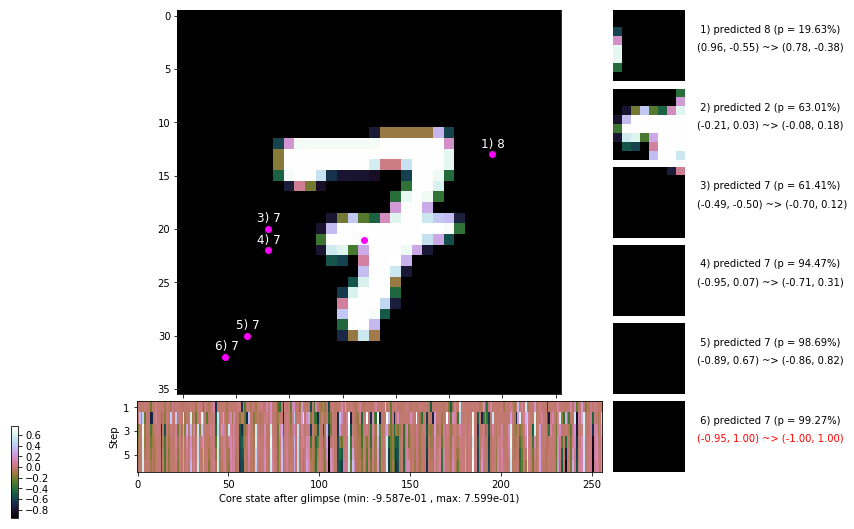

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.1 ms/b | lr: 5.87e-04 | grad 2norm: 10.55 | grad inf norm:  2.751
         Weights || abs max:  2.51 (17015.72) | mean: -1.89e-04 ( 0.04) | var: 6.64e-02 (103533.73)
          Biases || abs max:  1.31 (  434.76) | mean: -1.41e-01 ( 0.23) | var: 8.26e-02 (13204.93)
                    class loss: 0.285 | steps: 2.240 | reward:  3.740 | acc.: 90.47%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 138.3 ms/b | lr: 5.87e-04 | grad 2norm: 10.33 | grad inf norm:  2.632
         Weights || abs max:  2.51 (10454.89) | mean: -2.00e-04 ( 0.03) | var: 6.65e-02 (34884.24)
          Biases || abs max:  1.32 (  146.03) | mean: -1.41e-01 ( 0.12) | var: 8.26e-02 (  524.10)
                    class loss: 0.281 | steps: 2.213 | reward:  3.788 | acc.: 90.98%

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1

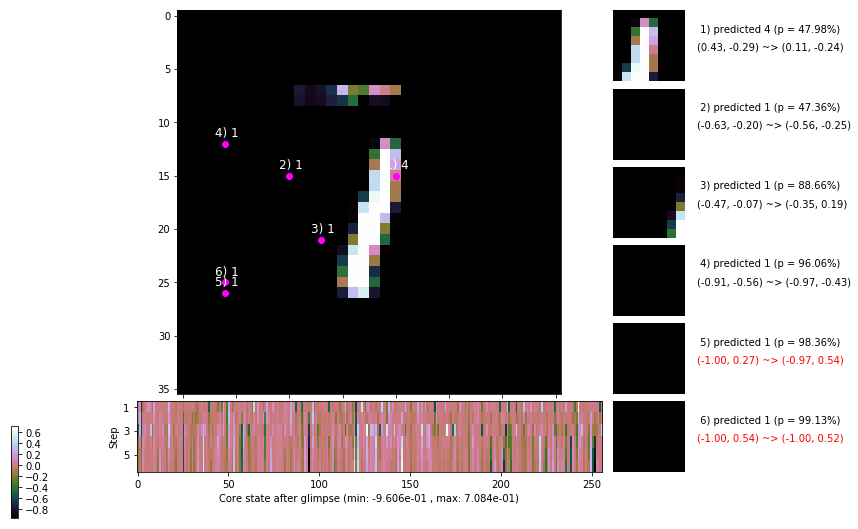

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.4 ms/b | lr: 5.86e-04 | grad 2norm: 10.42 | grad inf norm:  2.637
         Weights || abs max:  2.52 (18625.93) | mean: -2.09e-04 ( 0.04) | var: 6.65e-02 (150754.17)
          Biases || abs max:  1.31 (  184.91) | mean: -1.42e-01 ( 0.13) | var: 8.28e-02 (  573.04)
                    class loss: 0.270 | steps: 2.237 | reward:  3.744 | acc.: 90.92%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.7 ms/b | lr: 5.85e-04 | grad 2norm: 10.65 | grad inf norm:  2.776
         Weights || abs max:  2.52 ( 2584.34) | mean: -2.29e-04 ( 0.01) | var: 6.66e-02 (   83.80)
          Biases || abs max:  1.32 (   83.90) | mean: -1.42e-01 ( 0.08) | var: 8.29e-02 (   55.76)
                    class loss: 0.264 | steps: 2.201 | reward:  3.799 | acc.: 91.30%

	Target class: 2 | Discounted rewards: [-0.389, 1.111, 1

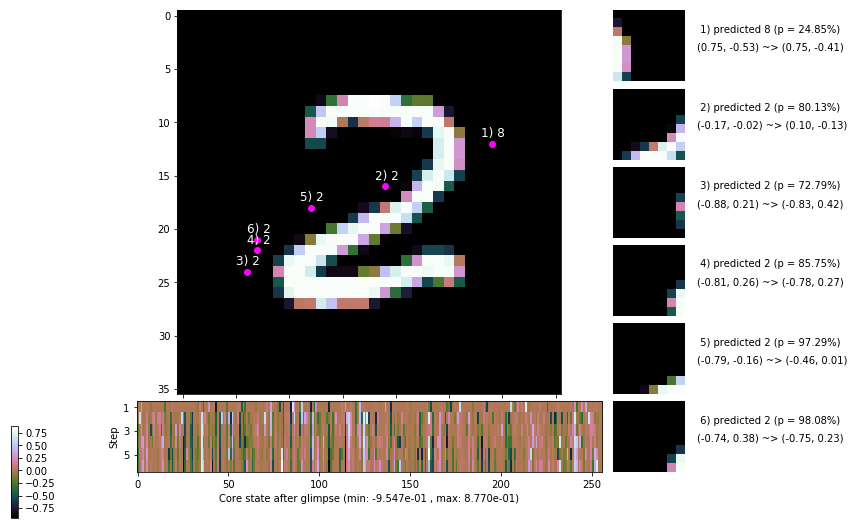

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.0 ms/b | lr: 5.84e-04 | grad 2norm: 10.35 | grad inf norm:  2.712
         Weights || abs max:  2.51 ( 3716.75) | mean: -2.37e-04 ( 0.02) | var: 6.67e-02 (  221.03)
          Biases || abs max:  1.32 (   99.53) | mean: -1.42e-01 ( 0.10) | var: 8.28e-02 (   47.84)
                    class loss: 0.252 | steps: 2.205 | reward:  3.838 | acc.: 91.55%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.8 ms/b | lr: 5.83e-04 | grad 2norm: 10.52 | grad inf norm:  2.763
         Weights || abs max:  2.50 ( 4664.11) | mean: -2.17e-04 ( 0.02) | var: 6.68e-02 ( 1428.70)
          Biases || abs max:  1.32 (  121.66) | mean: -1.42e-01 ( 0.11) | var: 8.30e-02 (   55.29)
                    class loss: 0.295 | steps: 2.203 | reward:  3.786 | acc.: 90.25%

	Target class: 4 | Discounted rewards: [-0.389, 1.111, 1.

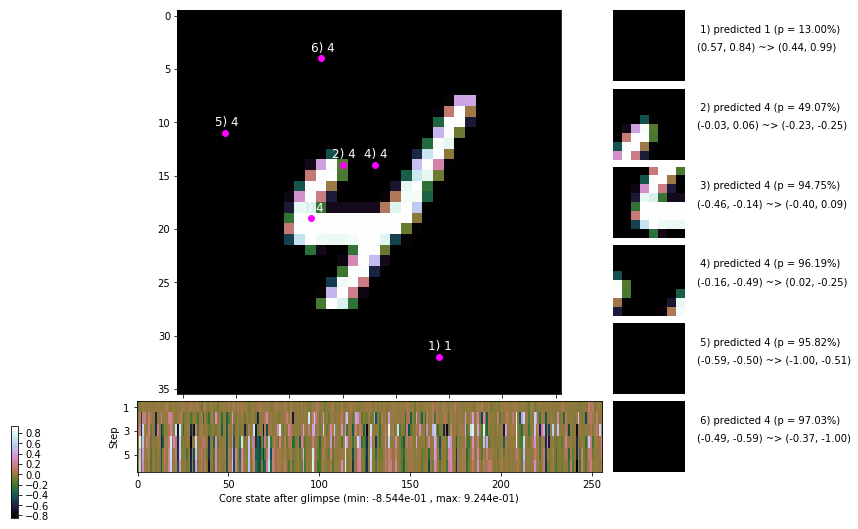

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


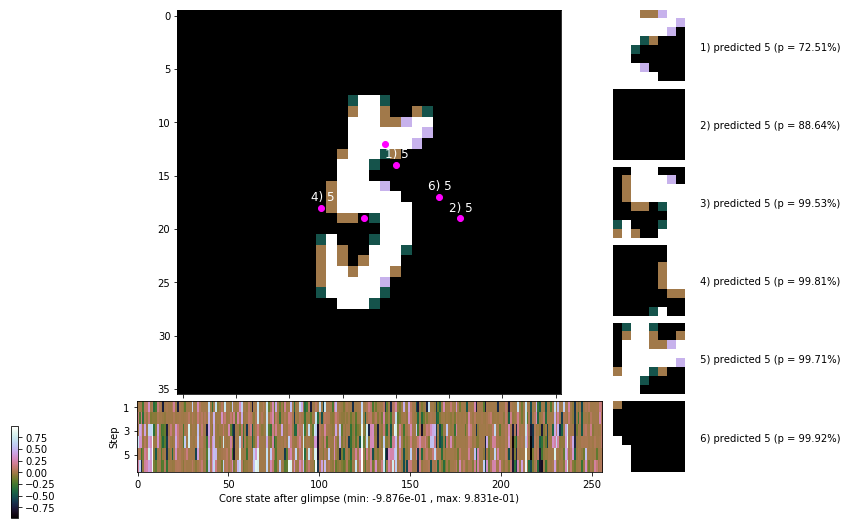


	Target class: 3 | Discounted rewards: [-0.554, -0.539, -0.389, 1.110, 1.100, 1.000]


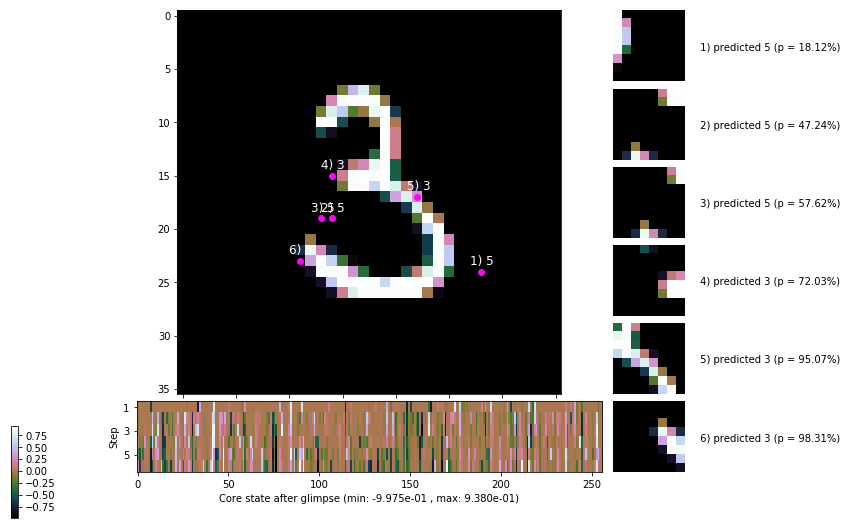

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


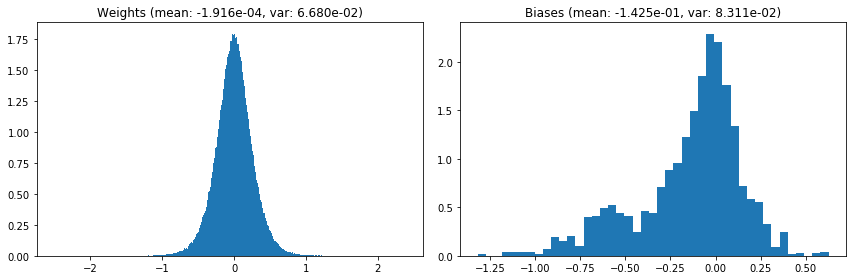

                                      Location network weights and biases


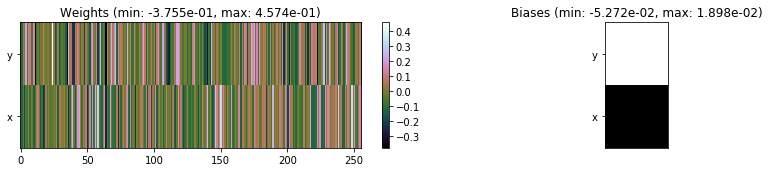

---------------------------------------------------------------------------------------------------------------
Elapsed time:  430.97 sec | TRAIN >> class loss: 0.2798 | steps:  2.215    | reward:  3.7774 :( | acc.: 90.717% :(
                          | VAL   >> class loss: 0.2527 | steps:  2.098 :( | reward:  4.0254 :( | acc.: 91.600% :(


Epoch  37/400) lr = 0.0005826
 b    300/  3000 >> 140.5 ms/b | lr: 5.82e-04 | grad 2norm: 10.46 | grad inf norm:  2.727
         Weights || abs max:  2.51 ( 1891.05) | mean: -1.87e-04 ( 0.01) | var: 6.68e-02 (  107.72)
          Biases || abs max:  1.32 (  226.11) | mean: -1.42e-01 ( 0.15) | var: 8.31e-02 (  995.74)
                    class loss: 0.281 | steps: 2.195 | reward:  3.819 | acc.: 90.83%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 140.1 ms/b | lr: 5.81e-04 | grad 2norm: 10.24 | grad inf norm:  2.702
         Weights || abs max:  2.52 ( 6177.78) | mean: -1.88e-04 (

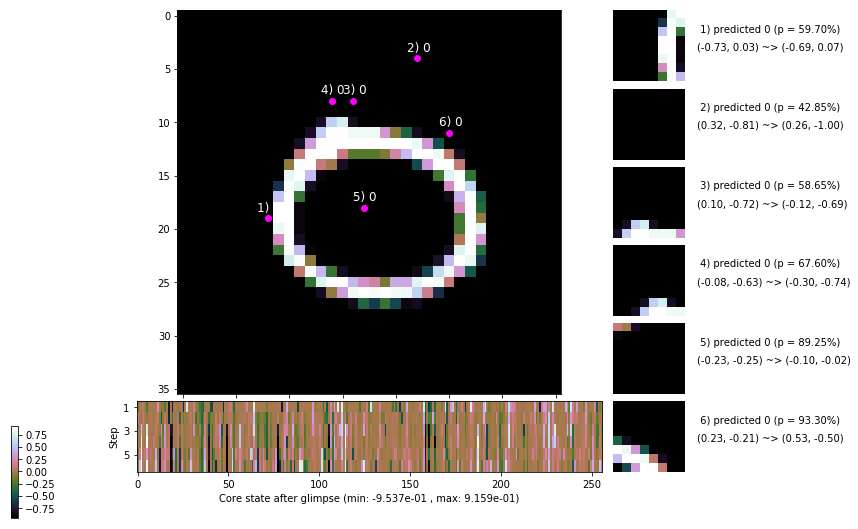

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.2 ms/b | lr: 5.80e-04 | grad 2norm: 10.70 | grad inf norm:  2.790
         Weights || abs max:  2.53 (39079.90) | mean: -1.92e-04 ( 0.08) | var: 6.70e-02 (268378.06)
          Biases || abs max:  1.30 (   81.36) | mean: -1.42e-01 ( 0.08) | var: 8.33e-02 (   68.98)
                    class loss: 0.309 | steps: 2.224 | reward:  3.727 | acc.: 89.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 140.0 ms/b | lr: 5.80e-04 | grad 2norm: 10.38 | grad inf norm:  2.681
         Weights || abs max:  2.52 ( 7658.66) | mean: -2.06e-04 ( 0.02) | var: 6.71e-02 ( 5599.55)
          Biases || abs max:  1.30 (  116.53) | mean: -1.43e-01 ( 0.10) | var: 8.36e-02 (   67.48)
                    class loss: 0.271 | steps: 2.205 | reward:  3.810 | acc.: 91.08%

	Target class: 2 | Discounted rewards: [-0.556, -0.556, 

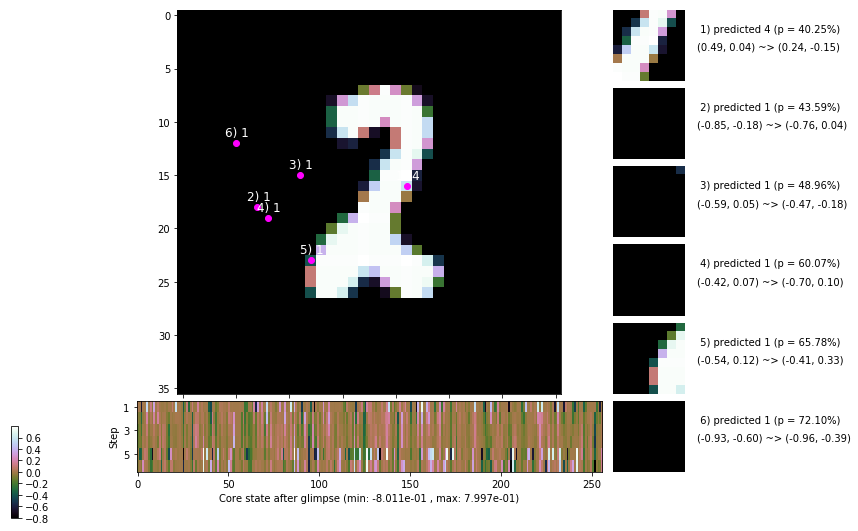

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.7 ms/b | lr: 5.79e-04 | grad 2norm: 10.13 | grad inf norm:  2.635
         Weights || abs max:  2.52 ( 4222.08) | mean: -2.18e-04 ( 0.02) | var: 6.71e-02 (  915.78)
          Biases || abs max:  1.30 (  258.56) | mean: -1.42e-01 ( 0.16) | var: 8.37e-02 ( 3084.33)
                    class loss: 0.271 | steps: 2.201 | reward:  3.823 | acc.: 91.02%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.7 ms/b | lr: 5.78e-04 | grad 2norm: 10.10 | grad inf norm:  2.716
         Weights || abs max:  2.52 ( 3724.75) | mean: -2.50e-04 ( 0.02) | var: 6.72e-02 (  702.40)
          Biases || abs max:  1.31 (   66.89) | mean: -1.42e-01 ( 0.08) | var: 8.36e-02 (   64.51)
                    class loss: 0.264 | steps: 2.171 | reward:  3.869 | acc.: 91.55%

	Target class: 4 | Discounted rewards: [-0.539, -0.389, 1

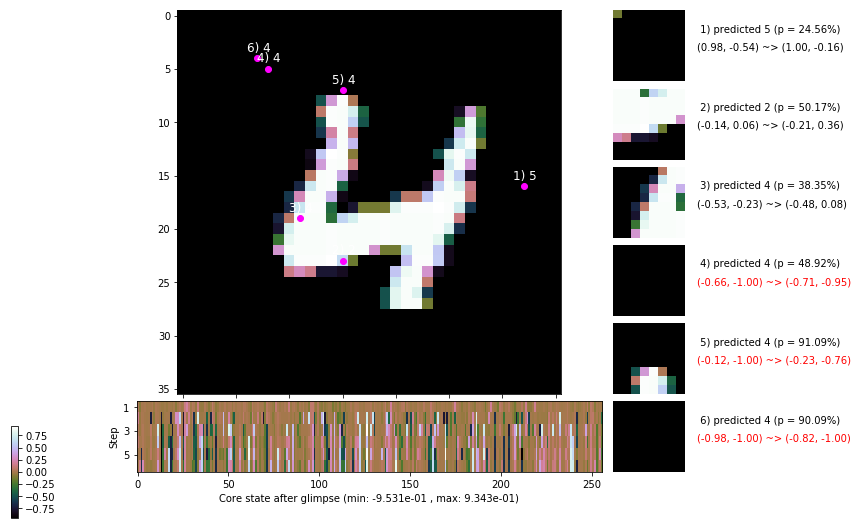

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.6 ms/b | lr: 5.77e-04 | grad 2norm: 10.61 | grad inf norm:  2.726
         Weights || abs max:  2.52 ( 8253.81) | mean: -2.63e-04 ( 0.02) | var: 6.73e-02 ( 3838.82)
          Biases || abs max:  1.32 (   68.85) | mean: -1.43e-01 ( 0.08) | var: 8.38e-02 (   46.14)
                    class loss: 0.297 | steps: 2.228 | reward:  3.740 | acc.: 89.98%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.1 ms/b | lr: 5.76e-04 | grad 2norm: 10.34 | grad inf norm:  2.725
         Weights || abs max:  2.52 ( 3664.22) | mean: -2.73e-04 ( 0.02) | var: 6.74e-02 (  481.56)
          Biases || abs max:  1.31 (  171.63) | mean: -1.43e-01 ( 0.13) | var: 8.39e-02 (  211.61)
                    class loss: 0.275 | steps: 2.186 | reward:  3.840 | acc.: 91.03%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

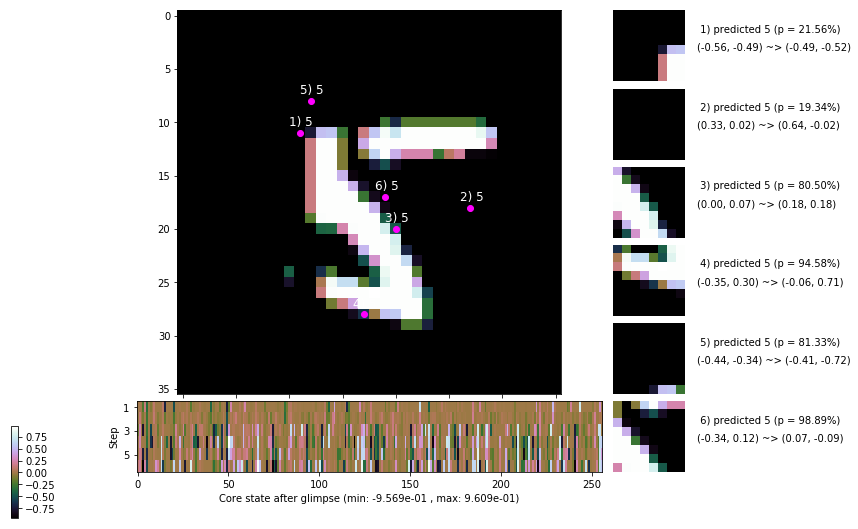

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 140.9 ms/b | lr: 5.75e-04 | grad 2norm: 10.78 | grad inf norm:  2.845
         Weights || abs max:  2.53 ( 1608.62) | mean: -2.80e-04 ( 0.01) | var: 6.74e-02 (   39.42)
          Biases || abs max:  1.32 (   95.10) | mean: -1.43e-01 ( 0.10) | var: 8.39e-02 (   26.82)
                    class loss: 0.286 | steps: 2.230 | reward:  3.747 | acc.: 90.42%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.3 ms/b | lr: 5.74e-04 | grad 2norm: 10.61 | grad inf norm:  2.724
         Weights || abs max:  2.53 ( 2711.49) | mean: -2.94e-04 ( 0.01) | var: 6.75e-02 (  144.64)
          Biases || abs max:  1.32 (  105.15) | mean: -1.43e-01 ( 0.11) | var: 8.41e-02 (   57.68)
                    class loss: 0.273 | steps: 2.211 | reward:  3.804 | acc.: 91.15%

	Target class: 8 | Discounted rewards: [-0.389, 1.111, 1.

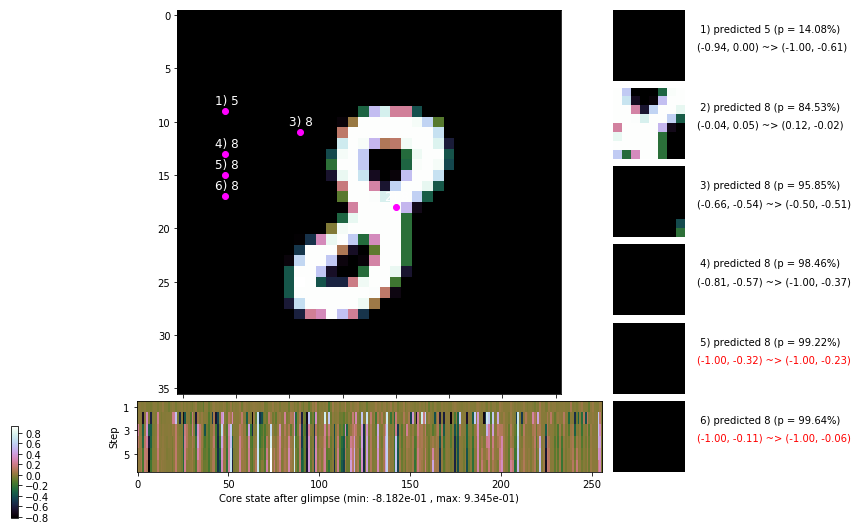

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


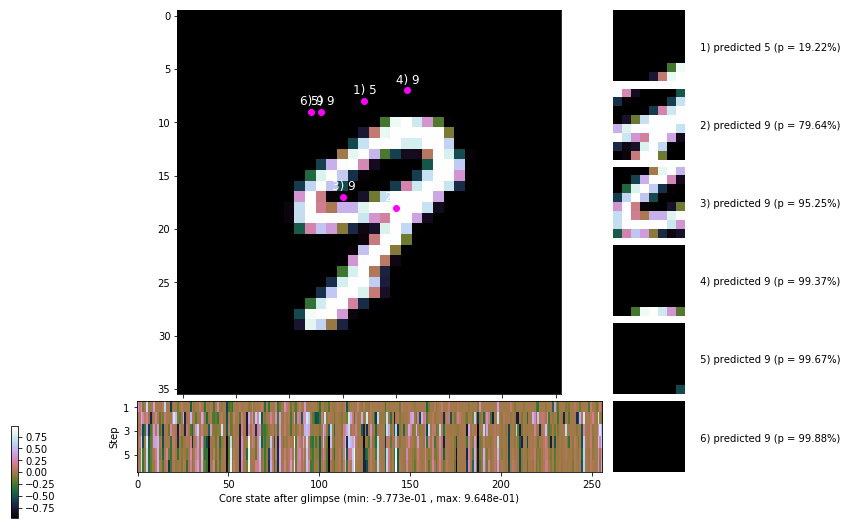


	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


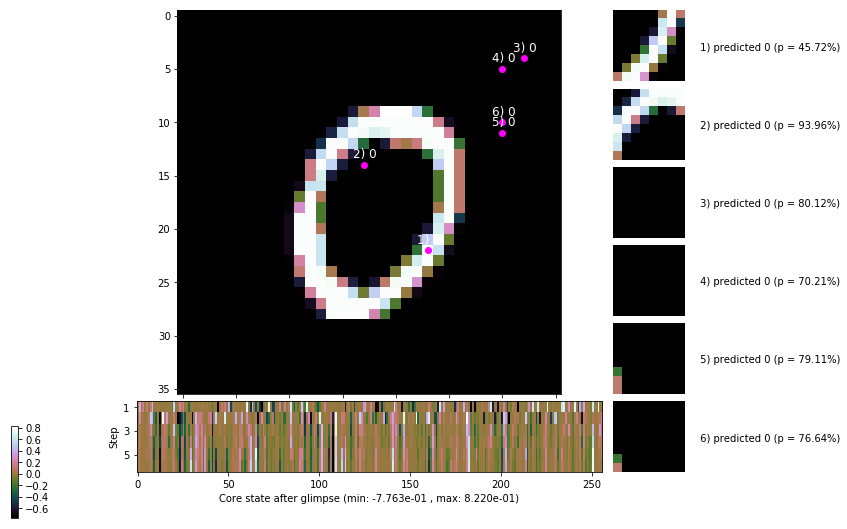

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


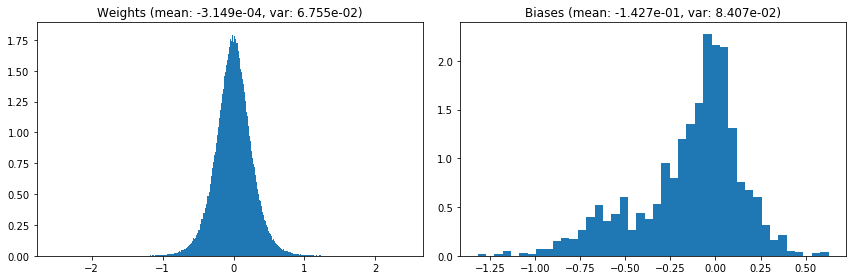

                                      Location network weights and biases


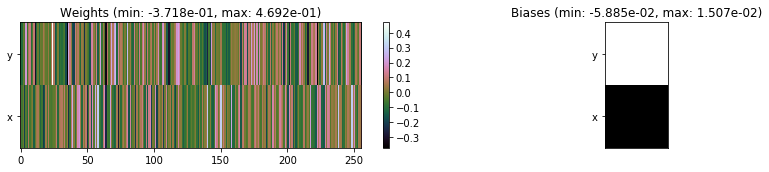

---------------------------------------------------------------------------------------------------------------
Elapsed time:  423.68 sec | TRAIN >> class loss: 0.2801 | steps:  2.204    | reward:  3.8033    | acc.: 90.760% :(
                          | VAL   >> class loss: 0.2386 | steps:  2.067    | reward:  4.0728    | acc.: 91.980% :(


Epoch  38/400) lr = 0.0005739
 b    300/  3000 >> 141.6 ms/b | lr: 5.73e-04 | grad 2norm: 10.21 | grad inf norm:  2.715
         Weights || abs max:  2.53 ( 2347.19) | mean: -3.16e-04 ( 0.01) | var: 6.76e-02 (  105.54)
          Biases || abs max:  1.32 (   99.37) | mean: -1.43e-01 ( 0.09) | var: 8.41e-02 (   47.62)
                    class loss: 0.256 | steps: 2.199 | reward:  3.834 | acc.: 91.93%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.9 ms/b | lr: 5.73e-04 | grad 2norm: 10.36 | grad inf norm:  2.807
         Weights || abs max:  2.51 ( 6920.00) | mean: -3.30e-04 (

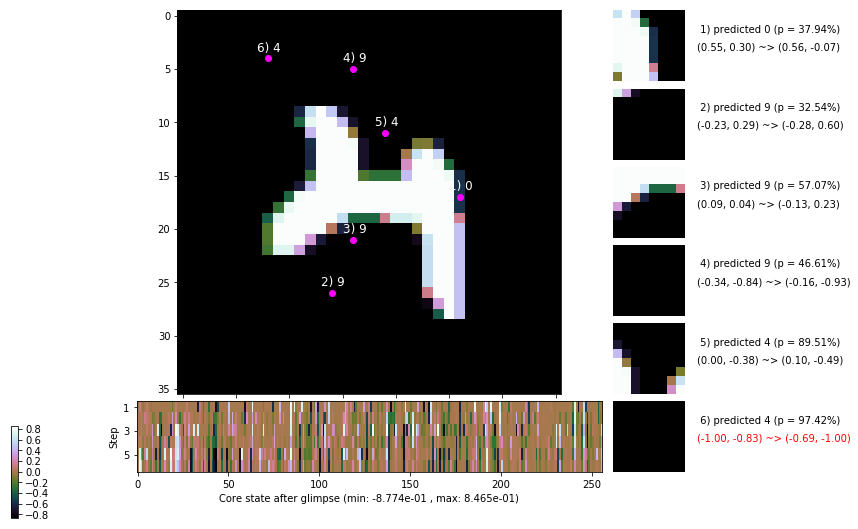

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 163.4 ms/b | lr: 5.72e-04 | grad 2norm: 10.19 | grad inf norm:  2.688
         Weights || abs max:  2.51 ( 5509.36) | mean: -3.51e-04 ( 0.02) | var: 6.77e-02 ( 2184.12)
          Biases || abs max:  1.32 (  124.02) | mean: -1.43e-01 ( 0.11) | var: 8.41e-02 (  154.23)
                    class loss: 0.270 | steps: 2.216 | reward:  3.808 | acc.: 91.18%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 142.3 ms/b | lr: 5.71e-04 | grad 2norm: 10.58 | grad inf norm:  2.778
         Weights || abs max:  2.52 ( 2659.36) | mean: -3.64e-04 ( 0.01) | var: 6.78e-02 (  178.37)
          Biases || abs max:  1.31 (  148.12) | mean: -1.44e-01 ( 0.12) | var: 8.43e-02 (  365.07)
                    class loss: 0.286 | steps: 2.193 | reward:  3.800 | acc.: 90.87%

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1.

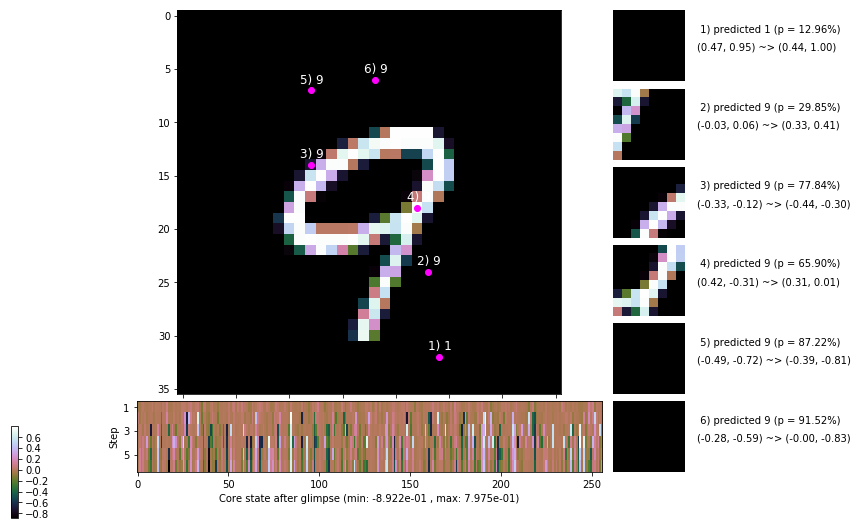

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.6 ms/b | lr: 5.70e-04 | grad 2norm: 10.40 | grad inf norm:  2.748
         Weights || abs max:  2.52 (49248.61) | mean: -3.84e-04 ( 0.10) | var: 6.79e-02 (1147331.25)
          Biases || abs max:  1.31 (  183.46) | mean: -1.44e-01 ( 0.13) | var: 8.43e-02 (  308.55)
                    class loss: 0.266 | steps: 2.196 | reward:  3.819 | acc.: 91.23%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.2 ms/b | lr: 5.69e-04 | grad 2norm: 10.44 | grad inf norm:  2.704
         Weights || abs max:  2.53 ( 5793.72) | mean: -3.76e-04 ( 0.02) | var: 6.80e-02 ( 3165.78)
          Biases || abs max:  1.31 (   98.93) | mean: -1.44e-01 ( 0.10) | var: 8.44e-02 (   62.56)
                    class loss: 0.270 | steps: 2.163 | reward:  3.846 | acc.: 90.88%

	Target class: 3 | Discounted rewards: [-0.391, 1.094, 

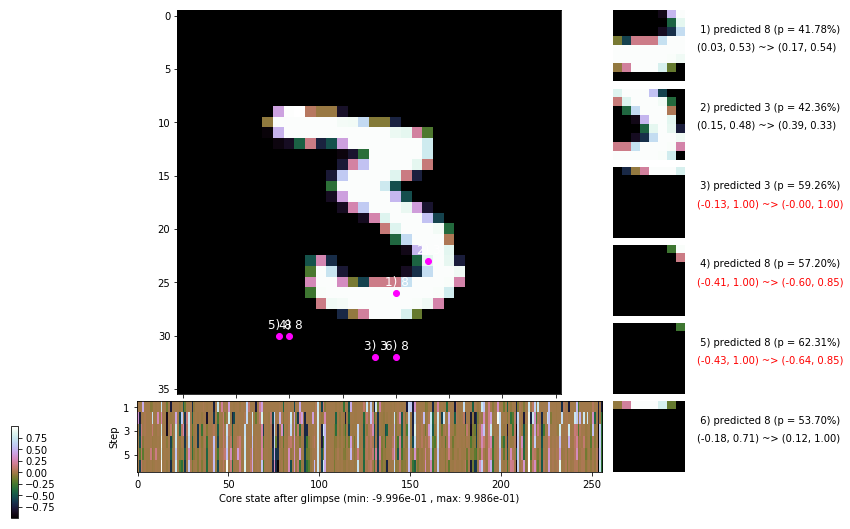

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.8 ms/b | lr: 5.68e-04 | grad 2norm: 10.69 | grad inf norm:  2.709
         Weights || abs max:  2.52 ( 3484.17) | mean: -3.60e-04 ( 0.01) | var: 6.80e-02 (  489.27)
          Biases || abs max:  1.30 (  247.72) | mean: -1.44e-01 ( 0.16) | var: 8.45e-02 ( 1172.47)
                    class loss: 0.282 | steps: 2.193 | reward:  3.807 | acc.: 90.48%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.6 ms/b | lr: 5.68e-04 | grad 2norm: 10.20 | grad inf norm:  2.650
         Weights || abs max:  2.52 ( 3950.85) | mean: -3.64e-04 ( 0.02) | var: 6.81e-02 (  681.97)
          Biases || abs max:  1.30 (  155.21) | mean: -1.44e-01 ( 0.12) | var: 8.49e-02 (  190.13)
                    class loss: 0.263 | steps: 2.171 | reward:  3.876 | acc.: 91.53%

	Target class: 3 | Discounted rewards: [-0.406, 0.945, -0

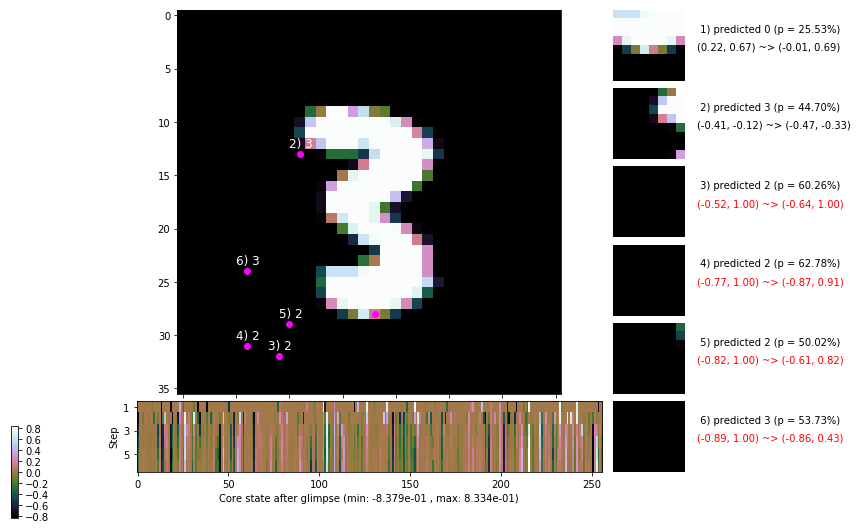

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.6 ms/b | lr: 5.66e-04 | grad 2norm: 10.36 | grad inf norm:  2.717
         Weights || abs max:  2.52 ( 2299.40) | mean: -3.85e-04 ( 0.01) | var: 6.82e-02 (  107.88)
          Biases || abs max:  1.30 (   74.00) | mean: -1.44e-01 ( 0.08) | var: 8.52e-02 (   20.25)
                    class loss: 0.262 | steps: 2.161 | reward:  3.867 | acc.: 91.33%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 139.4 ms/b | lr: 5.66e-04 | grad 2norm: 10.62 | grad inf norm:  2.839
         Weights || abs max:  2.53 ( 2931.72) | mean: -4.07e-04 ( 0.01) | var: 6.82e-02 (  182.98)
          Biases || abs max:  1.30 (   85.00) | mean: -1.44e-01 ( 0.09) | var: 8.54e-02 (  131.66)
                    class loss: 0.265 | steps: 2.195 | reward:  3.801 | acc.: 90.97%

	Target class: 9 | Discounted rewards: [-0.539, -0.391, 1

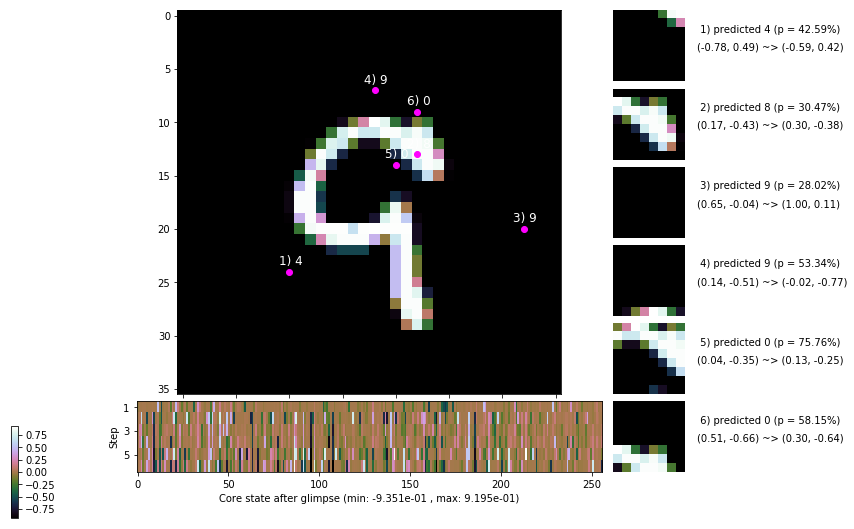

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [-0.554, -0.540, -0.404, 0.960, -0.400, 1.000]


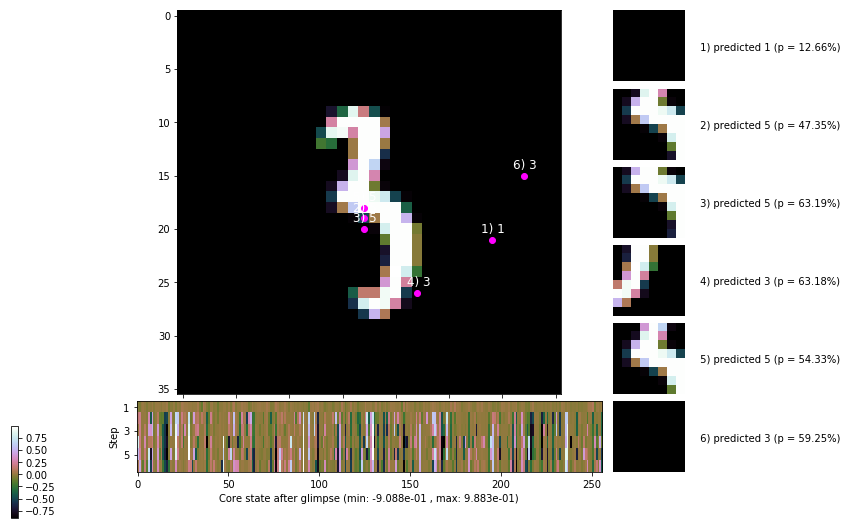


	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


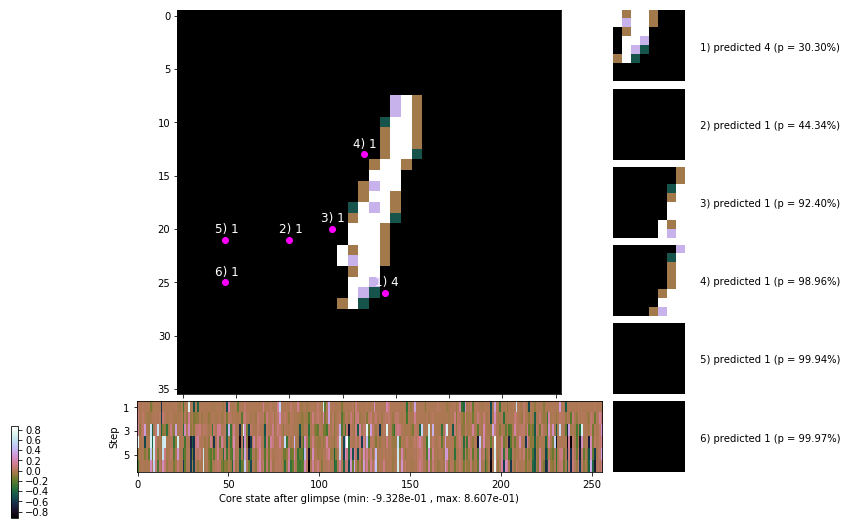

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


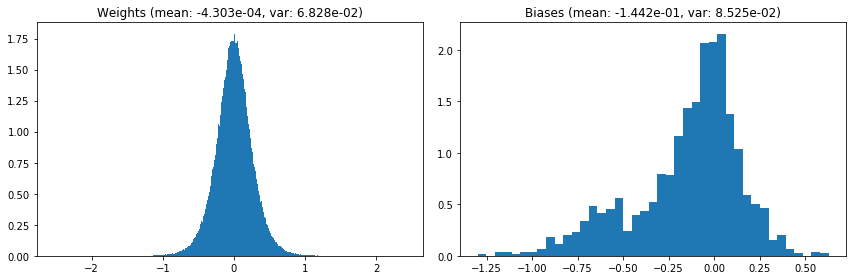

                                      Location network weights and biases


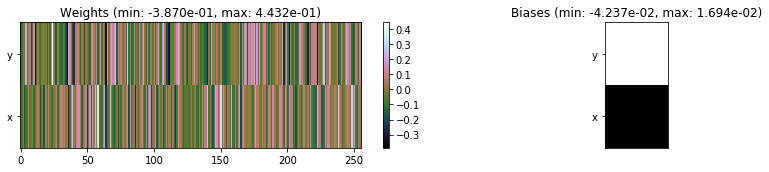

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.82 sec | TRAIN >> class loss: 0.2689 | steps:  2.191    | reward:  3.8259    | acc.: 91.157% :(
                          | VAL   >> class loss: 0.2800 | steps:  2.101 :( | reward:  3.9843 :( | acc.: 91.000% :(


Epoch  39/400) lr = 0.0005654
 b    300/  3000 >> 141.9 ms/b | lr: 5.65e-04 | grad 2norm: 10.41 | grad inf norm:  2.716
         Weights || abs max:  2.53 ( 4132.04) | mean: -4.36e-04 ( 0.02) | var: 6.83e-02 (  927.48)
          Biases || abs max:  1.30 (   68.34) | mean: -1.44e-01 ( 0.08) | var: 8.52e-02 (   16.26)
                    class loss: 0.264 | steps: 2.179 | reward:  3.840 | acc.: 91.42%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 140.5 ms/b | lr: 5.64e-04 | grad 2norm: 10.21 | grad inf norm:  2.597
         Weights || abs max:  2.54 (26682.46) | mean: -4.31e-04 (

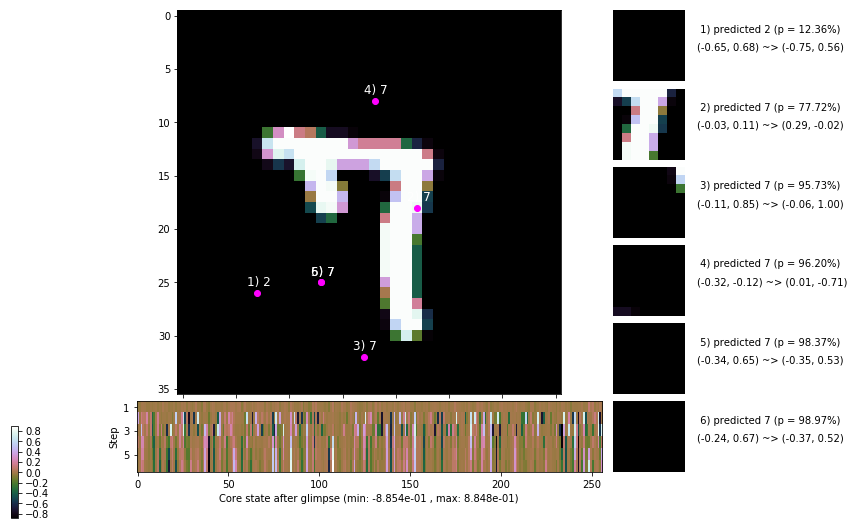

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.2 ms/b | lr: 5.63e-04 | grad 2norm: 10.05 | grad inf norm:  2.666
         Weights || abs max:  2.54 ( 2712.02) | mean: -4.30e-04 ( 0.01) | var: 6.84e-02 (   81.68)
          Biases || abs max:  1.31 (  125.88) | mean: -1.44e-01 ( 0.11) | var: 8.53e-02 (  109.43)
                    class loss: 0.253 | steps: 2.183 | reward:  3.839 | acc.: 91.47%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 140.0 ms/b | lr: 5.63e-04 | grad 2norm: 10.80 | grad inf norm:  2.881
         Weights || abs max:  2.55 ( 2940.37) | mean: -4.36e-04 ( 0.01) | var: 6.85e-02 (  184.49)
          Biases || abs max:  1.31 (  135.11) | mean: -1.44e-01 ( 0.13) | var: 8.54e-02 (  306.13)
                    class loss: 0.291 | steps: 2.187 | reward:  3.789 | acc.: 90.35%

	Target class: 2 | Discounted rewards: [-0.555, -0.554, -

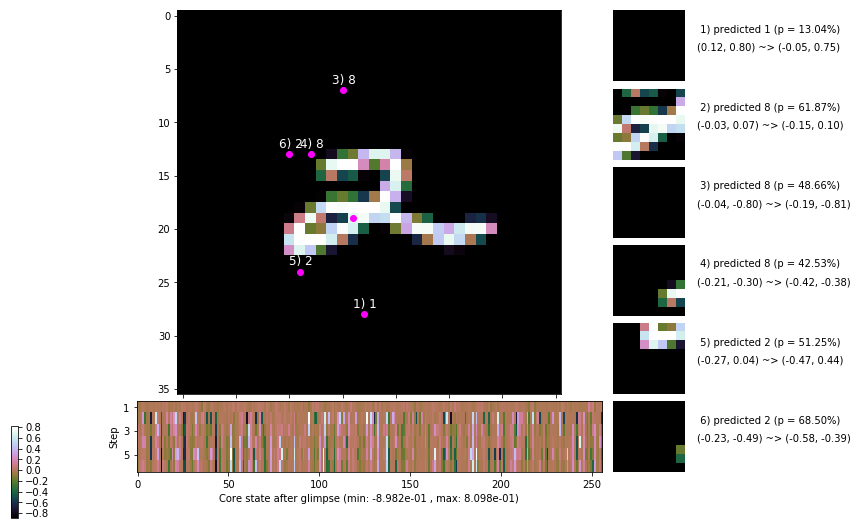

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.8 ms/b | lr: 5.61e-04 | grad 2norm: 10.56 | grad inf norm:  2.777
         Weights || abs max:  2.55 ( 7657.28) | mean: -4.15e-04 ( 0.02) | var: 6.86e-02 ( 4178.45)
          Biases || abs max:  1.31 (  133.24) | mean: -1.44e-01 ( 0.10) | var: 8.55e-02 (   70.90)
                    class loss: 0.270 | steps: 2.204 | reward:  3.810 | acc.: 91.05%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 150.2 ms/b | lr: 5.61e-04 | grad 2norm: 10.57 | grad inf norm:  2.722
         Weights || abs max:  2.56 ( 4297.33) | mean: -4.54e-04 ( 0.02) | var: 6.87e-02 ( 1738.77)
          Biases || abs max:  1.30 (   65.24) | mean: -1.44e-01 ( 0.07) | var: 8.54e-02 (   15.49)
                    class loss: 0.268 | steps: 2.194 | reward:  3.829 | acc.: 91.27%

	Target class: 9 | Discounted rewards: [-0.555, -0.554, -

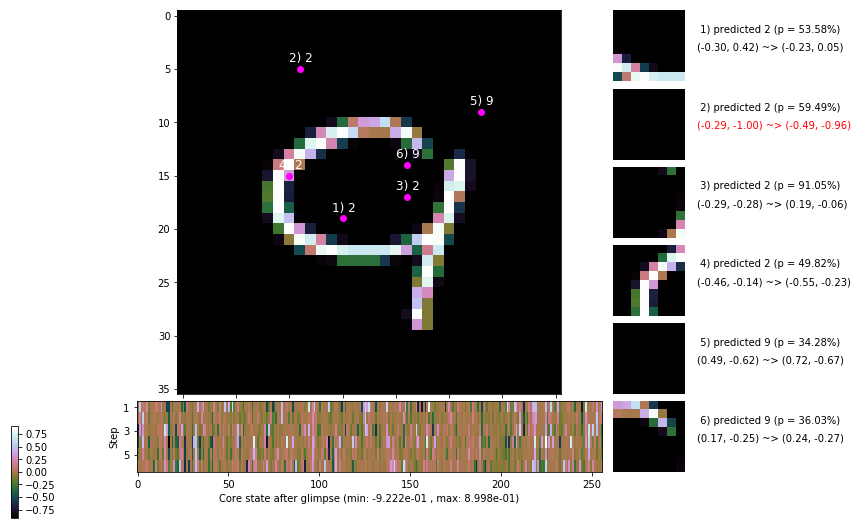

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.4 ms/b | lr: 5.60e-04 | grad 2norm: 10.54 | grad inf norm:  2.733
         Weights || abs max:  2.56 ( 2282.30) | mean: -4.61e-04 ( 0.01) | var: 6.87e-02 (   84.48)
          Biases || abs max:  1.31 (   79.61) | mean: -1.44e-01 ( 0.09) | var: 8.55e-02 (   68.97)
                    class loss: 0.268 | steps: 2.217 | reward:  3.800 | acc.: 91.22%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.7 ms/b | lr: 5.59e-04 | grad 2norm: 10.35 | grad inf norm:  2.714
         Weights || abs max:  2.57 ( 2811.16) | mean: -4.53e-04 ( 0.01) | var: 6.88e-02 (  125.64)
          Biases || abs max:  1.31 (  315.54) | mean: -1.44e-01 ( 0.22) | var: 8.54e-02 ( 5116.03)
                    class loss: 0.246 | steps: 2.143 | reward:  3.896 | acc.: 91.67%

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.

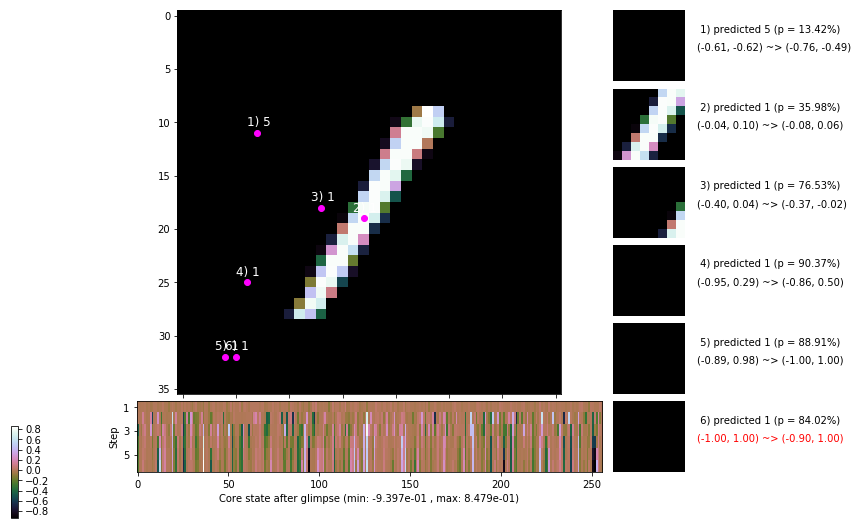

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.2 ms/b | lr: 5.58e-04 | grad 2norm: 10.54 | grad inf norm:  2.704
         Weights || abs max:  2.58 (27523.29) | mean: -4.50e-04 ( 0.06) | var: 6.89e-02 (348251.97)
          Biases || abs max:  1.30 (  262.04) | mean: -1.44e-01 ( 0.18) | var: 8.56e-02 ( 1115.79)
                    class loss: 0.283 | steps: 2.201 | reward:  3.808 | acc.: 90.90%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 139.6 ms/b | lr: 5.58e-04 | grad 2norm: 10.54 | grad inf norm:  2.771
         Weights || abs max:  2.58 ( 3713.23) | mean: -4.32e-04 ( 0.02) | var: 6.89e-02 (  424.66)
          Biases || abs max:  1.31 (   99.98) | mean: -1.45e-01 ( 0.10) | var: 8.59e-02 (   89.21)
                    class loss: 0.290 | steps: 2.206 | reward:  3.792 | acc.: 90.37%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.

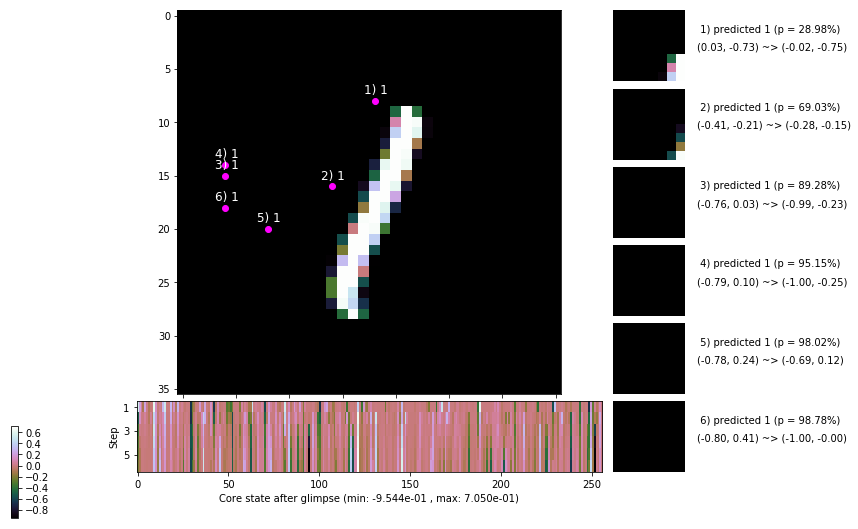

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


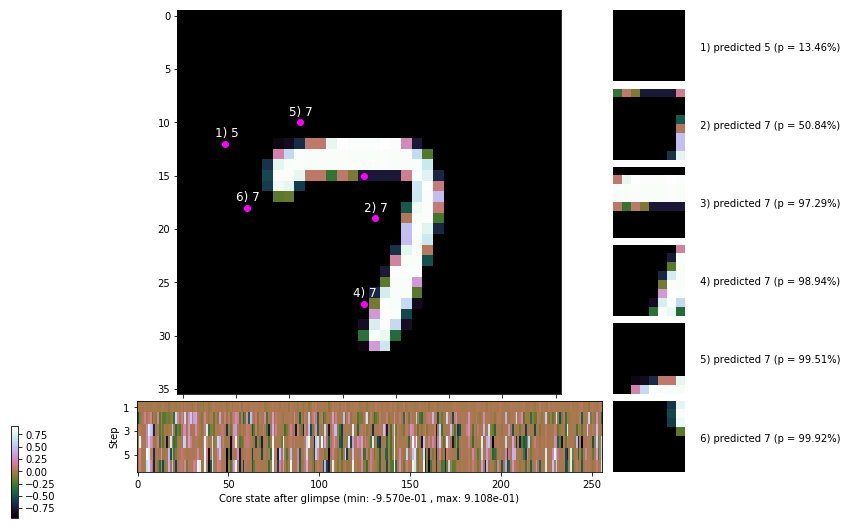


	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


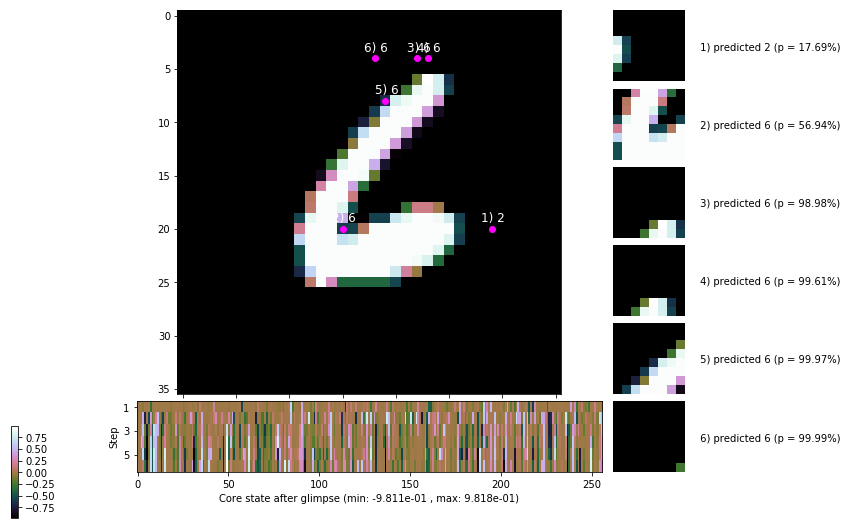

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


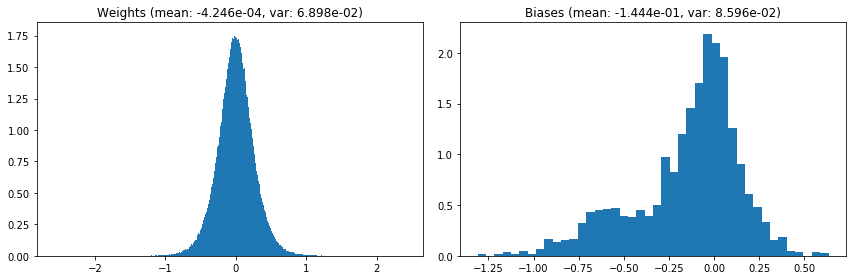

                                      Location network weights and biases


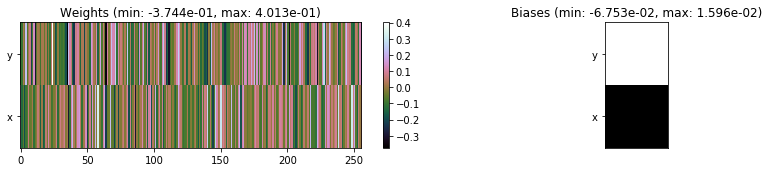

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.09 sec | TRAIN >> class loss: 0.2689 | steps:  2.190    | reward:  3.8260    | acc.: 91.133% :(
                          | VAL   >> class loss: 0.2819 | steps:  2.114 :( | reward:  3.9576 :( | acc.: 90.340% :(


Epoch  40/400) lr = 0.0005569
 b    300/  3000 >> 138.1 ms/b | lr: 5.56e-04 | grad 2norm: 10.06 | grad inf norm:  2.510
         Weights || abs max:  2.59 ( 5302.27) | mean: -4.38e-04 ( 0.02) | var: 6.90e-02 ( 1028.88)
          Biases || abs max:  1.31 (  121.40) | mean: -1.45e-01 ( 0.10) | var: 8.62e-02 (  313.68)
                    class loss: 0.284 | steps: 2.179 | reward:  3.828 | acc.: 90.75%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 140.7 ms/b | lr: 5.56e-04 | grad 2norm: 10.35 | grad inf norm:  2.786
         Weights || abs max:  2.59 ( 2945.04) | mean: -4.53e-04 (

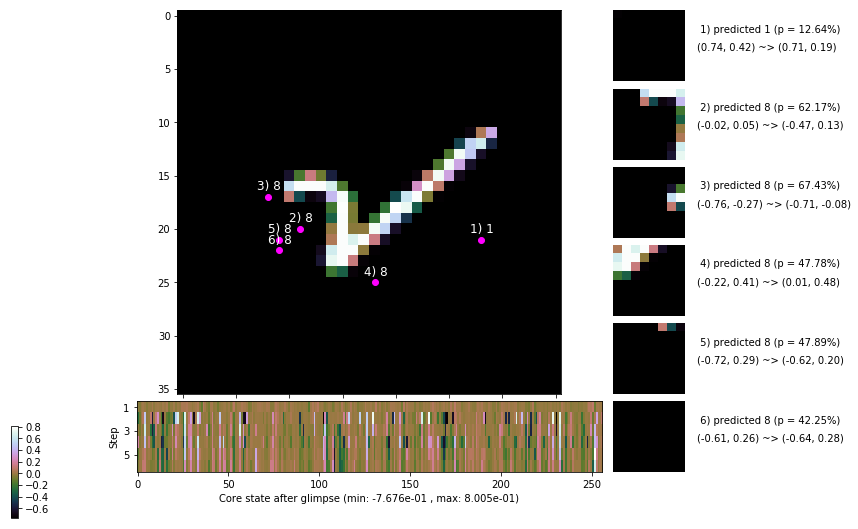

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.3 ms/b | lr: 5.55e-04 | grad 2norm: 10.25 | grad inf norm:  2.613
         Weights || abs max:  2.59 ( 3179.30) | mean: -4.69e-04 ( 0.01) | var: 6.92e-02 (  274.61)
          Biases || abs max:  1.32 (  118.76) | mean: -1.44e-01 ( 0.11) | var: 8.61e-02 (  137.96)
                    class loss: 0.283 | steps: 2.200 | reward:  3.833 | acc.: 91.17%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.8 ms/b | lr: 5.54e-04 | grad 2norm: 10.35 | grad inf norm:  2.733
         Weights || abs max:  2.60 ( 2941.02) | mean: -4.82e-04 ( 0.01) | var: 6.92e-02 (  250.63)
          Biases || abs max:  1.32 (  157.83) | mean: -1.44e-01 ( 0.13) | var: 8.61e-02 (  424.87)
                    class loss: 0.282 | steps: 2.202 | reward:  3.797 | acc.: 90.73%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

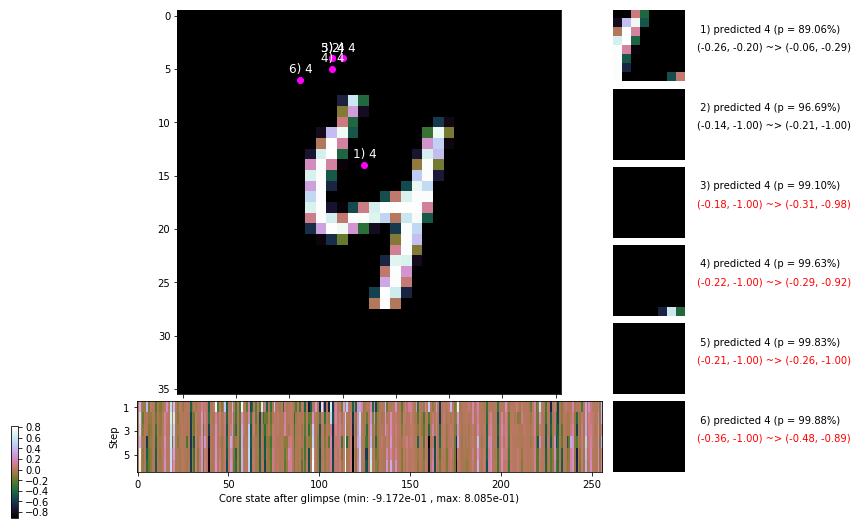

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.8 ms/b | lr: 5.53e-04 | grad 2norm: 10.09 | grad inf norm:  2.579
         Weights || abs max:  2.60 ( 3901.68) | mean: -4.83e-04 ( 0.02) | var: 6.93e-02 (  426.02)
          Biases || abs max:  1.32 (   65.49) | mean: -1.45e-01 ( 0.08) | var: 8.63e-02 (   30.48)
                    class loss: 0.292 | steps: 2.187 | reward:  3.846 | acc.: 91.42%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.2 ms/b | lr: 5.53e-04 | grad 2norm: 10.32 | grad inf norm:  2.729
         Weights || abs max:  2.60 (13021.67) | mean: -4.77e-04 ( 0.03) | var: 6.93e-02 (20706.84)
          Biases || abs max:  1.32 (  162.89) | mean: -1.45e-01 ( 0.12) | var: 8.64e-02 (  282.11)
                    class loss: 0.274 | steps: 2.184 | reward:  3.838 | acc.: 90.98%

	Target class: 2 | Discounted rewards: [-0.555, -0.554, -

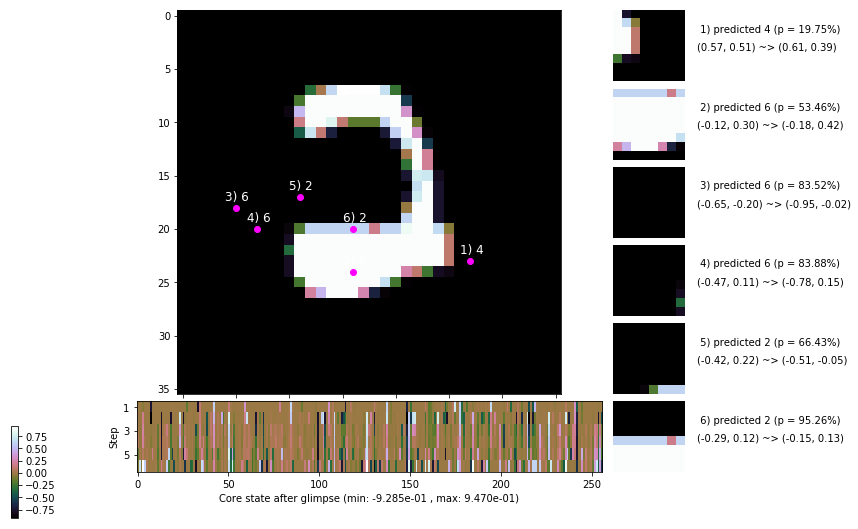

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.5 ms/b | lr: 5.51e-04 | grad 2norm: 10.61 | grad inf norm:  2.766
         Weights || abs max:  2.61 ( 3666.93) | mean: -4.94e-04 ( 0.01) | var: 6.94e-02 (  516.65)
          Biases || abs max:  1.32 (   80.68) | mean: -1.45e-01 ( 0.09) | var: 8.65e-02 (   23.52)
                    class loss: 0.285 | steps: 2.209 | reward:  3.795 | acc.: 90.23%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.1 ms/b | lr: 5.51e-04 | grad 2norm: 10.28 | grad inf norm:  2.618
         Weights || abs max:  2.61 (10451.07) | mean: -5.00e-04 ( 0.03) | var: 6.95e-02 (24849.53)
          Biases || abs max:  1.31 (  202.60) | mean: -1.45e-01 ( 0.17) | var: 8.66e-02 (  729.94)
                    class loss: 0.293 | steps: 2.178 | reward:  3.841 | acc.: 90.52%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

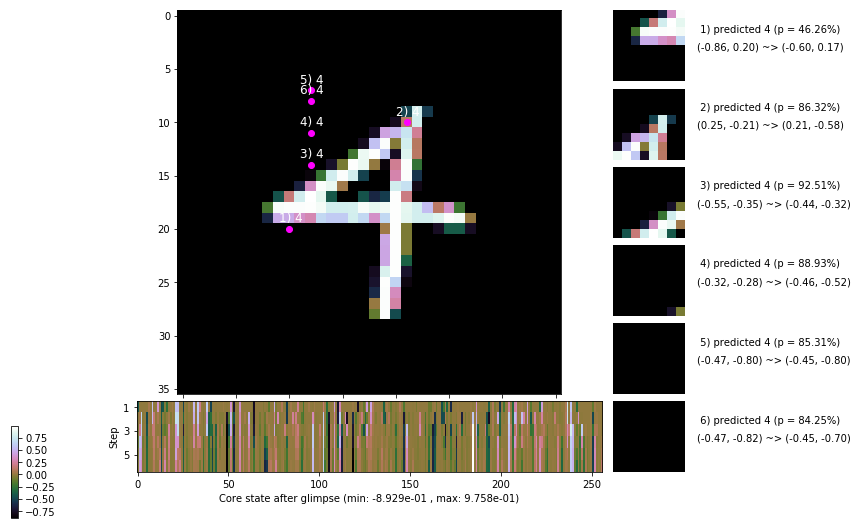

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.3 ms/b | lr: 5.50e-04 | grad 2norm: 10.80 | grad inf norm:  2.908
         Weights || abs max:  2.61 ( 4476.90) | mean: -4.93e-04 ( 0.02) | var: 6.95e-02 (  406.95)
          Biases || abs max:  1.30 (   86.50) | mean: -1.45e-01 ( 0.09) | var: 8.67e-02 (   17.93)
                    class loss: 0.302 | steps: 2.203 | reward:  3.791 | acc.: 90.27%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.1 ms/b | lr: 5.49e-04 | grad 2norm: 10.29 | grad inf norm:  2.764
         Weights || abs max:  2.62 ( 3505.06) | mean: -4.90e-04 ( 0.02) | var: 6.96e-02 (  670.66)
          Biases || abs max:  1.30 (  128.98) | mean: -1.44e-01 ( 0.11) | var: 8.67e-02 (  486.45)
                    class loss: 0.287 | steps: 2.179 | reward:  3.838 | acc.: 90.33%

	Target class: 5 | Discounted rewards: [-0.389, 1.111, 1.

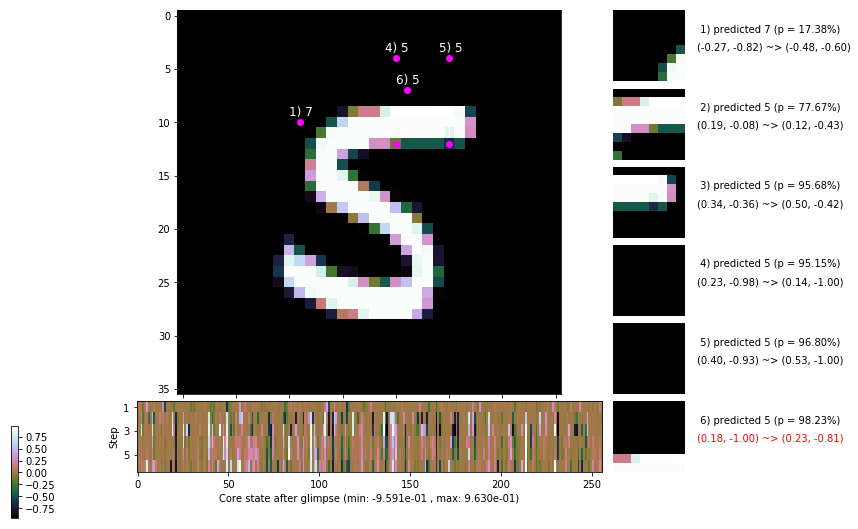

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [-0.556, -0.556, -0.556, -0.555, -0.550, -0.500]


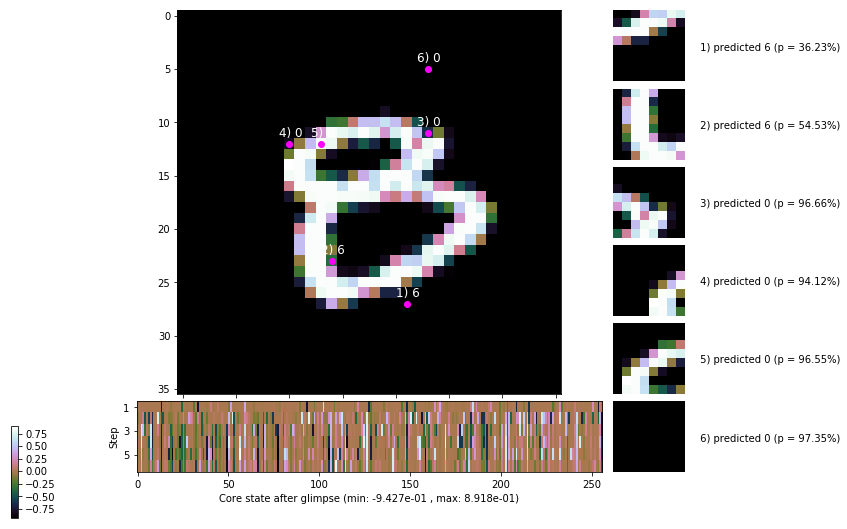


	Target class: 8 | Discounted rewards: [-0.556, -0.556, -0.556, -0.555, -0.550, -0.500]


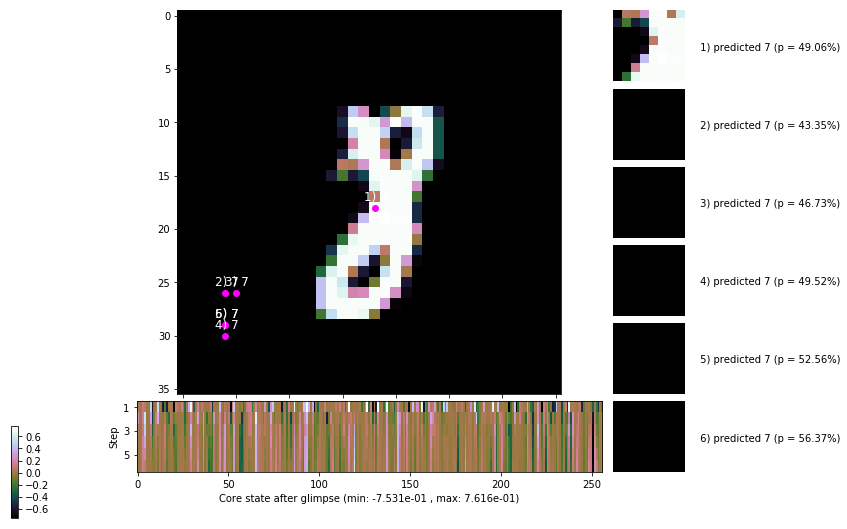

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


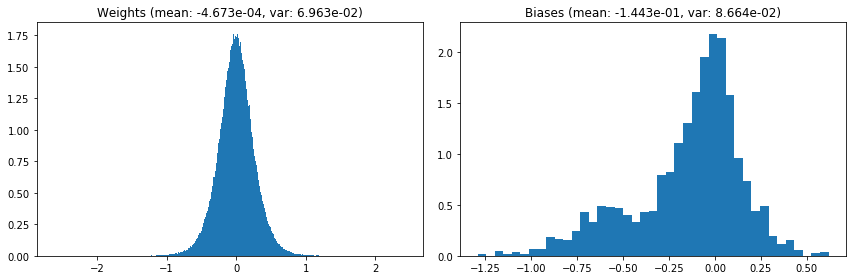

                                      Location network weights and biases


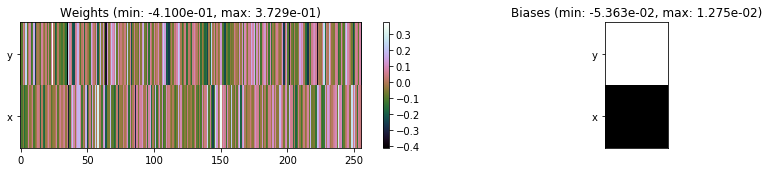

---------------------------------------------------------------------------------------------------------------
Elapsed time:  429.41 sec | TRAIN >> class loss: 0.2868 | steps:  2.192 :( | reward:  3.8200 :( | acc.: 90.670% :(
                          | VAL   >> class loss: 0.2810 | steps:  2.103 :( | reward:  3.9882 :( | acc.: 90.360% :(


Epoch  41/400) lr = 0.0005486
 b    300/  3000 >> 142.4 ms/b | lr: 5.48e-04 | grad 2norm: 10.33 | grad inf norm:  2.659
         Weights || abs max:  2.61 ( 3215.10) | mean: -4.65e-04 ( 0.02) | var: 6.97e-02 (  131.08)
          Biases || abs max:  1.29 (  134.06) | mean: -1.44e-01 ( 0.12) | var: 8.66e-02 (   30.68)
                    class loss: 0.282 | steps: 2.201 | reward:  3.820 | acc.: 90.75%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 140.7 ms/b | lr: 5.48e-04 | grad 2norm: 10.63 | grad inf norm:  2.852
         Weights || abs max:  2.61 ( 2137.96) | mean: -4.77e-04 (

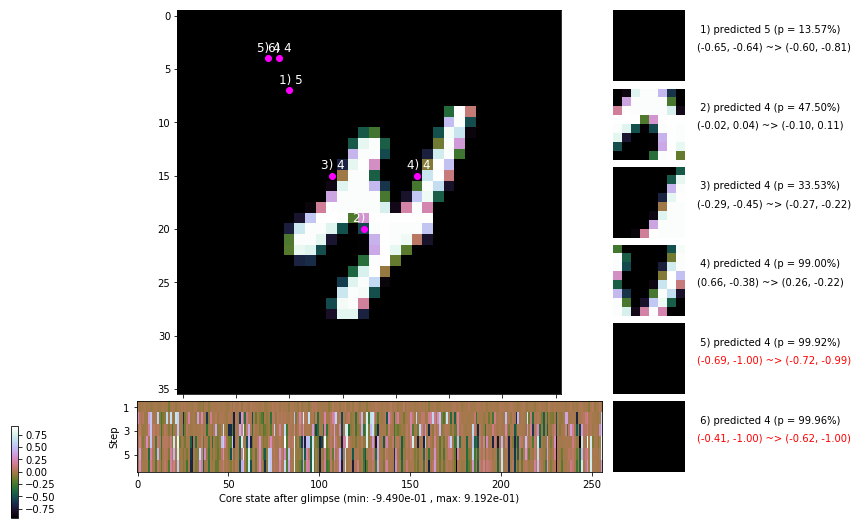

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.9 ms/b | lr: 5.46e-04 | grad 2norm: 10.16 | grad inf norm:  2.680
         Weights || abs max:  2.61 ( 3791.92) | mean: -4.58e-04 ( 0.02) | var: 6.98e-02 ( 1044.14)
          Biases || abs max:  1.28 (  467.78) | mean: -1.45e-01 ( 0.25) | var: 8.70e-02 (13595.81)
                    class loss: 0.294 | steps: 2.173 | reward:  3.833 | acc.: 90.63%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.9 ms/b | lr: 5.46e-04 | grad 2norm: 10.32 | grad inf norm:  2.724
         Weights || abs max:  2.61 ( 6633.48) | mean: -4.52e-04 ( 0.02) | var: 6.98e-02 ( 4790.82)
          Biases || abs max:  1.28 ( 1023.03) | mean: -1.45e-01 ( 0.47) | var: 8.73e-02 (31216.24)
                    class loss: 0.300 | steps: 2.205 | reward:  3.780 | acc.: 90.03%

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.1

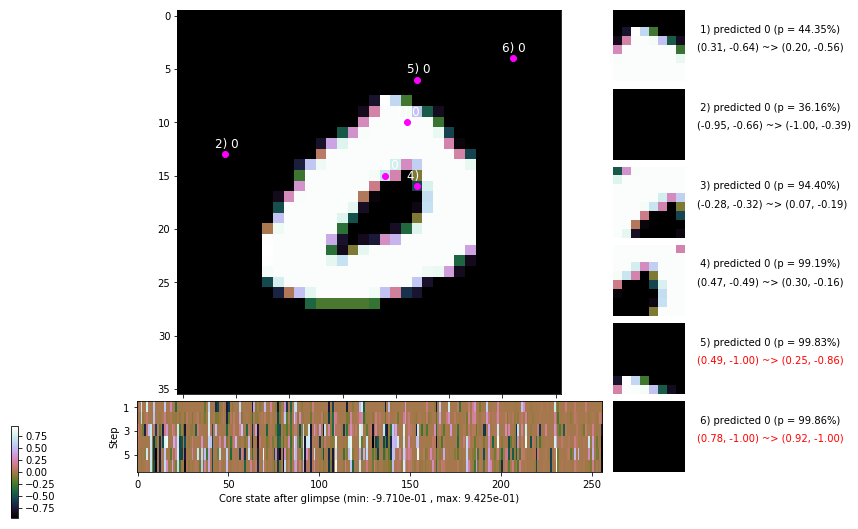

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 140.9 ms/b | lr: 5.45e-04 | grad 2norm: 10.28 | grad inf norm:  2.667
         Weights || abs max:  2.61 ( 7186.17) | mean: -4.53e-04 ( 0.02) | var: 6.99e-02 ( 9074.81)
          Biases || abs max:  1.28 (  124.72) | mean: -1.45e-01 ( 0.12) | var: 8.73e-02 (   65.86)
                    class loss: 0.280 | steps: 2.213 | reward:  3.808 | acc.: 90.68%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.0 ms/b | lr: 5.44e-04 | grad 2norm: 10.33 | grad inf norm:  2.708
         Weights || abs max:  2.61 ( 9917.70) | mean: -4.32e-04 ( 0.03) | var: 7.00e-02 (12463.81)
          Biases || abs max:  1.28 (  266.45) | mean: -1.46e-01 ( 0.16) | var: 8.73e-02 ( 3558.08)
                    class loss: 0.281 | steps: 2.208 | reward:  3.803 | acc.: 90.73%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

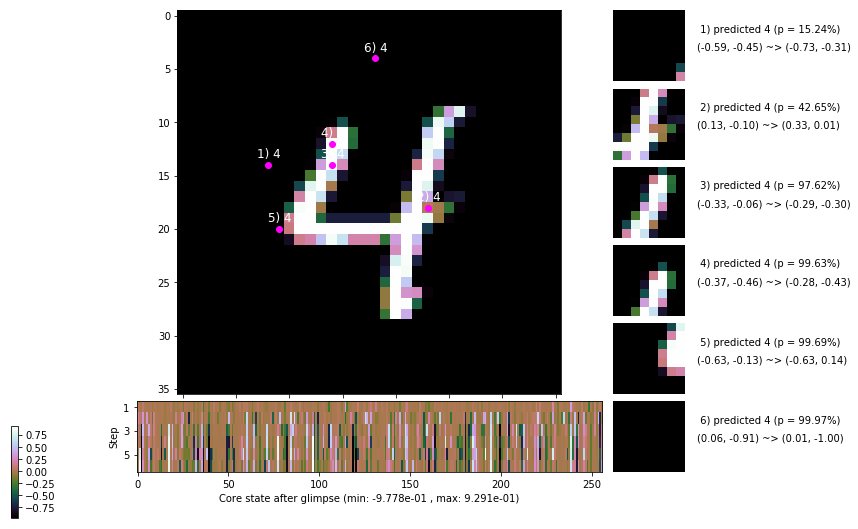

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 143.3 ms/b | lr: 5.43e-04 | grad 2norm: 10.28 | grad inf norm:  2.723
         Weights || abs max:  2.60 ( 3129.04) | mean: -4.40e-04 ( 0.01) | var: 7.00e-02 (  411.21)
          Biases || abs max:  1.29 (  139.21) | mean: -1.46e-01 ( 0.12) | var: 8.74e-02 (  188.12)
                    class loss: 0.294 | steps: 2.201 | reward:  3.809 | acc.: 90.52%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.0 ms/b | lr: 5.43e-04 | grad 2norm: 10.35 | grad inf norm:  2.707
         Weights || abs max:  2.61 ( 4466.00) | mean: -4.59e-04 ( 0.02) | var: 7.01e-02 (  571.13)
          Biases || abs max:  1.31 (  226.53) | mean: -1.46e-01 ( 0.15) | var: 8.73e-02 (  963.19)
                    class loss: 0.302 | steps: 2.212 | reward:  3.752 | acc.: 89.70%

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.

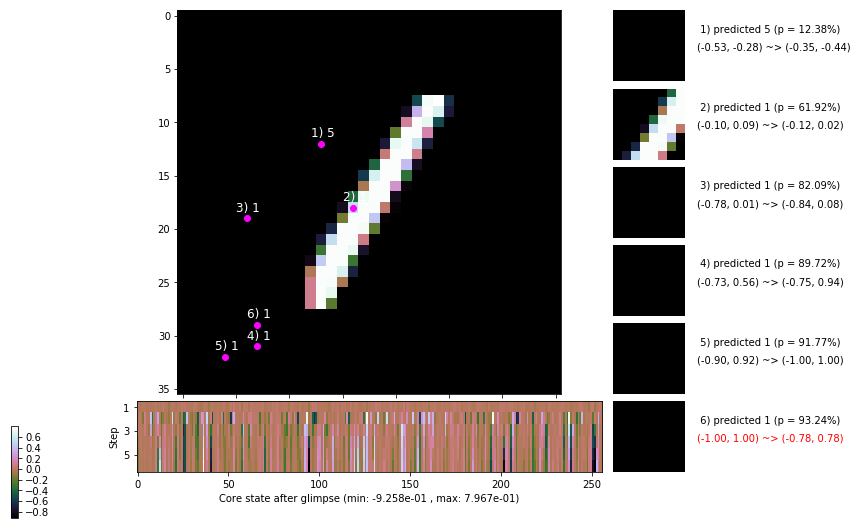

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.7 ms/b | lr: 5.42e-04 | grad 2norm: 10.39 | grad inf norm:  2.669
         Weights || abs max:  2.61 ( 3545.23) | mean: -4.44e-04 ( 0.02) | var: 7.02e-02 (  188.39)
          Biases || abs max:  1.32 (  182.82) | mean: -1.46e-01 ( 0.14) | var: 8.72e-02 (  405.57)
                    class loss: 0.297 | steps: 2.231 | reward:  3.755 | acc.: 89.98%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.0 ms/b | lr: 5.41e-04 | grad 2norm: 10.18 | grad inf norm:  2.674
         Weights || abs max:  2.62 ( 3281.86) | mean: -4.45e-04 ( 0.01) | var: 7.02e-02 (  316.64)
          Biases || abs max:  1.30 (  560.90) | mean: -1.46e-01 ( 0.30) | var: 8.74e-02 ( 6155.04)
                    class loss: 0.284 | steps: 2.223 | reward:  3.785 | acc.: 90.50%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

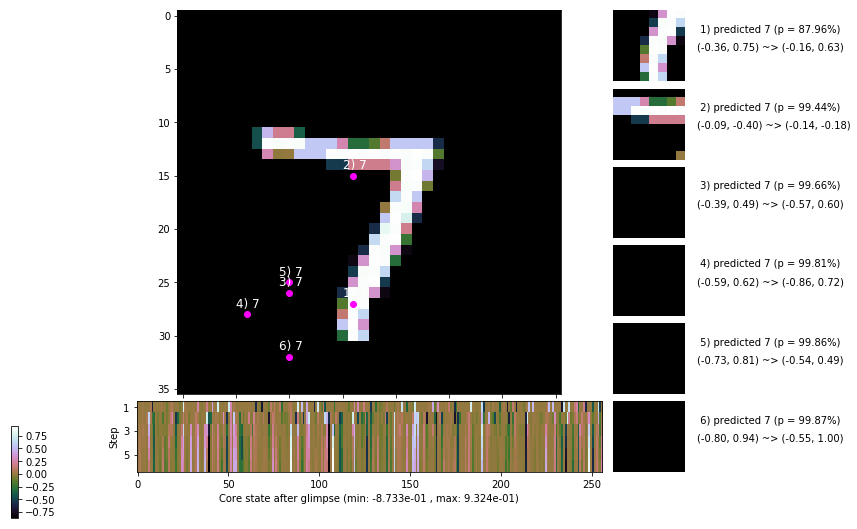

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [-0.556, -0.556, -0.556, -0.555, -0.550, -0.500]


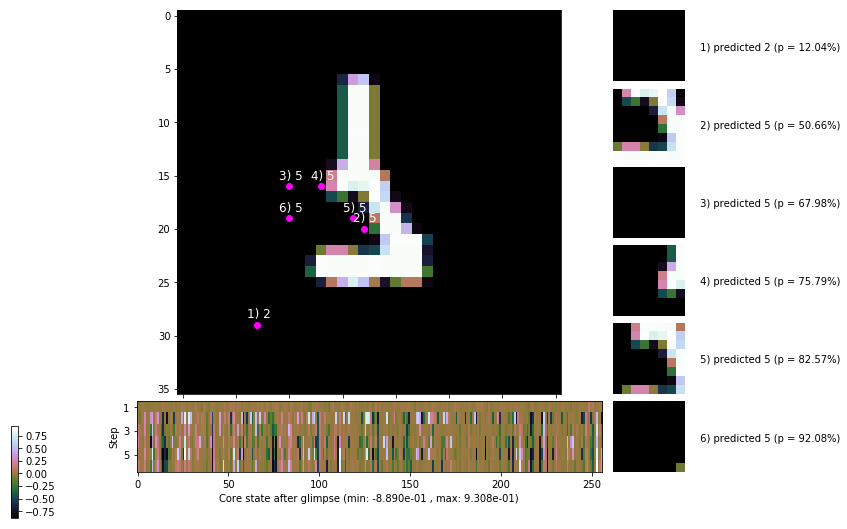


	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


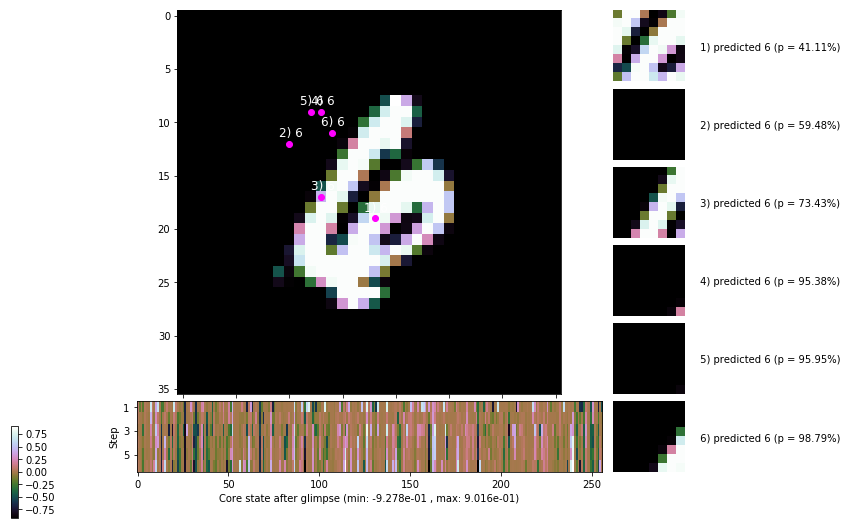

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


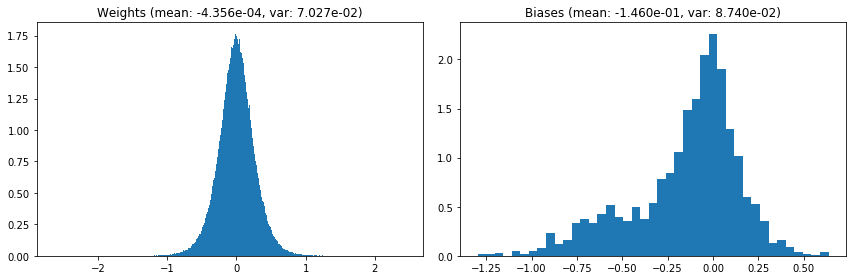

                                      Location network weights and biases


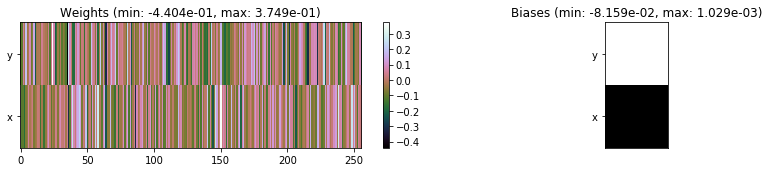

---------------------------------------------------------------------------------------------------------------
Elapsed time:  424.86 sec | TRAIN >> class loss: 0.2912 | steps:  2.209 :( | reward:  3.7902 :( | acc.: 90.347% :(
                          | VAL   >> class loss: 0.2685 | steps:  2.055    | reward:  4.0371 :( | acc.: 91.220% :(


Epoch  42/400) lr = 0.0005405
 b    300/  3000 >> 141.1 ms/b | lr: 5.40e-04 | grad 2norm: 10.45 | grad inf norm:  2.755
         Weights || abs max:  2.63 ( 3098.76) | mean: -4.28e-04 ( 0.01) | var: 7.03e-02 (  144.66)
          Biases || abs max:  1.30 ( 2201.68) | mean: -1.46e-01 ( 0.96) | var: 8.76e-02 (134524.77)
                    class loss: 0.294 | steps: 2.190 | reward:  3.799 | acc.: 90.48%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 138.6 ms/b | lr: 5.39e-04 | grad 2norm: 10.21 | grad inf norm:  2.571
         Weights || abs max:  2.63 ( 3665.22) | mean: -4.11e-04 

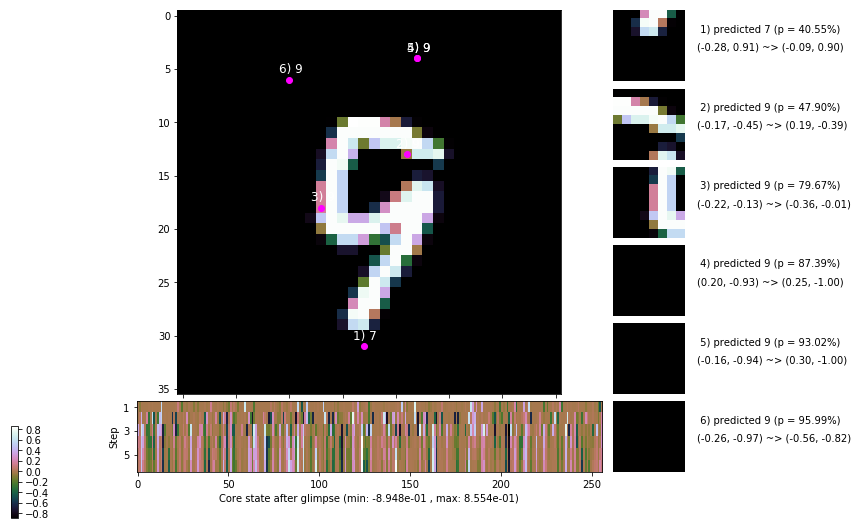

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 145.6 ms/b | lr: 5.38e-04 | grad 2norm: 10.43 | grad inf norm:  2.712
         Weights || abs max:  2.64 ( 4431.08) | mean: -4.15e-04 ( 0.02) | var: 7.04e-02 (  743.54)
          Biases || abs max:  1.31 (  796.18) | mean: -1.46e-01 ( 0.39) | var: 8.78e-02 (24494.12)
                    class loss: 0.276 | steps: 2.202 | reward:  3.798 | acc.: 90.83%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 155.3 ms/b | lr: 5.38e-04 | grad 2norm: 10.16 | grad inf norm:  2.613
         Weights || abs max:  2.64 ( 4196.64) | mean: -4.12e-04 ( 0.02) | var: 7.05e-02 ( 1571.49)
          Biases || abs max:  1.31 ( 1880.45) | mean: -1.46e-01 ( 0.81) | var: 8.78e-02 (68234.49)
                    class loss: 0.260 | steps: 2.171 | reward:  3.866 | acc.: 91.10%

	Target class: 2 | Discounted rewards: [-0.389, 1.111, 1.

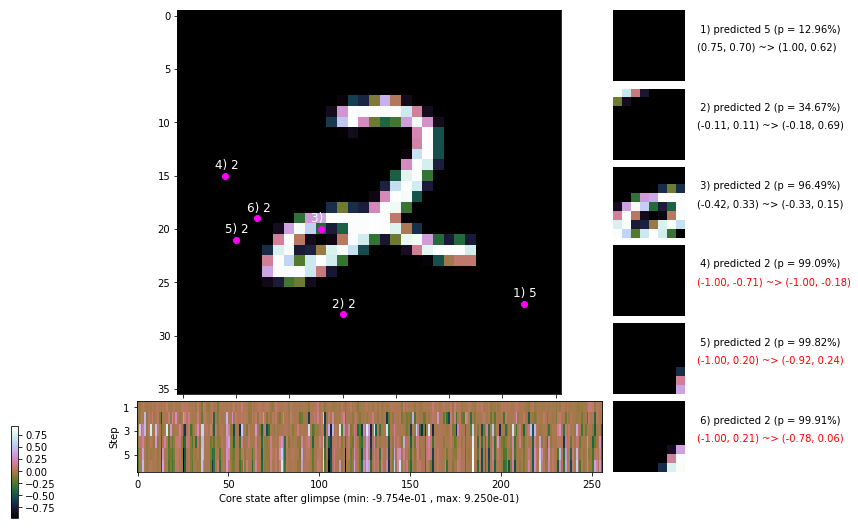

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 137.7 ms/b | lr: 5.37e-04 | grad 2norm: 10.43 | grad inf norm:  2.693
         Weights || abs max:  2.64 ( 3629.70) | mean: -4.26e-04 ( 0.02) | var: 7.05e-02 (  286.33)
          Biases || abs max:  1.32 (  164.84) | mean: -1.46e-01 ( 0.13) | var: 8.79e-02 (  169.52)
                    class loss: 0.297 | steps: 2.199 | reward:  3.801 | acc.: 90.55%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 136.6 ms/b | lr: 5.36e-04 | grad 2norm: 10.25 | grad inf norm:  2.712
         Weights || abs max:  2.65 ( 7027.64) | mean: -4.00e-04 ( 0.02) | var: 7.06e-02 ( 3210.38)
          Biases || abs max:  1.32 (  340.06) | mean: -1.47e-01 ( 0.21) | var: 8.82e-02 (  997.32)
                    class loss: 0.270 | steps: 2.165 | reward:  3.861 | acc.: 91.07%

	Target class: 9 | Discounted rewards: [-0.554, -0.539, -

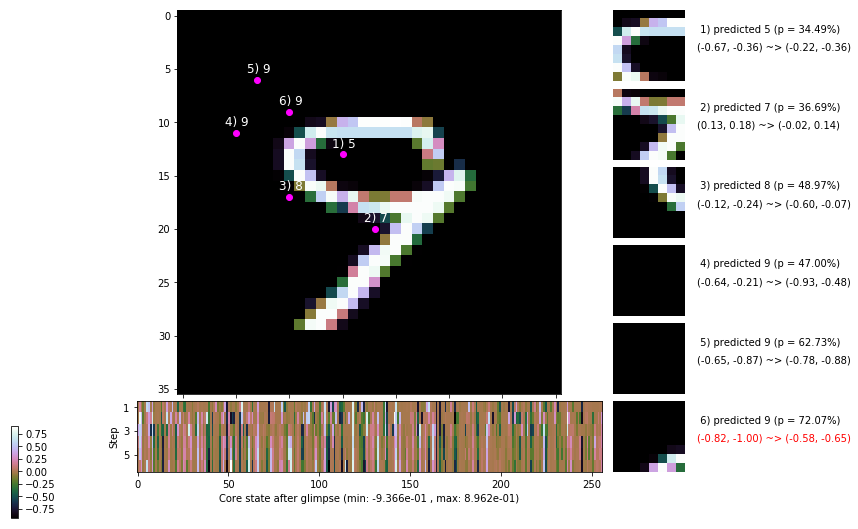

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 138.1 ms/b | lr: 5.35e-04 | grad 2norm: 10.31 | grad inf norm:  2.698
         Weights || abs max:  2.64 ( 3357.88) | mean: -4.09e-04 ( 0.01) | var: 7.07e-02 (  294.66)
          Biases || abs max:  1.32 (  192.97) | mean: -1.46e-01 ( 0.14) | var: 8.82e-02 (  105.21)
                    class loss: 0.273 | steps: 2.159 | reward:  3.863 | acc.: 90.95%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 135.6 ms/b | lr: 5.35e-04 | grad 2norm: 10.34 | grad inf norm:  2.759
         Weights || abs max:  2.64 ( 2627.23) | mean: -3.93e-04 ( 0.01) | var: 7.07e-02 (  144.42)
          Biases || abs max:  1.32 (  118.72) | mean: -1.46e-01 ( 0.12) | var: 8.82e-02 (  126.92)
                    class loss: 0.275 | steps: 2.213 | reward:  3.809 | acc.: 90.55%

	Target class: 6 | Discounted rewards: [-0.539, -0.389, 1

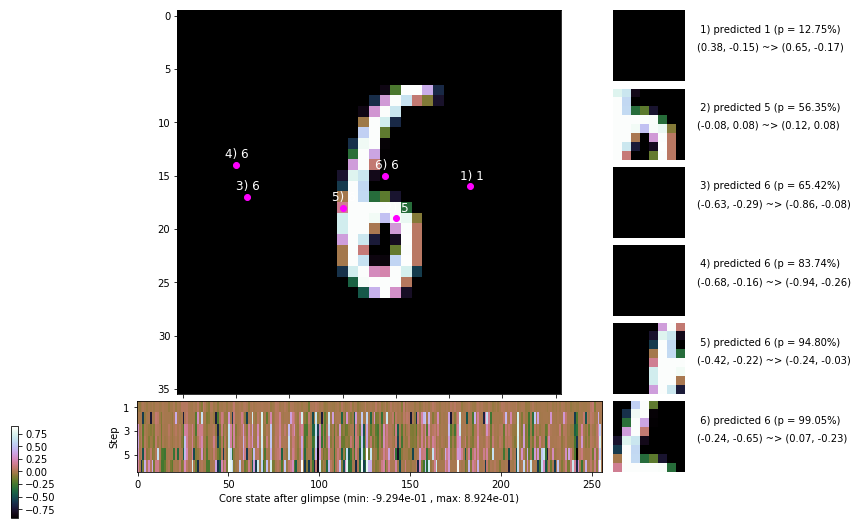

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 138.9 ms/b | lr: 5.33e-04 | grad 2norm: 10.20 | grad inf norm:  2.658
         Weights || abs max:  2.64 ( 3856.25) | mean: -3.88e-04 ( 0.02) | var: 7.08e-02 (  704.75)
          Biases || abs max:  1.32 ( 1178.04) | mean: -1.46e-01 ( 0.54) | var: 8.81e-02 (37808.67)
                    class loss: 0.272 | steps: 2.160 | reward:  3.859 | acc.: 91.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 135.3 ms/b | lr: 5.33e-04 | grad 2norm: 10.34 | grad inf norm:  2.762
         Weights || abs max:  2.64 ( 3171.60) | mean: -3.88e-04 ( 0.01) | var: 7.09e-02 (  280.56)
          Biases || abs max:  1.33 (  201.67) | mean: -1.46e-01 ( 0.15) | var: 8.82e-02 (   86.39)
                    class loss: 0.280 | steps: 2.183 | reward:  3.817 | acc.: 90.62%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

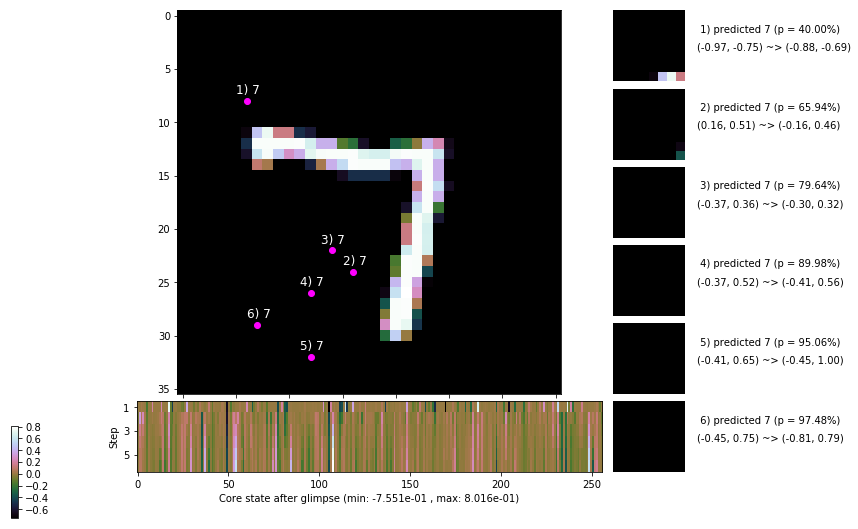

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.944, -0.556, -0.556, -0.555, -0.550, -0.500]


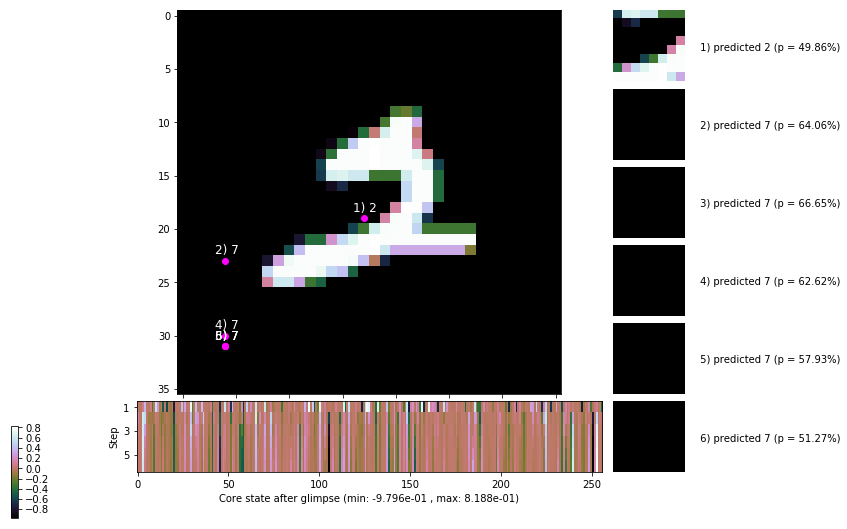


	Target class: 2 | Discounted rewards: [-0.556, -0.556, -0.556, -0.555, -0.550, -0.500]


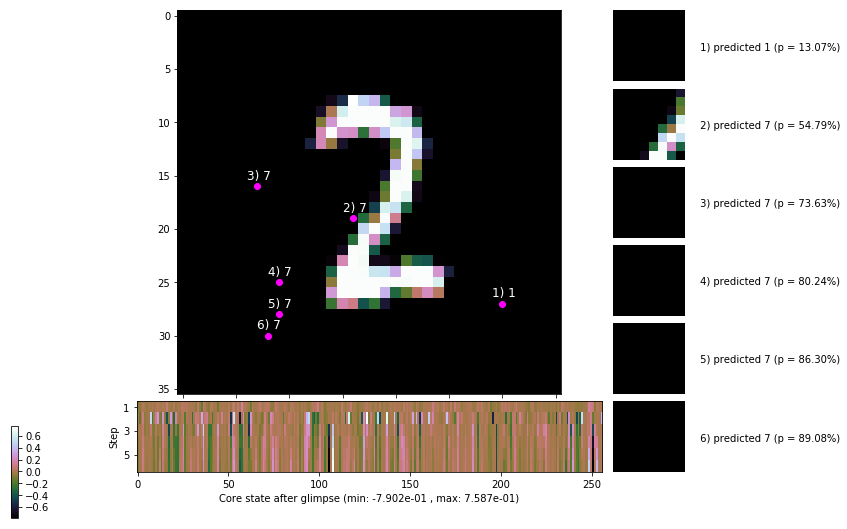

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


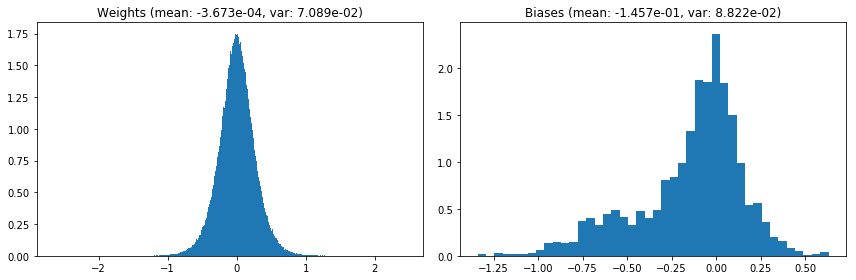

                                      Location network weights and biases


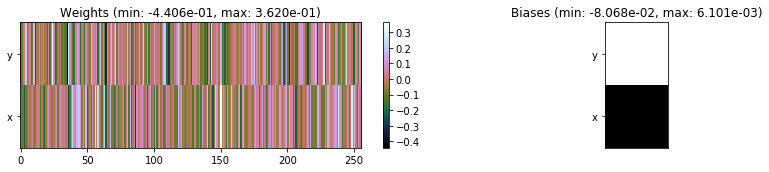

---------------------------------------------------------------------------------------------------------------
Elapsed time:  421.37 sec | TRAIN >> class loss: 0.2768 | steps:  2.185    | reward:  3.8260    | acc.: 90.798% :(
                          | VAL   >> class loss: 0.2831 | steps:  2.101 :( | reward:  3.9963 :( | acc.: 90.540% :(


Epoch  43/400) lr = 0.0005324
 b    300/  3000 >> 135.1 ms/b | lr: 5.32e-04 | grad 2norm: 10.68 | grad inf norm:  2.829
         Weights || abs max:  2.65 ( 4555.44) | mean: -3.67e-04 ( 0.02) | var: 7.09e-02 ( 1791.93)
          Biases || abs max:  1.34 (  367.56) | mean: -1.46e-01 ( 0.21) | var: 8.82e-02 ( 4971.72)
                    class loss: 0.294 | steps: 2.193 | reward:  3.815 | acc.: 90.20%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 135.2 ms/b | lr: 5.31e-04 | grad 2norm: 10.24 | grad inf norm:  2.748
         Weights || abs max:  2.65 ( 4564.71) | mean: -3.69e-04 (

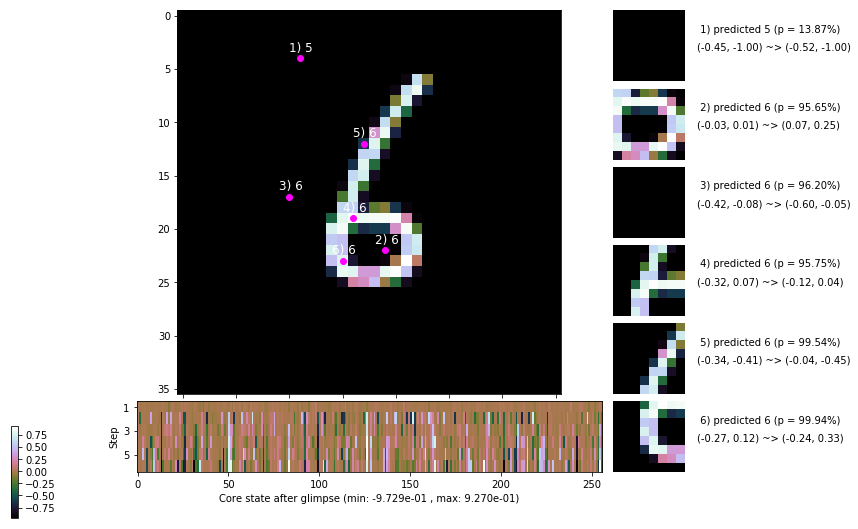

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 135.7 ms/b | lr: 5.30e-04 | grad 2norm: 10.24 | grad inf norm:  2.637
         Weights || abs max:  2.65 ( 3417.46) | mean: -3.61e-04 ( 0.02) | var: 7.10e-02 (  190.86)
          Biases || abs max:  1.34 (  326.51) | mean: -1.46e-01 ( 0.20) | var: 8.84e-02 ( 3392.21)
                    class loss: 0.280 | steps: 2.162 | reward:  3.881 | acc.: 90.83%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 135.0 ms/b | lr: 5.30e-04 | grad 2norm: 10.35 | grad inf norm:  2.724
         Weights || abs max:  2.65 ( 4313.71) | mean: -3.75e-04 ( 0.02) | var: 7.11e-02 ( 1164.68)
          Biases || abs max:  1.33 (  111.40) | mean: -1.45e-01 ( 0.12) | var: 8.85e-02 (   32.06)
                    class loss: 0.300 | steps: 2.163 | reward:  3.837 | acc.: 90.23%

	Target class: 0 | Discounted rewards: [-0.539, -0.389, 1

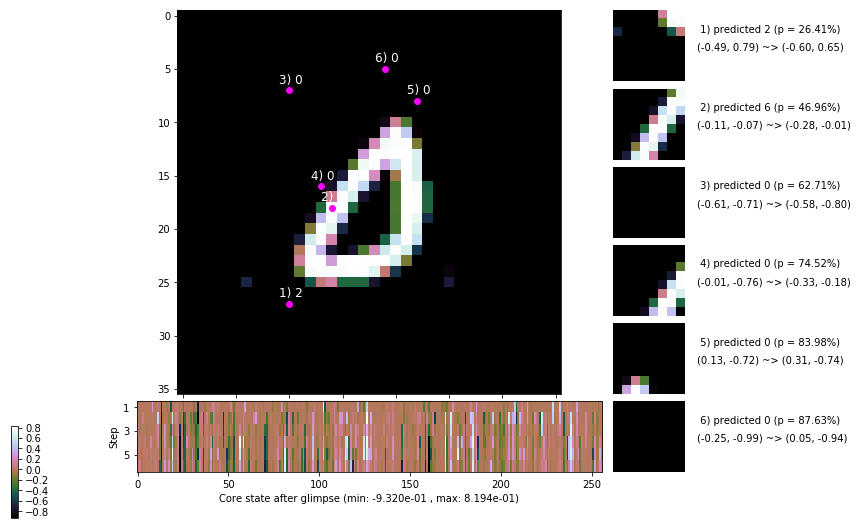

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 138.6 ms/b | lr: 5.29e-04 | grad 2norm: 10.45 | grad inf norm:  2.703
         Weights || abs max:  2.65 (13675.33) | mean: -3.79e-04 ( 0.04) | var: 7.12e-02 (29740.58)
          Biases || abs max:  1.33 (  251.53) | mean: -1.45e-01 ( 0.18) | var: 8.83e-02 (  224.30)
                    class loss: 0.281 | steps: 2.170 | reward:  3.845 | acc.: 90.52%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 136.1 ms/b | lr: 5.28e-04 | grad 2norm: 10.69 | grad inf norm:  2.733
         Weights || abs max:  2.66 ( 7157.47) | mean: -3.91e-04 ( 0.02) | var: 7.12e-02 (10570.89)
          Biases || abs max:  1.32 (  902.62) | mean: -1.45e-01 ( 0.42) | var: 8.85e-02 ( 3554.62)
                    class loss: 0.291 | steps: 2.193 | reward:  3.812 | acc.: 90.05%

	Target class: 3 | Discounted rewards: [-0.554, -0.539, -

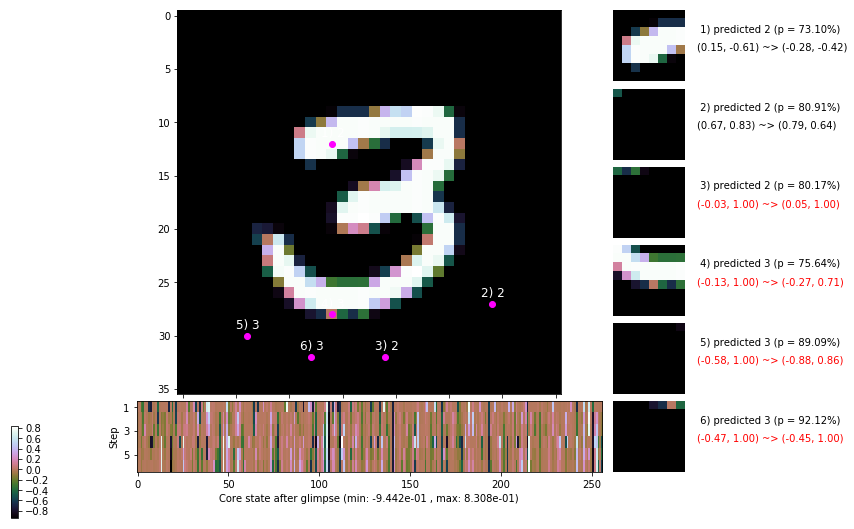

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 139.9 ms/b | lr: 5.27e-04 | grad 2norm: 10.61 | grad inf norm:  2.785
         Weights || abs max:  2.65 ( 3139.55) | mean: -4.03e-04 ( 0.02) | var: 7.13e-02 (  291.95)
          Biases || abs max:  1.33 ( 1280.91) | mean: -1.45e-01 ( 0.58) | var: 8.88e-02 (16498.80)
                    class loss: 0.292 | steps: 2.226 | reward:  3.774 | acc.: 90.37%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 155.6 ms/b | lr: 5.27e-04 | grad 2norm: 10.07 | grad inf norm:  2.672
         Weights || abs max:  2.65 ( 2600.38) | mean: -3.63e-04 ( 0.01) | var: 7.13e-02 (   96.87)
          Biases || abs max:  1.34 (  180.66) | mean: -1.46e-01 ( 0.14) | var: 8.90e-02 (  103.78)
                    class loss: 0.266 | steps: 2.170 | reward:  3.861 | acc.: 91.10%

	Target class: 8 | Discounted rewards: [1.111, 1.111, 1.1

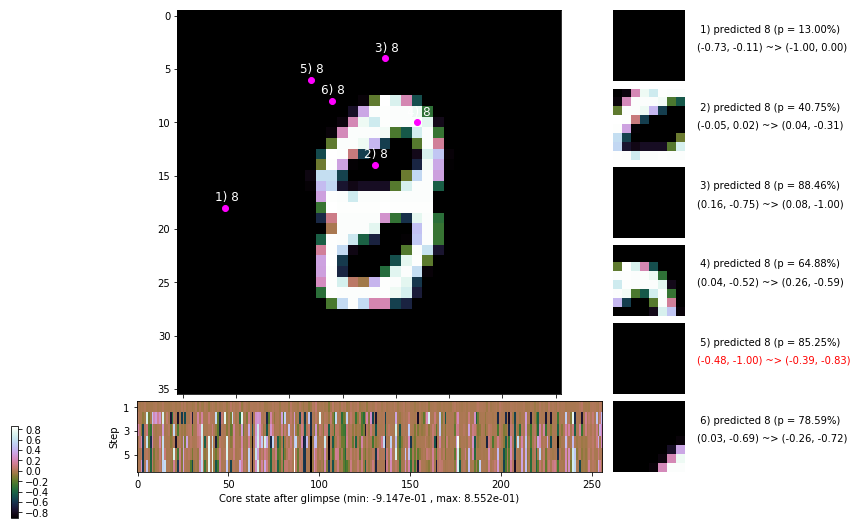

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 139.8 ms/b | lr: 5.26e-04 | grad 2norm: 10.48 | grad inf norm:  2.743
         Weights || abs max:  2.65 ( 4591.64) | mean: -3.63e-04 ( 0.02) | var: 7.14e-02 (  592.13)
          Biases || abs max:  1.34 (  395.91) | mean: -1.45e-01 ( 0.22) | var: 8.89e-02 (  842.72)
                    class loss: 0.274 | steps: 2.212 | reward:  3.795 | acc.: 90.77%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 136.2 ms/b | lr: 5.25e-04 | grad 2norm: 10.52 | grad inf norm:  2.663
         Weights || abs max:  2.66 ( 2781.31) | mean: -3.84e-04 ( 0.02) | var: 7.15e-02 (  107.42)
          Biases || abs max:  1.33 (   94.27) | mean: -1.45e-01 ( 0.10) | var: 8.89e-02 (   15.71)
                    class loss: 0.282 | steps: 2.185 | reward:  3.837 | acc.: 90.72%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

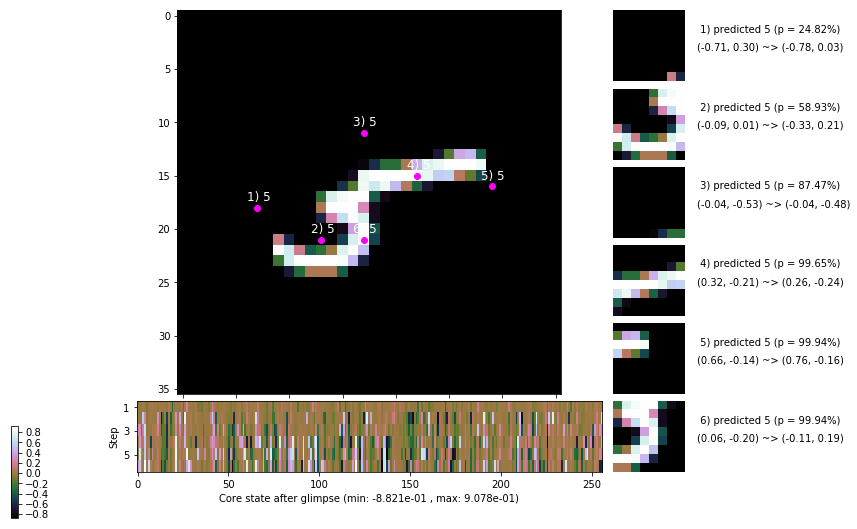

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [-0.556, -0.556, -0.556, -0.555, -0.550, -0.500]


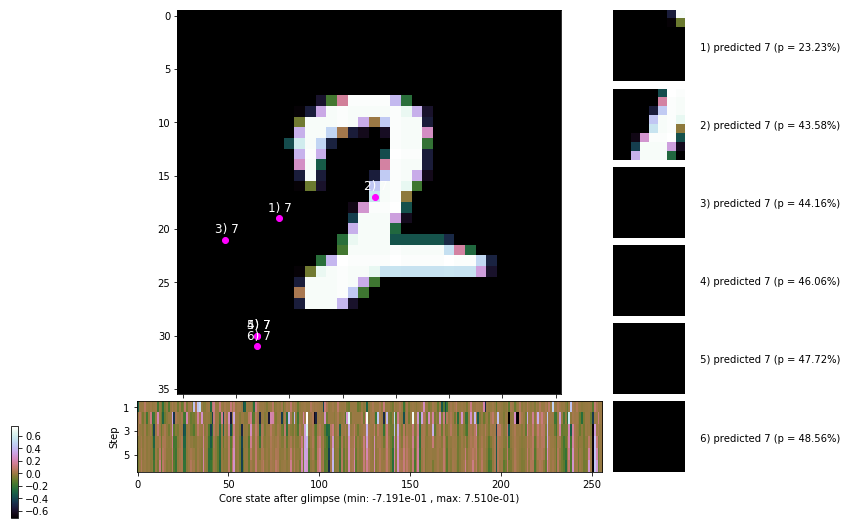


	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


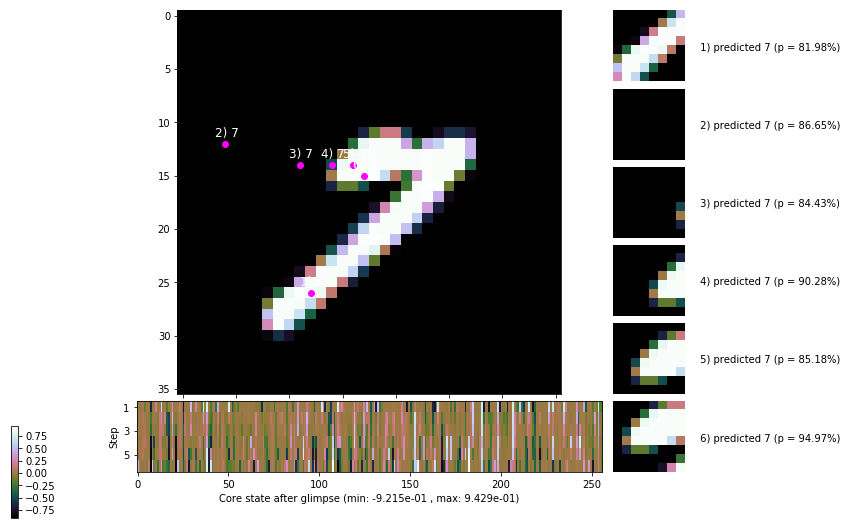

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


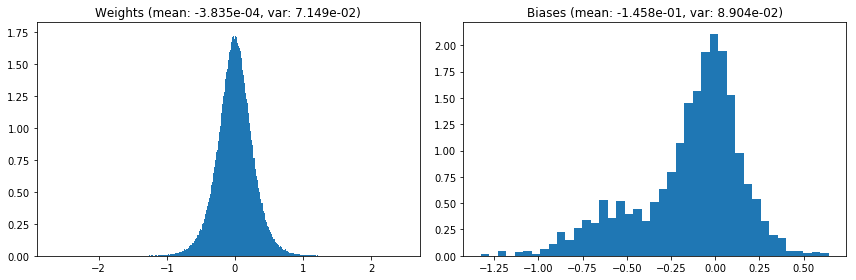

                                      Location network weights and biases


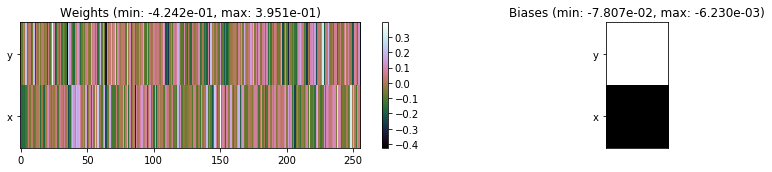

---------------------------------------------------------------------------------------------------------------
Elapsed time:  416.83 sec | TRAIN >> class loss: 0.2837 | steps:  2.184    | reward:  3.8314    | acc.: 90.580% :(
                          | VAL   >> class loss: 0.2921 | steps:  2.113 :( | reward:  3.9804 :( | acc.: 90.180% :(


Epoch  44/400) lr = 0.0005245
 b    300/  3000 >> 136.2 ms/b | lr: 5.24e-04 | grad 2norm: 10.48 | grad inf norm:  2.770
         Weights || abs max:  2.65 ( 5820.59) | mean: -3.62e-04 ( 0.02) | var: 7.15e-02 ( 4901.36)
          Biases || abs max:  1.33 (  401.33) | mean: -1.46e-01 ( 0.22) | var: 8.92e-02 (  870.65)
                    class loss: 0.280 | steps: 2.204 | reward:  3.800 | acc.: 90.23%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 133.1 ms/b | lr: 5.23e-04 | grad 2norm: 10.40 | grad inf norm:  2.746
         Weights || abs max:  2.66 (59843.66) | mean: -3.51e-04 (

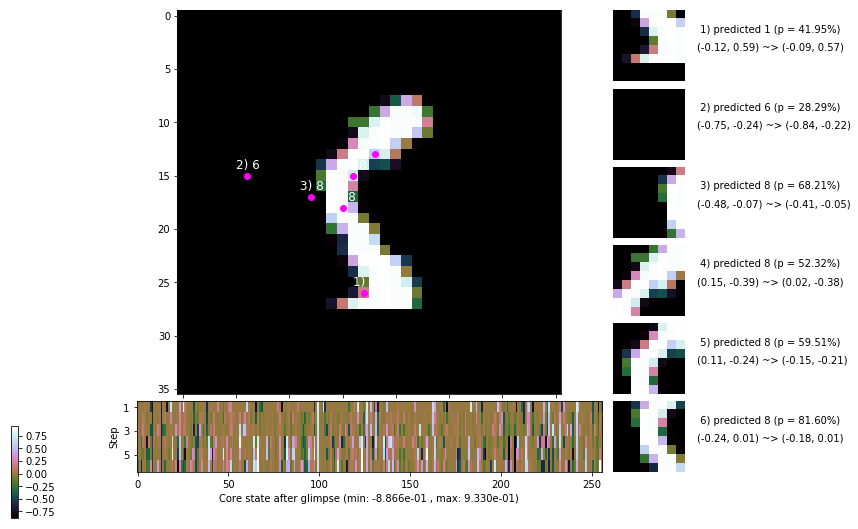

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 137.5 ms/b | lr: 5.22e-04 | grad 2norm:  9.87 | grad inf norm:  2.672
         Weights || abs max:  2.65 ( 4529.02) | mean: -3.63e-04 ( 0.02) | var: 7.16e-02 ( 1000.45)
          Biases || abs max:  1.33 (  126.48) | mean: -1.45e-01 ( 0.12) | var: 8.92e-02 (   62.00)
                    class loss: 0.271 | steps: 2.154 | reward:  3.890 | acc.: 91.28%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 135.4 ms/b | lr: 5.22e-04 | grad 2norm: 10.42 | grad inf norm:  2.819
         Weights || abs max:  2.65 ( 5455.49) | mean: -3.63e-04 ( 0.02) | var: 7.17e-02 ( 2612.15)
          Biases || abs max:  1.32 (  765.15) | mean: -1.45e-01 ( 0.40) | var: 8.93e-02 (13078.07)
                    class loss: 0.297 | steps: 2.199 | reward:  3.804 | acc.: 90.28%

	Target class: 8 | Discounted rewards: [-0.539, -0.389, 1

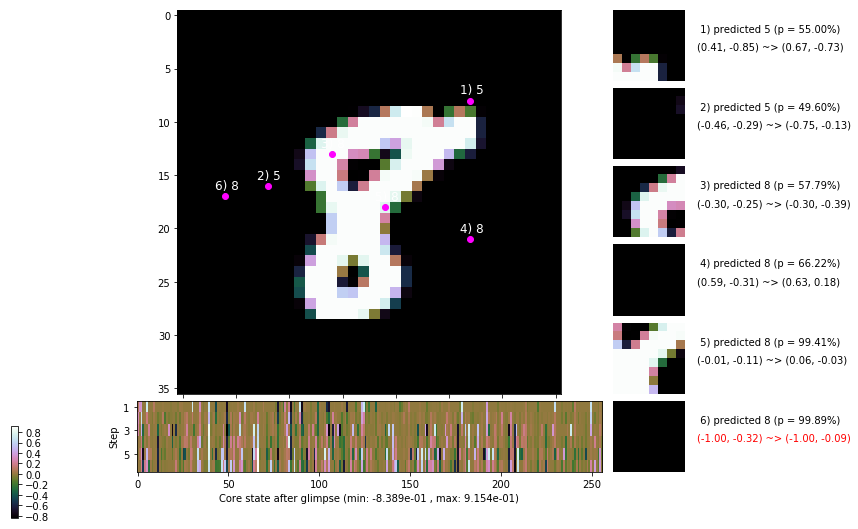

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 134.9 ms/b | lr: 5.21e-04 | grad 2norm: 10.43 | grad inf norm:  2.868
         Weights || abs max:  2.66 ( 4125.44) | mean: -3.40e-04 ( 0.02) | var: 7.18e-02 (  859.46)
          Biases || abs max:  1.31 (  684.08) | mean: -1.46e-01 ( 0.39) | var: 8.94e-02 ( 5731.50)
                    class loss: 0.301 | steps: 2.212 | reward:  3.783 | acc.: 90.08%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 135.6 ms/b | lr: 5.20e-04 | grad 2norm: 10.29 | grad inf norm:  2.816
         Weights || abs max:  2.67 (31101.33) | mean: -3.43e-04 ( 0.07) | var: 7.18e-02 (435154.56)
          Biases || abs max:  1.31 ( 2310.59) | mean: -1.46e-01 ( 0.98) | var: 8.96e-02 (201399.05)
                    class loss: 0.302 | steps: 2.188 | reward:  3.820 | acc.: 90.07%

	Target class: 7 | Discounted rewards: [-0.389, 1.111, 

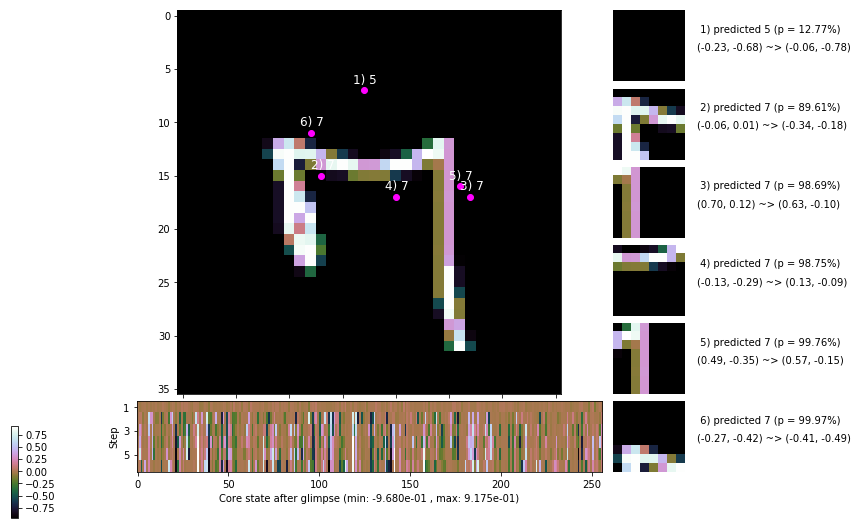

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 137.4 ms/b | lr: 5.19e-04 | grad 2norm: 10.23 | grad inf norm:  2.667
         Weights || abs max:  2.67 ( 3910.79) | mean: -3.54e-04 ( 0.02) | var: 7.19e-02 (  716.98)
          Biases || abs max:  1.32 (   89.63) | mean: -1.46e-01 ( 0.10) | var: 8.95e-02 (   10.15)
                    class loss: 0.271 | steps: 2.210 | reward:  3.821 | acc.: 91.05%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 134.9 ms/b | lr: 5.19e-04 | grad 2norm: 10.18 | grad inf norm:  2.688
         Weights || abs max:  2.67 ( 3468.58) | mean: -3.45e-04 ( 0.02) | var: 7.19e-02 (  317.59)
          Biases || abs max:  1.31 (  136.71) | mean: -1.46e-01 ( 0.12) | var: 8.94e-02 (  125.00)
                    class loss: 0.268 | steps: 2.167 | reward:  3.883 | acc.: 91.37%

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.

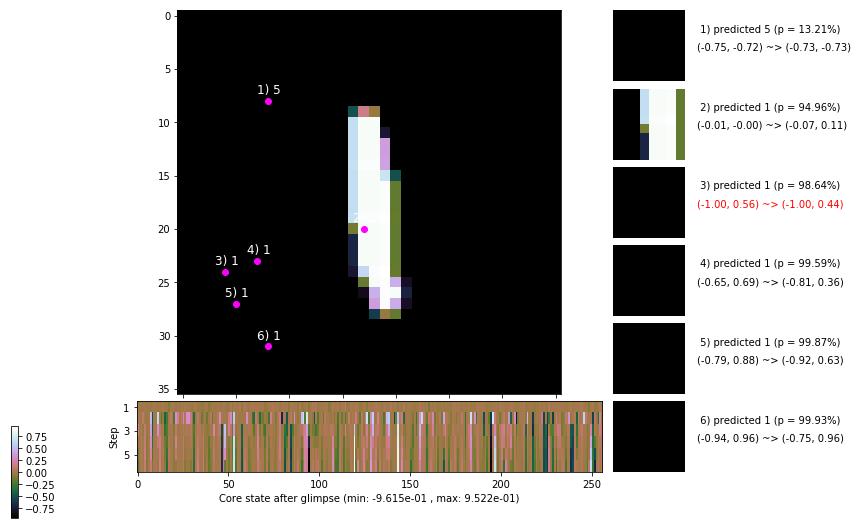

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 136.0 ms/b | lr: 5.18e-04 | grad 2norm: 10.06 | grad inf norm:  2.612
         Weights || abs max:  2.68 ( 2641.62) | mean: -3.46e-04 ( 0.01) | var: 7.20e-02 (  152.13)
          Biases || abs max:  1.31 (   83.80) | mean: -1.47e-01 ( 0.10) | var: 8.95e-02 (   13.35)
                    class loss: 0.293 | steps: 2.196 | reward:  3.819 | acc.: 90.32%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 134.8 ms/b | lr: 5.17e-04 | grad 2norm:  9.93 | grad inf norm:  2.662
         Weights || abs max:  2.67 ( 3773.91) | mean: -3.75e-04 ( 0.02) | var: 7.21e-02 (  263.28)
          Biases || abs max:  1.30 (   89.82) | mean: -1.46e-01 ( 0.10) | var: 8.95e-02 (   23.26)
                    class loss: 0.273 | steps: 2.190 | reward:  3.832 | acc.: 91.22%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

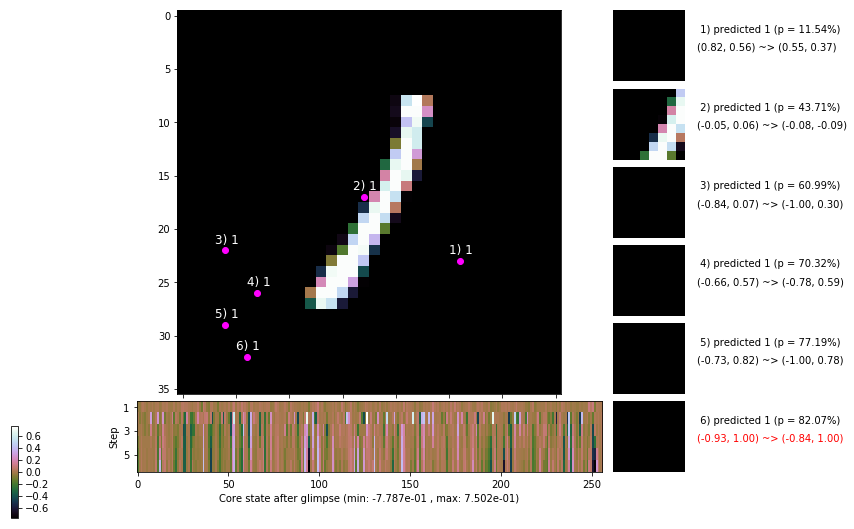

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


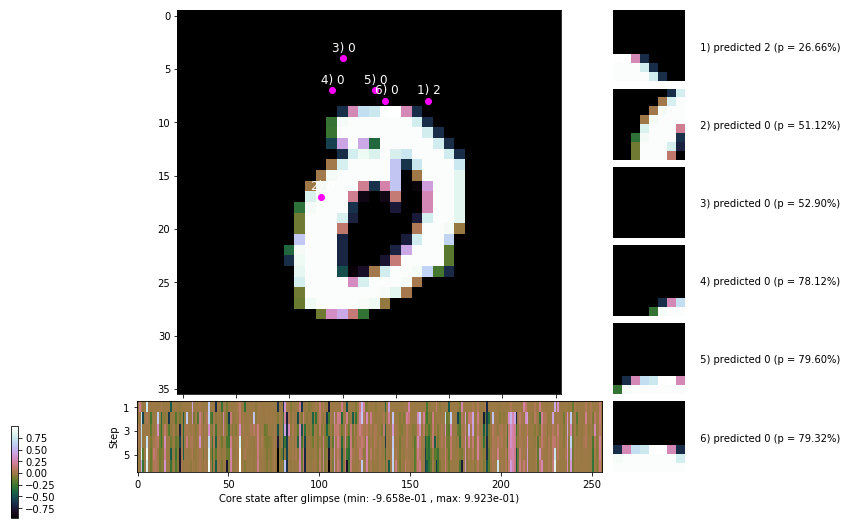


	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


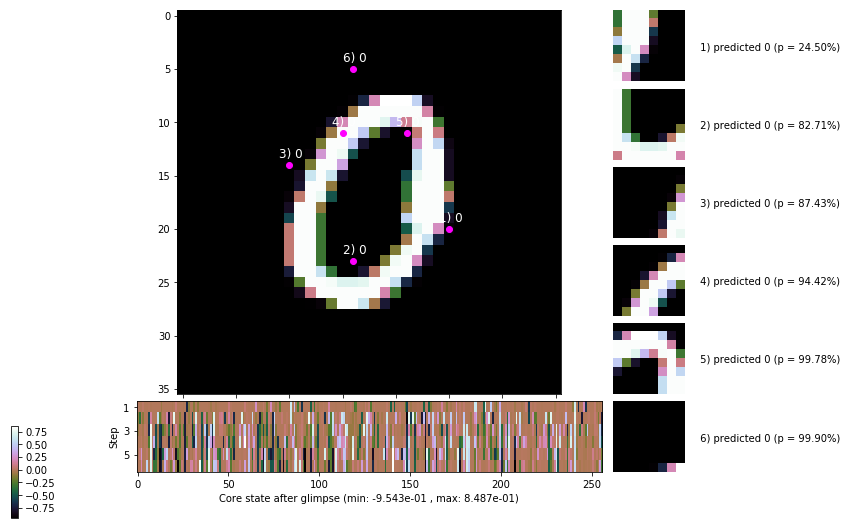

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


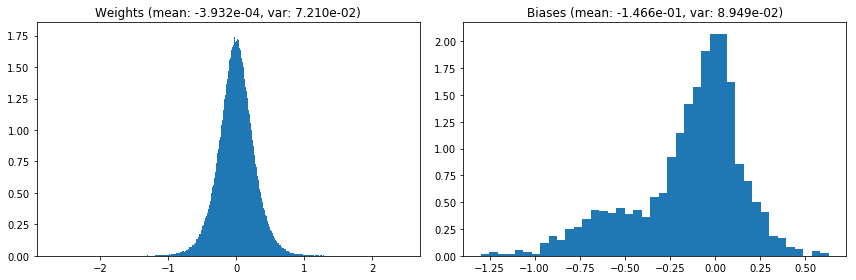

                                      Location network weights and biases


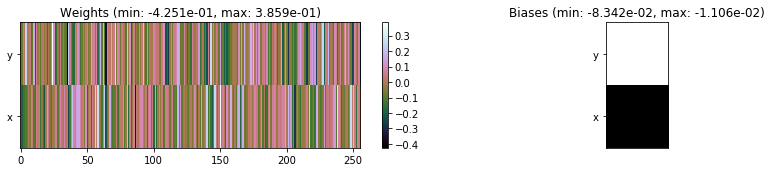

---------------------------------------------------------------------------------------------------------------
Elapsed time:  407.26 sec | TRAIN >> class loss: 0.2847 | steps:  2.190 :( | reward:  3.8262 :( | acc.: 90.620% :(
                          | VAL   >> class loss: 0.2869 | steps:  2.096 :( | reward:  3.9720 :( | acc.: 90.020% :(


Epoch  45/400) lr = 0.0005167
 b    300/  3000 >> 135.4 ms/b | lr: 5.16e-04 | grad 2norm:  9.89 | grad inf norm:  2.687
         Weights || abs max:  2.67 ( 2411.40) | mean: -3.82e-04 ( 0.01) | var: 7.21e-02 (   71.03)
          Biases || abs max:  1.30 (  793.39) | mean: -1.47e-01 ( 0.38) | var: 8.96e-02 ( 5623.18)
                    class loss: 0.294 | steps: 2.188 | reward:  3.803 | acc.: 90.47%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 151.8 ms/b | lr: 5.16e-04 | grad 2norm:  9.91 | grad inf norm:  2.662
         Weights || abs max:  2.67 (13523.53) | mean: -3.59e-04 (

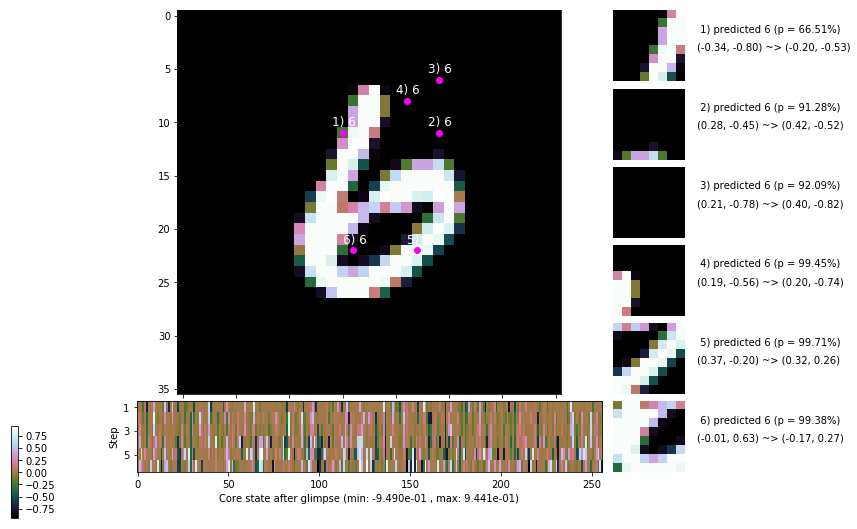

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 147.2 ms/b | lr: 5.15e-04 | grad 2norm: 10.08 | grad inf norm:  2.762
         Weights || abs max:  2.67 ( 6715.11) | mean: -3.50e-04 ( 0.02) | var: 7.23e-02 ( 4742.20)
          Biases || abs max:  1.32 (  858.47) | mean: -1.46e-01 ( 0.40) | var: 8.97e-02 ( 7621.69)
                    class loss: 0.258 | steps: 2.190 | reward:  3.835 | acc.: 91.37%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 136.4 ms/b | lr: 5.14e-04 | grad 2norm: 10.13 | grad inf norm:  2.753
         Weights || abs max:  2.67 ( 7167.05) | mean: -3.42e-04 ( 0.02) | var: 7.23e-02 ( 4328.74)
          Biases || abs max:  1.31 (  169.12) | mean: -1.45e-01 ( 0.12) | var: 8.97e-02 (  342.69)
                    class loss: 0.271 | steps: 2.178 | reward:  3.844 | acc.: 90.83%

	Target class: 6 | Discounted rewards: [-0.556, -0.556, -

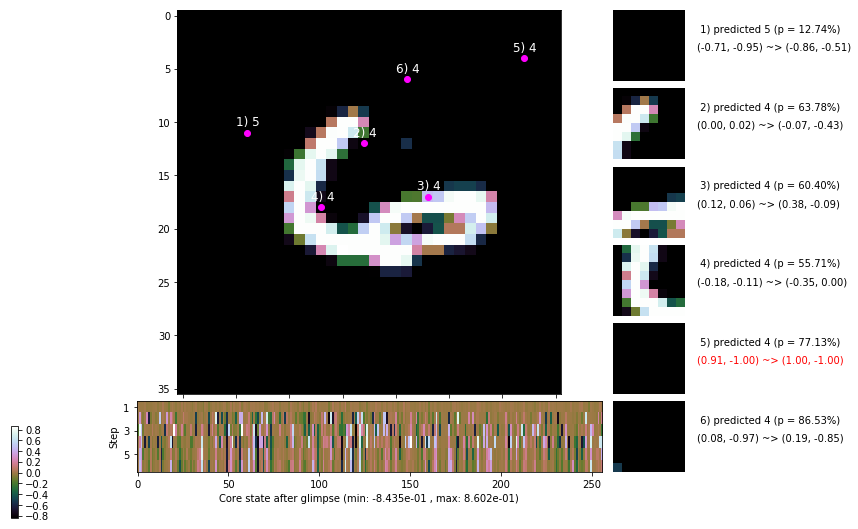

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 138.2 ms/b | lr: 5.13e-04 | grad 2norm:  9.97 | grad inf norm:  2.733
         Weights || abs max:  2.67 (50457.98) | mean: -2.97e-04 ( 0.10) | var: 7.24e-02 (1151985.88)
          Biases || abs max:  1.32 (   76.63) | mean: -1.45e-01 ( 0.09) | var: 8.98e-02 (   31.23)
                    class loss: 0.277 | steps: 2.181 | reward:  3.861 | acc.: 91.30%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 134.2 ms/b | lr: 5.13e-04 | grad 2norm: 10.01 | grad inf norm:  2.564
         Weights || abs max:  2.67 ( 5235.84) | mean: -3.04e-04 ( 0.02) | var: 7.24e-02 (  950.66)
          Biases || abs max:  1.32 (  128.61) | mean: -1.46e-01 ( 0.11) | var: 8.98e-02 (  174.89)
                    class loss: 0.276 | steps: 2.189 | reward:  3.842 | acc.: 90.97%

	Target class: 2 | Discounted rewards: [-0.556, -0.556,

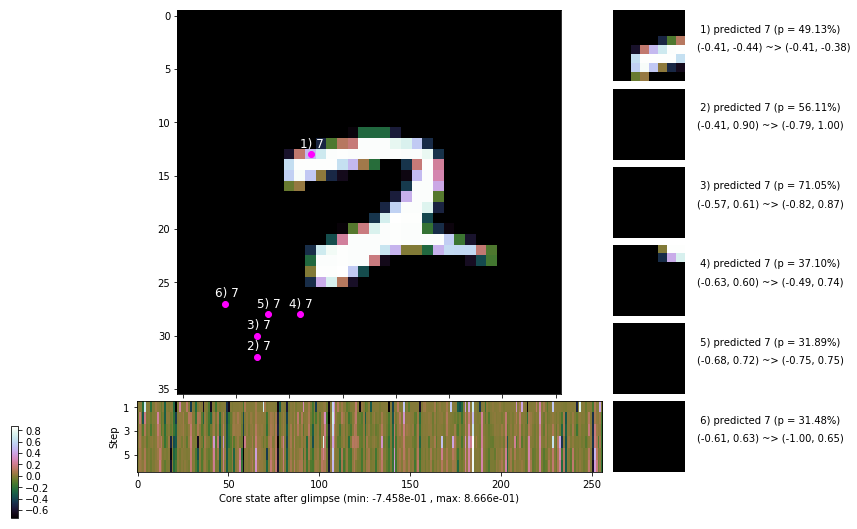

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 137.5 ms/b | lr: 5.12e-04 | grad 2norm: 10.19 | grad inf norm:  2.710
         Weights || abs max:  2.68 ( 2757.17) | mean: -3.18e-04 ( 0.01) | var: 7.25e-02 (  154.27)
          Biases || abs max:  1.33 (  113.83) | mean: -1.46e-01 ( 0.11) | var: 9.00e-02 (   64.70)
                    class loss: 0.282 | steps: 2.175 | reward:  3.857 | acc.: 90.92%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 134.5 ms/b | lr: 5.11e-04 | grad 2norm: 10.11 | grad inf norm:  2.571
         Weights || abs max:  2.69 (50740.24) | mean: -3.23e-04 ( 0.10) | var: 7.25e-02 (1143305.00)
          Biases || abs max:  1.32 (  301.72) | mean: -1.46e-01 ( 0.18) | var: 8.98e-02 ( 2333.15)
                    class loss: 0.265 | steps: 2.171 | reward:  3.857 | acc.: 90.87%

	Target class: 8 | Discounted rewards: [-0.556, -0.556,

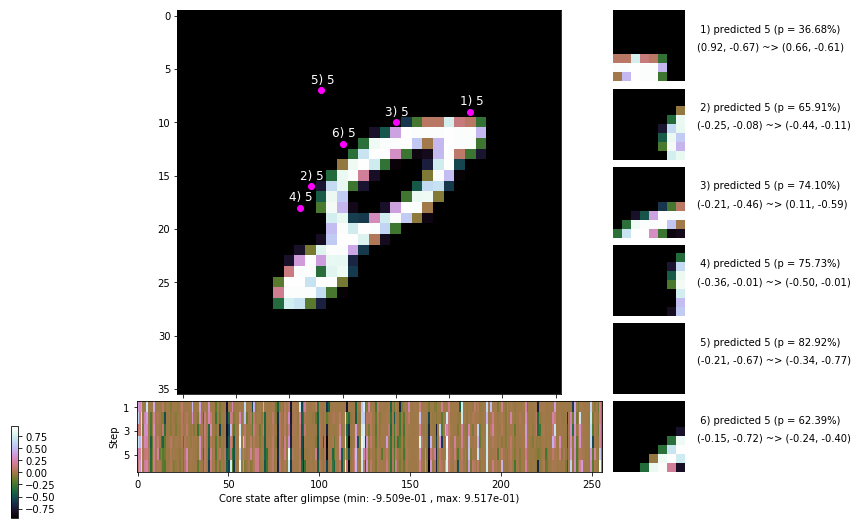

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 136.4 ms/b | lr: 5.10e-04 | grad 2norm: 10.39 | grad inf norm:  2.871
         Weights || abs max:  2.69 ( 5951.79) | mean: -2.94e-04 ( 0.02) | var: 7.26e-02 ( 1830.64)
          Biases || abs max:  1.32 (  190.15) | mean: -1.46e-01 ( 0.15) | var: 8.99e-02 (  183.51)
                    class loss: 0.293 | steps: 2.183 | reward:  3.825 | acc.: 90.15%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 134.4 ms/b | lr: 5.09e-04 | grad 2norm: 10.40 | grad inf norm:  2.785
         Weights || abs max:  2.68 ( 6286.21) | mean: -2.91e-04 ( 0.02) | var: 7.26e-02 ( 3144.62)
          Biases || abs max:  1.32 (  146.42) | mean: -1.46e-01 ( 0.13) | var: 9.01e-02 (  183.63)
                    class loss: 0.316 | steps: 2.233 | reward:  3.732 | acc.: 89.82%

	Target class: 0 | Discounted rewards: [-0.556, -0.556, -

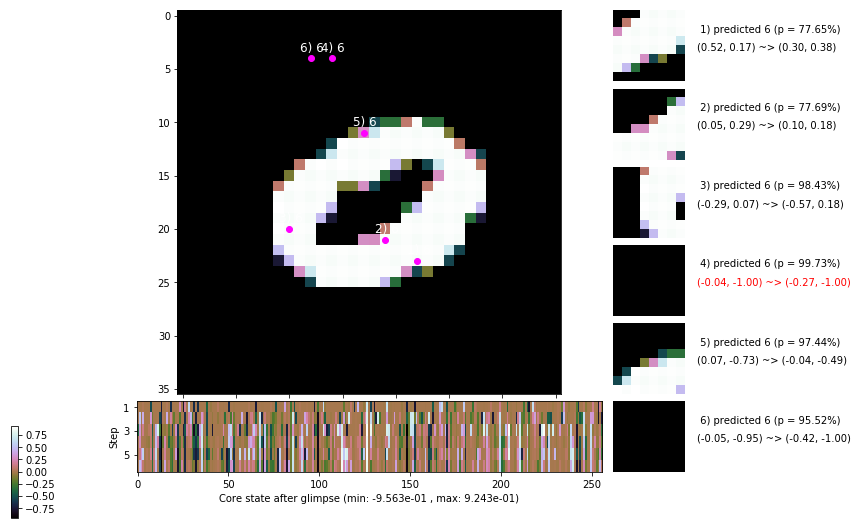

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


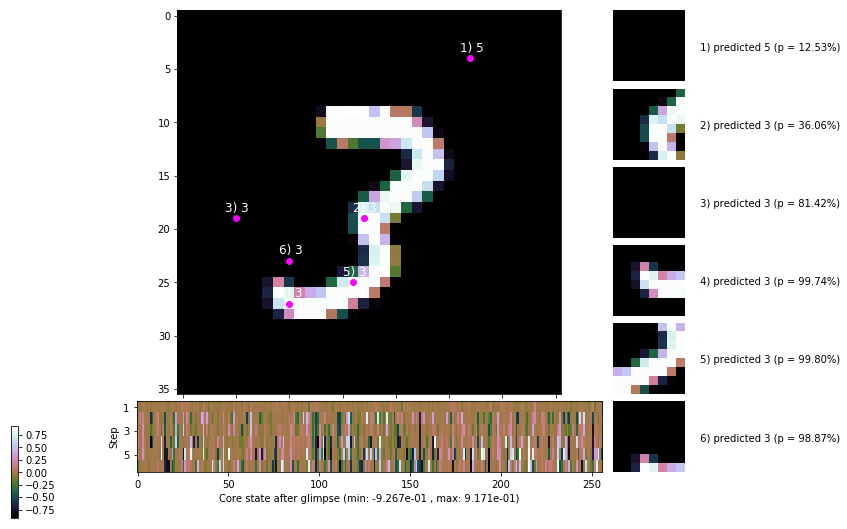


	Target class: 2 | Discounted rewards: [-0.556, -0.556, -0.556, -0.555, -0.550, -0.500]


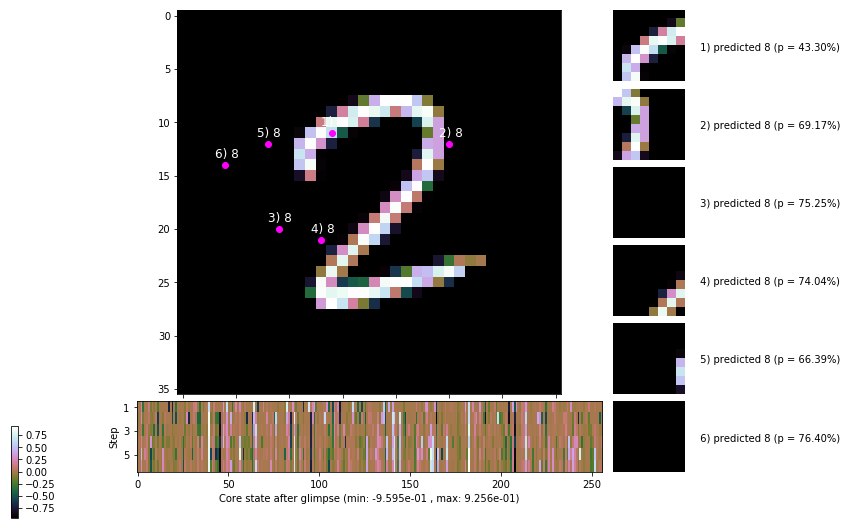

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


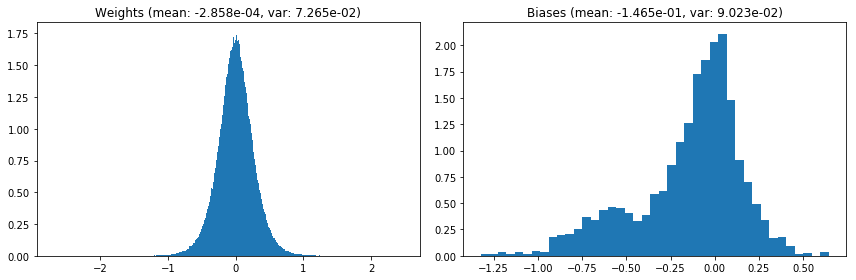

                                      Location network weights and biases


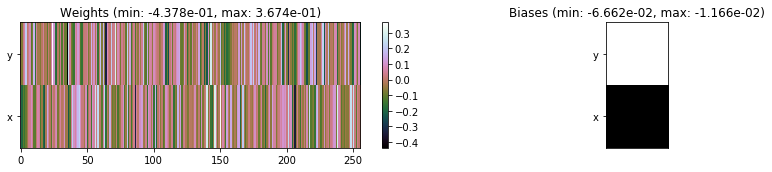

---------------------------------------------------------------------------------------------------------------
Elapsed time:  416.29 sec | TRAIN >> class loss: 0.2798 | steps:  2.187 :( | reward:  3.8308 :( | acc.: 90.773% :(
                          | VAL   >> class loss: 0.2828 | steps:  2.090 :( | reward:  4.0029 :( | acc.: 90.560% :(


Epoch  46/400) lr = 0.000509
 b    300/  3000 >> 134.6 ms/b | lr: 5.08e-04 | grad 2norm:  9.90 | grad inf norm:  2.713
         Weights || abs max:  2.68 ( 3832.00) | mean: -2.86e-04 ( 0.02) | var: 7.27e-02 (  853.42)
          Biases || abs max:  1.33 (   74.27) | mean: -1.47e-01 ( 0.08) | var: 9.03e-02 (   17.69)
                    class loss: 0.278 | steps: 2.205 | reward:  3.807 | acc.: 90.77%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 136.3 ms/b | lr: 5.08e-04 | grad 2norm: 10.21 | grad inf norm:  2.795
         Weights || abs max:  2.69 ( 3148.12) | mean: -2.74e-04 ( 

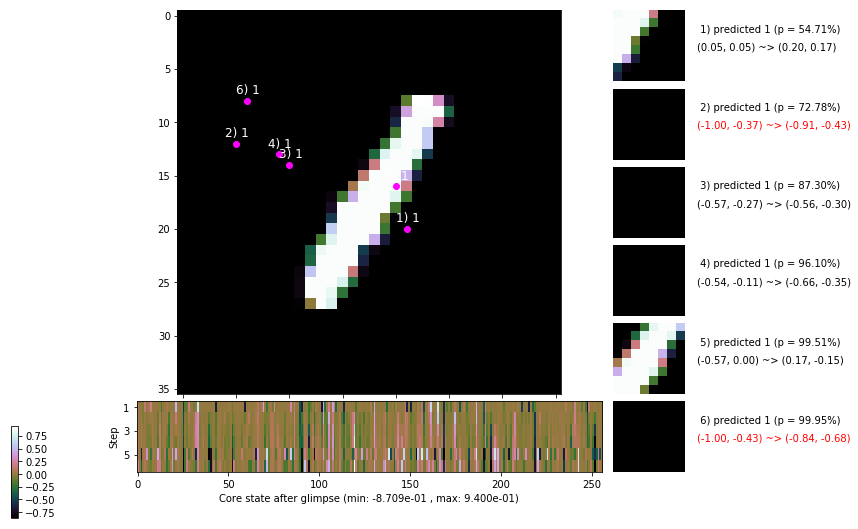

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 136.2 ms/b | lr: 5.07e-04 | grad 2norm: 10.23 | grad inf norm:  2.855
         Weights || abs max:  2.69 ( 3947.17) | mean: -2.71e-04 ( 0.02) | var: 7.28e-02 (  677.08)
          Biases || abs max:  1.33 (  240.41) | mean: -1.46e-01 ( 0.15) | var: 9.04e-02 ( 1616.19)
                    class loss: 0.286 | steps: 2.216 | reward:  3.756 | acc.: 90.32%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 134.9 ms/b | lr: 5.06e-04 | grad 2norm:  9.97 | grad inf norm:  2.690
         Weights || abs max:  2.68 (10482.74) | mean: -2.60e-04 ( 0.03) | var: 7.29e-02 (17709.03)
          Biases || abs max:  1.33 (  139.86) | mean: -1.46e-01 ( 0.14) | var: 9.04e-02 ( 1338.54)
                    class loss: 0.274 | steps: 2.161 | reward:  3.865 | acc.: 91.27%

	Target class: 2 | Discounted rewards: [-0.389, 1.111, 1.

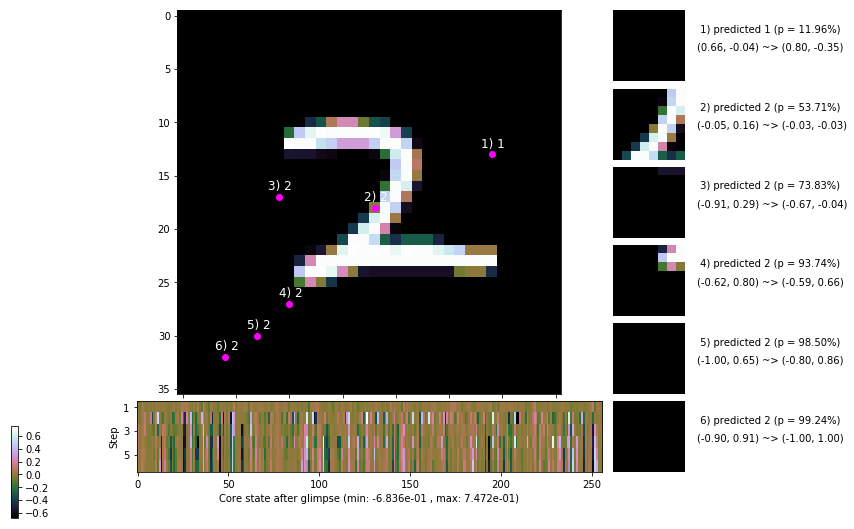

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 136.6 ms/b | lr: 5.05e-04 | grad 2norm: 10.43 | grad inf norm:  2.750
         Weights || abs max:  2.68 ( 4614.32) | mean: -2.68e-04 ( 0.02) | var: 7.29e-02 ( 1257.25)
          Biases || abs max:  1.34 (   86.83) | mean: -1.47e-01 ( 0.09) | var: 9.07e-02 (   24.01)
                    class loss: 0.302 | steps: 2.223 | reward:  3.762 | acc.: 89.98%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 137.2 ms/b | lr: 5.05e-04 | grad 2norm:  9.79 | grad inf norm:  2.549
         Weights || abs max:  2.68 (16246.46) | mean: -2.40e-04 ( 0.04) | var: 7.29e-02 (61294.79)
          Biases || abs max:  1.33 (   71.91) | mean: -1.48e-01 ( 0.08) | var: 9.08e-02 (   32.46)
                    class loss: 0.281 | steps: 2.187 | reward:  3.832 | acc.: 90.97%

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1.

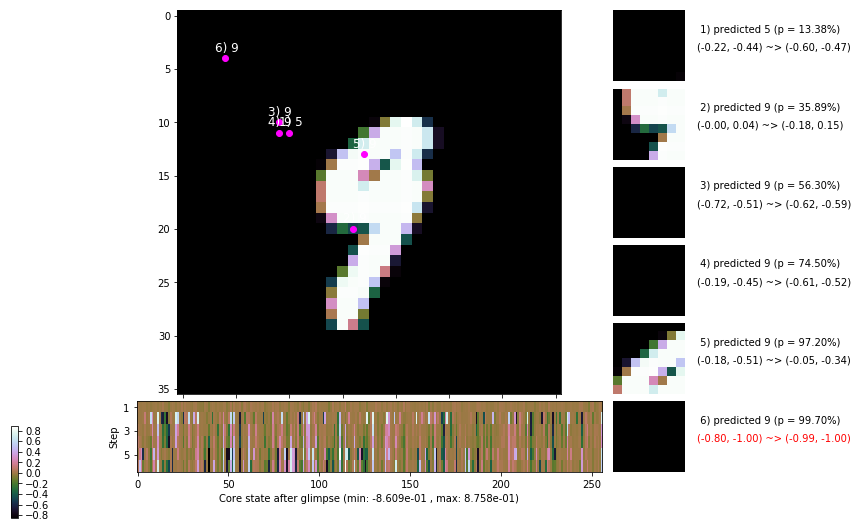

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.2 ms/b | lr: 5.04e-04 | grad 2norm:  9.82 | grad inf norm:  2.651
         Weights || abs max:  2.68 ( 2626.71) | mean: -2.49e-04 ( 0.01) | var: 7.30e-02 (  154.15)
          Biases || abs max:  1.33 (  234.21) | mean: -1.48e-01 ( 0.18) | var: 9.08e-02 ( 1583.27)
                    class loss: 0.255 | steps: 2.172 | reward:  3.869 | acc.: 91.53%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 135.3 ms/b | lr: 5.03e-04 | grad 2norm: 10.46 | grad inf norm:  2.822
         Weights || abs max:  2.68 ( 3521.74) | mean: -2.83e-04 ( 0.02) | var: 7.31e-02 (  346.13)
          Biases || abs max:  1.33 ( 1025.58) | mean: -1.47e-01 ( 0.49) | var: 9.09e-02 (13778.63)
                    class loss: 0.302 | steps: 2.213 | reward:  3.768 | acc.: 89.80%

	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1.

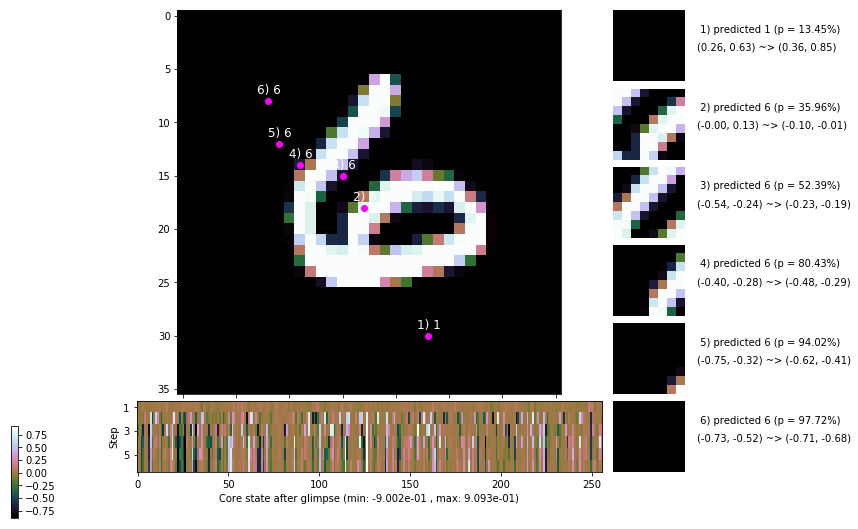

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 138.0 ms/b | lr: 5.02e-04 | grad 2norm: 10.19 | grad inf norm:  2.799
         Weights || abs max:  2.68 ( 3870.81) | mean: -2.85e-04 ( 0.02) | var: 7.31e-02 (  648.85)
          Biases || abs max:  1.32 ( 1149.59) | mean: -1.47e-01 ( 0.52) | var: 9.11e-02 (34180.72)
                    class loss: 0.287 | steps: 2.192 | reward:  3.817 | acc.: 90.52%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 135.0 ms/b | lr: 5.02e-04 | grad 2norm: 10.05 | grad inf norm:  2.705
         Weights || abs max:  2.68 ( 3801.42) | mean: -3.15e-04 ( 0.02) | var: 7.32e-02 (  363.77)
          Biases || abs max:  1.32 ( 1890.61) | mean: -1.47e-01 ( 0.83) | var: 9.11e-02 (42565.70)
                    class loss: 0.290 | steps: 2.196 | reward:  3.805 | acc.: 90.55%

	Target class: 3 | Discounted rewards: [-0.389, 1.111, 1.

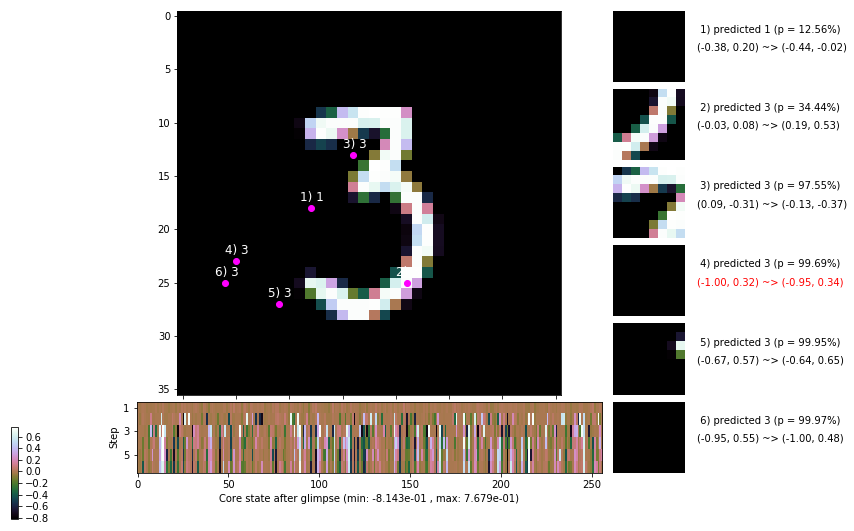

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


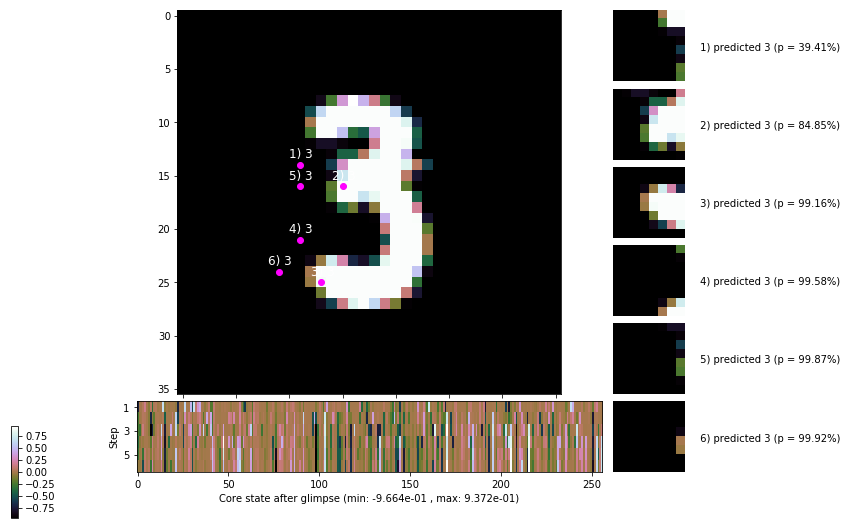


	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


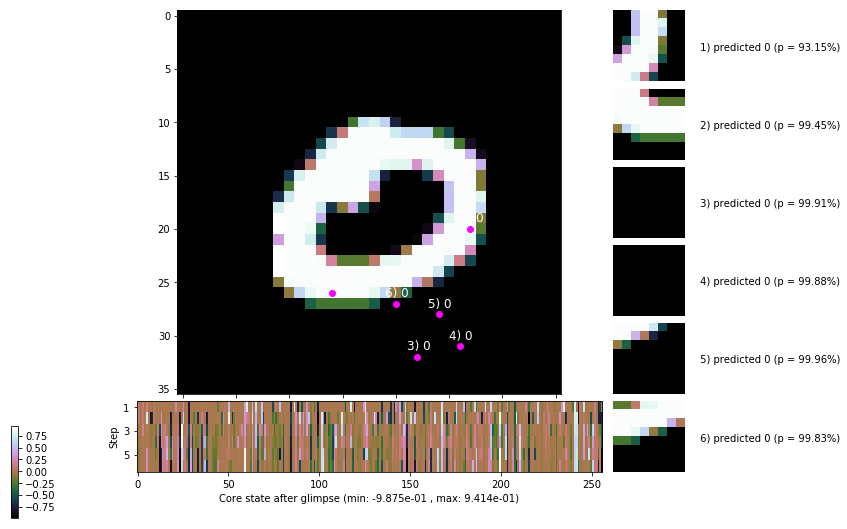

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


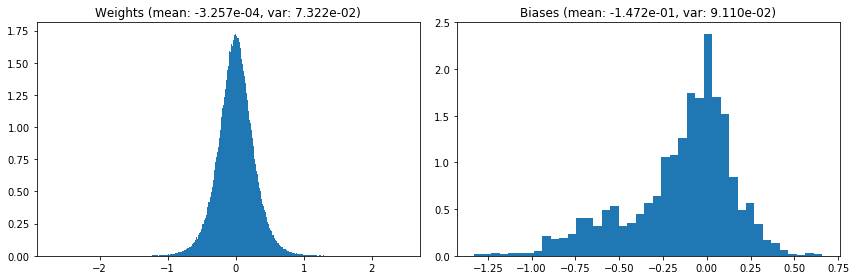

                                      Location network weights and biases


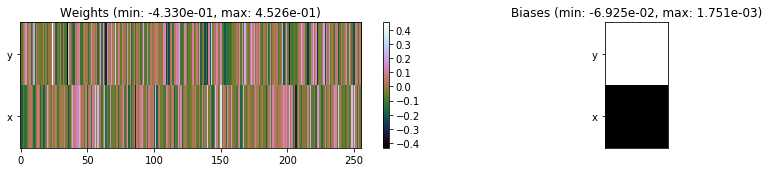

---------------------------------------------------------------------------------------------------------------
Elapsed time:  414.20 sec | TRAIN >> class loss: 0.2858 | steps:  2.200 :( | reward:  3.8005 :( | acc.: 90.547% :(
                          | VAL   >> class loss: 0.3001 | steps:  2.111 :( | reward:  3.9603 :( | acc.: 89.980% :(


Epoch  47/400) lr = 0.0005014
 b    300/  3000 >> 131.1 ms/b | lr: 5.01e-04 | grad 2norm: 10.01 | grad inf norm:  2.730
         Weights || abs max:  2.67 ( 2278.94) | mean: -3.22e-04 ( 0.01) | var: 7.32e-02 (   60.15)
          Biases || abs max:  1.33 (  379.30) | mean: -1.47e-01 ( 0.22) | var: 9.10e-02 (  678.69)
                    class loss: 0.283 | steps: 2.199 | reward:  3.839 | acc.: 90.92%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 137.3 ms/b | lr: 5.00e-04 | grad 2norm: 10.04 | grad inf norm:  2.696
         Weights || abs max:  2.68 ( 3373.08) | mean: -3.29e-04 (

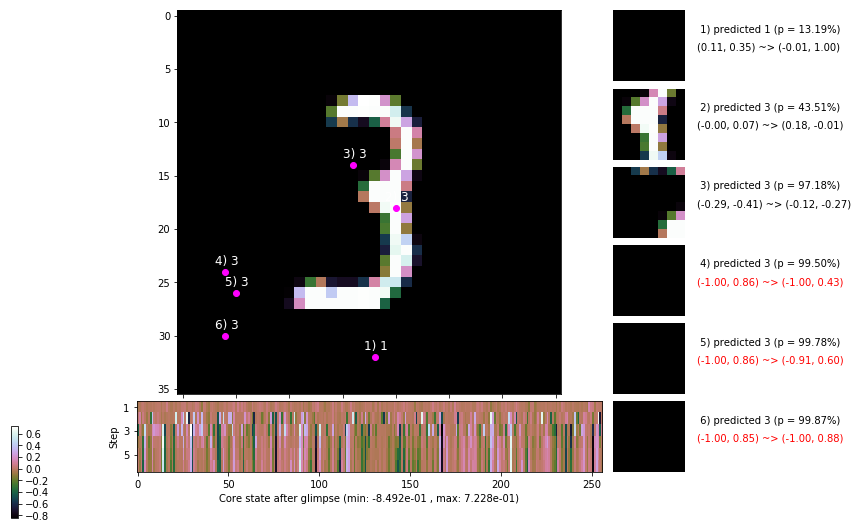

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 138.2 ms/b | lr: 4.99e-04 | grad 2norm:  9.90 | grad inf norm:  2.636
         Weights || abs max:  2.69 ( 5899.78) | mean: -3.29e-04 ( 0.02) | var: 7.33e-02 ( 5000.11)
          Biases || abs max:  1.33 (  426.80) | mean: -1.47e-01 ( 0.25) | var: 9.13e-02 (  758.02)
                    class loss: 0.282 | steps: 2.182 | reward:  3.854 | acc.: 90.63%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 134.3 ms/b | lr: 4.99e-04 | grad 2norm: 10.11 | grad inf norm:  2.756
         Weights || abs max:  2.69 (11828.64) | mean: -3.08e-04 ( 0.03) | var: 7.34e-02 (29262.61)
          Biases || abs max:  1.32 (  386.06) | mean: -1.47e-01 ( 0.24) | var: 9.15e-02 (  362.81)
                    class loss: 0.306 | steps: 2.188 | reward:  3.798 | acc.: 89.73%

	Target class: 5 | Discounted rewards: [-0.404, 0.961, -0

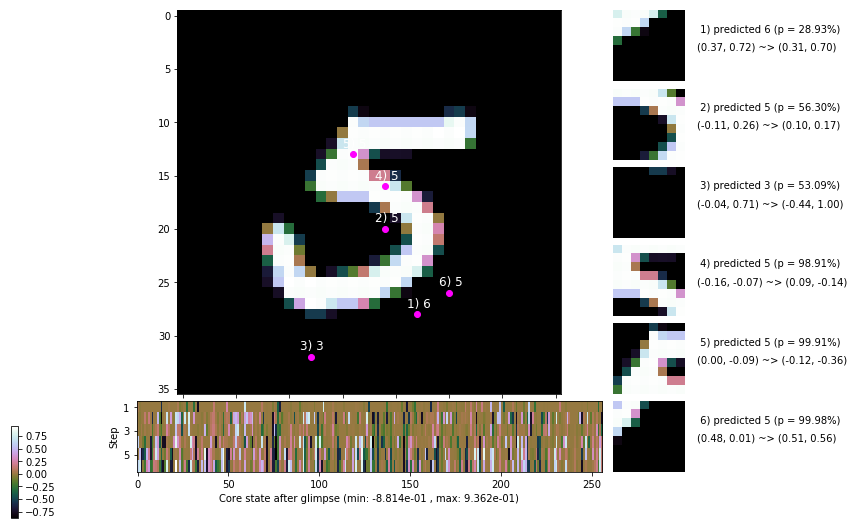

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 135.7 ms/b | lr: 4.98e-04 | grad 2norm:  9.97 | grad inf norm:  2.761
         Weights || abs max:  2.70 ( 6806.38) | mean: -2.86e-04 ( 0.02) | var: 7.35e-02 ( 2833.68)
          Biases || abs max:  1.32 (  461.36) | mean: -1.47e-01 ( 0.27) | var: 9.15e-02 (  935.87)
                    class loss: 0.297 | steps: 2.215 | reward:  3.773 | acc.: 89.95%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 134.0 ms/b | lr: 4.97e-04 | grad 2norm: 10.02 | grad inf norm:  2.744
         Weights || abs max:  2.69 ( 2857.68) | mean: -2.73e-04 ( 0.01) | var: 7.35e-02 (  178.10)
          Biases || abs max:  1.33 (   86.52) | mean: -1.47e-01 ( 0.10) | var: 9.16e-02 (   23.97)
                    class loss: 0.292 | steps: 2.191 | reward:  3.805 | acc.: 90.42%

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1.

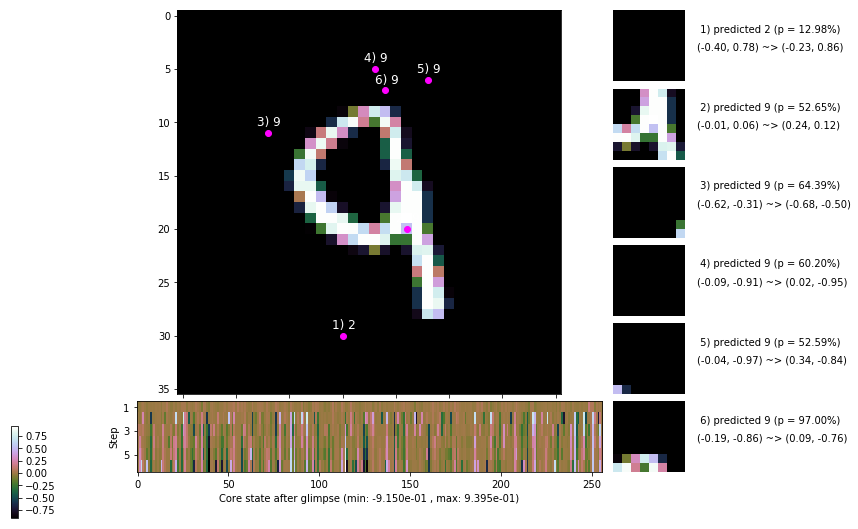

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 135.1 ms/b | lr: 4.96e-04 | grad 2norm: 10.00 | grad inf norm:  2.821
         Weights || abs max:  2.69 ( 3212.23) | mean: -2.65e-04 ( 0.02) | var: 7.36e-02 (  160.27)
          Biases || abs max:  1.33 (   99.66) | mean: -1.48e-01 ( 0.10) | var: 9.15e-02 (   28.69)
                    class loss: 0.285 | steps: 2.205 | reward:  3.792 | acc.: 90.53%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 134.7 ms/b | lr: 4.96e-04 | grad 2norm: 10.02 | grad inf norm:  2.664
         Weights || abs max:  2.69 ( 2609.20) | mean: -2.72e-04 ( 0.01) | var: 7.36e-02 (  103.29)
          Biases || abs max:  1.33 (  120.76) | mean: -1.48e-01 ( 0.11) | var: 9.14e-02 (  293.80)
                    class loss: 0.289 | steps: 2.202 | reward:  3.807 | acc.: 90.55%

	Target class: 8 | Discounted rewards: [-0.406, 0.945, -0

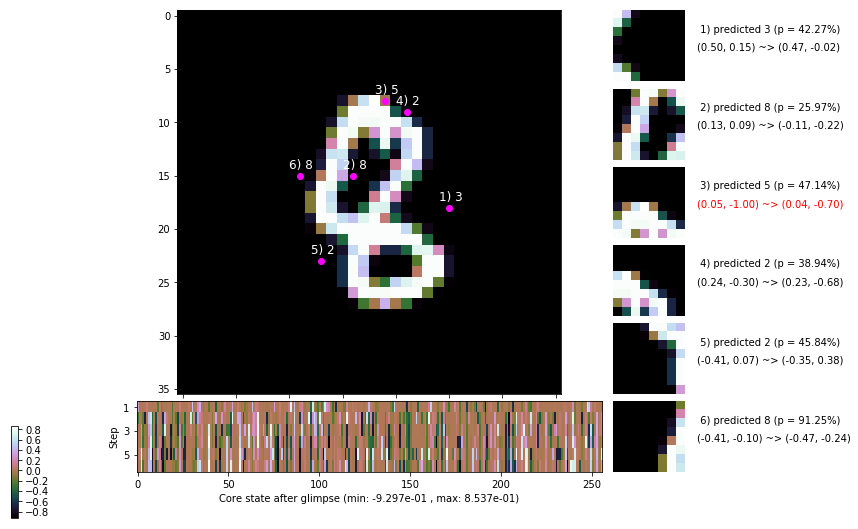

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 137.1 ms/b | lr: 4.95e-04 | grad 2norm: 10.18 | grad inf norm:  2.702
         Weights || abs max:  2.69 ( 7389.79) | mean: -2.83e-04 ( 0.02) | var: 7.37e-02 (11262.05)
          Biases || abs max:  1.34 (  158.11) | mean: -1.48e-01 ( 0.14) | var: 9.15e-02 (  232.08)
                    class loss: 0.282 | steps: 2.219 | reward:  3.765 | acc.: 90.32%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 136.2 ms/b | lr: 4.94e-04 | grad 2norm: 10.20 | grad inf norm:  2.796
         Weights || abs max:  2.69 ( 3719.02) | mean: -2.77e-04 ( 0.02) | var: 7.37e-02 (  308.90)
          Biases || abs max:  1.35 (  135.82) | mean: -1.48e-01 ( 0.11) | var: 9.15e-02 (  533.42)
                    class loss: 0.277 | steps: 2.167 | reward:  3.843 | acc.: 90.50%

	Target class: 3 | Discounted rewards: [-0.389, 1.111, 1.

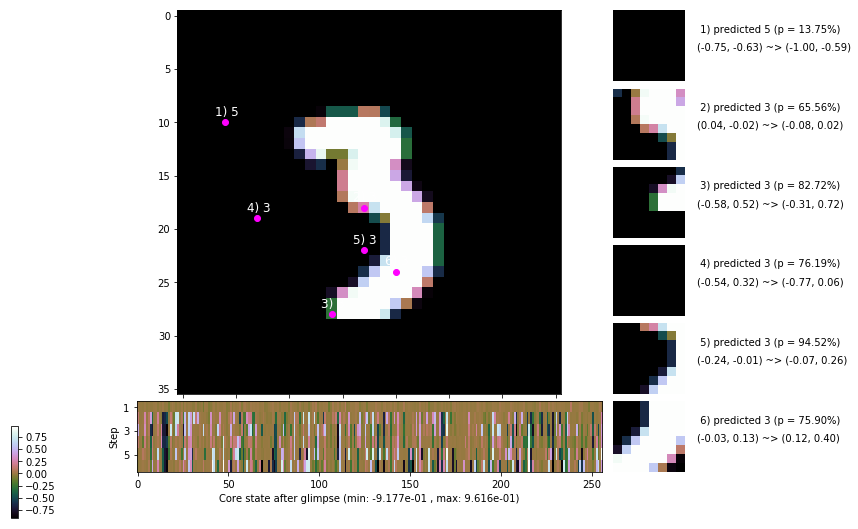

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


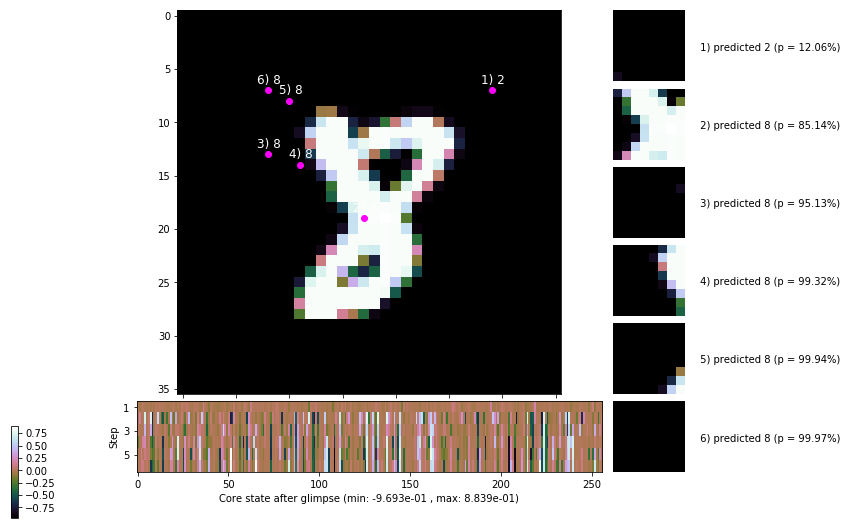


	Target class: 4 | Discounted rewards: [-0.539, -0.389, 1.111, 1.110, 1.100, 1.000]


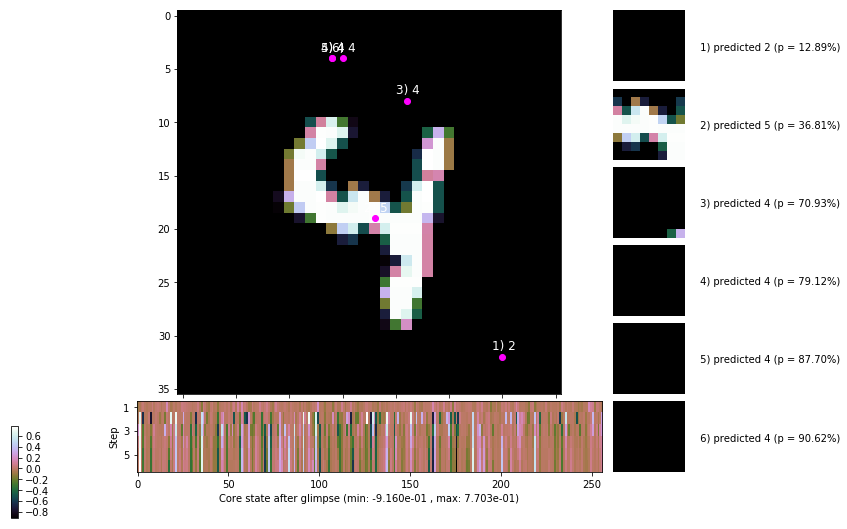

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


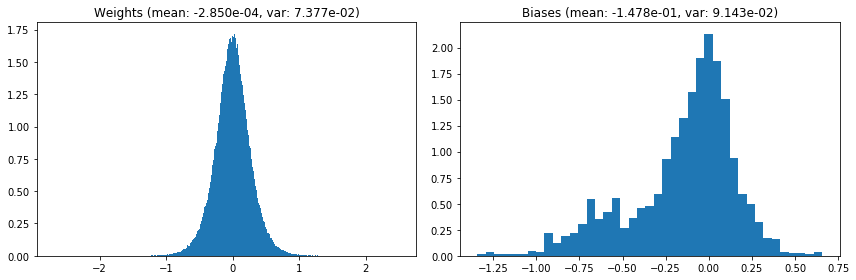

                                      Location network weights and biases


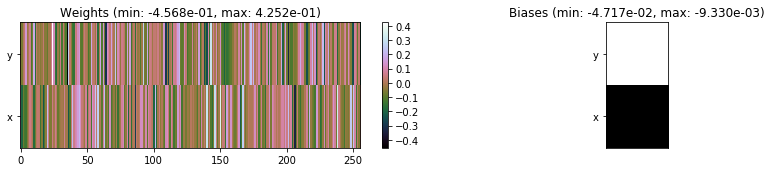

---------------------------------------------------------------------------------------------------------------
Elapsed time:  406.69 sec | TRAIN >> class loss: 0.2880 | steps:  2.200 :( | reward:  3.8072 :( | acc.: 90.402% :(
                          | VAL   >> class loss: 0.2973 | steps:  2.104 :( | reward:  3.9429 :( | acc.: 90.100% :(


Epoch  48/400) lr = 0.0004939
 b    300/  3000 >> 155.3 ms/b | lr: 4.93e-04 | grad 2norm: 10.15 | grad inf norm:  2.655
         Weights || abs max:  2.69 ( 2853.79) | mean: -2.81e-04 ( 0.01) | var: 7.38e-02 (  126.40)
          Biases || abs max:  1.35 (  367.13) | mean: -1.48e-01 ( 0.23) | var: 9.15e-02 ( 3958.48)
                    class loss: 0.285 | steps: 2.191 | reward:  3.812 | acc.: 90.50%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 136.0 ms/b | lr: 4.93e-04 | grad 2norm:  9.99 | grad inf norm:  2.606
         Weights || abs max:  2.69 ( 2650.98) | mean: -2.87e-04 (

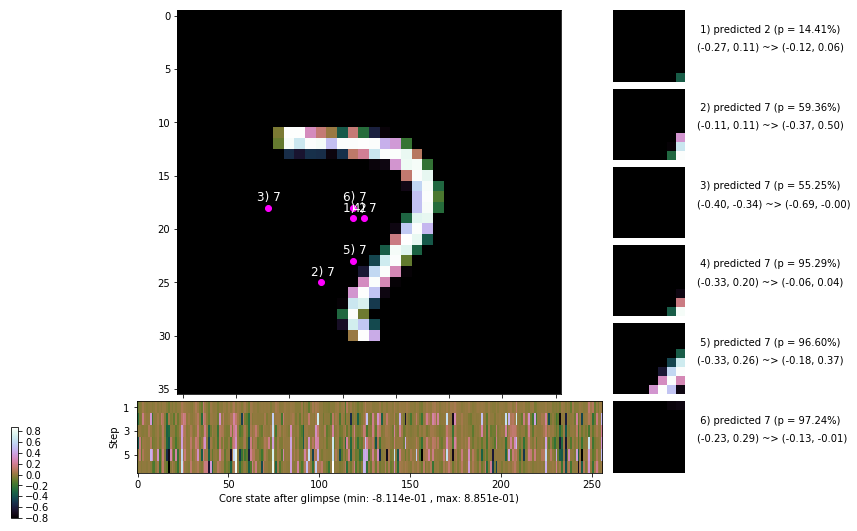

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 137.2 ms/b | lr: 4.92e-04 | grad 2norm: 10.26 | grad inf norm:  2.690
         Weights || abs max:  2.68 ( 1979.63) | mean: -2.69e-04 ( 0.01) | var: 7.39e-02 (  110.55)
          Biases || abs max:  1.34 (  211.63) | mean: -1.48e-01 ( 0.15) | var: 9.17e-02 (  316.05)
                    class loss: 0.296 | steps: 2.194 | reward:  3.774 | acc.: 89.80%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 133.6 ms/b | lr: 4.91e-04 | grad 2norm: 10.21 | grad inf norm:  2.809
         Weights || abs max:  2.68 (36284.70) | mean: -2.66e-04 ( 0.08) | var: 7.39e-02 (624732.88)
          Biases || abs max:  1.34 (  103.97) | mean: -1.48e-01 ( 0.11) | var: 9.20e-02 (  103.18)
                    class loss: 0.291 | steps: 2.215 | reward:  3.772 | acc.: 90.30%

	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1

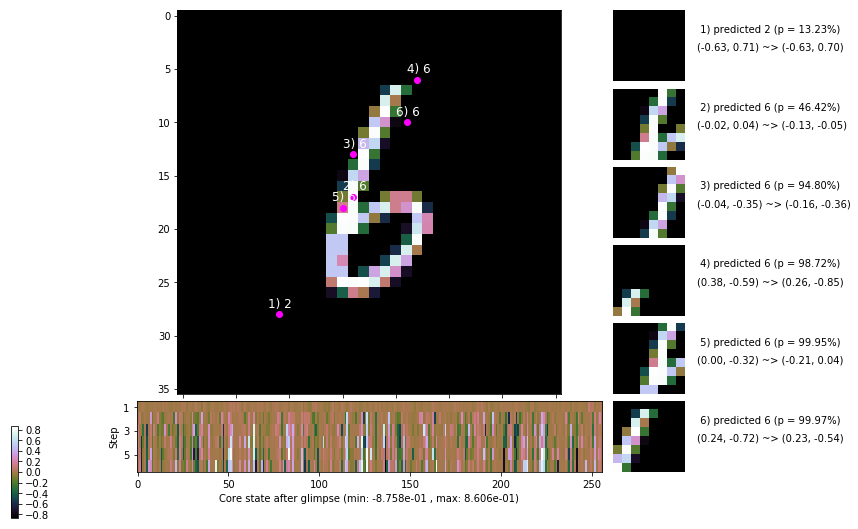

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 137.6 ms/b | lr: 4.90e-04 | grad 2norm: 10.34 | grad inf norm:  2.738
         Weights || abs max:  2.68 ( 2818.51) | mean: -2.61e-04 ( 0.01) | var: 7.40e-02 (  157.81)
          Biases || abs max:  1.34 (   77.94) | mean: -1.48e-01 ( 0.10) | var: 9.21e-02 (   30.69)
                    class loss: 0.293 | steps: 2.223 | reward:  3.767 | acc.: 90.08%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 136.7 ms/b | lr: 4.90e-04 | grad 2norm: 10.05 | grad inf norm:  2.668
         Weights || abs max:  2.68 ( 2790.52) | mean: -2.76e-04 ( 0.01) | var: 7.40e-02 (  216.15)
          Biases || abs max:  1.34 (  159.73) | mean: -1.48e-01 ( 0.13) | var: 9.22e-02 (  292.30)
                    class loss: 0.274 | steps: 2.181 | reward:  3.818 | acc.: 90.47%

	Target class: 2 | Discounted rewards: [-0.389, 1.111, 1.

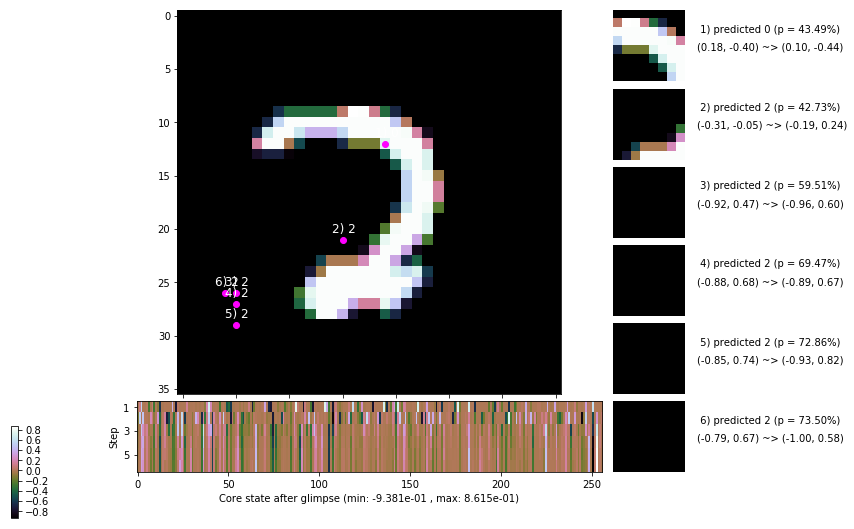

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 137.6 ms/b | lr: 4.89e-04 | grad 2norm:  9.81 | grad inf norm:  2.633
         Weights || abs max:  2.69 ( 4159.66) | mean: -2.81e-04 ( 0.02) | var: 7.41e-02 ( 1707.87)
          Biases || abs max:  1.34 (  134.44) | mean: -1.49e-01 ( 0.12) | var: 9.22e-02 (  190.91)
                    class loss: 0.301 | steps: 2.191 | reward:  3.801 | acc.: 90.17%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 135.9 ms/b | lr: 4.89e-04 | grad 2norm:  9.96 | grad inf norm:  2.709
         Weights || abs max:  2.68 ( 3892.15) | mean: -3.08e-04 ( 0.02) | var: 7.41e-02 (  601.98)
          Biases || abs max:  1.34 (   89.20) | mean: -1.48e-01 ( 0.09) | var: 9.23e-02 (   32.93)
                    class loss: 0.300 | steps: 2.218 | reward:  3.799 | acc.: 90.15%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

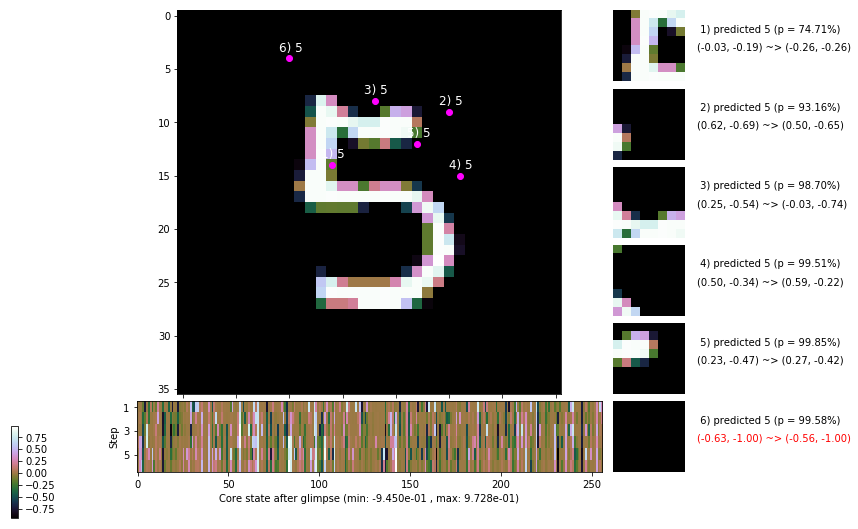

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 136.9 ms/b | lr: 4.88e-04 | grad 2norm: 10.23 | grad inf norm:  2.789
         Weights || abs max:  2.68 ( 6642.12) | mean: -2.90e-04 ( 0.02) | var: 7.42e-02 ( 8202.59)
          Biases || abs max:  1.35 (   64.41) | mean: -1.48e-01 ( 0.08) | var: 9.25e-02 (   32.84)
                    class loss: 0.307 | steps: 2.225 | reward:  3.724 | acc.: 89.40%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 132.8 ms/b | lr: 4.87e-04 | grad 2norm: 10.07 | grad inf norm:  2.669
         Weights || abs max:  2.69 ( 2502.17) | mean: -3.15e-04 ( 0.01) | var: 7.43e-02 (   83.67)
          Biases || abs max:  1.34 (  127.32) | mean: -1.48e-01 ( 0.11) | var: 9.24e-02 (  135.03)
                    class loss: 0.305 | steps: 2.235 | reward:  3.731 | acc.: 89.72%

	Target class: 0 | Discounted rewards: [-0.389, 1.111, 1.

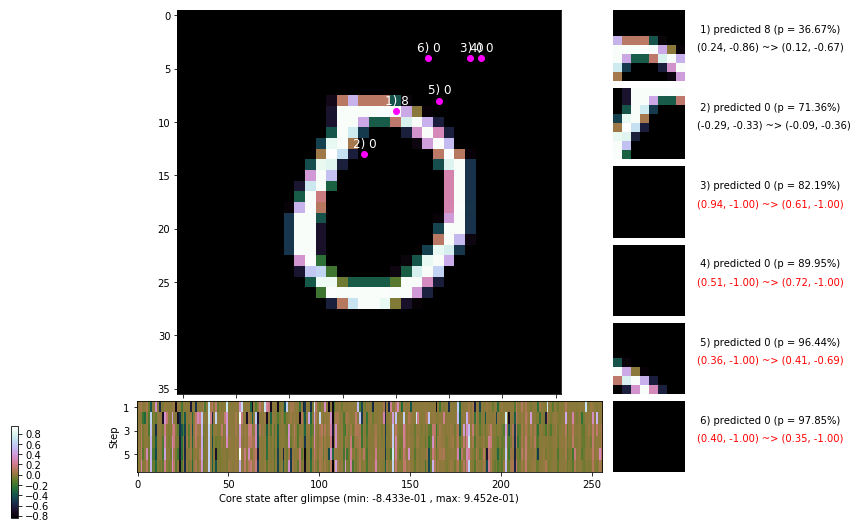

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


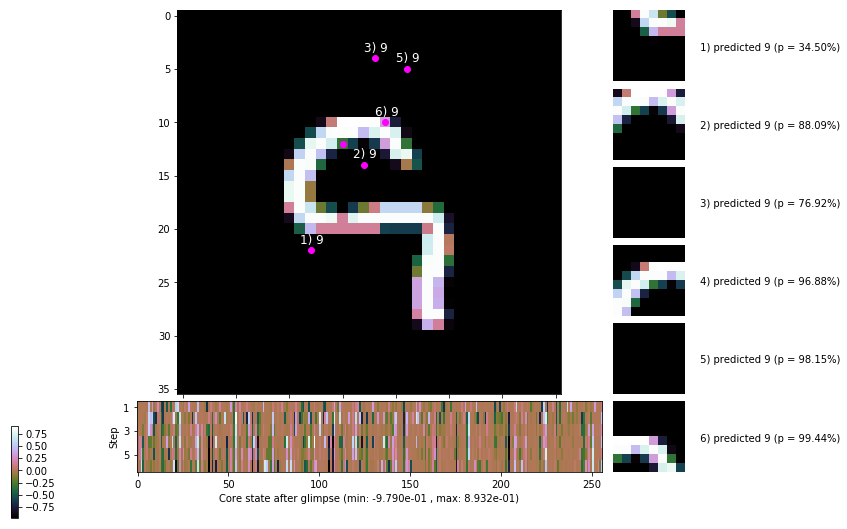


	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


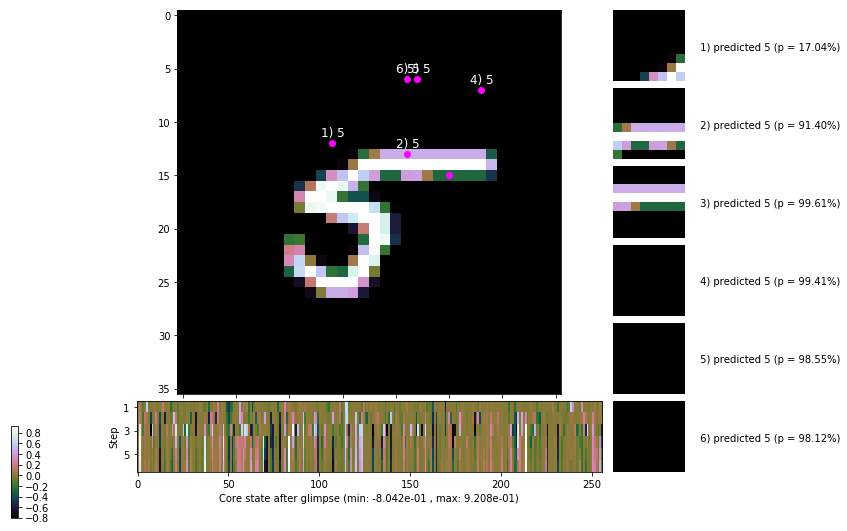

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


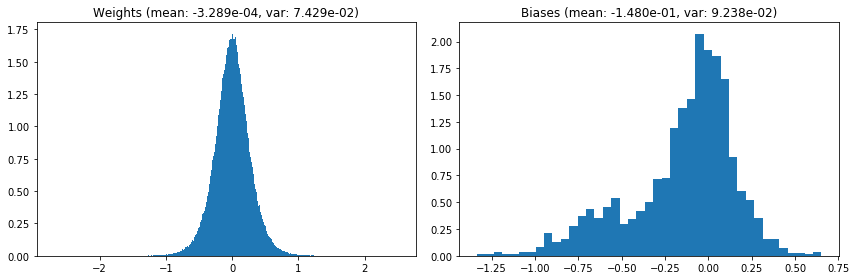

                                      Location network weights and biases


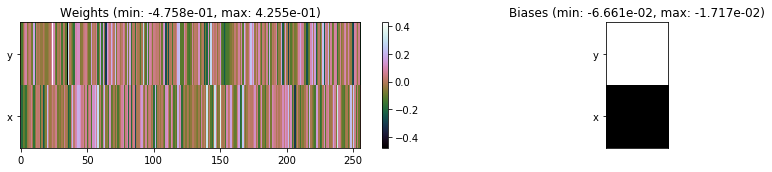

---------------------------------------------------------------------------------------------------------------
Elapsed time:  414.51 sec | TRAIN >> class loss: 0.2911 | steps:  2.206 :( | reward:  3.7839 :( | acc.: 90.148% :(
                          | VAL   >> class loss: 0.3130 | steps:  2.128 :( | reward:  3.9021 :( | acc.: 89.220% :(


Epoch  49/400) lr = 0.0004866
 b    300/  3000 >> 134.0 ms/b | lr: 4.86e-04 | grad 2norm: 10.28 | grad inf norm:  2.693
         Weights || abs max:  2.69 ( 9186.22) | mean: -3.46e-04 ( 0.03) | var: 7.43e-02 (20979.36)
          Biases || abs max:  1.34 (  111.70) | mean: -1.48e-01 ( 0.10) | var: 9.23e-02 (   98.53)
                    class loss: 0.299 | steps: 2.209 | reward:  3.757 | acc.: 90.18%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 135.1 ms/b | lr: 4.86e-04 | grad 2norm:  9.98 | grad inf norm:  2.678
         Weights || abs max:  2.69 ( 4285.79) | mean: -3.55e-04 (

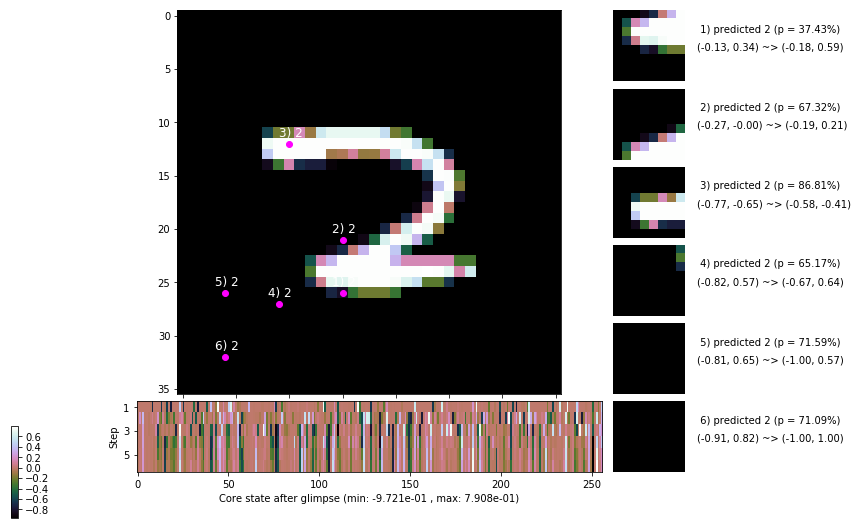

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 137.9 ms/b | lr: 4.85e-04 | grad 2norm: 10.30 | grad inf norm:  2.787
         Weights || abs max:  2.69 ( 2540.30) | mean: -3.82e-04 ( 0.01) | var: 7.44e-02 (  136.29)
          Biases || abs max:  1.35 (  211.70) | mean: -1.48e-01 ( 0.16) | var: 9.23e-02 (  141.37)
                    class loss: 0.287 | steps: 2.234 | reward:  3.775 | acc.: 90.28%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 134.6 ms/b | lr: 4.84e-04 | grad 2norm: 10.21 | grad inf norm:  2.762
         Weights || abs max:  2.70 ( 4920.47) | mean: -3.74e-04 ( 0.02) | var: 7.45e-02 ( 4356.44)
          Biases || abs max:  1.36 (  204.95) | mean: -1.47e-01 ( 0.16) | var: 9.24e-02 (  562.25)
                    class loss: 0.300 | steps: 2.209 | reward:  3.781 | acc.: 89.83%

	Target class: 3 | Discounted rewards: [1.096, 0.961, -0.

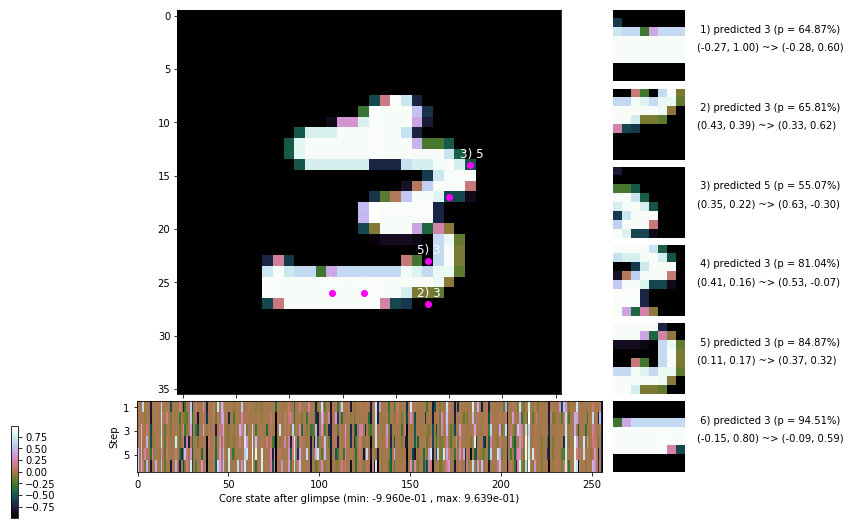

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.5 ms/b | lr: 4.83e-04 | grad 2norm: 10.08 | grad inf norm:  2.746
         Weights || abs max:  2.70 ( 9020.81) | mean: -3.59e-04 ( 0.03) | var: 7.45e-02 ( 8843.23)
          Biases || abs max:  1.37 (  186.29) | mean: -1.48e-01 ( 0.15) | var: 9.25e-02 (   97.60)
                    class loss: 0.298 | steps: 2.200 | reward:  3.769 | acc.: 89.73%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 139.5 ms/b | lr: 4.83e-04 | grad 2norm: 10.24 | grad inf norm:  2.684
         Weights || abs max:  2.70 ( 8863.70) | mean: -3.24e-04 ( 0.03) | var: 7.46e-02 ( 7400.47)
          Biases || abs max:  1.37 ( 1181.28) | mean: -1.48e-01 ( 0.54) | var: 9.27e-02 (16159.36)
                    class loss: 0.311 | steps: 2.219 | reward:  3.741 | acc.: 89.75%

	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1.

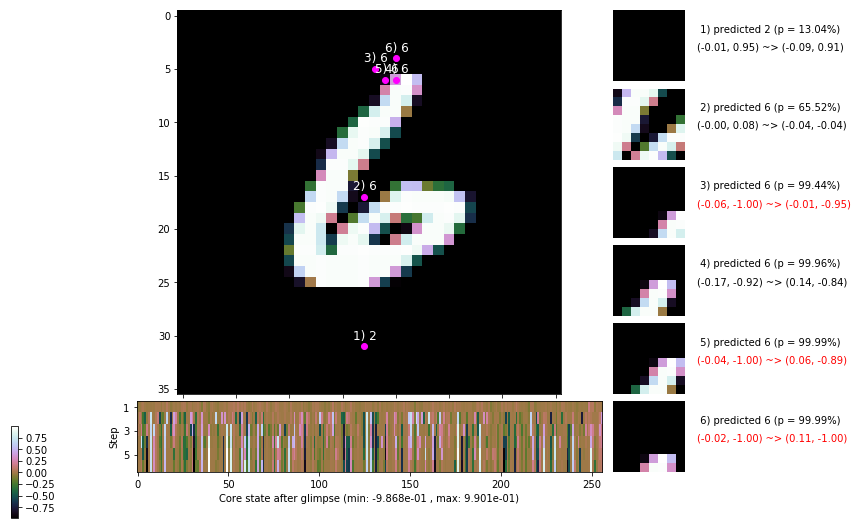

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 136.5 ms/b | lr: 4.82e-04 | grad 2norm: 10.32 | grad inf norm:  2.772
         Weights || abs max:  2.70 ( 4078.78) | mean: -3.21e-04 ( 0.02) | var: 7.46e-02 (  789.92)
          Biases || abs max:  1.37 (  337.30) | mean: -1.48e-01 ( 0.19) | var: 9.24e-02 ( 1924.10)
                    class loss: 0.310 | steps: 2.223 | reward:  3.740 | acc.: 89.40%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 134.4 ms/b | lr: 4.81e-04 | grad 2norm: 10.21 | grad inf norm:  2.844
         Weights || abs max:  2.71 ( 3595.78) | mean: -3.17e-04 ( 0.02) | var: 7.47e-02 (  420.09)
          Biases || abs max:  1.37 (  268.61) | mean: -1.48e-01 ( 0.17) | var: 9.26e-02 (  176.08)
                    class loss: 0.300 | steps: 2.228 | reward:  3.747 | acc.: 89.70%

	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1.

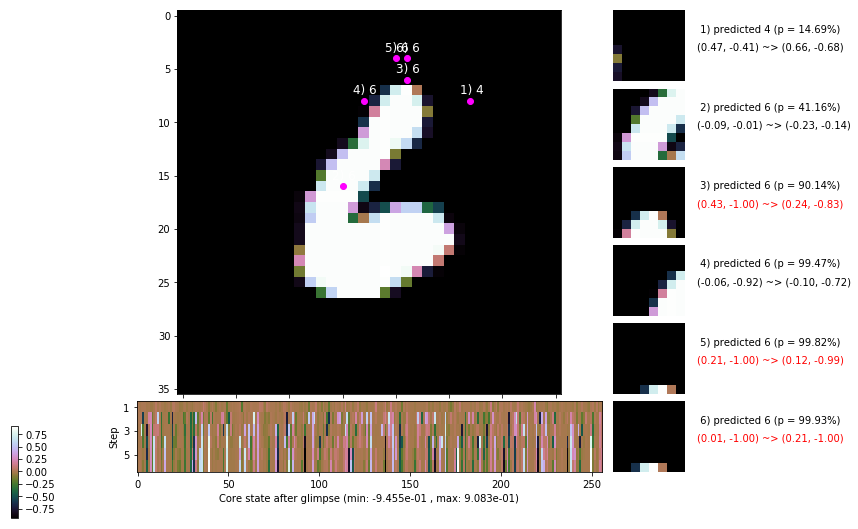

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 136.9 ms/b | lr: 4.80e-04 | grad 2norm:  9.93 | grad inf norm:  2.737
         Weights || abs max:  2.72 ( 3840.16) | mean: -3.08e-04 ( 0.01) | var: 7.47e-02 ( 1102.47)
          Biases || abs max:  1.37 (  249.02) | mean: -1.48e-01 ( 0.19) | var: 9.27e-02 ( 1269.72)
                    class loss: 0.292 | steps: 2.196 | reward:  3.816 | acc.: 90.10%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 133.6 ms/b | lr: 4.80e-04 | grad 2norm: 10.11 | grad inf norm:  2.796
         Weights || abs max:  2.72 ( 2969.89) | mean: -3.11e-04 ( 0.01) | var: 7.48e-02 (  245.38)
          Biases || abs max:  1.37 ( 1148.00) | mean: -1.48e-01 ( 0.52) | var: 9.29e-02 (108785.30)
                    class loss: 0.309 | steps: 2.213 | reward:  3.784 | acc.: 89.62%

	Target class: 0 | Discounted rewards: [-0.389, 1.111, 1

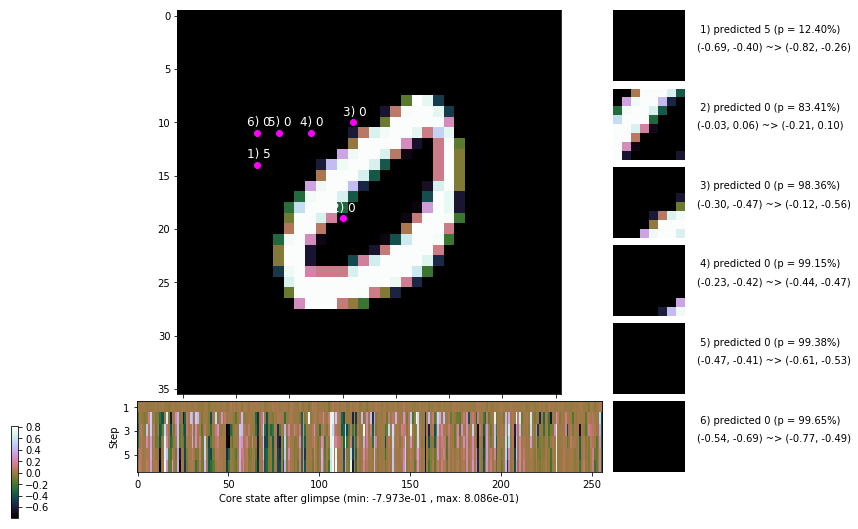

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


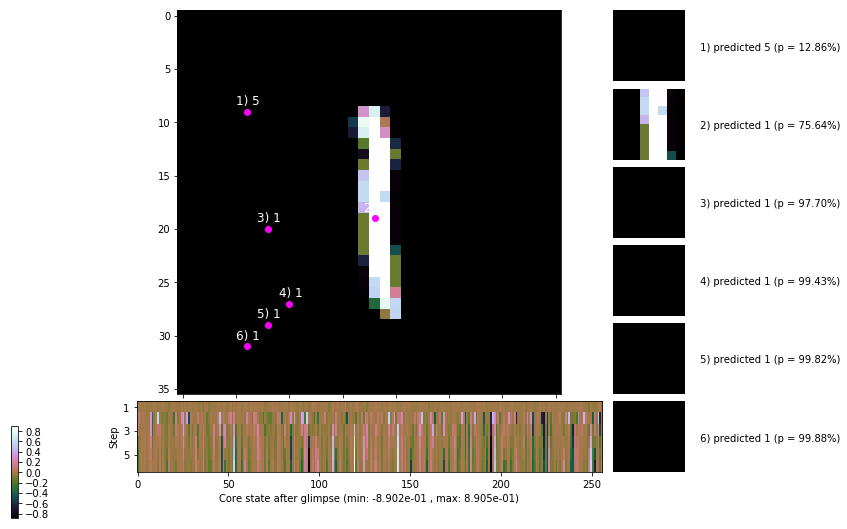


	Target class: 6 | Discounted rewards: [-0.389, 1.111, 1.111, 1.110, 1.100, 1.000]


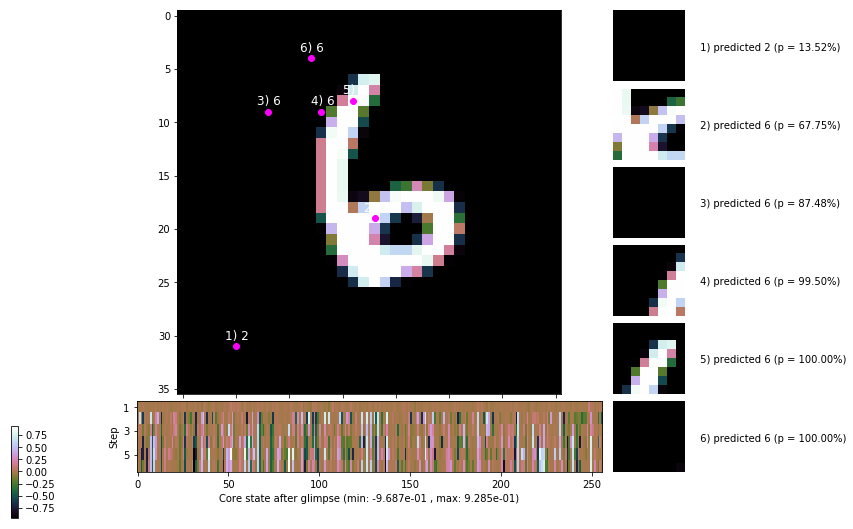

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


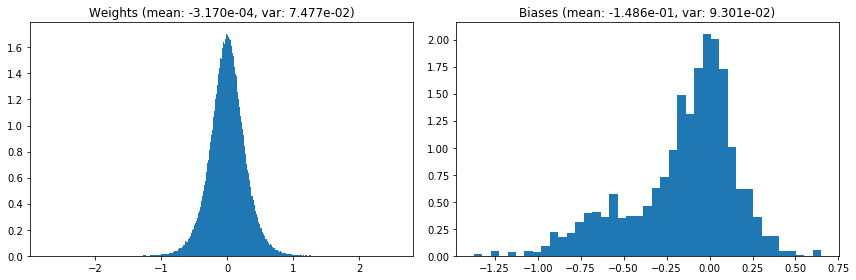

                                      Location network weights and biases


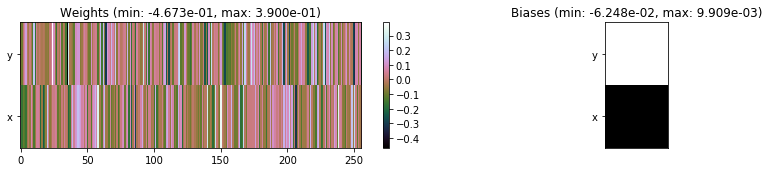

---------------------------------------------------------------------------------------------------------------
Elapsed time:  414.14 sec | TRAIN >> class loss: 0.3004 | steps:  2.214 :( | reward:  3.7696 :( | acc.: 89.905% :(
                          | VAL   >> class loss: 0.3114 | steps:  2.122 :( | reward:  3.9414 :( | acc.: 89.520% :(


Epoch  50/400) lr = 0.0004793
 b    300/  3000 >> 132.5 ms/b | lr: 4.79e-04 | grad 2norm:  9.97 | grad inf norm:  2.691
         Weights || abs max:  2.72 ( 4748.58) | mean: -3.08e-04 ( 0.02) | var: 7.48e-02 ( 1246.25)
          Biases || abs max:  1.38 (   84.93) | mean: -1.49e-01 ( 0.10) | var: 9.31e-02 (   39.24)
                    class loss: 0.287 | steps: 2.205 | reward:  3.785 | acc.: 90.35%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 133.9 ms/b | lr: 4.78e-04 | grad 2norm:  9.93 | grad inf norm:  2.639
         Weights || abs max:  2.73 ( 2003.58) | mean: -3.33e-04 (

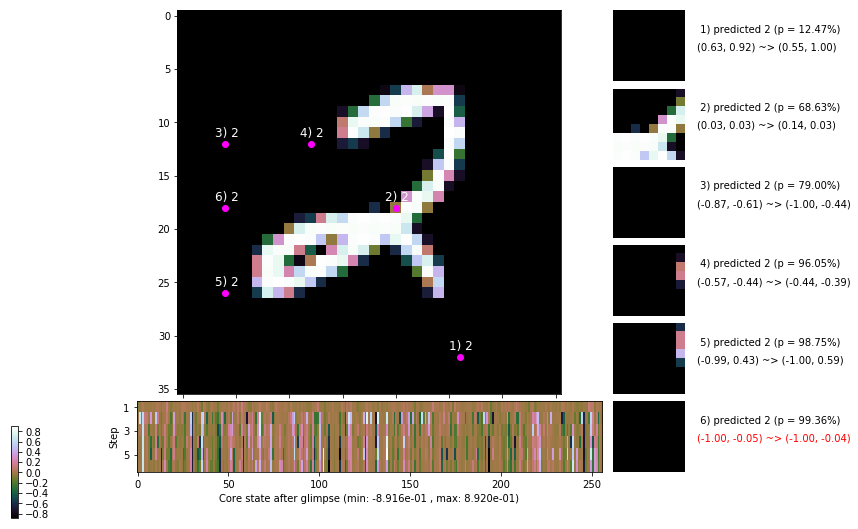

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 136.9 ms/b | lr: 4.77e-04 | grad 2norm: 10.23 | grad inf norm:  2.817
         Weights || abs max:  2.73 (16735.19) | mean: -3.54e-04 ( 0.04) | var: 7.49e-02 (103595.14)
          Biases || abs max:  1.37 (  185.24) | mean: -1.48e-01 ( 0.14) | var: 9.30e-02 (   65.38)
                    class loss: 0.290 | steps: 2.186 | reward:  3.808 | acc.: 90.40%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 136.7 ms/b | lr: 4.77e-04 | grad 2norm: 10.11 | grad inf norm:  2.855
         Weights || abs max:  2.73 ( 7967.09) | mean: -3.35e-04 ( 0.02) | var: 7.50e-02 (20480.07)
          Biases || abs max:  1.35 (  265.45) | mean: -1.48e-01 ( 0.18) | var: 9.32e-02 (   95.75)
                    class loss: 0.285 | steps: 2.183 | reward:  3.824 | acc.: 90.80%

	Target class: 6 | Discounted rewards: [0.961, -0.389, 1

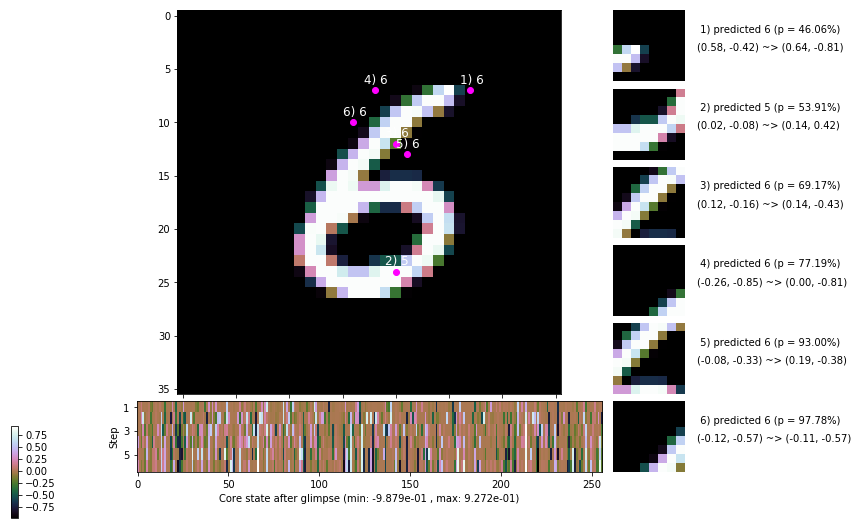

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 137.0 ms/b | lr: 4.76e-04 | grad 2norm: 10.09 | grad inf norm:  2.650
         Weights || abs max:  2.72 ( 2728.78) | mean: -3.47e-04 ( 0.01) | var: 7.50e-02 (  127.74)
          Biases || abs max:  1.35 (  656.52) | mean: -1.48e-01 ( 0.32) | var: 9.34e-02 (13060.01)
                    class loss: 0.292 | steps: 2.200 | reward:  3.799 | acc.: 90.22%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 134.5 ms/b | lr: 4.76e-04 | grad 2norm:  9.82 | grad inf norm:  2.671
         Weights || abs max:  2.73 ( 6111.97) | mean: -3.35e-04 ( 0.02) | var: 7.51e-02 ( 6338.66)
          Biases || abs max:  1.35 (  473.82) | mean: -1.48e-01 ( 0.26) | var: 9.35e-02 ( 1228.17)
                    class loss: 0.290 | steps: 2.199 | reward:  3.799 | acc.: 90.47%

	Target class: 3 | Discounted rewards: [-0.389, 1.111, 1.

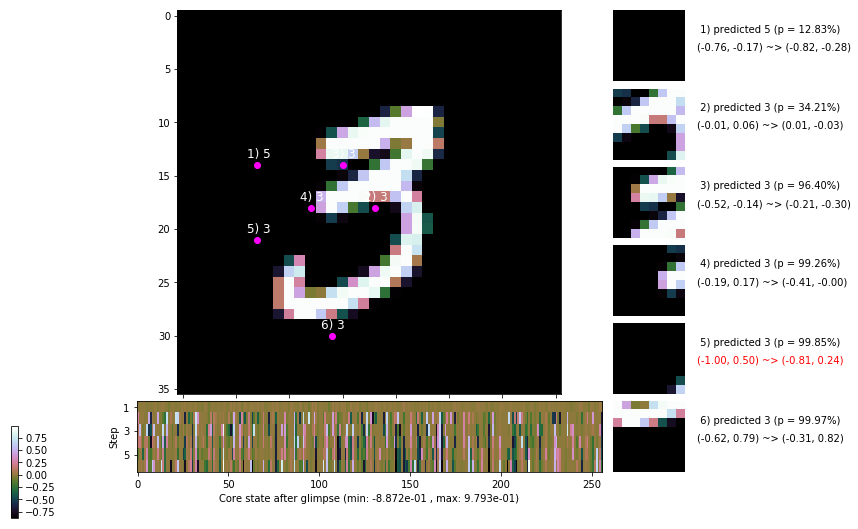

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 134.2 ms/b | lr: 4.75e-04 | grad 2norm: 10.07 | grad inf norm:  2.772
         Weights || abs max:  2.73 ( 2606.13) | mean: -3.27e-04 ( 0.01) | var: 7.51e-02 (  103.11)
          Biases || abs max:  1.36 (  217.53) | mean: -1.48e-01 ( 0.15) | var: 9.34e-02 (  147.58)
                    class loss: 0.282 | steps: 2.192 | reward:  3.812 | acc.: 90.57%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 134.0 ms/b | lr: 4.74e-04 | grad 2norm:  9.85 | grad inf norm:  2.578
         Weights || abs max:  2.73 ( 3673.48) | mean: -3.53e-04 ( 0.02) | var: 7.52e-02 (  270.24)
          Biases || abs max:  1.38 ( 1697.76) | mean: -1.48e-01 ( 0.74) | var: 9.32e-02 (136453.38)
                    class loss: 0.268 | steps: 2.209 | reward:  3.829 | acc.: 91.48%

	Target class: 9 | Discounted rewards: [-0.389, 1.111, 1

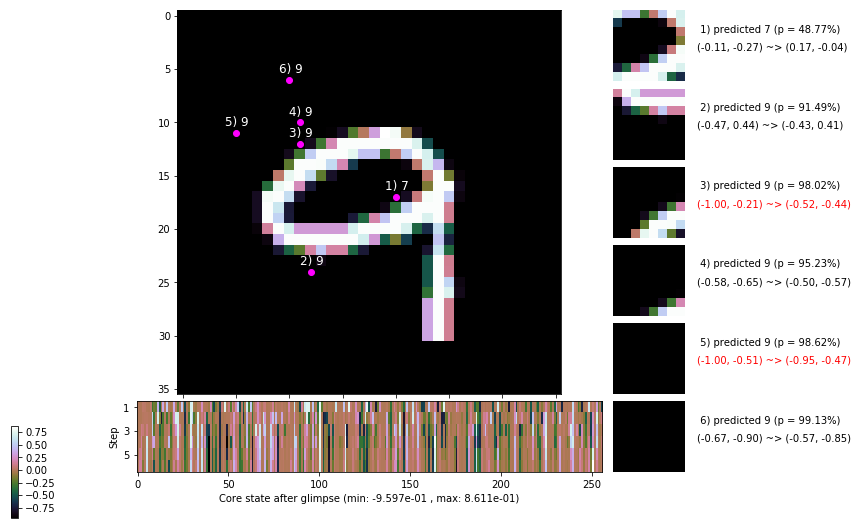

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.0 ms/b | lr: 4.73e-04 | grad 2norm: 10.00 | grad inf norm:  2.794
         Weights || abs max:  2.74 ( 3157.25) | mean: -3.50e-04 ( 0.01) | var: 7.52e-02 (  313.85)
          Biases || abs max:  1.38 (  326.40) | mean: -1.48e-01 ( 0.22) | var: 9.34e-02 (  339.57)
                    class loss: 0.288 | steps: 2.195 | reward:  3.820 | acc.: 90.32%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 148.8 ms/b | lr: 4.73e-04 | grad 2norm:  9.82 | grad inf norm:  2.729
         Weights || abs max:  2.74 ( 2419.16) | mean: -3.52e-04 ( 0.01) | var: 7.52e-02 (  109.39)
          Biases || abs max:  1.39 (  146.38) | mean: -1.48e-01 ( 0.13) | var: 9.35e-02 (  185.96)
                    class loss: 0.278 | steps: 2.184 | reward:  3.850 | acc.: 91.12%

	Target class: 9 | Discounted rewards: [-0.555, -0.554, -

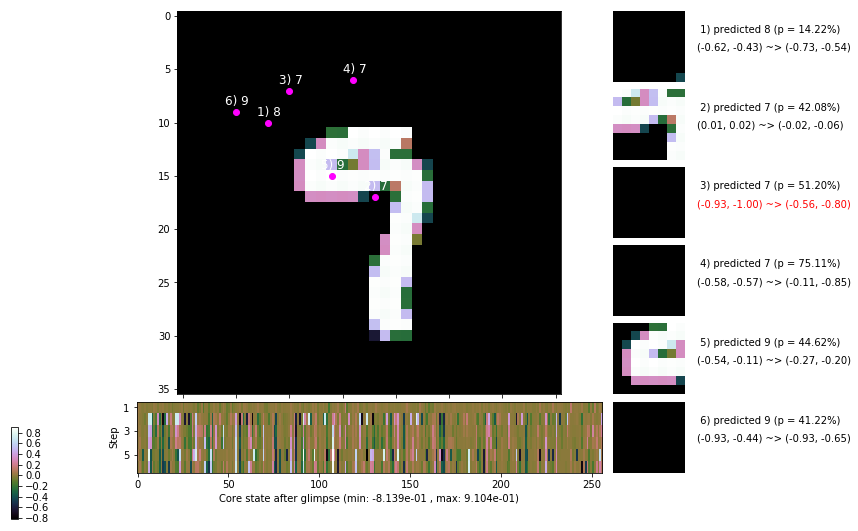

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


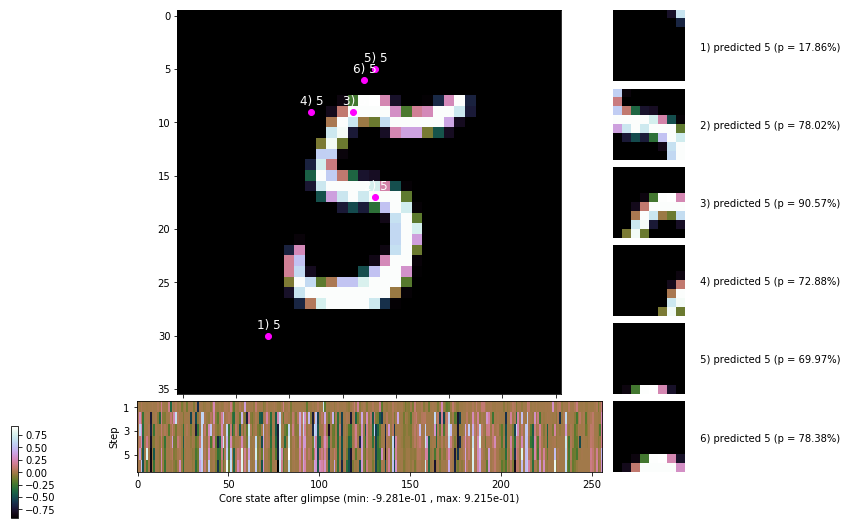


	Target class: 3 | Discounted rewards: [0.961, -0.389, 1.111, 1.110, 1.100, 1.000]


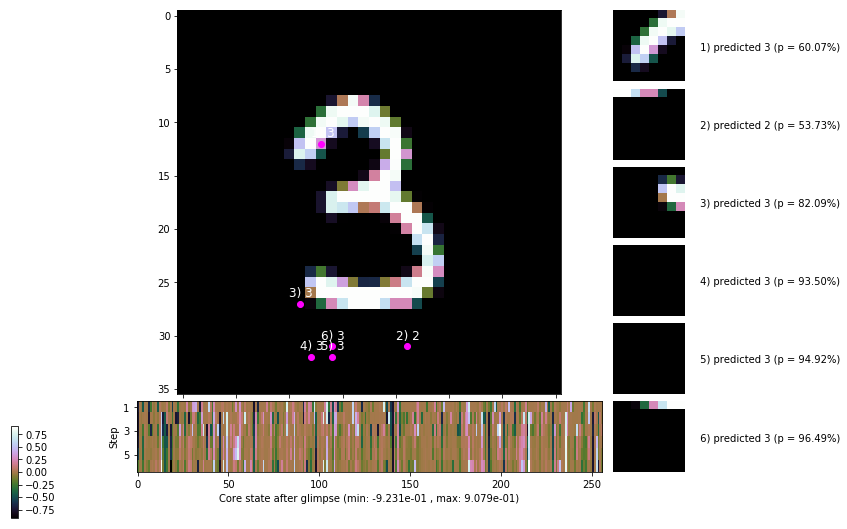

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


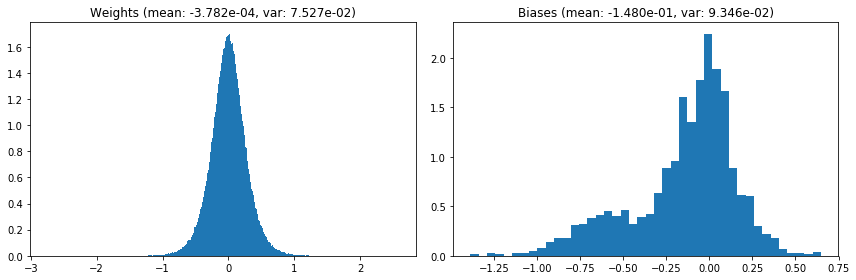

                                      Location network weights and biases


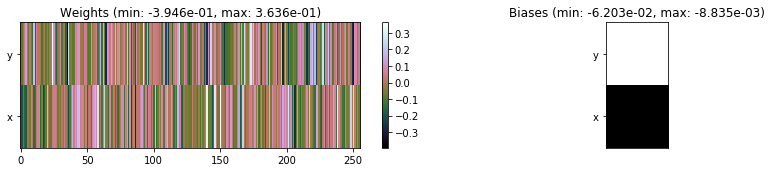

---------------------------------------------------------------------------------------------------------------
Elapsed time:  412.56 sec | TRAIN >> class loss: 0.2845 | steps:  2.193 :( | reward:  3.8142 :( | acc.: 90.613% :(
                          | VAL   >> class loss: 0.3055 | steps:  2.116 :( | reward:  3.9582 :( | acc.: 89.740% :(


Epoch  51/400) lr = 0.0004722
 b    300/  3000 >> 134.5 ms/b | lr: 4.72e-04 | grad 2norm: 10.16 | grad inf norm:  2.804
         Weights || abs max:  2.75 ( 3666.39) | mean: -3.84e-04 ( 0.02) | var: 7.53e-02 (  273.66)
          Biases || abs max:  1.39 (  259.98) | mean: -1.48e-01 ( 0.17) | var: 9.34e-02 ( 1021.09)
                    class loss: 0.307 | steps: 2.213 | reward:  3.752 | acc.: 89.67%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 133.7 ms/b | lr: 4.71e-04 | grad 2norm: 10.07 | grad inf norm:  2.778
         Weights || abs max:  2.74 ( 6214.55) | mean: -3.73e-04 (

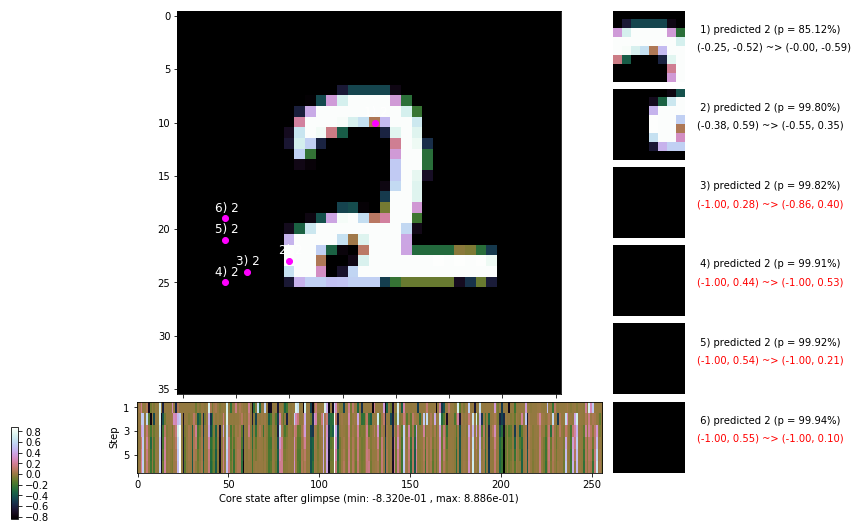

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 135.1 ms/b | lr: 4.70e-04 | grad 2norm:  9.98 | grad inf norm:  2.794
         Weights || abs max:  2.74 ( 6435.05) | mean: -3.63e-04 ( 0.02) | var: 7.54e-02 ( 5802.08)
          Biases || abs max:  1.39 (  420.38) | mean: -1.48e-01 ( 0.24) | var: 9.37e-02 ( 2683.49)
                    class loss: 0.296 | steps: 2.201 | reward:  3.763 | acc.: 89.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 134.3 ms/b | lr: 4.70e-04 | grad 2norm:  9.73 | grad inf norm:  2.705
         Weights || abs max:  2.75 ( 4965.20) | mean: -3.62e-04 ( 0.02) | var: 7.54e-02 ( 1125.45)
          Biases || abs max:  1.40 (  180.04) | mean: -1.48e-01 ( 0.15) | var: 9.37e-02 (  512.32)
                    class loss: 0.300 | steps: 2.165 | reward:  3.831 | acc.: 90.37%

	Target class: 5 | Discounted rewards: [-0.554, -0.539, -

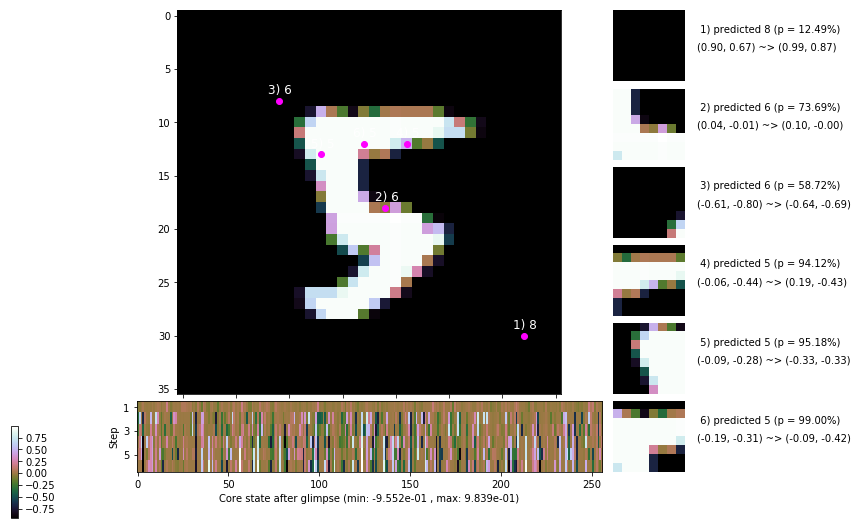

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 136.6 ms/b | lr: 4.69e-04 | grad 2norm:  9.89 | grad inf norm:  2.720
         Weights || abs max:  2.75 ( 7905.92) | mean: -3.55e-04 ( 0.02) | var: 7.55e-02 ( 5479.52)
          Biases || abs max:  1.39 (  127.50) | mean: -1.48e-01 ( 0.12) | var: 9.37e-02 (  171.10)
                    class loss: 0.292 | steps: 2.203 | reward:  3.814 | acc.: 90.62%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 134.3 ms/b | lr: 4.68e-04 | grad 2norm: 10.20 | grad inf norm:  2.719
         Weights || abs max:  2.75 ( 4655.18) | mean: -3.57e-04 ( 0.02) | var: 7.55e-02 ( 1223.07)
          Biases || abs max:  1.39 (   94.31) | mean: -1.49e-01 ( 0.10) | var: 9.41e-02 (   33.11)
                    class loss: 0.318 | steps: 2.236 | reward:  3.703 | acc.: 89.43%

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.1

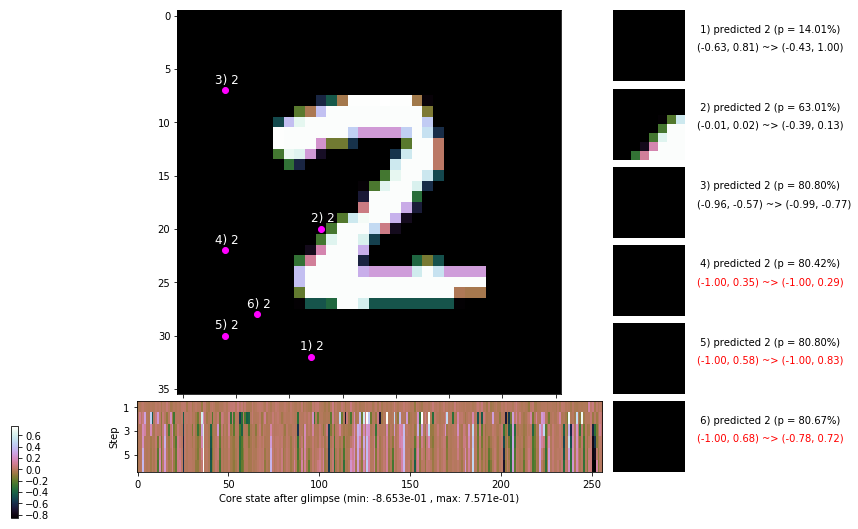

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 136.0 ms/b | lr: 4.67e-04 | grad 2norm:  9.97 | grad inf norm:  2.720
         Weights || abs max:  2.76 ( 4439.43) | mean: -3.48e-04 ( 0.02) | var: 7.55e-02 ( 1816.46)
          Biases || abs max:  1.40 (  118.64) | mean: -1.49e-01 ( 0.12) | var: 9.41e-02 (   41.68)
                    class loss: 0.296 | steps: 2.222 | reward:  3.761 | acc.: 90.03%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 134.2 ms/b | lr: 4.67e-04 | grad 2norm: 10.18 | grad inf norm:  2.763
         Weights || abs max:  2.76 ( 6007.07) | mean: -3.38e-04 ( 0.02) | var: 7.56e-02 ( 5261.29)
          Biases || abs max:  1.40 (  150.88) | mean: -1.49e-01 ( 0.13) | var: 9.40e-02 (  206.72)
                    class loss: 0.293 | steps: 2.191 | reward:  3.804 | acc.: 90.00%

	Target class: 1 | Discounted rewards: [-0.389, 1.111, 1.

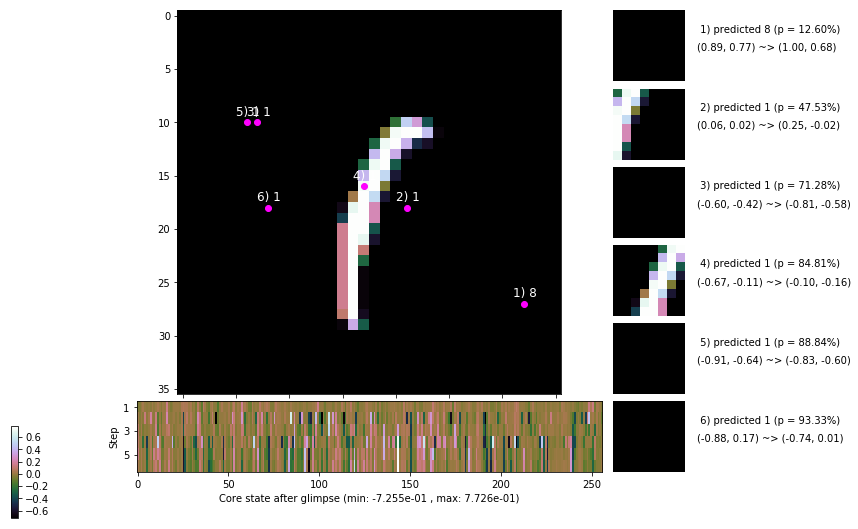

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 135.2 ms/b | lr: 4.66e-04 | grad 2norm:  9.84 | grad inf norm:  2.617
         Weights || abs max:  2.76 (10572.98) | mean: -3.46e-04 ( 0.03) | var: 7.56e-02 (16863.59)
          Biases || abs max:  1.39 (  137.26) | mean: -1.49e-01 ( 0.13) | var: 9.41e-02 (  139.70)
                    class loss: 0.305 | steps: 2.153 | reward:  3.831 | acc.: 89.87%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 135.5 ms/b | lr: 4.66e-04 | grad 2norm: 10.10 | grad inf norm:  2.736
         Weights || abs max:  2.77 ( 2251.73) | mean: -3.34e-04 ( 0.01) | var: 7.57e-02 (  114.58)
          Biases || abs max:  1.39 (  301.28) | mean: -1.50e-01 ( 0.20) | var: 9.44e-02 (  938.69)
                    class loss: 0.309 | steps: 2.215 | reward:  3.757 | acc.: 89.77%

	Target class: 7 | Discounted rewards: [-0.389, 1.111, 1.

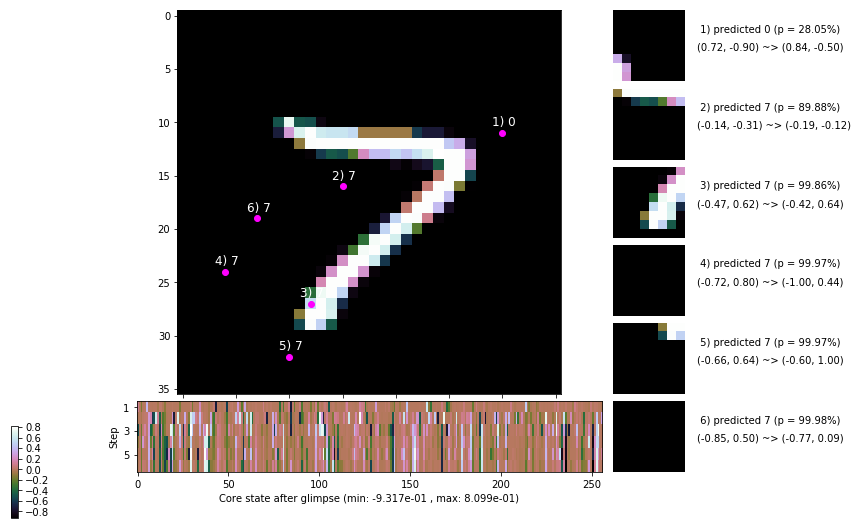

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [1.109, 1.094, 0.944, -0.555, -0.550, -0.500]


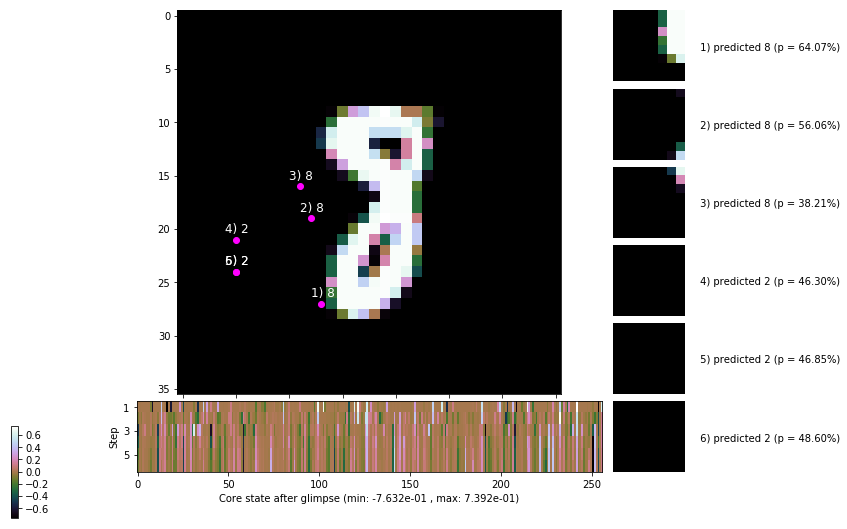


	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


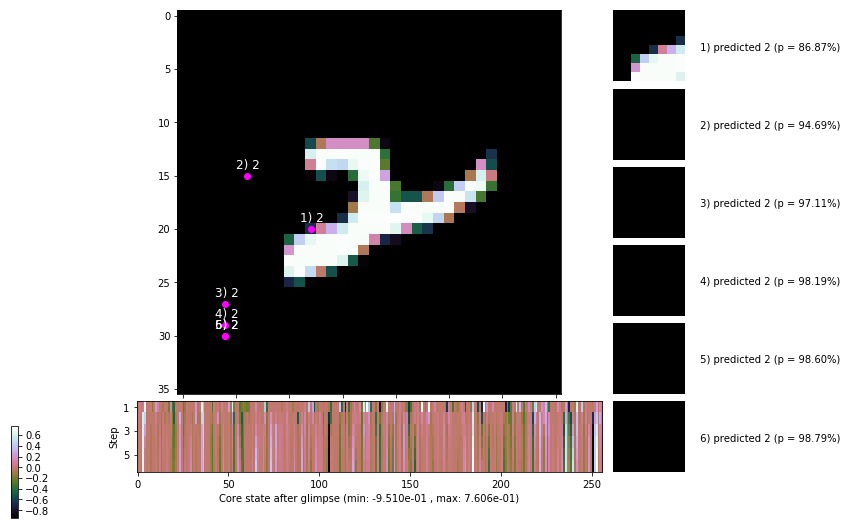

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


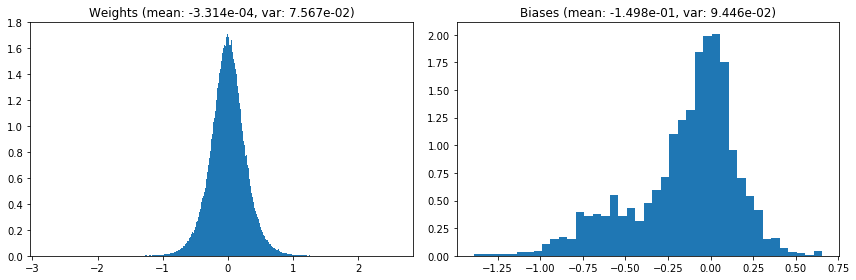

                                      Location network weights and biases


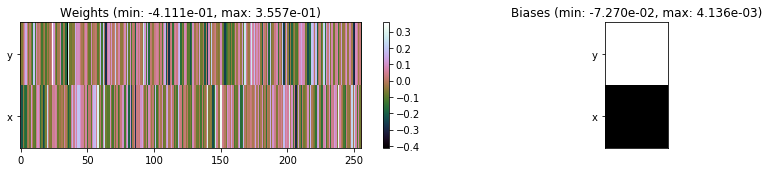

---------------------------------------------------------------------------------------------------------------
Elapsed time:  405.52 sec | TRAIN >> class loss: 0.3011 | steps:  2.199 :( | reward:  3.7804 :( | acc.: 89.947% :(
                          | VAL   >> class loss: 0.3223 | steps:  2.109 :( | reward:  3.9222 :( | acc.: 88.760% :(



			---~~~=== End of training ===~~~---

Evaluating on the TEST dataset...

	Target class: 9 | Discounted rewards: [-0.556, -0.556, -0.556, -0.555, -0.550, -0.500]


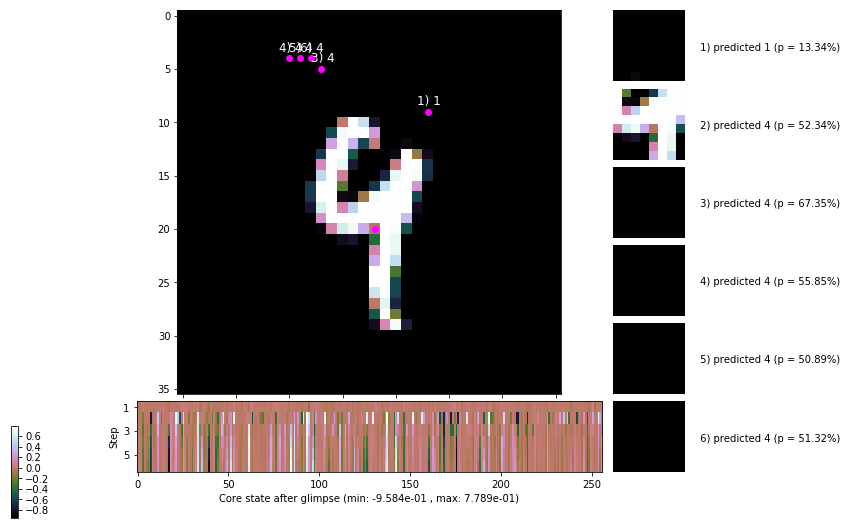


	Target class: 7 | Discounted rewards: [1.096, 0.961, -0.389, 1.110, 1.100, 1.000]


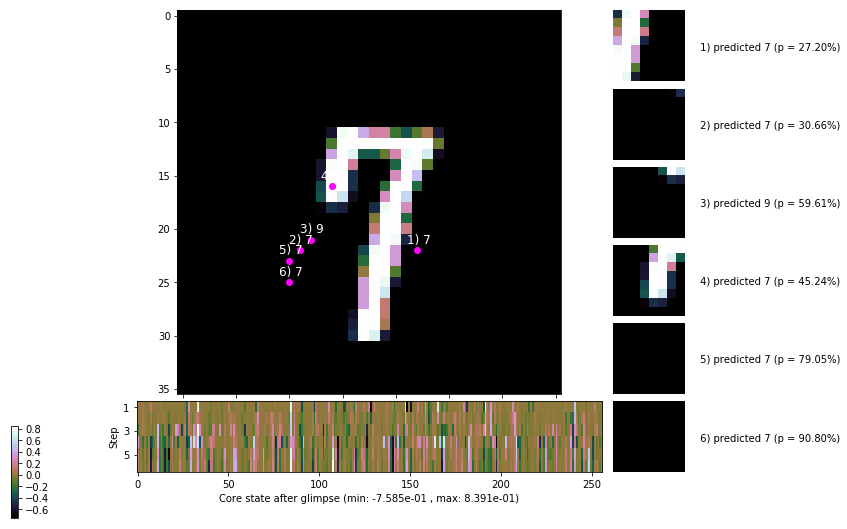

	>> class loss: 0.3067 | steps:  2.089 | reward:  3.9918 | acc.: 89.680%


In [7]:
model_info, train_info, val_info, test_info, epochs = train_eval_loop(
    model = model, epochs = num_epochs, image_size = image_size,
    train_data = train_data, val_data = val_data, test_data = test_data,
    padding = padding, optimizer = optimizer, lr_scheduler = lr_scheduler,
    class_criterion = class_criterion, error_penalty = error_penalty,
    loc_std = loc_std, random_start_loc = random_start_loc, gamma = gamma,
    grad_clip = grad_clip, steps_per_epoch = steps_per_epoch,
    max_ep_len = max_ep_len, log_freq = log_freq, viz_freq = viz_freq,
    early_stopping = early_stopping, eval_viz_freq = eval_viz_freq,
    reward_all_correct = True
)

In [8]:
print('Trained over %d epochs\n' % epochs)

for name, best_stats in zip(['train', 'val'], [train_info['bests'], val_info['bests']]):
    print('Best %s stats:' % name)
    for k, v in best_stats.items():
        print('    %s: %.3f (epoch %d)' % (k, v[k], v['epoch']))
    print('')

Trained over 51 epochs

Best train stats:
    steps: 2.184 (epoch 43)
    reward: 3.831 (epoch 43)
    accuracy: 0.912 (epoch 24)

Best val stats:
    steps: 2.055 (epoch 41)
    reward: 4.073 (epoch 37)
    accuracy: 0.927 (epoch 23)



### Training curves

In [9]:
epoch_range = range(1, epochs+1)
train_col = (1, 0, 0); train_err_col = (1, 0.1, 0.1)
val_col = (0, 0, 1); val_err_col = (0.1, 0.1, 1)

Text(0.5,1,'Weight and bias values over training time')

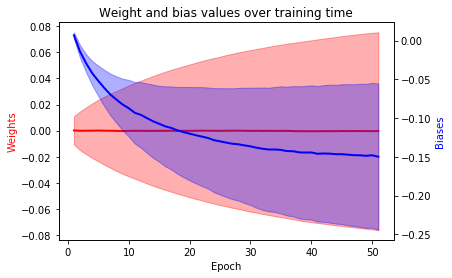

In [10]:
wts_mean = np.array(model_info['weights']['mean'])
wts_var = np.array(model_info['weights']['var'])
bias_mean = np.array(model_info['biases']['mean'])
bias_var = np.array(model_info['biases']['var'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_mean, color = train_col, linewidth = 2)
wts_ax.fill_between(epoch_range,
    wts_mean - wts_var, wts_mean + wts_var,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_mean, color = val_col, linewidth = 2)
bias_ax.fill_between(epoch_range,
    bias_mean - bias_var, bias_mean + bias_var,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Weight and bias values over training time')

Text(0.5,1,'Max absolute weight and bias values over training time')

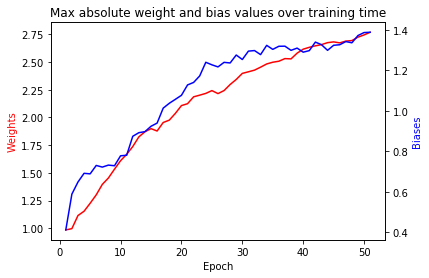

In [11]:
wts_absmax = np.array(model_info['weights']['abs max'])
bias_absmax = np.array(model_info['biases']['abs max'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_absmax, color = train_col)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_absmax, color = val_col)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Max absolute weight and bias values over training time')

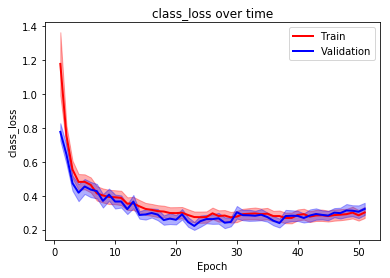

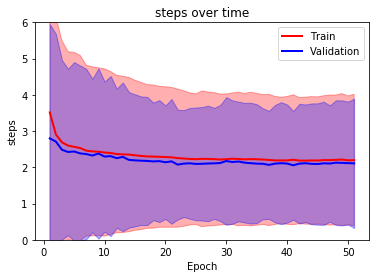

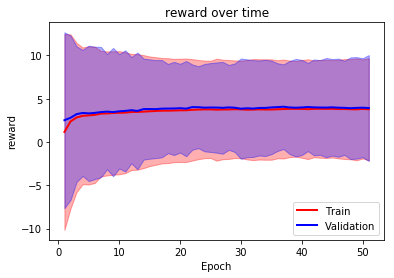

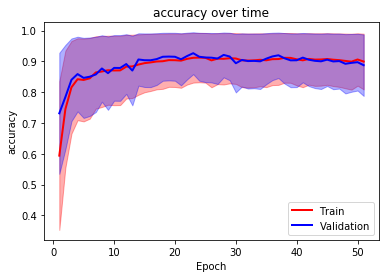

In [12]:
things_to_plot = ['class_loss', 'steps', 'reward', 'accuracy']
for thing in things_to_plot:
    train_avg = np.array([info['averages'][thing] for info in train_info['stats']])
    train_err = np.array([np.var(info['histories'][thing]) for info in train_info['stats']])
    
    val_avg = np.array([info['averages'][thing] for info in val_info['stats']])
    val_err = np.array([np.var(info['histories'][thing]) for info in val_info['stats']])
    
    plt.plot(epoch_range, train_avg, color = train_col, linewidth = 2)
    plt.plot(epoch_range, val_avg, color = val_col, linewidth = 2)
    plt.fill_between(epoch_range,
        train_avg - train_err, train_avg + train_err, alpha = 0.35,
        edgecolor = train_col, facecolor = train_err_col
    )
    plt.fill_between(epoch_range,
        val_avg - val_err, val_avg + val_err, alpha = 0.35,
        edgecolor = val_col, facecolor = val_err_col
    )
    if thing == 'steps':
        plt.ylim([0, 6])
    plt.legend(['Train', 'Validation'], loc = 'upper right' if thing in ['class_loss', 'steps'] else 'lower right')
    plt.xlabel('Epoch'); plt.ylabel(thing)
    plt.title('%s over time' % thing)
    plt.show()
    print('')

Text(0.5,1,'Gradient norms over training time')

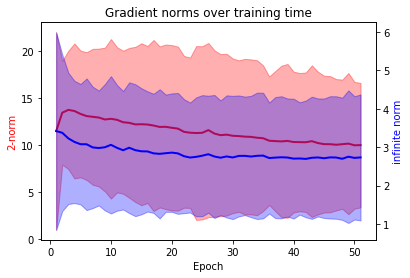

In [13]:
# Gradient stats
grad_2norm = np.array([info['averages']['grad_2norm'] for info in train_info['stats']])
grad_inf_norm = np.array([info['averages']['grad_inf_norm'] for info in train_info['stats']])
grad_2norm_err = np.array([np.var(info['histories']['grad_2norm']) for info in train_info['stats']])
grad_inf_norm_err = np.array([np.var(info['histories']['grad_inf_norm']) for info in train_info['stats']])

fig, pnorm_ax = plt.subplots()
pnorm_ax.plot(epoch_range, grad_2norm, color = train_col, linewidth = 2)
pnorm_ax.fill_between(epoch_range,
    grad_2norm - grad_2norm_err, grad_2norm + grad_2norm_err,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
pnorm_ax.set_xlabel('Epoch');
pnorm_ax.set_ylabel('2-norm', color = train_col)

infnorm_ax = pnorm_ax.twinx()
infnorm_ax.plot(epoch_range, grad_inf_norm, color = val_col, linewidth = 2)
infnorm_ax.fill_between(epoch_range,
    grad_inf_norm - grad_inf_norm_err, grad_inf_norm + grad_inf_norm_err,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
infnorm_ax.set_ylabel('infinite norm', color = val_col)

plt.title('Gradient norms over training time')